# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcatdata

100% 265k/265k [00:00<00:00, 455kB/s]
100% 265k/265k [00:00<00:00, 454kB/s]


In [ ]:
! unzip /content/memcatdata.zip

Archive:  /content/memcatdata.zip
  inflating: memcat_image_data.csv   


In [ ]:
! kaggle datasets download -d rattapornk/image-merged

100% 1.09G/1.09G [00:57<00:00, 20.7MB/s]
100% 1.09G/1.09G [00:57<00:00, 20.3MB/s]


In [ ]:
! unzip /content/image-merged.zip

Streaming output truncated to the last 5000 lines.
  inflating: merged/n02355227_5820.jpg  
  inflating: merged/n02355227_5898.jpg  
  inflating: merged/n02355227_6323.jpg  
  inflating: merged/n02355227_6434.jpg  
  inflating: merged/n02355227_6696.jpg  
  inflating: merged/n02355227_7587.jpg  
  inflating: merged/n02355227_7784.jpg  
  inflating: merged/n02355227_7881.jpg  
  inflating: merged/n02355227_8112.jpg  
  inflating: merged/n02355227_8561.jpg  
  inflating: merged/n02355227_8586.jpg  
  inflating: merged/n02355227_8789.jpg  
  inflating: merged/n02355227_9552.jpg  
  inflating: merged/n02355227_9703.jpg  
  inflating: merged/n02374451_17392.jpg  
  inflating: merged/n02374451_4963.jpg  
  inflating: merged/n02379743_11969.jpg  
  inflating: merged/n02381004_7100.jpg  
  inflating: merged/n02381004_8273.jpg  
  inflating: merged/n02381004_9323.jpg  
  inflating: merged/n02386310_9220.jpg  
  inflating: merged/n02387722_10980.jpg  
  inflating: merged/n02389026_1198.jpg  
  i

In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:51<00:00, 24.3MB/s]
100% 1.09G/1.09G [00:51<00:00, 22.8MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.7 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel
import tensorflow as tf

In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 55.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 57.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 79.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 27.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━

In [ ]:
import timm

In [ ]:
! pip install torchsummary

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
from scipy.stats import spearmanr

# Preprocess & Split

In [ ]:
df_merge = pd.read_csv("/content/memcat_image_data.csv")
df_merge["image_file"] =df_merge["image_file"].apply(lambda file: "/content/merged" +"/"+ file) # Create image path
df_merge["memorability_wo_fa_correction"] = df_merge["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_merge.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,1,/content/merged/000000003481.jpg,animal,bear,316.0,500.0,coco,bear,1.0,55,4,98,0.561224,0.520408
1,2,/content/merged/000000005745.jpg,animal,bear,427.0,640.0,coco,bear,1.0,64,4,81,0.790123,0.740741
2,3,/content/merged/000000011552.jpg,animal,bear,427.0,640.0,coco,bear,1.0,75,5,104,0.721154,0.673077
3,4,/content/merged/000000027439.jpg,animal,bear,359.0,640.0,coco,bear,1.0,92,3,114,0.807018,0.780702
4,5,/content/merged/000000055601.jpg,animal,bear,380.0,640.0,coco,bear,1.0,83,12,102,0.813725,0.696078


Image shape: (10000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 115.64354532711522
Standard deviation of pixel values: 68.17203453698677


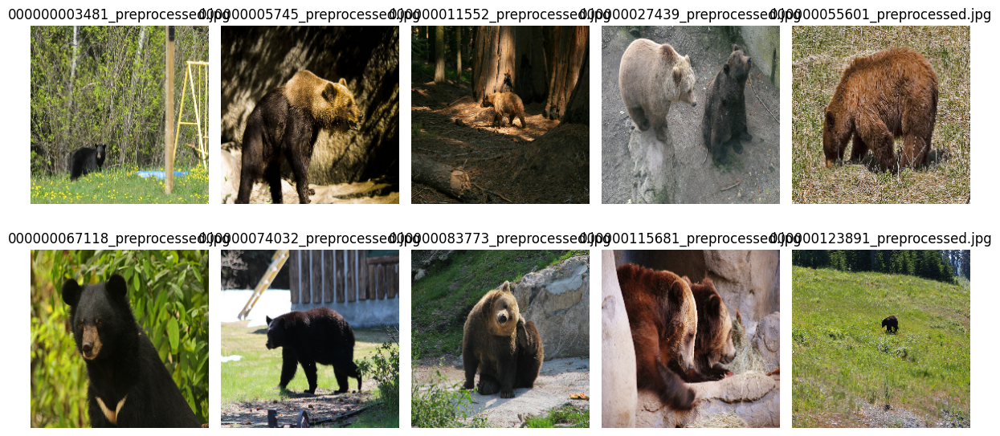

In [ ]:
# Sample data (replace this with your DataFrame)
df_merge= pd.DataFrame({
    'image_file': df_merge["image_file"],
    'memoscore': df_merge["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_merge['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_merge.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_merge.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_merge.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_merge.head()

,image_file,memoscore,preprocessed_image_path
0,/content/merged/000000003481.jpg,0.561224,/content/merged/000000003481_preprocessed.jpg
1,/content/merged/000000005745.jpg,0.790123,/content/merged/000000005745_preprocessed.jpg
2,/content/merged/000000011552.jpg,0.721154,/content/merged/000000011552_preprocessed.jpg
3,/content/merged/000000027439.jpg,0.807018,/content/merged/000000027439_preprocessed.jpg
4,/content/merged/000000055601.jpg,0.813725,/content/merged/000000055601_preprocessed.jpg


In [ ]:
del df_merge["image_file"]

In [ ]:
df_merge.head()

,memoscore,preprocessed_image_path
0,0.561224,/content/merged/000000003481_preprocessed.jpg
1,0.790123,/content/merged/000000005745_preprocessed.jpg
2,0.721154,/content/merged/000000011552_preprocessed.jpg
3,0.807018,/content/merged/000000027439_preprocessed.jpg
4,0.813725,/content/merged/000000055601_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_merge.drop('memoscore', axis=1)), pd.DataFrame(df_merge['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 9000
Validation set size: 500
Test set size: 500


In [ ]:
X_train.head()

,preprocessed_image_path
9253,/content/merged/n04349306_2544_preprocessed.jpg
904,/content/merged/000000042931_preprocessed.jpg
4884,/content/merged/n03634034_7799_preprocessed.jpg
3925,/content/merged/n07849336_25516_preprocessed.jpg
1387,/content/merged/n02332755_6877_preprocessed.jpg


In [ ]:
merged_train_merge= pd.concat([X_train, y_train], axis=1)
merged_train_merge

,preprocessed_image_path,memoscore
9253,/content/merged/n04349306_2544_preprocessed.jpg,0.710280
904,/content/merged/000000042931_preprocessed.jpg,0.892157
4884,/content/merged/n03634034_7799_preprocessed.jpg,0.695238
3925,/content/merged/n07849336_25516_preprocessed.jpg,0.902439
1387,/content/merged/n02332755_6877_preprocessed.jpg,0.764706
...,...,...
5476,/content/merged/n09421951_10886_preprocessed.jpg,0.578431
3214,/content/merged/n07923748_13369_preprocessed.jpg,0.858696
480,/content/merged/n02433729_8495_preprocessed.jpg,0.792079
5721,/content/merged/n09472597_21426_preprocessed.jpg,0.669811


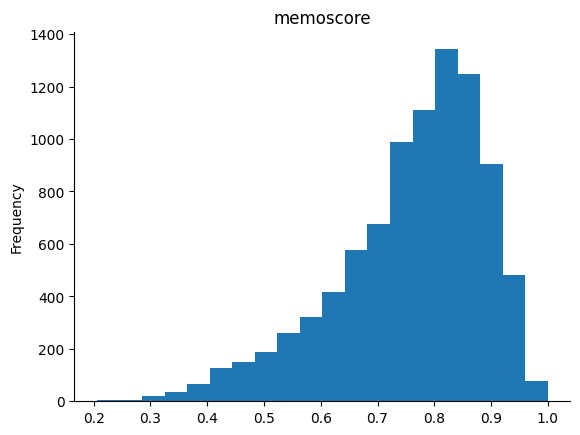

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_train_merge['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_val_merge = pd.concat([X_val, y_val], axis=1)
merged_val_merge

,preprocessed_image_path,memoscore
7302,/content/merged/n00470966_25103_preprocessed.jpg,0.893805
8009,/content/merged/000000078354_preprocessed.jpg,0.678161
5620,/content/merged/n09468604_18945_preprocessed.jpg,0.680000
9597,/content/merged/n04465501_7045_preprocessed.jpg,0.737374
3358,/content/merged/n07690273_22127_preprocessed.jpg,0.835165
...,...,...
2035,/content/merged/n07693725_11051_preprocessed.jpg,0.854167
5971,/content/merged/n04587559_10942_preprocessed.jpg,0.635514
9778,/content/merged/n04335435_2973_preprocessed.jpg,0.741573
9324,/content/merged/n04349306_9994_preprocessed.jpg,0.868687


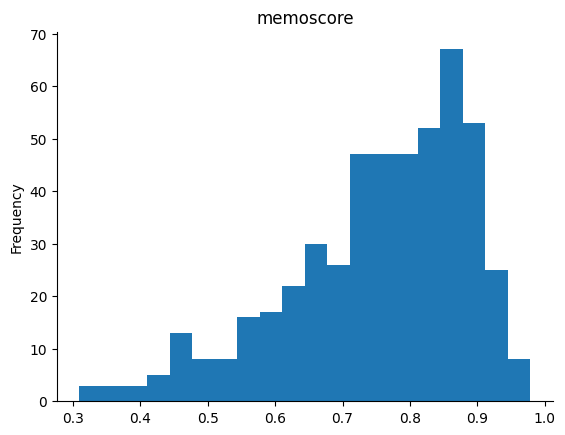

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_val_merge['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_test_merge = pd.concat([X_test, y_test], axis=1)
merged_test_merge

,preprocessed_image_path,memoscore
4083,/content/merged/sun_bcyqhmsuncrhyodx_preproces...,0.591667
2274,/content/merged/n07720875_5449_preprocessed.jpg,0.909091
367,/content/merged/000000352307_preprocessed.jpg,0.777778
6552,/content/merged/ac260e25915895d8_preprocessed.jpg,0.821429
4632,/content/merged/n09288635_14256_preprocessed.jpg,0.794118
...,...,...
6347,/content/merged/1e195f9a98e163b3_preprocessed.jpg,0.666667
9636,/content/merged/000000122207_preprocessed.jpg,0.848485
4913,/content/merged/sun_aprsgtcazbqqcmis_preproces...,0.616438
5558,/content/merged/935128a44d4c1dd7_preprocessed.jpg,0.391753


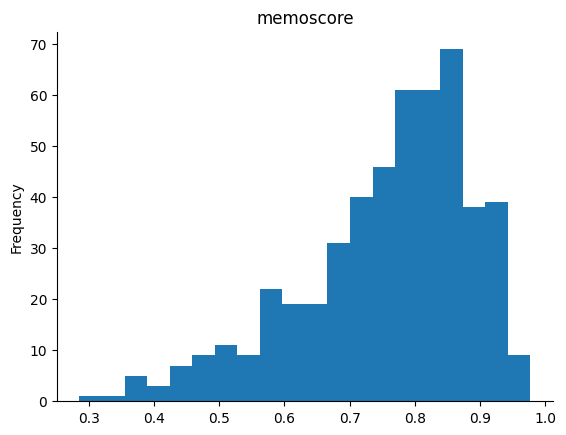

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_test_merge['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_merge = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/merge_Vit+Res.csv'
merged_train_merge.to_csv(csv_train_merge, index=False)

In [ ]:
csv_val_merge = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/merge_Vit+Res.csv'
merged_val_merge.to_csv(csv_val_merge, index=False)

In [ ]:
csv_test_merge = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/merge_Vit+Res.csv'
merged_test_merge.to_csv(csv_test_merge, index=False)

#Load Dataset

In [ ]:
df_train_merge = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/merge_Vit+Res.csv")
df_val_merge = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/merge_Vit+Res.csv')
df_test_merge = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/merge_Vit+Res.csv')

In [ ]:
df_train_merge.head()

,preprocessed_image_path,memoscore
0,/content/merged/n03791053_10279_preprocessed.jpg,0.889830
1,/content/merged/b46b82512ff4a485_preprocessed.jpg,0.795918
2,/content/merged/n09289331_679_preprocessed.jpg,0.572650
3,/content/merged/n02878222_23308_preprocessed.jpg,0.774510
4,/content/merged/n09468604_936_preprocessed.jpg,0.590476


In [ ]:
df_train_merge.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9000 entries, 0 to 8999
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  9000 non-null   object 
 1   memoscore                9000 non-null   float64
dtypes: float64(1), object(1)
memory usage: 140.8+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_merge(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_merge(df_train_merge, trans_transform=trans_transform, res_transform=res_transform)
train_dl = DataLoader(train_ds, batch_size=16, shuffle= False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 151MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

In [ ]:
print(trans_layer_norm )

LayerNorm((768,), eps=1e-12, elementwise_affine=True)


In [ ]:
print(layers_trans)

[ViTEmbeddings(
  (patch_embeddings): ViTPatchEmbeddings(
    (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  )
  (dropout): Dropout(p=0.0, inplace=False)
), ViTEncoder(
  (layer): ModuleList(
    (0-11): 12 x ViTLayer(
      (attention): ViTAttention(
        (attention): ViTSelfAttention(
          (query): Linear(in_features=768, out_features=768, bias=True)
          (key): Linear(in_features=768, out_features=768, bias=True)
          (value): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (output): ViTSelfOutput(
          (dense): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
      )
      (intermediate): ViTIntermediate(
        (dense): Linear(in_features=768, out_features=3072, bias=True)
        (intermediate_act_fn): GELUActivation()
      )
      (output): ViTOutput(
        (dense): Linear(in_features=3072, ou

In [ ]:
# Merge the two models
class model_merge_merge(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_merge(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-5)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


In [ ]:
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()


# Fit function doing grad steps
def fit(epochs, model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []

    for epoch in range(epochs):
        model.train()
        batch_num = 16
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())

            loss.backward()
            opt.step()
            opt.zero_grad()

            total_loss += loss.item()
            total_loss_rmse += loss_rmse.item()
            total_r2 += r2.item()
            total_mae += mae.item()


            # Increment batch number
            #print('\r', f'batch #{batch_num}: {loss}', end='')
            batch_num += 5

        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        # Plot scatter plot after each epoch
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:5445: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))



 Epoch: (1/50) Loss = 0.02761225216090679

 Epoch: (1/50) Loss_rmse = 0.16616934537887573

 Epoch: (1/50) R^2 = -5.675875186920166

 Epoch: (1/50) MAE = 0.15321922302246094
Spearman correlation coefficient: SignificanceResult(statistic=0.017712002606780807, pvalue=0.09306255063673276)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0

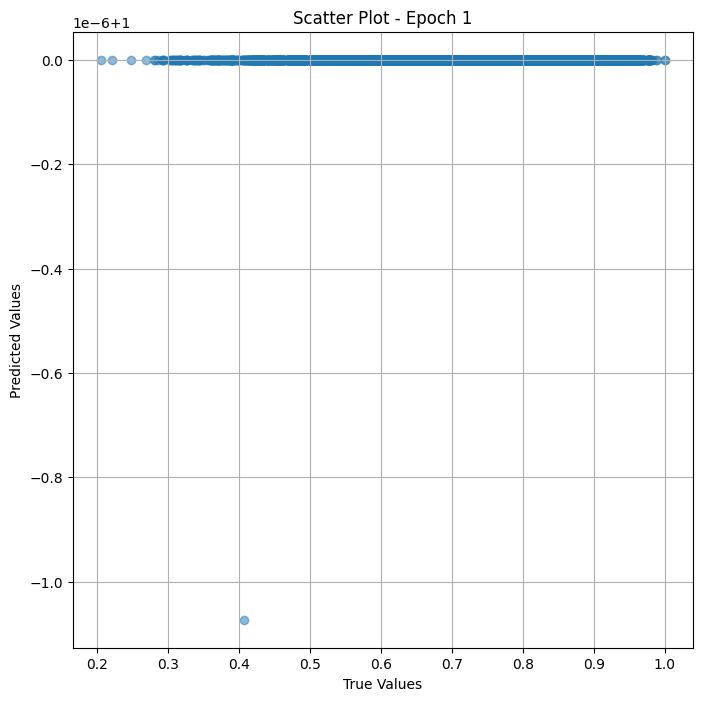

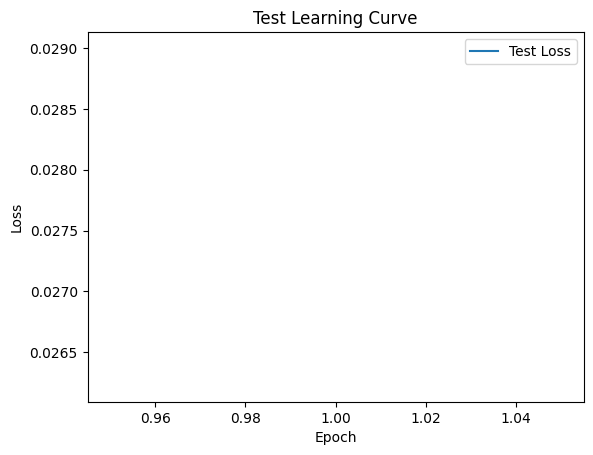


 Epoch: (2/50) Loss = 0.02761225216090679

 Epoch: (2/50) Loss_rmse = 0.16616934537887573

 Epoch: (2/50) R^2 = -5.675875186920166

 Epoch: (2/50) MAE = 0.15321922302246094
Spearman correlation coefficient: SignificanceResult(statistic=0.017712002606780807, pvalue=0.09306255063673276)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0

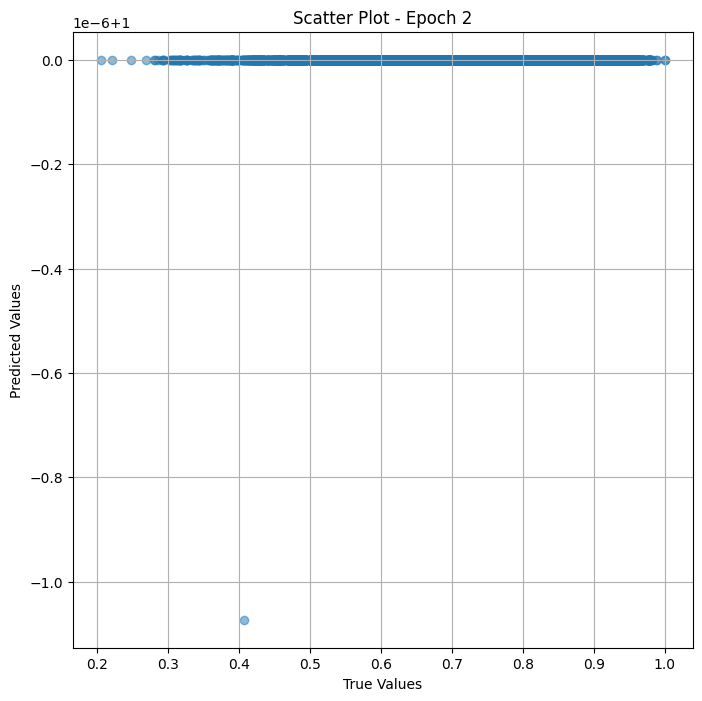

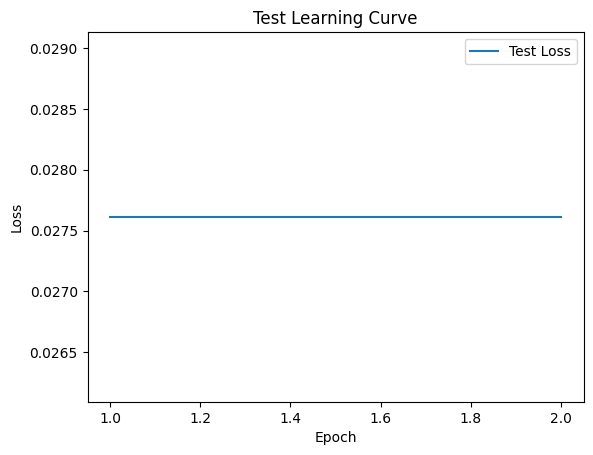


 Epoch: (3/50) Loss = 0.02761225216090679

 Epoch: (3/50) Loss_rmse = 0.16616934537887573

 Epoch: (3/50) R^2 = -5.675875186920166

 Epoch: (3/50) MAE = 0.15321922302246094
Spearman correlation coefficient: SignificanceResult(statistic=0.017712002606780807, pvalue=0.09306255063673276)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0

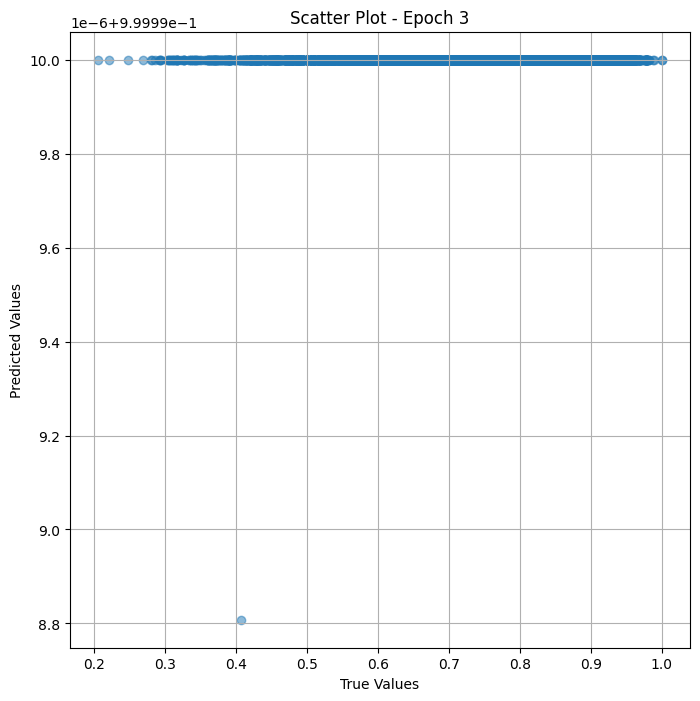

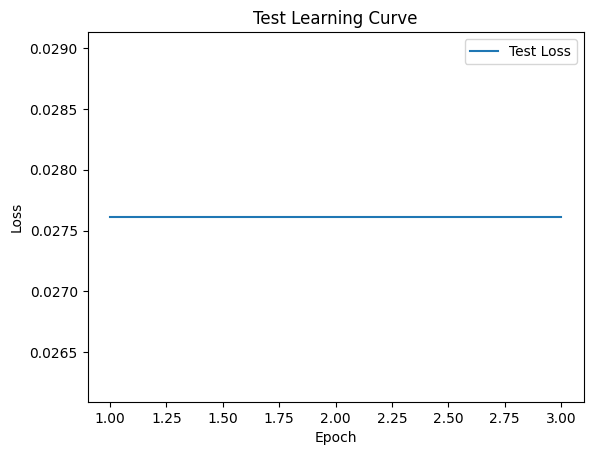


 Epoch: (4/50) Loss = 0.02761225216090679

 Epoch: (4/50) Loss_rmse = 0.16616934537887573

 Epoch: (4/50) R^2 = -5.675875186920166

 Epoch: (4/50) MAE = 0.15321922302246094
Spearman correlation coefficient: SignificanceResult(statistic=0.017712002606780807, pvalue=0.09306255063673276)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0

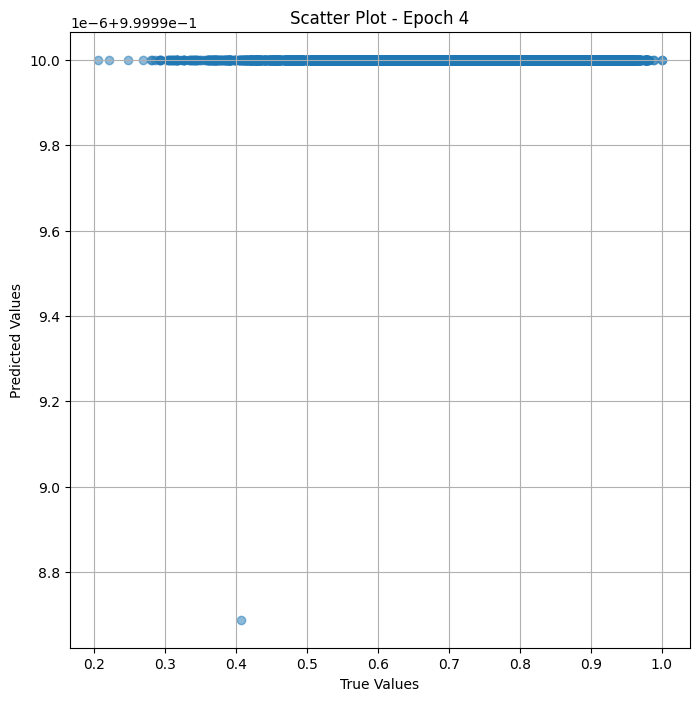

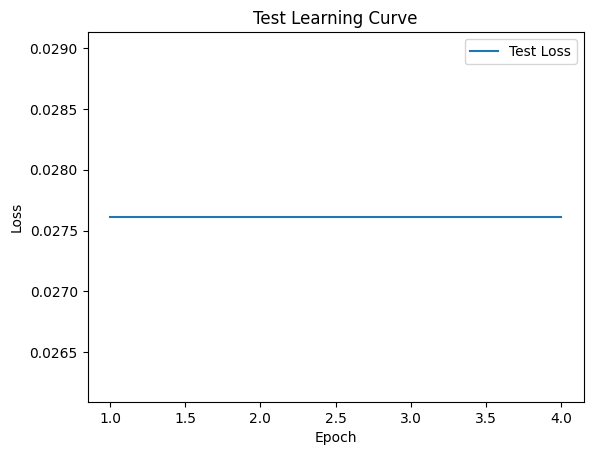


 Epoch: (5/50) Loss = 0.02761225216090679

 Epoch: (5/50) Loss_rmse = 0.16616934537887573

 Epoch: (5/50) R^2 = -5.675875186920166

 Epoch: (5/50) MAE = 0.15321922302246094
Spearman correlation coefficient: SignificanceResult(statistic=0.017712002606780807, pvalue=0.09306255063673276)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0

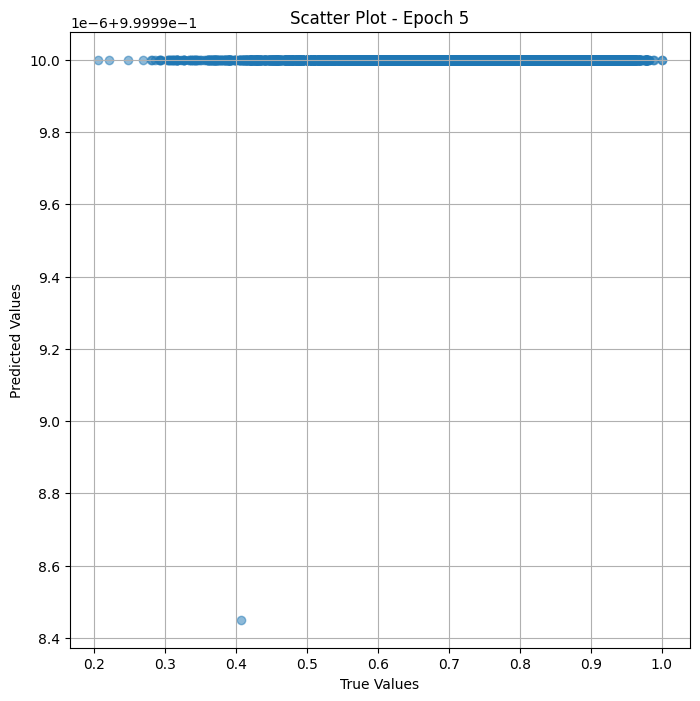

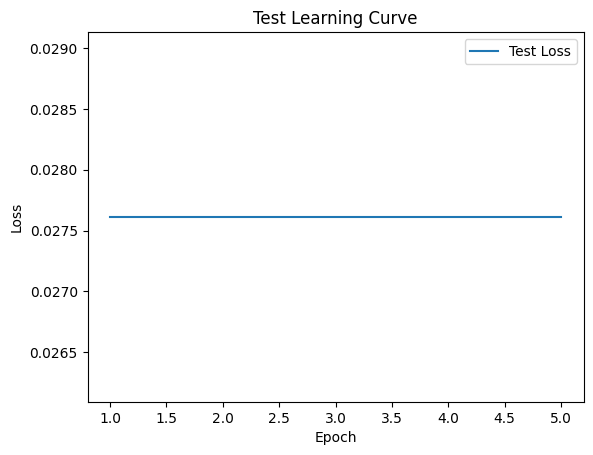


 Epoch: (6/50) Loss = 0.02761225216090679

 Epoch: (6/50) Loss_rmse = 0.16616934537887573

 Epoch: (6/50) R^2 = -5.675875186920166

 Epoch: (6/50) MAE = 0.15321922302246094
Spearman correlation coefficient: SignificanceResult(statistic=0.017712002606780807, pvalue=0.09306255063673276)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0

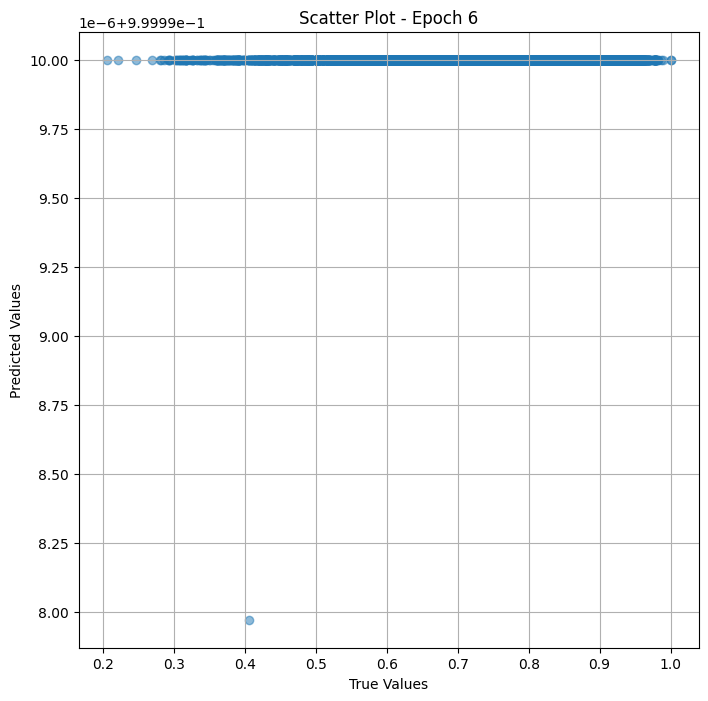

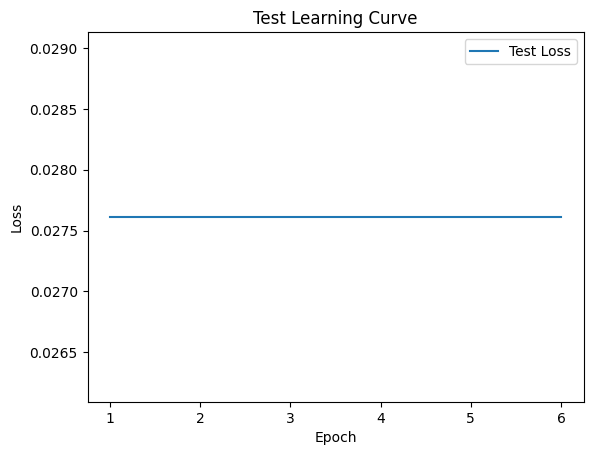

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_T")

## Valid

In [ ]:
class Dataset_val(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_val(df_val_merge, trans_transform=trans_transform, res_transform=res_transform)
train_dl_val = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_val = model_merge_val(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
model_val = to_device(model_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

# Fit function doing grad steps
def fit(epochs, model_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()

    for epoch in range(epochs):
        model_val.train()
        batch_num = 16
        true_values_list = []
        predicted_values_list = []
        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())

            loss.backward()
            opt.step()
            opt.zero_grad()

            total_loss += loss.item()
            total_loss_rmse += loss_rmse.item()
            total_r2 += r2.item()
            total_mae += mae.item()
            #total_spearman += spearman_corr

            # Increment batch number
            #print('\r', f'batch #{batch_num}: {loss}', end='')
            batch_num += 5

        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        #print('\n', f'Epoch: ({epoch+1}/{epochs}) Spearman = {mean_spearman}')
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        # Plot scatter plot after each epoch
        plot_scatter(true_values_list, predicted_values_list, epoch)


 Epoch: (1/50) Loss = 0.10648853331804276

 Epoch: (1/50) Loss_rmse = 0.32632580399513245

 Epoch: (1/50) R^2 = -2.1290640830993652

 Epoch: (1/50) MAE = 0.26220089197158813

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0

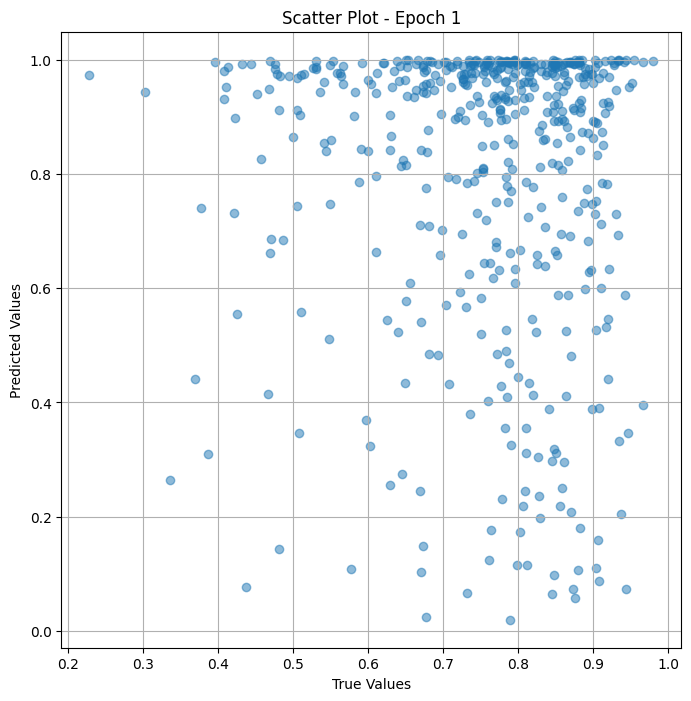


 Epoch: (2/50) Loss = 0.09708401560783386

 Epoch: (2/50) Loss_rmse = 0.3115830719470978

 Epoch: (2/50) R^2 = -1.8527212142944336

 Epoch: (2/50) MAE = 0.25435084104537964

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.

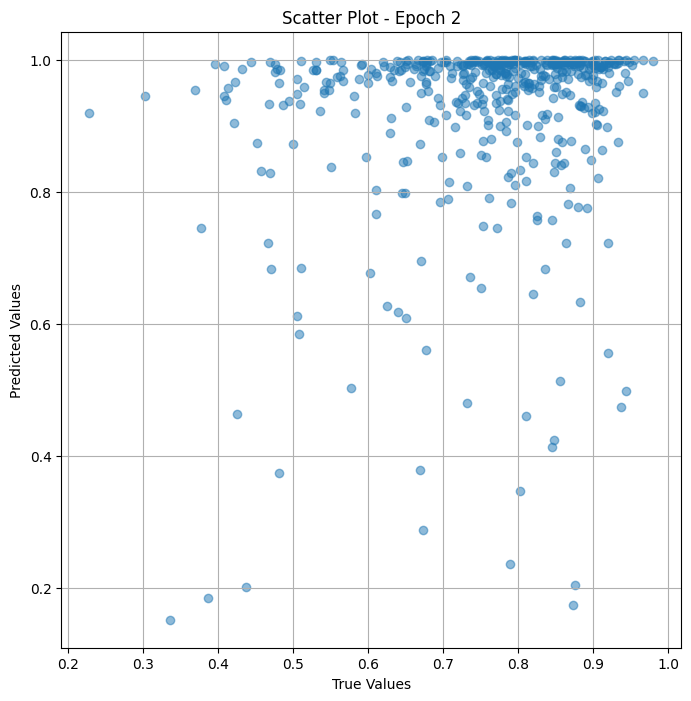


 Epoch: (3/50) Loss = 0.05937928333878517

 Epoch: (3/50) Loss_rmse = 0.24367864429950714

 Epoch: (3/50) R^2 = -0.7448035478591919

 Epoch: (3/50) MAE = 0.21790926158428192

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0

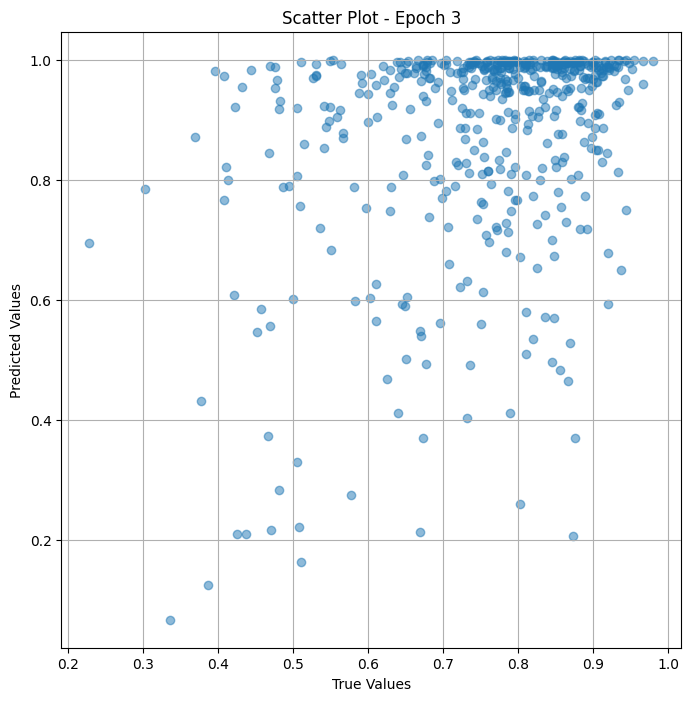


 Epoch: (4/50) Loss = 0.018926357850432396

 Epoch: (4/50) Loss_rmse = 0.13757309317588806

 Epoch: (4/50) R^2 = 0.443867027759552

 Epoch: (4/50) MAE = 0.11026716232299805

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.

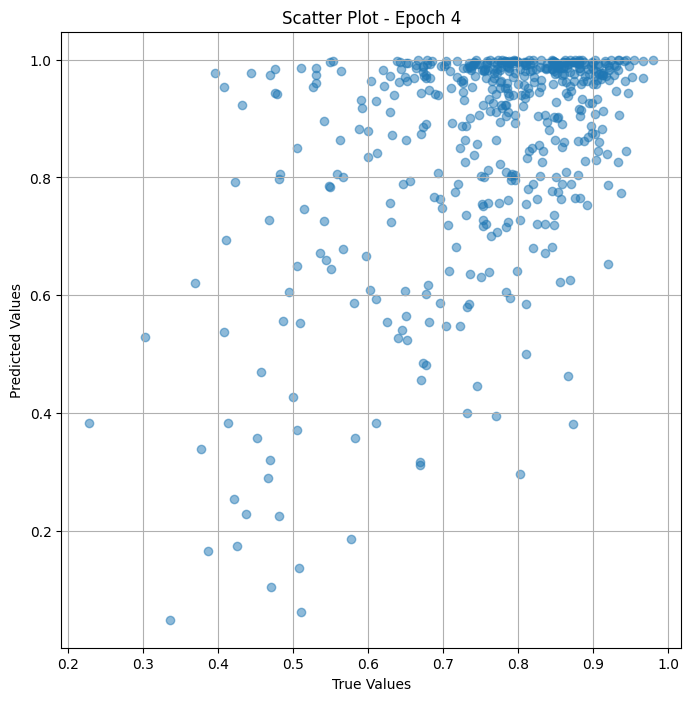


 Epoch: (5/50) Loss = 0.015443638898432255

 Epoch: (5/50) Loss_rmse = 0.1242724359035492

 Epoch: (5/50) R^2 = 0.5462033748626709

 Epoch: (5/50) MAE = 0.09752686321735382

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.

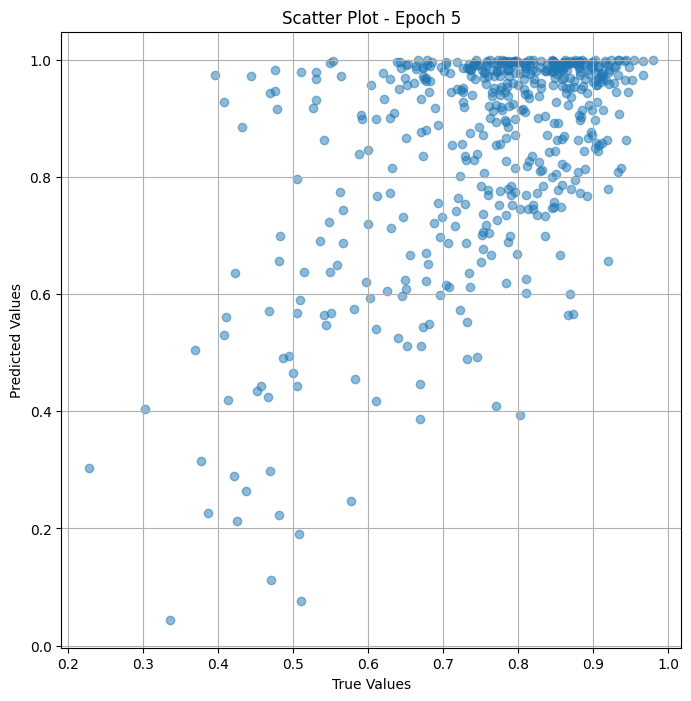


 Epoch: (6/50) Loss = 0.012347159907221794

 Epoch: (6/50) Loss_rmse = 0.11111777275800705

 Epoch: (6/50) R^2 = 0.6371904611587524

 Epoch: (6/50) MAE = 0.08100880682468414

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0

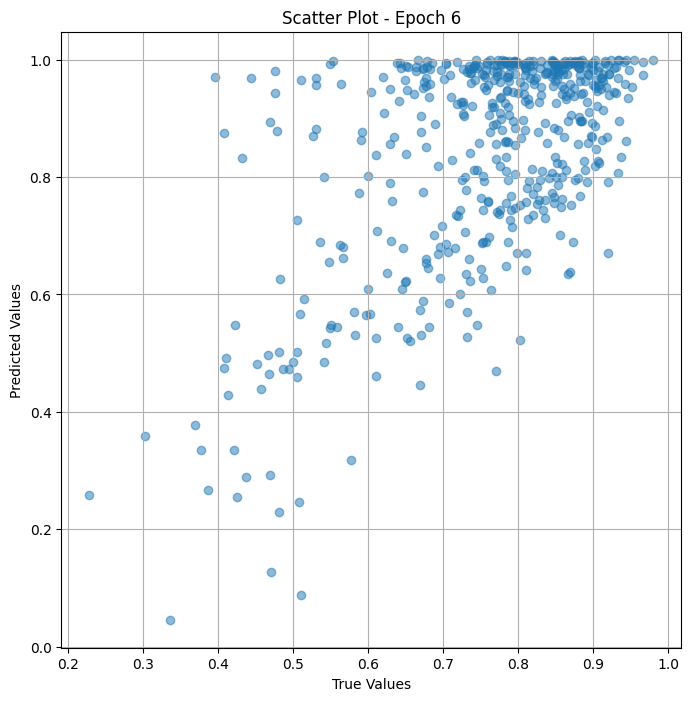


 Epoch: (7/50) Loss = 0.011334382928907871

 Epoch: (7/50) Loss_rmse = 0.10646305978298187

 Epoch: (7/50) R^2 = 0.666949987411499

 Epoch: (7/50) MAE = 0.0653388723731041

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.6

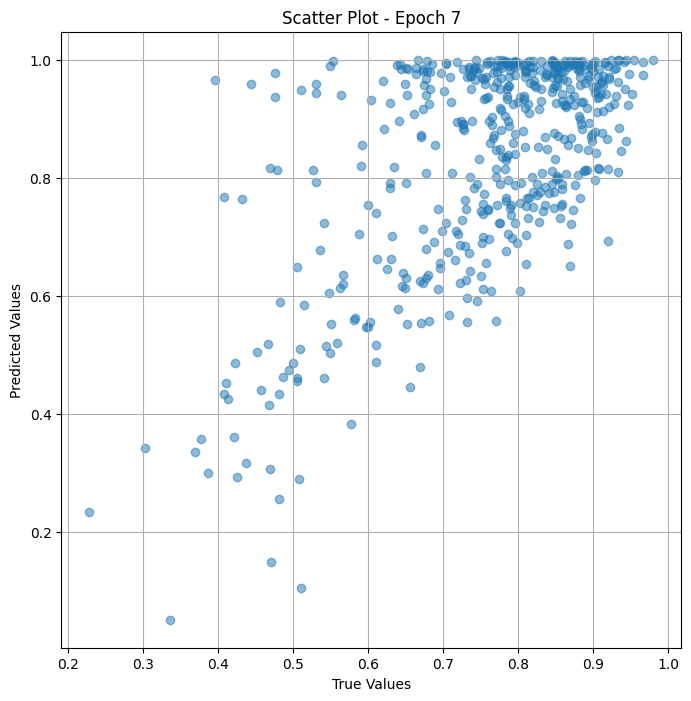


 Epoch: (8/50) Loss = 0.01104652974754572

 Epoch: (8/50) Loss_rmse = 0.10510247200727463

 Epoch: (8/50) R^2 = 0.6754082441329956

 Epoch: (8/50) MAE = 0.06105600297451019

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.

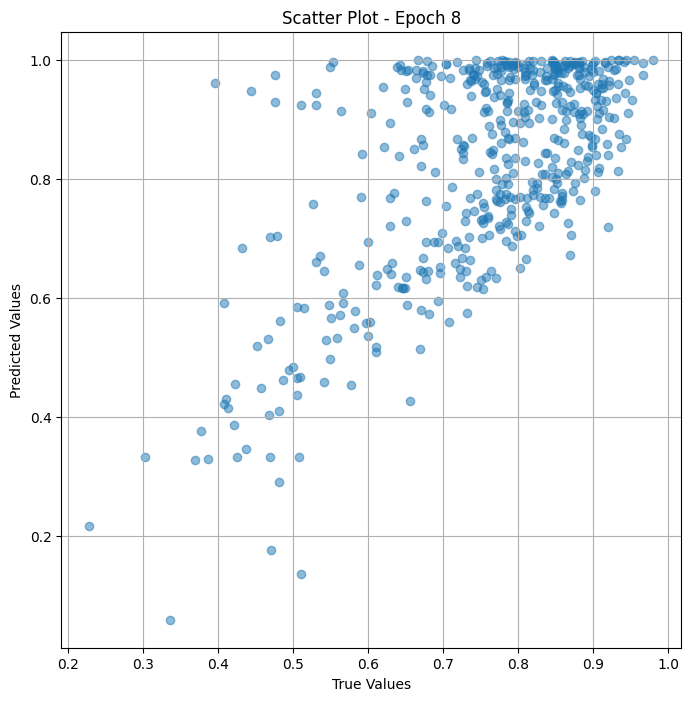


 Epoch: (9/50) Loss = 0.01085717137902975

 Epoch: (9/50) Loss_rmse = 0.10419774800539017

 Epoch: (9/50) R^2 = 0.6809723377227783

 Epoch: (9/50) MAE = 0.05931563675403595

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.

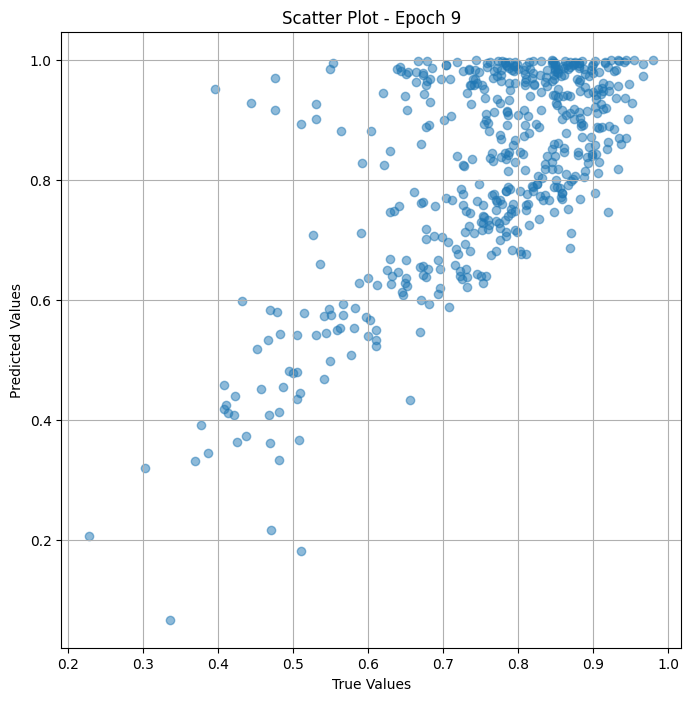


 Epoch: (10/50) Loss = 0.010652623139321804

 Epoch: (10/50) Loss_rmse = 0.10321154445409775

 Epoch: (10/50) R^2 = 0.6869828701019287

 Epoch: (10/50) MAE = 0.058184102177619934

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

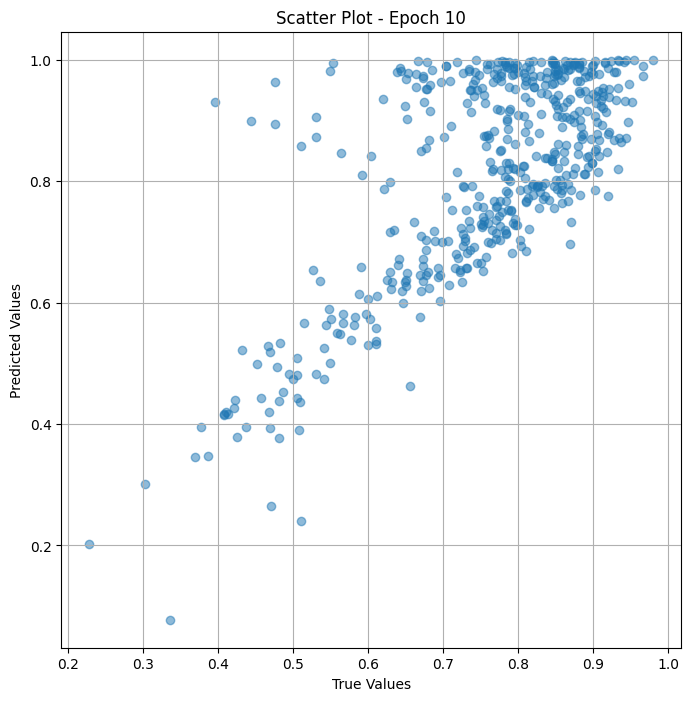


 Epoch: (11/50) Loss = 0.010403024964034557

 Epoch: (11/50) Loss_rmse = 0.10199522227048874

 Epoch: (11/50) R^2 = 0.6943170428276062

 Epoch: (11/50) MAE = 0.055685676634311676

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

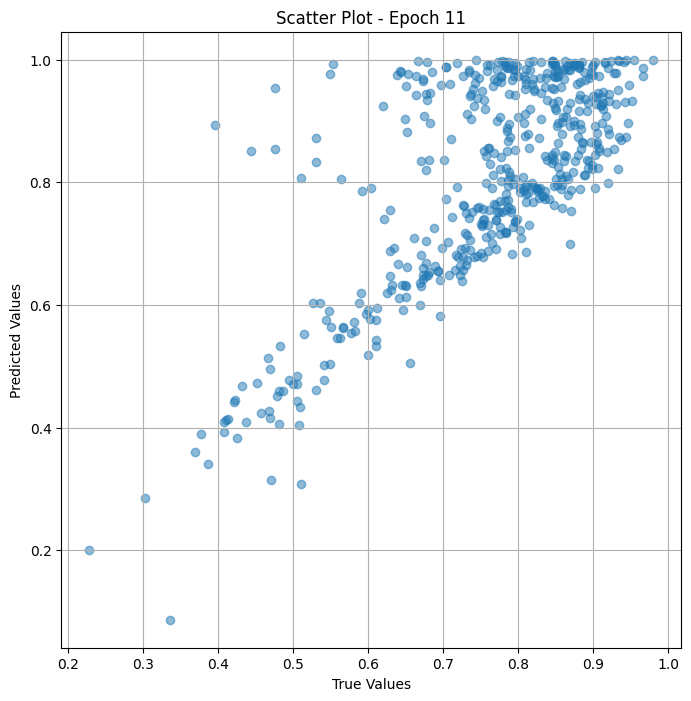


 Epoch: (12/50) Loss = 0.010093768127262592

 Epoch: (12/50) Loss_rmse = 0.100467748939991

 Epoch: (12/50) R^2 = 0.7034042477607727

 Epoch: (12/50) MAE = 0.05429331958293915

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

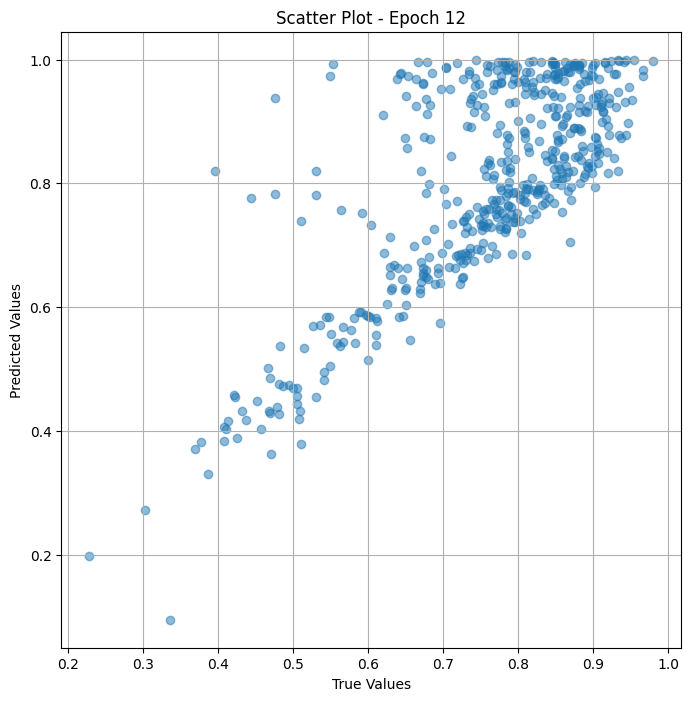


 Epoch: (13/50) Loss = 0.009678497910499573

 Epoch: (13/50) Loss_rmse = 0.09837935864925385

 Epoch: (13/50) R^2 = 0.7156065702438354

 Epoch: (13/50) MAE = 0.05230572074651718

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

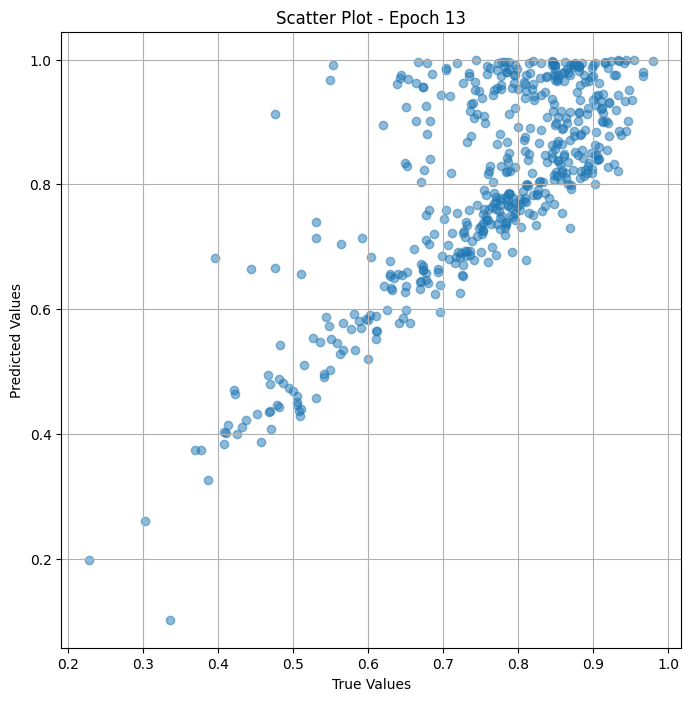


 Epoch: (14/50) Loss = 0.009114162996411324

 Epoch: (14/50) Loss_rmse = 0.09546812623739243

 Epoch: (14/50) R^2 = 0.7321889996528625

 Epoch: (14/50) MAE = 0.051591984927654266

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

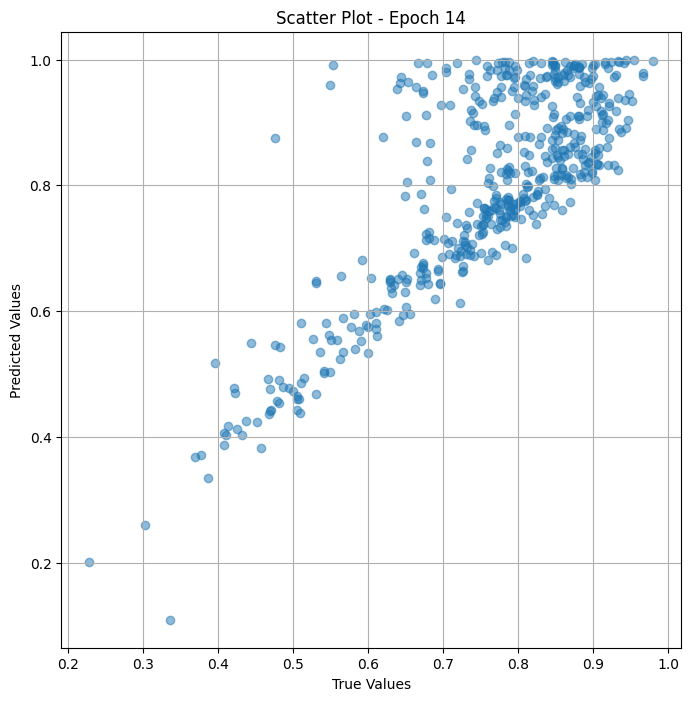


 Epoch: (15/50) Loss = 0.008254828862845898

 Epoch: (15/50) Loss_rmse = 0.09085609018802643

 Epoch: (15/50) R^2 = 0.7574397325515747

 Epoch: (15/50) MAE = 0.050048232078552246

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

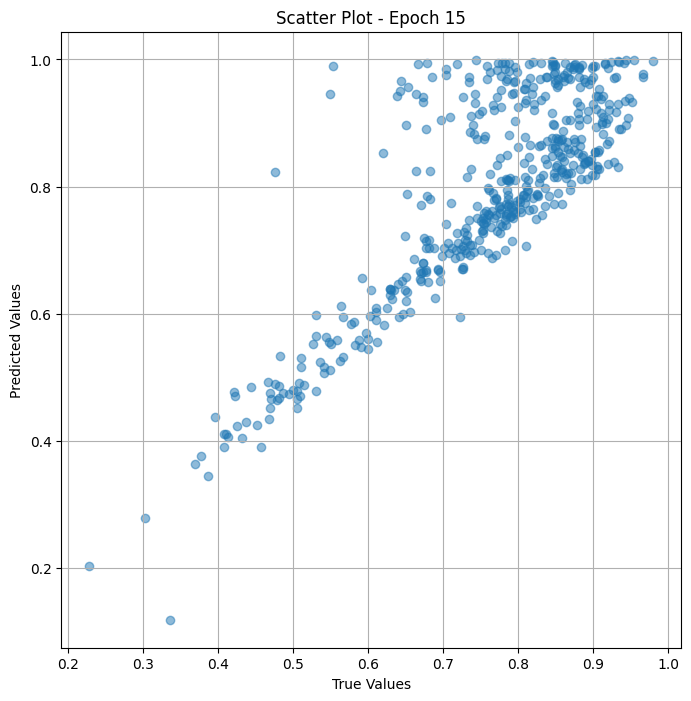


 Epoch: (16/50) Loss = 0.006789723876863718

 Epoch: (16/50) Loss_rmse = 0.08239977806806564

 Epoch: (16/50) R^2 = 0.8004904389381409

 Epoch: (16/50) MAE = 0.04536474496126175

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

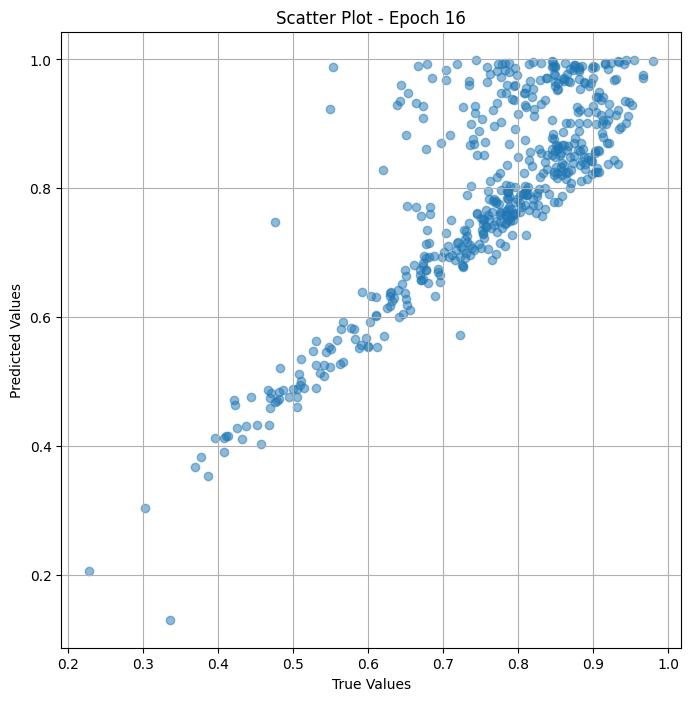


 Epoch: (17/50) Loss = 0.0042410013265907764

 Epoch: (17/50) Loss_rmse = 0.06512296944856644

 Epoch: (17/50) R^2 = 0.8753822445869446

 Epoch: (17/50) MAE = 0.03950340300798416

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

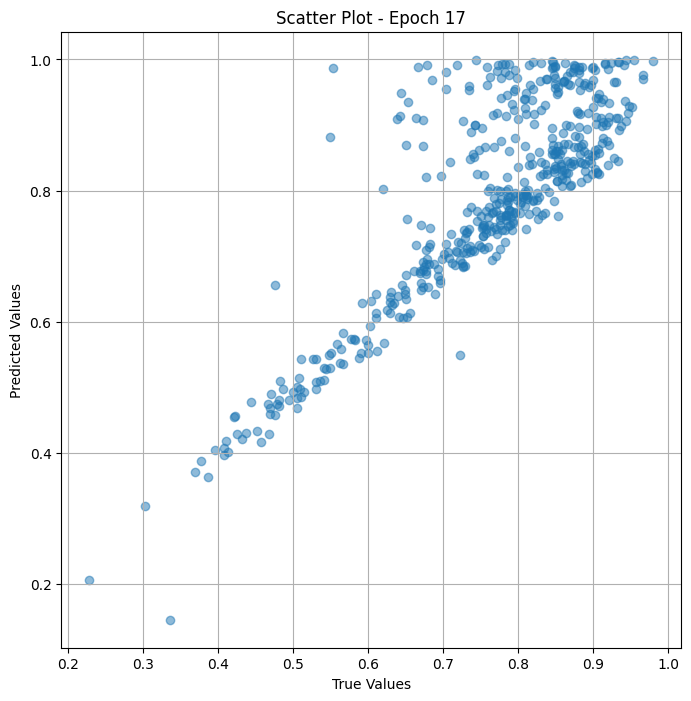


 Epoch: (18/50) Loss = 0.0008351963479071856

 Epoch: (18/50) Loss_rmse = 0.028899764642119408

 Epoch: (18/50) R^2 = 0.975458562374115

 Epoch: (18/50) MAE = 0.019572503864765167

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021

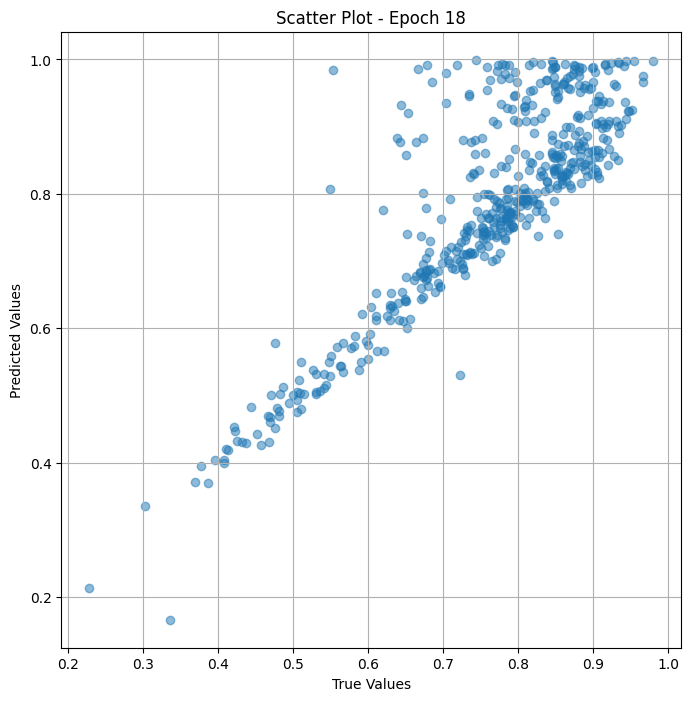


 Epoch: (19/50) Loss = 0.00020712826517410576

 Epoch: (19/50) Loss_rmse = 0.014391951262950897

 Epoch: (19/50) R^2 = 0.9939137101173401

 Epoch: (19/50) MAE = 0.01369178295135498

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702

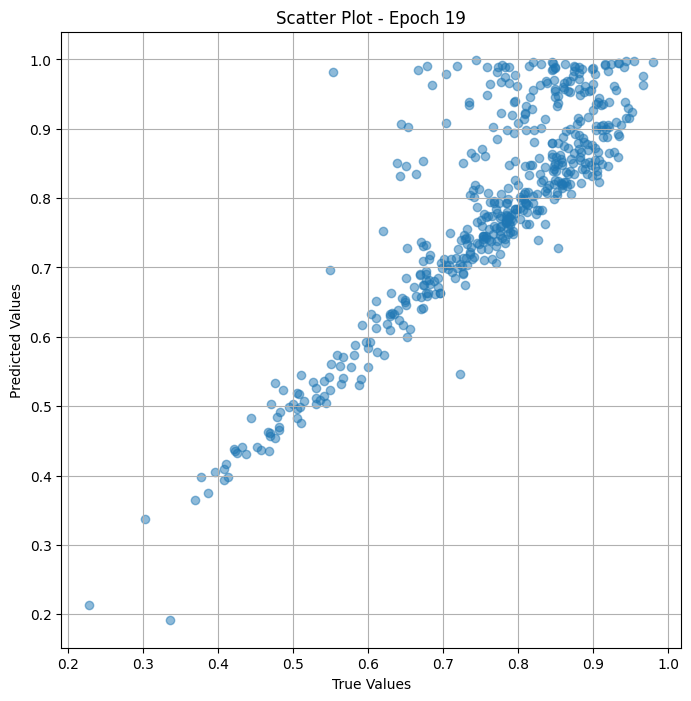


 Epoch: (20/50) Loss = 0.00036352709867060184

 Epoch: (20/50) Loss_rmse = 0.01906638592481613

 Epoch: (20/50) R^2 = 0.9893181324005127

 Epoch: (20/50) MAE = 0.016897529363632202

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702

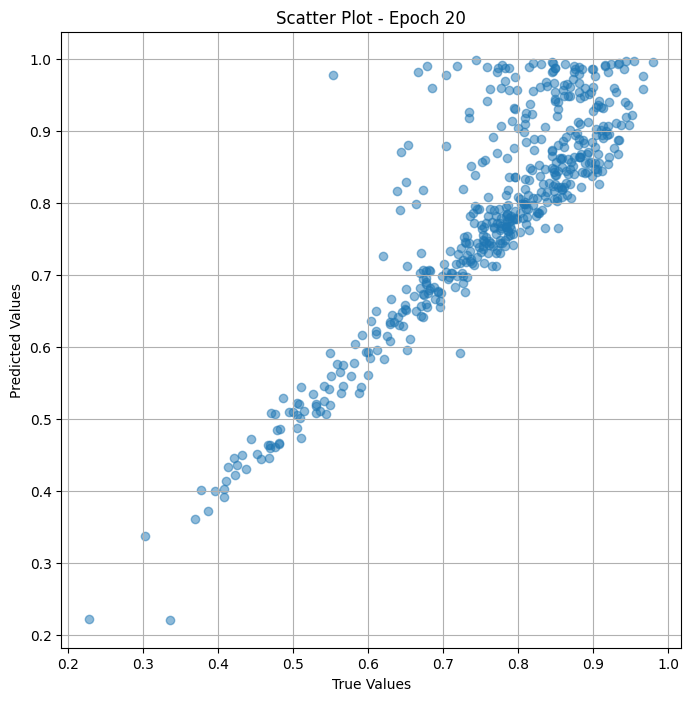


 Epoch: (21/50) Loss = 0.0006472529494203627

 Epoch: (21/50) Loss_rmse = 0.025441166013479233

 Epoch: (21/50) R^2 = 0.9809811115264893

 Epoch: (21/50) MAE = 0.020947381854057312

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702

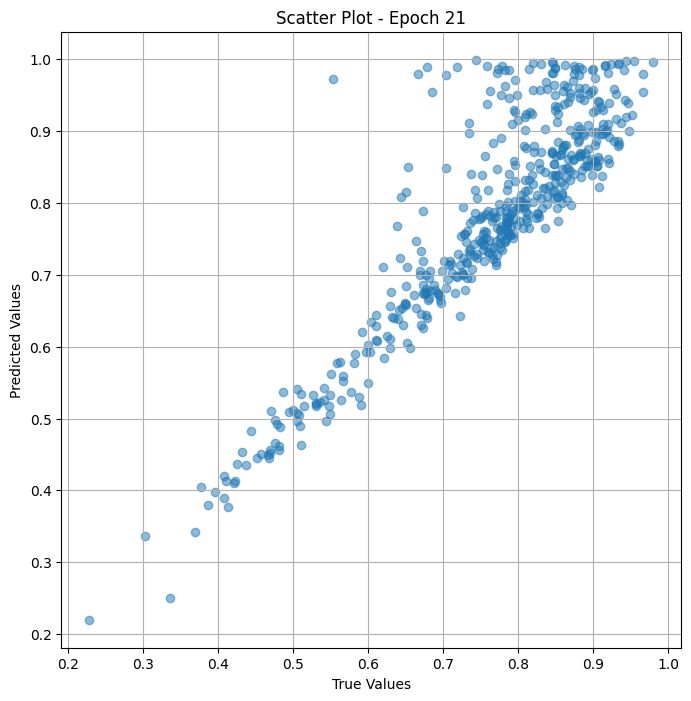


 Epoch: (22/50) Loss = 0.0015312636969611049

 Epoch: (22/50) Loss_rmse = 0.03913136571645737

 Epoch: (22/50) R^2 = 0.9550052881240845

 Epoch: (22/50) MAE = 0.033139899373054504

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021

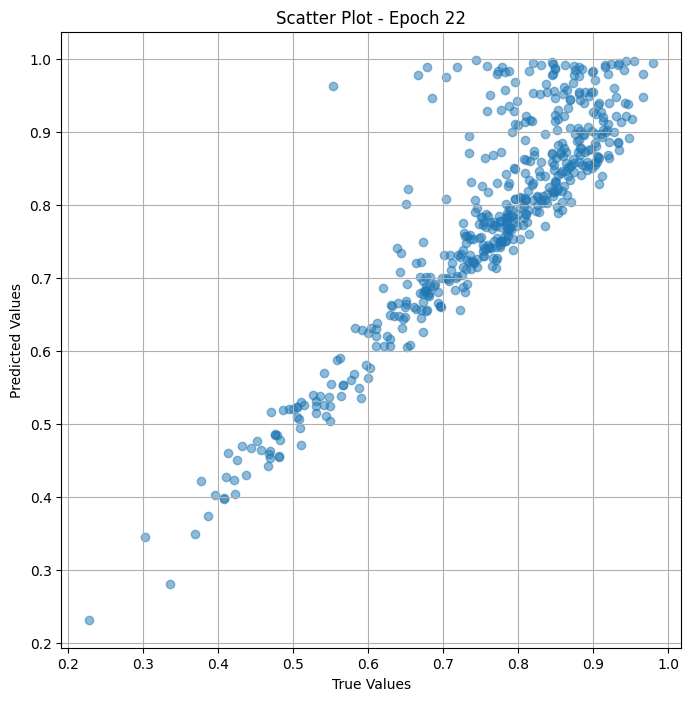


 Epoch: (23/50) Loss = 0.001714897807687521

 Epoch: (23/50) Loss_rmse = 0.041411325335502625

 Epoch: (23/50) R^2 = 0.9496093392372131

 Epoch: (23/50) MAE = 0.030030064284801483

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021

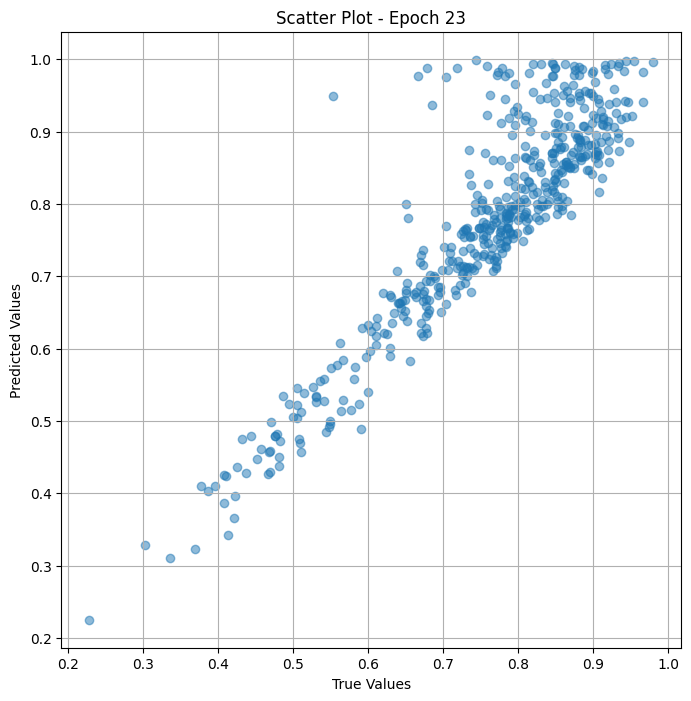


 Epoch: (24/50) Loss = 0.004549146629869938

 Epoch: (24/50) Loss_rmse = 0.06744736433029175

 Epoch: (24/50) R^2 = 0.8663276433944702

 Epoch: (24/50) MAE = 0.052864305675029755

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

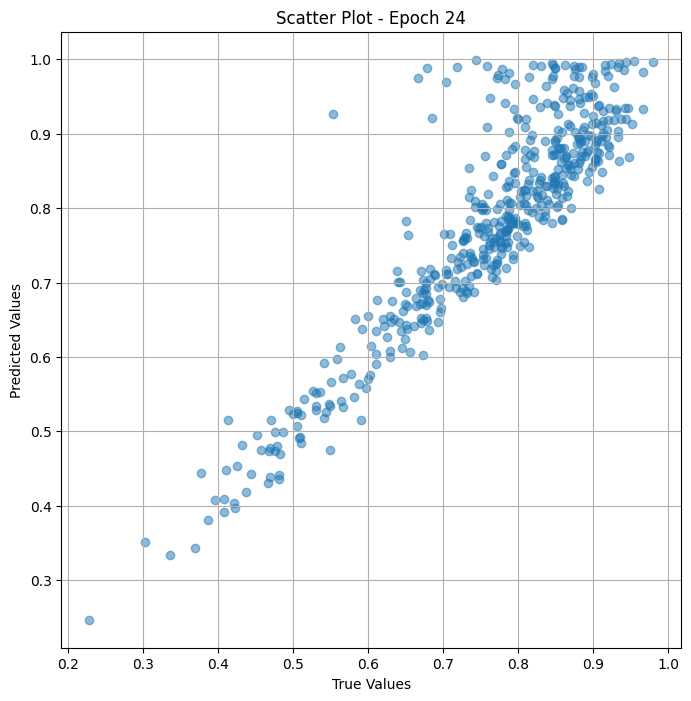


 Epoch: (25/50) Loss = 0.005030389409512281

 Epoch: (25/50) Loss_rmse = 0.07092523574829102

 Epoch: (25/50) R^2 = 0.8521867990493774

 Epoch: (25/50) MAE = 0.046869389712810516

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

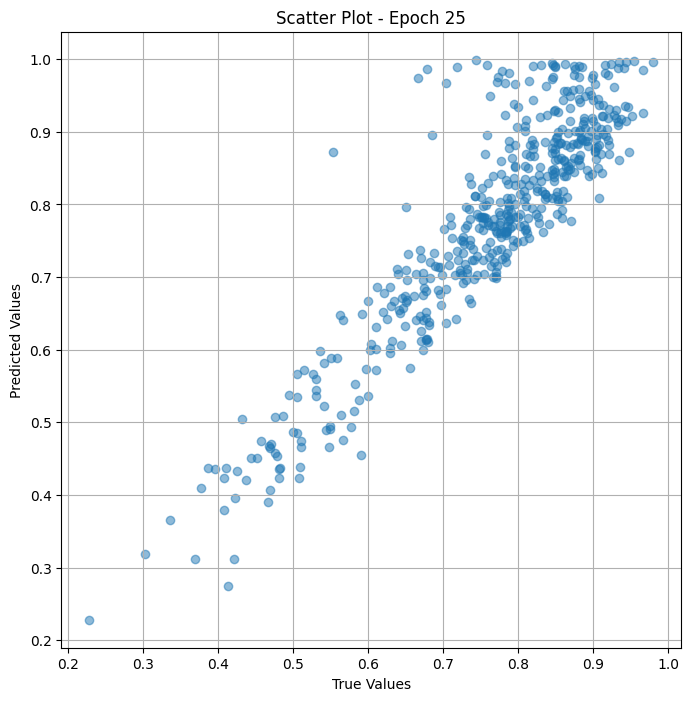


 Epoch: (26/50) Loss = 0.00901442114263773

 Epoch: (26/50) Loss_rmse = 0.0949443057179451

 Epoch: (26/50) R^2 = 0.7351198196411133

 Epoch: (26/50) MAE = 0.06714994460344315

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

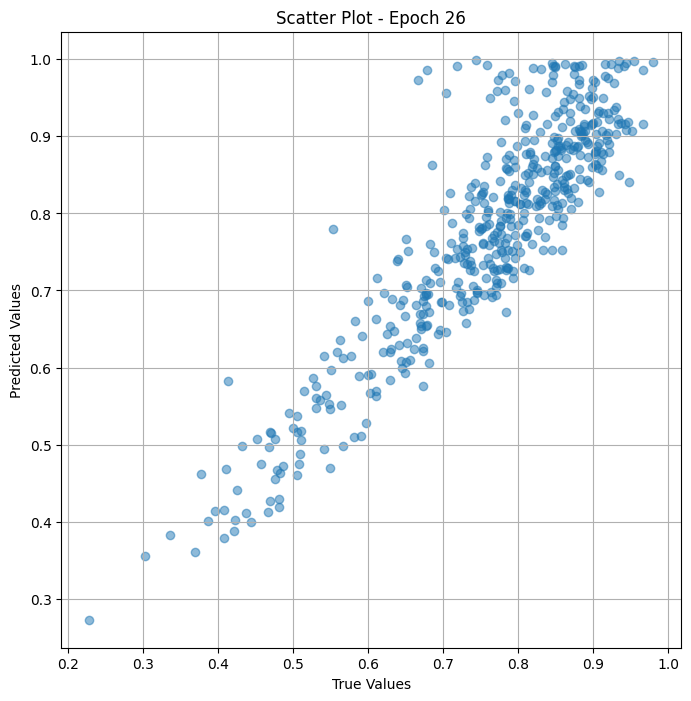


 Epoch: (27/50) Loss = 0.008975142613053322

 Epoch: (27/50) Loss_rmse = 0.0947372317314148

 Epoch: (27/50) R^2 = 0.736274003982544

 Epoch: (27/50) MAE = 0.05729852244257927

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

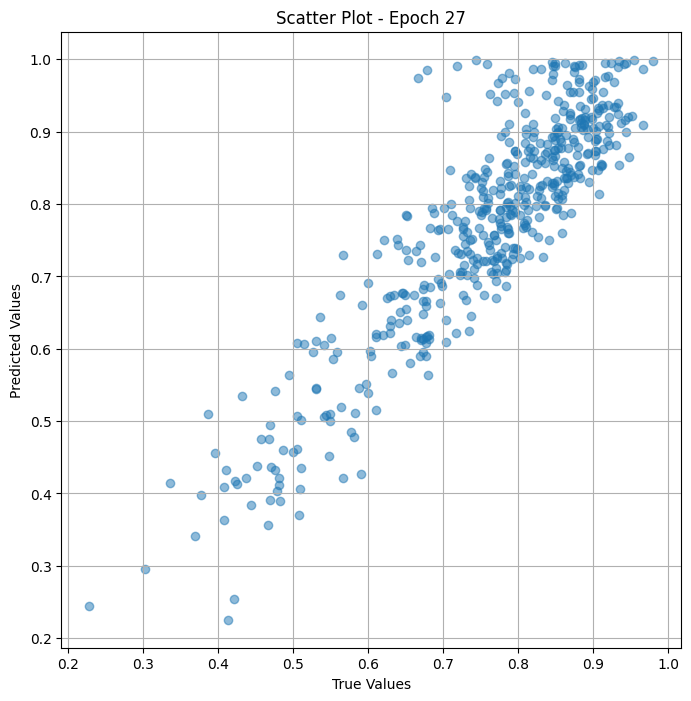


 Epoch: (28/50) Loss = 0.008008565753698349

 Epoch: (28/50) Loss_rmse = 0.08949059247970581

 Epoch: (28/50) R^2 = 0.7646759152412415

 Epoch: (28/50) MAE = 0.075531505048275

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

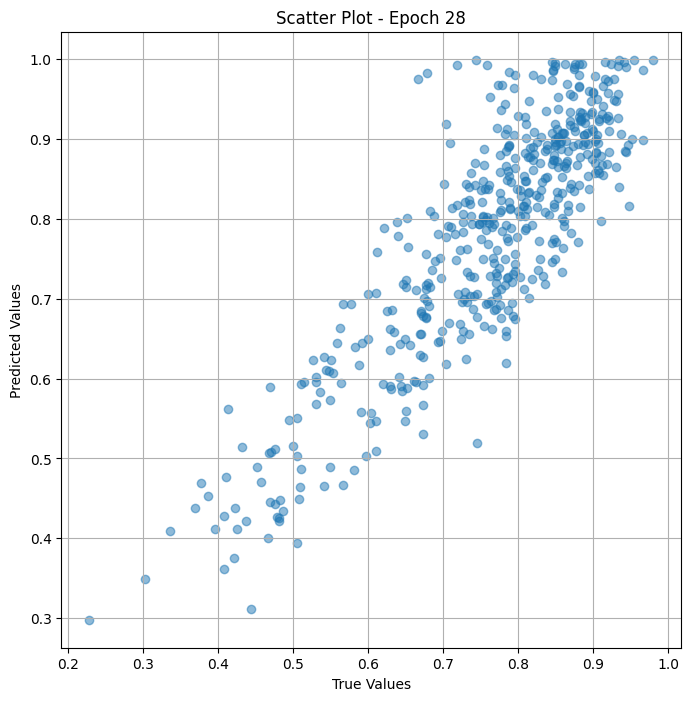


 Epoch: (29/50) Loss = 0.0044795130379498005

 Epoch: (29/50) Loss_rmse = 0.0669291615486145

 Epoch: (29/50) R^2 = 0.8683737516403198

 Epoch: (29/50) MAE = 0.05591265857219696

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

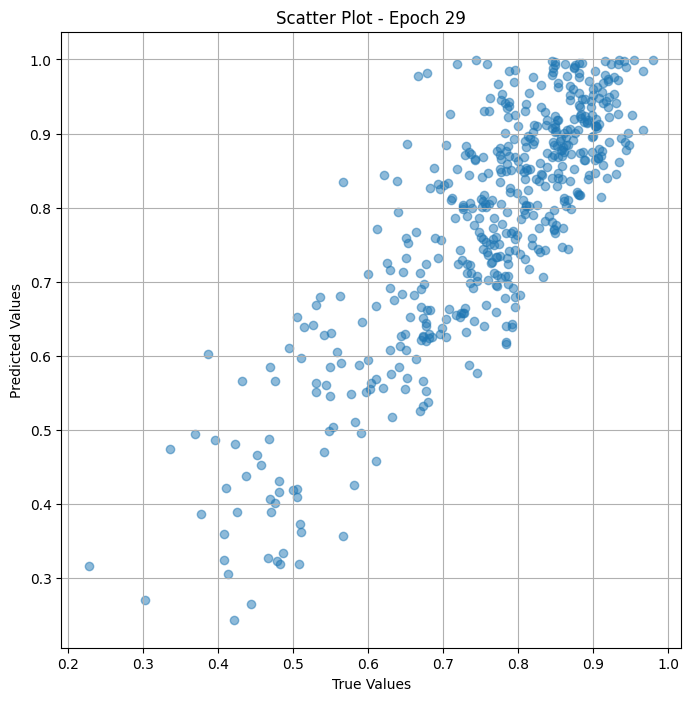


 Epoch: (30/50) Loss = 0.02091604843735695

 Epoch: (30/50) Loss_rmse = 0.14462381601333618

 Epoch: (30/50) R^2 = 0.3854018449783325

 Epoch: (30/50) MAE = 0.1305047571659088

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

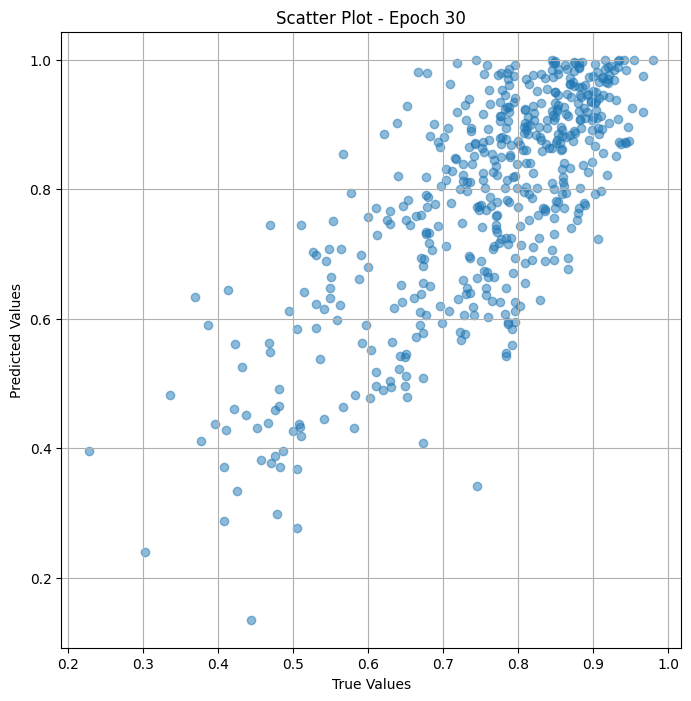


 Epoch: (31/50) Loss = 0.013173295184969902

 Epoch: (31/50) Loss_rmse = 0.11477497965097427

 Epoch: (31/50) R^2 = 0.6129152774810791

 Epoch: (31/50) MAE = 0.11210838705301285

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

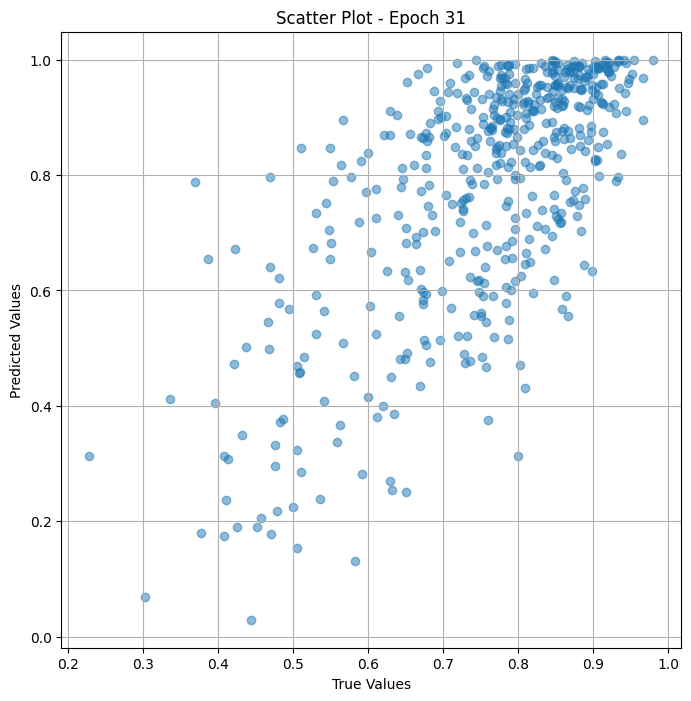


 Epoch: (32/50) Loss = 0.09848591685295105

 Epoch: (32/50) Loss_rmse = 0.3138246536254883

 Epoch: (32/50) R^2 = -1.8939146995544434

 Epoch: (32/50) MAE = 0.2724404036998749

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

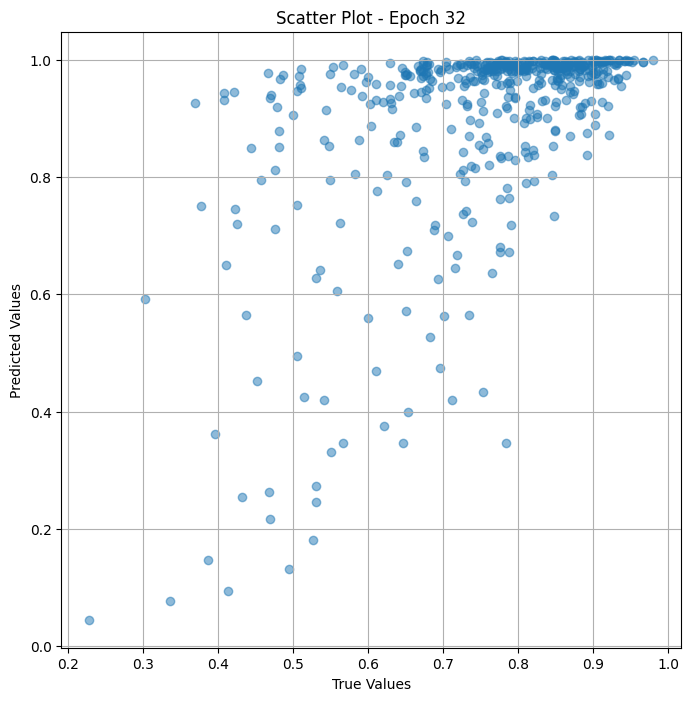


 Epoch: (33/50) Loss = 0.02561715431511402

 Epoch: (33/50) Loss_rmse = 0.16005359590053558

 Epoch: (33/50) R^2 = 0.2472643256187439

 Epoch: (33/50) MAE = 0.13090640306472778

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

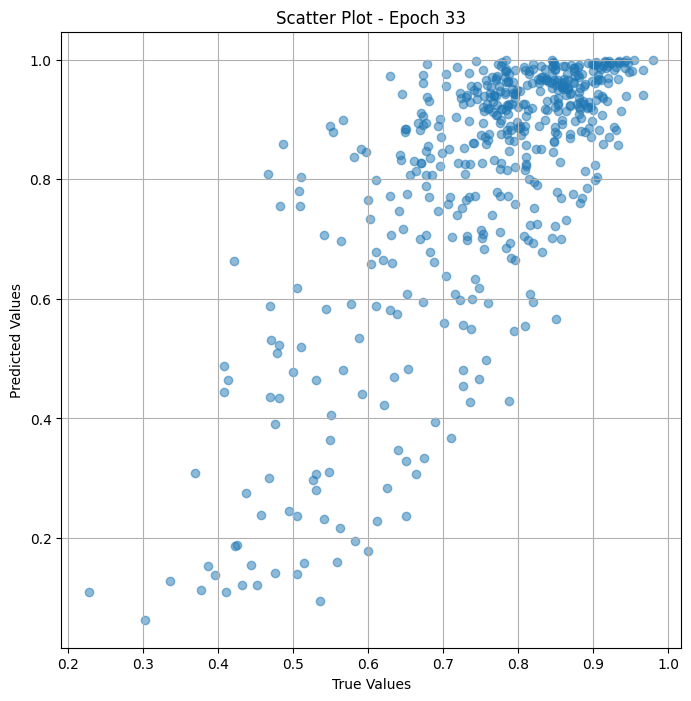


 Epoch: (34/50) Loss = 0.03104465827345848

 Epoch: (34/50) Loss_rmse = 0.1761949509382248

 Epoch: (34/50) R^2 = 0.08778232336044312

 Epoch: (34/50) MAE = 0.16715849936008453

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

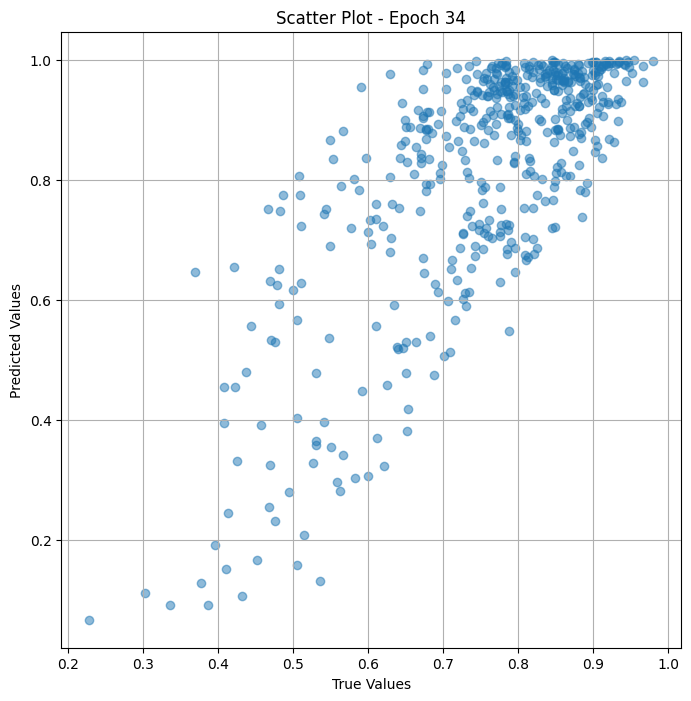


 Epoch: (35/50) Loss = 0.01935175433754921

 Epoch: (35/50) Loss_rmse = 0.13911058008670807

 Epoch: (35/50) R^2 = 0.4313671588897705

 Epoch: (35/50) MAE = 0.11448534578084946

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

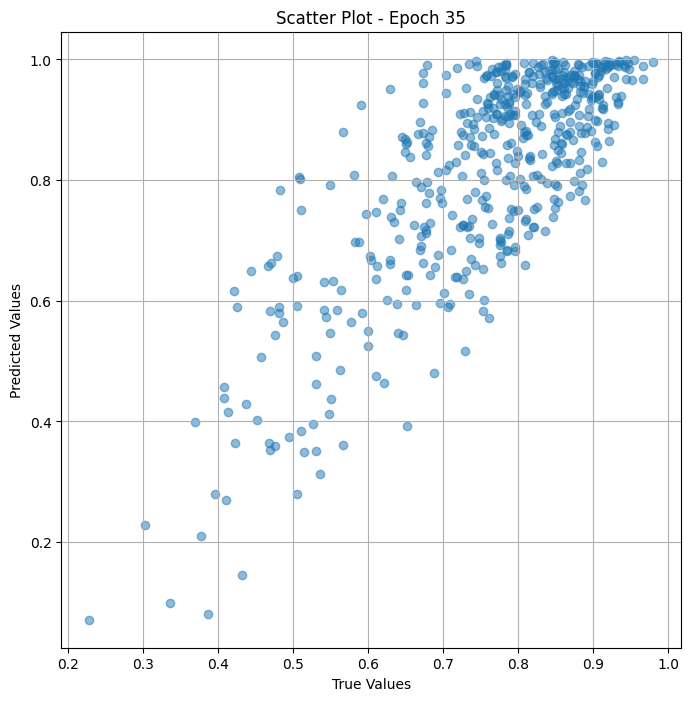


 Epoch: (36/50) Loss = 0.013280913233757019

 Epoch: (36/50) Loss_rmse = 0.1152428463101387

 Epoch: (36/50) R^2 = 0.6097530126571655

 Epoch: (36/50) MAE = 0.09211985766887665

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

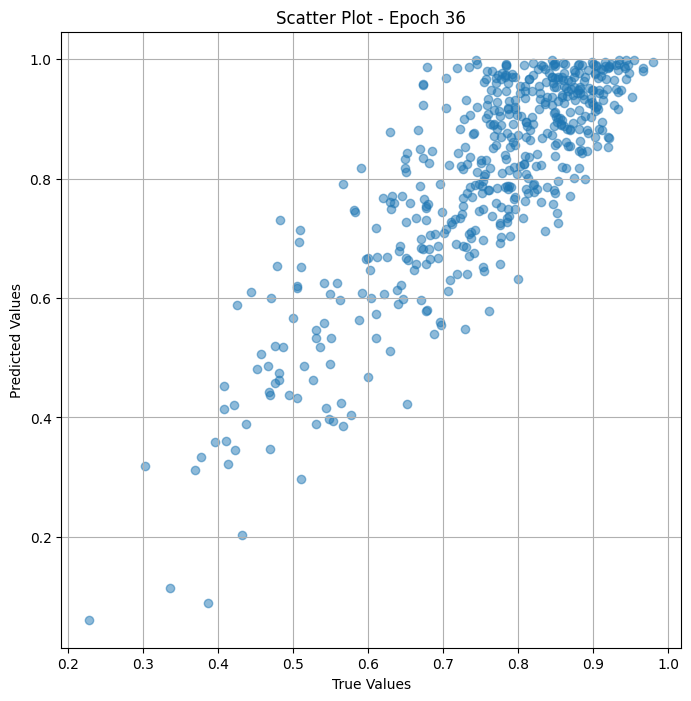


 Epoch: (37/50) Loss = 0.012800688855350018

 Epoch: (37/50) Loss_rmse = 0.11314012855291367

 Epoch: (37/50) R^2 = 0.623863935470581

 Epoch: (37/50) MAE = 0.09107024222612381

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

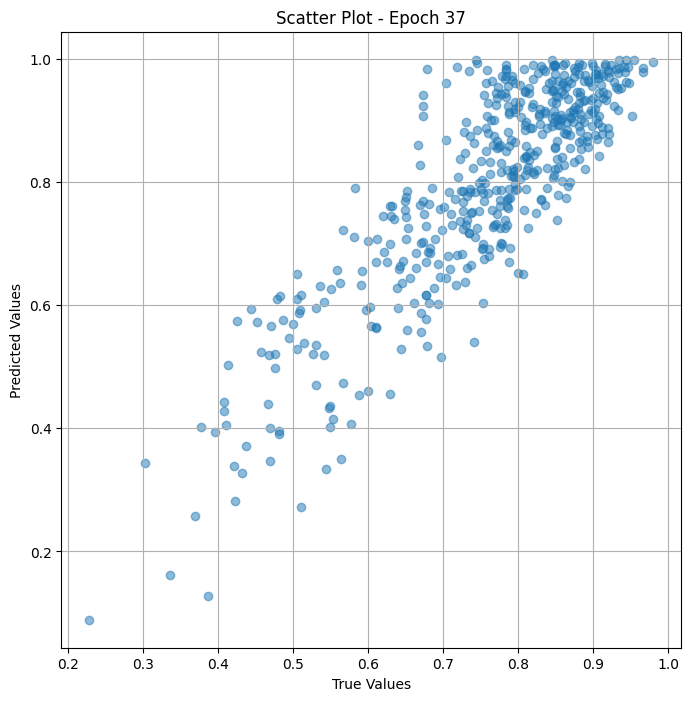


 Epoch: (38/50) Loss = 0.011793948709964752

 Epoch: (38/50) Loss_rmse = 0.1085999459028244

 Epoch: (38/50) R^2 = 0.6534460783004761

 Epoch: (38/50) MAE = 0.0867639034986496

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

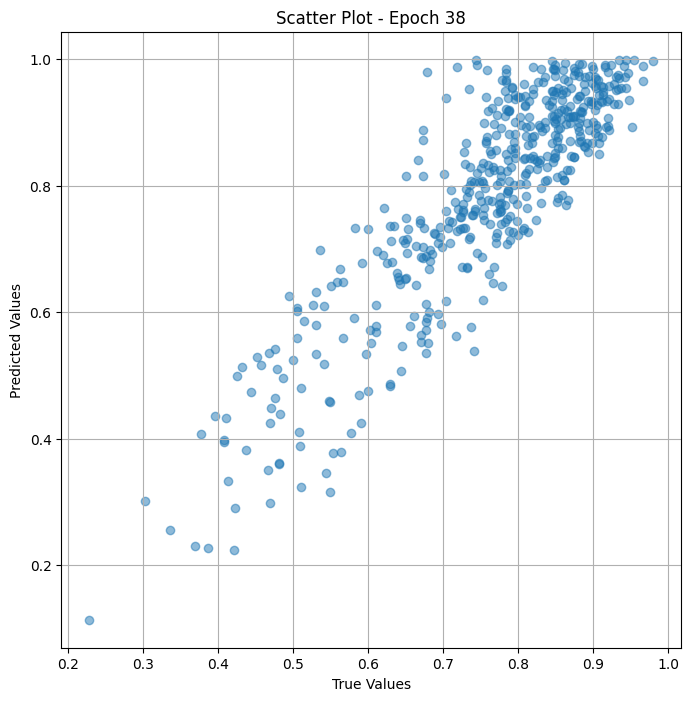


 Epoch: (39/50) Loss = 0.01666516438126564

 Epoch: (39/50) Loss_rmse = 0.12909363210201263

 Epoch: (39/50) R^2 = 0.5103100538253784

 Epoch: (39/50) MAE = 0.10329262167215347

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

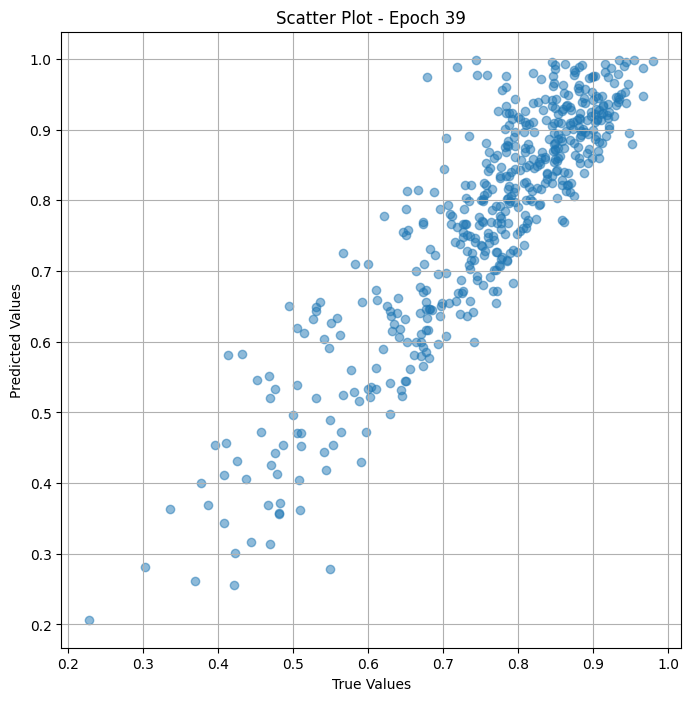


 Epoch: (40/50) Loss = 0.012548276223242283

 Epoch: (40/50) Loss_rmse = 0.11201909184455872

 Epoch: (40/50) R^2 = 0.6312808990478516

 Epoch: (40/50) MAE = 0.09626709669828415

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

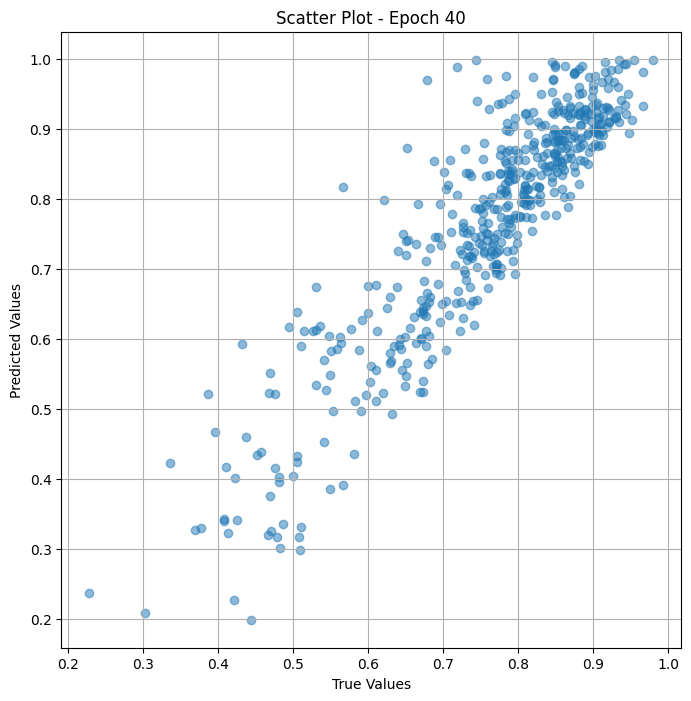


 Epoch: (41/50) Loss = 0.019079124554991722

 Epoch: (41/50) Loss_rmse = 0.13812720775604248

 Epoch: (41/50) R^2 = 0.43937814235687256

 Epoch: (41/50) MAE = 0.12221697717905045

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

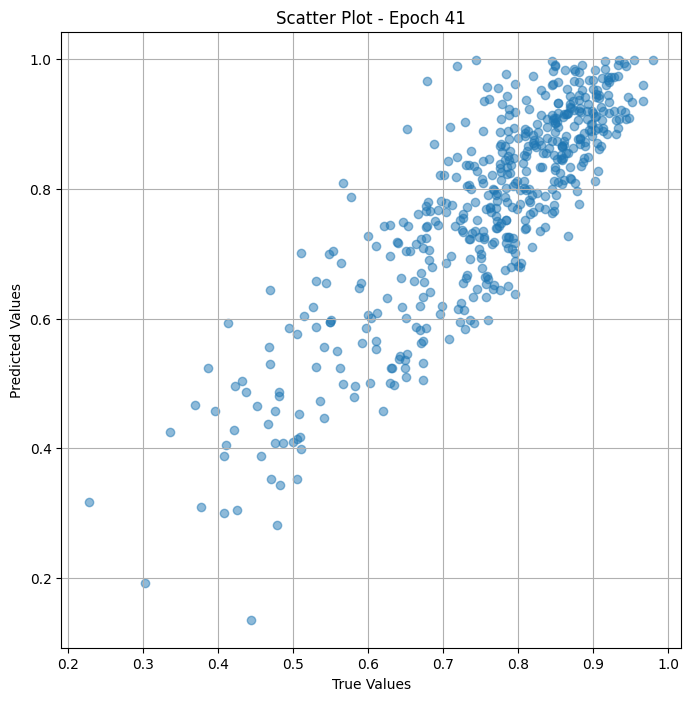


 Epoch: (42/50) Loss = 0.01338576152920723

 Epoch: (42/50) Loss_rmse = 0.11569685488939285

 Epoch: (42/50) R^2 = 0.6066721677780151

 Epoch: (42/50) MAE = 0.10117145627737045

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

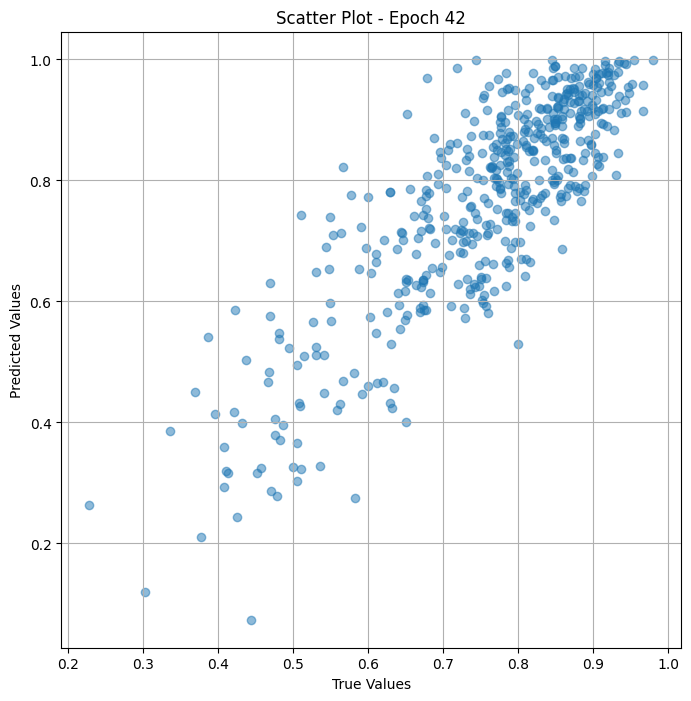


 Epoch: (43/50) Loss = 0.011025367304682732

 Epoch: (43/50) Loss_rmse = 0.10500174760818481

 Epoch: (43/50) R^2 = 0.6760300993919373

 Epoch: (43/50) MAE = 0.08731307834386826

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

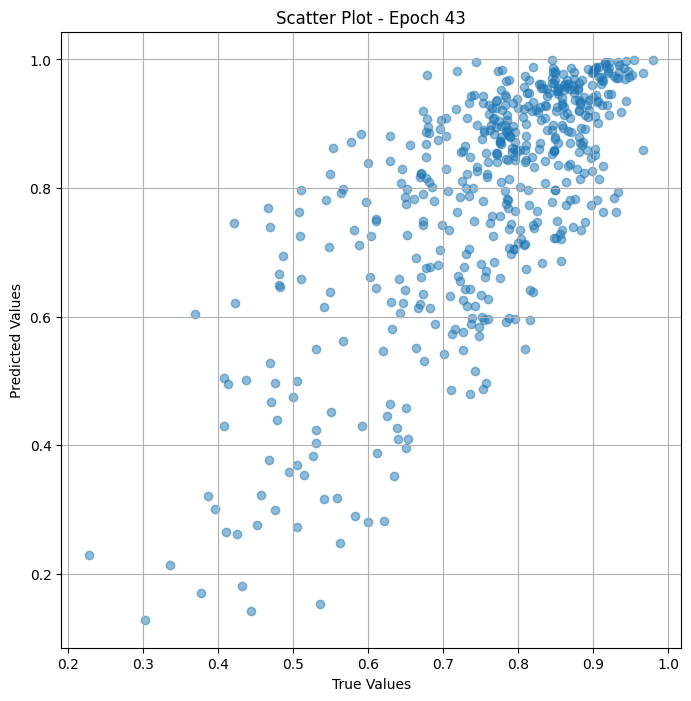


 Epoch: (44/50) Loss = 0.03225424885749817

 Epoch: (44/50) Loss_rmse = 0.17959468066692352

 Epoch: (44/50) R^2 = 0.05223965644836426

 Epoch: (44/50) MAE = 0.14684119820594788

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

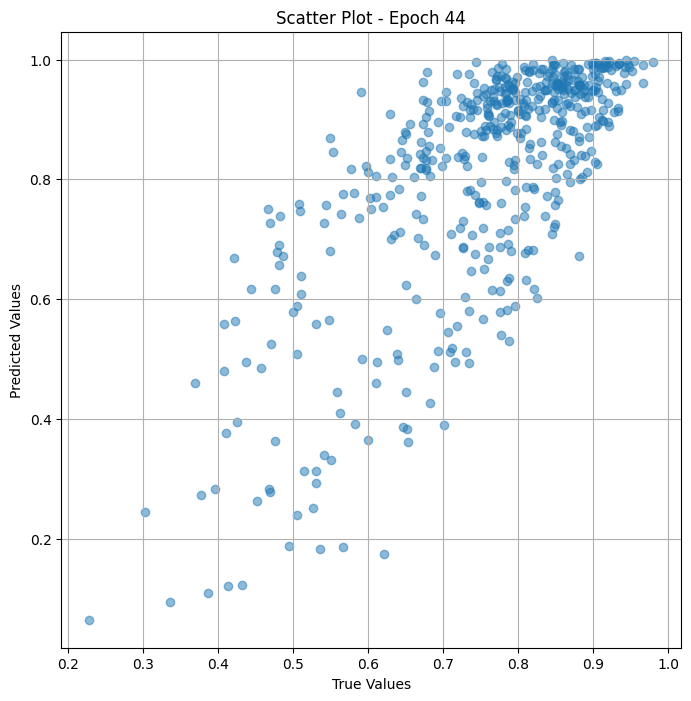


 Epoch: (45/50) Loss = 0.029033517464995384

 Epoch: (45/50) Loss_rmse = 0.170392245054245

 Epoch: (45/50) R^2 = 0.14687776565551758

 Epoch: (45/50) MAE = 0.15792453289031982

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

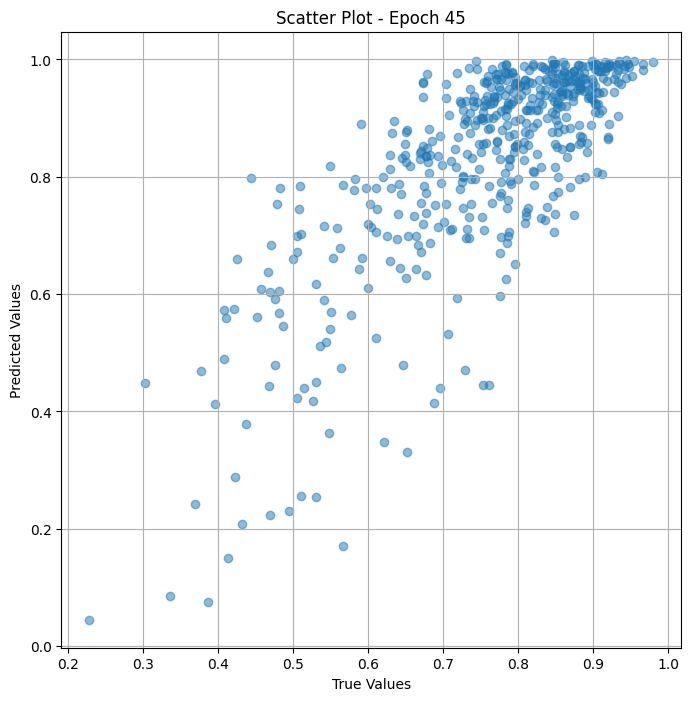


 Epoch: (46/50) Loss = 0.008811195380985737

 Epoch: (46/50) Loss_rmse = 0.0938679650425911

 Epoch: (46/50) R^2 = 0.7410914301872253

 Epoch: (46/50) MAE = 0.06587405502796173

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

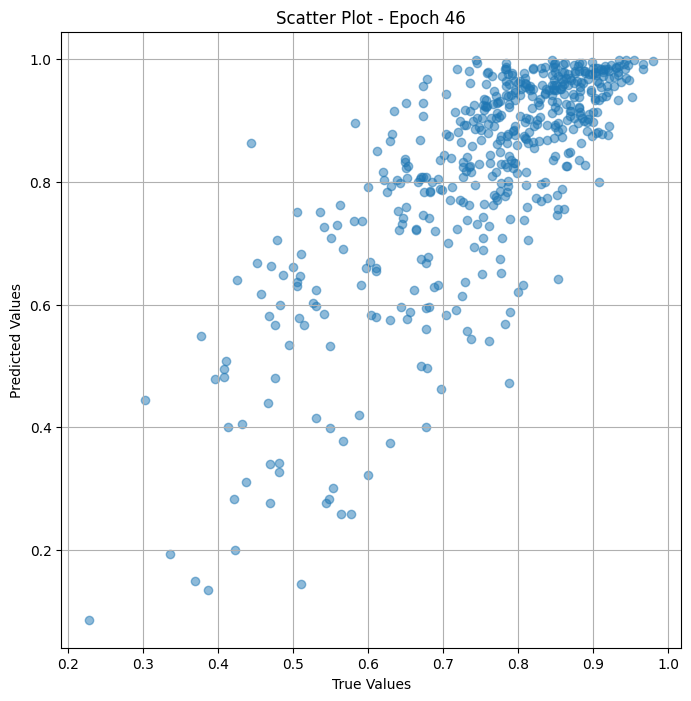


 Epoch: (47/50) Loss = 0.013804552145302296

 Epoch: (47/50) Loss_rmse = 0.11749277263879776

 Epoch: (47/50) R^2 = 0.5943664312362671

 Epoch: (47/50) MAE = 0.10916847735643387

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

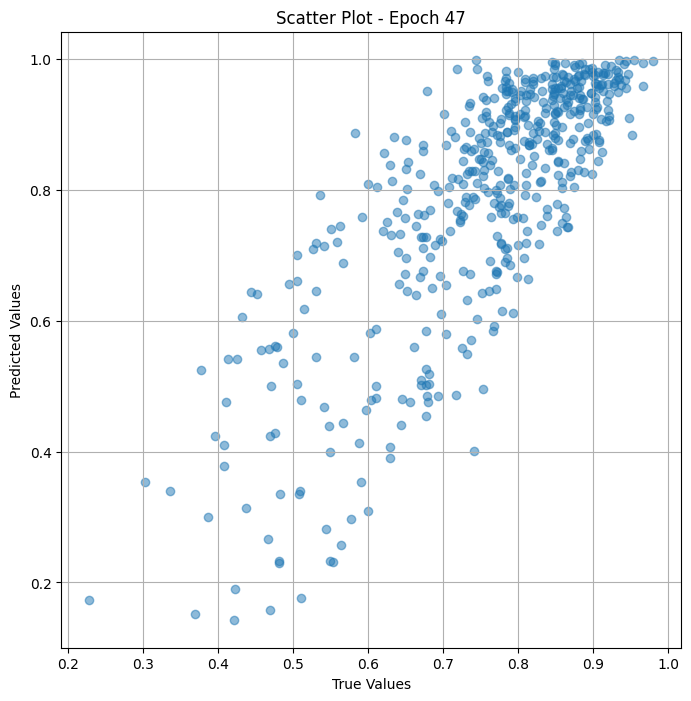


 Epoch: (48/50) Loss = 0.008809082210063934

 Epoch: (48/50) Loss_rmse = 0.09385671466588974

 Epoch: (48/50) R^2 = 0.7411534786224365

 Epoch: (48/50) MAE = 0.07824230939149857

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

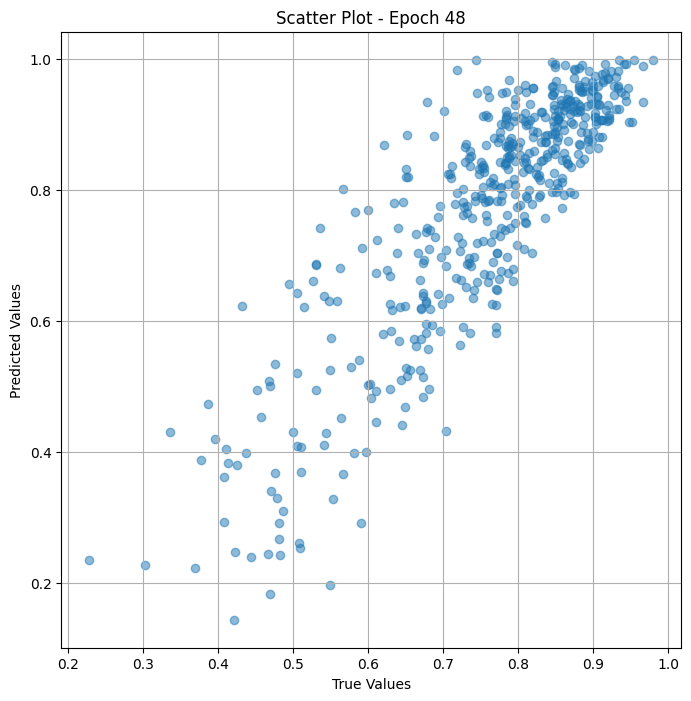


 Epoch: (49/50) Loss = 0.012275688350200653

 Epoch: (49/50) Loss_rmse = 0.11079570651054382

 Epoch: (49/50) R^2 = 0.6392905712127686

 Epoch: (49/50) MAE = 0.09813409298658371

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

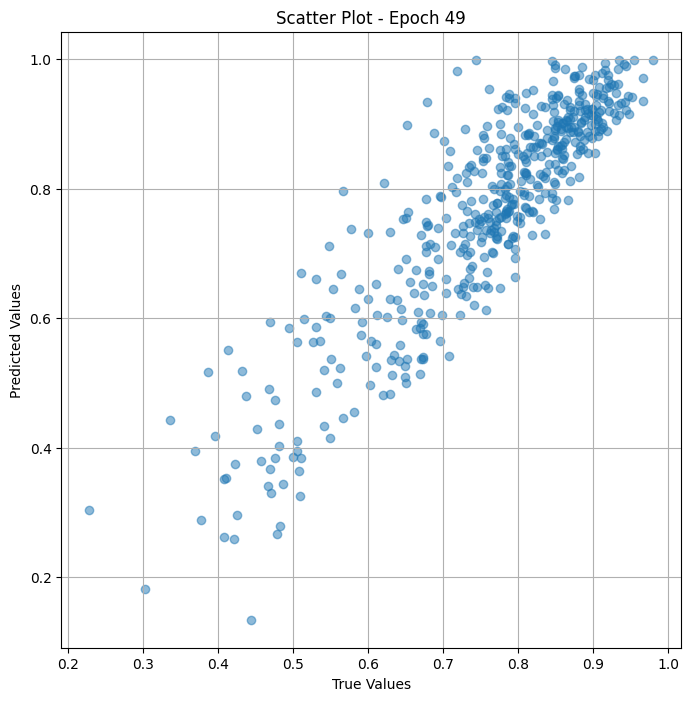


 Epoch: (50/50) Loss = 0.008310058154165745

 Epoch: (50/50) Loss_rmse = 0.09115952253341675

 Epoch: (50/50) R^2 = 0.7558168768882751

 Epoch: (50/50) MAE = 0.07957768440246582

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

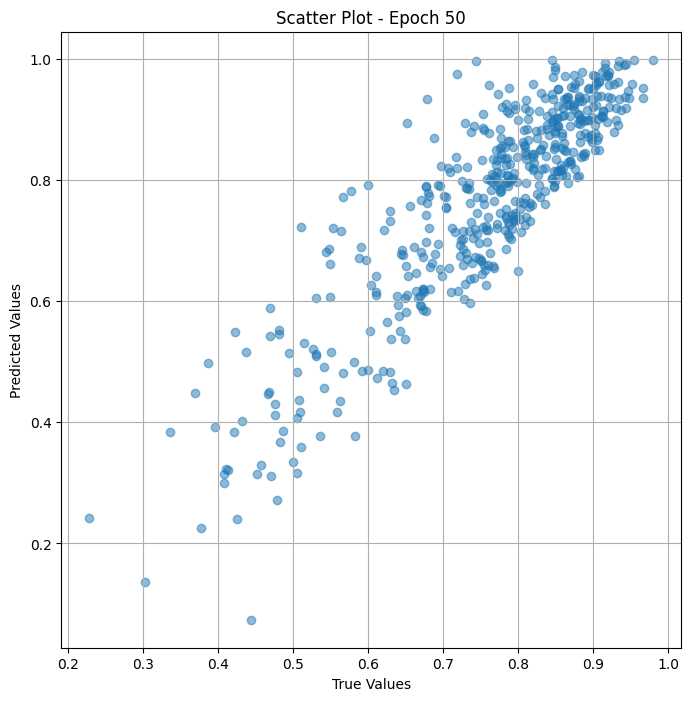

In [ ]:
# Training the model and save weights
fit(50, model_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_vr_val")

## Test

In [ ]:
class Dataset_test_merge(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_test_merge(df_test_merge, trans_transform=trans_transform, res_transform=res_transform)
train_dl_test = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_test = model_merge_test(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_test = to_device(model_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_test.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

# Fit function doing grad steps
def fit(epochs, model_test, train_dl_test):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()

    for epoch in range(epochs):
        model_test.eval()
        batch_num = 16
        true_values_list = []
        predicted_values_list = []
        for x_trans, x_res, yb in train_dl_test:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_test(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())

            loss.backward()
            opt.step()
            opt.zero_grad()

            total_loss += loss.item()
            total_loss_rmse += loss_rmse.item()
            total_r2 += r2.item()
            total_mae += mae.item()
            #total_spearman += spearman_corr

            # Increment batch number
            #print('\r', f'batch #{batch_num}: {loss}', end='')
            batch_num += 5

        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        #print('\n', f'Epoch: ({epoch+1}/{epochs}) Spearman = {mean_spearman}')
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        # Plot scatter plot after each epoch
        plot_scatter(true_values_list, predicted_values_list, epoch)


 Epoch: (1/50) Loss = 0.2206411510705948

 Epoch: (1/50) Loss_rmse = 0.46972453594207764

 Epoch: (1/50) R^2 = -87.883056640625

 Epoch: (1/50) MAE = 0.3832279443740845

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575, 0.7

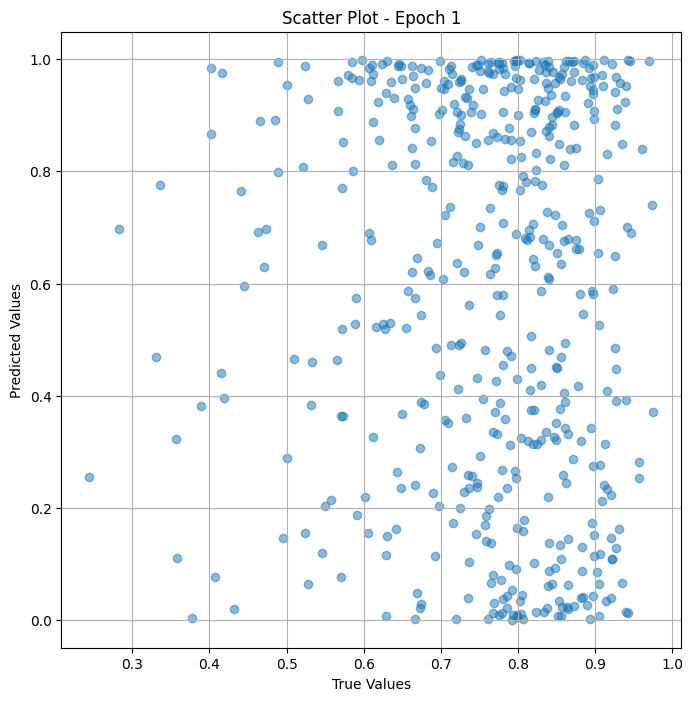


 Epoch: (2/50) Loss = 0.08875931799411774

 Epoch: (2/50) Loss_rmse = 0.29792502522468567

 Epoch: (2/50) R^2 = -34.755794525146484

 Epoch: (2/50) MAE = 0.2310655266046524

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575,

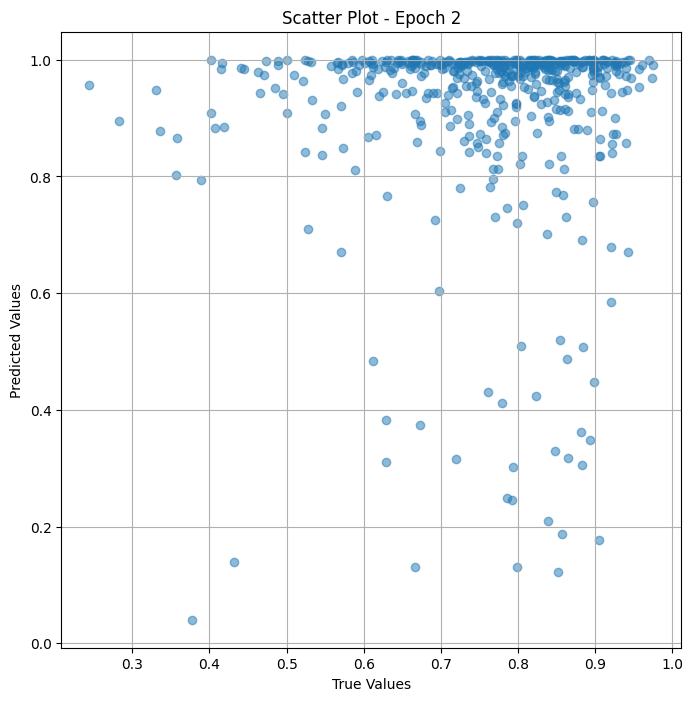


 Epoch: (3/50) Loss = 0.015077034011483192

 Epoch: (3/50) Loss_rmse = 0.12278857082128525

 Epoch: (3/50) R^2 = -5.0736308097839355

 Epoch: (3/50) MAE = 0.1065593957901001

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

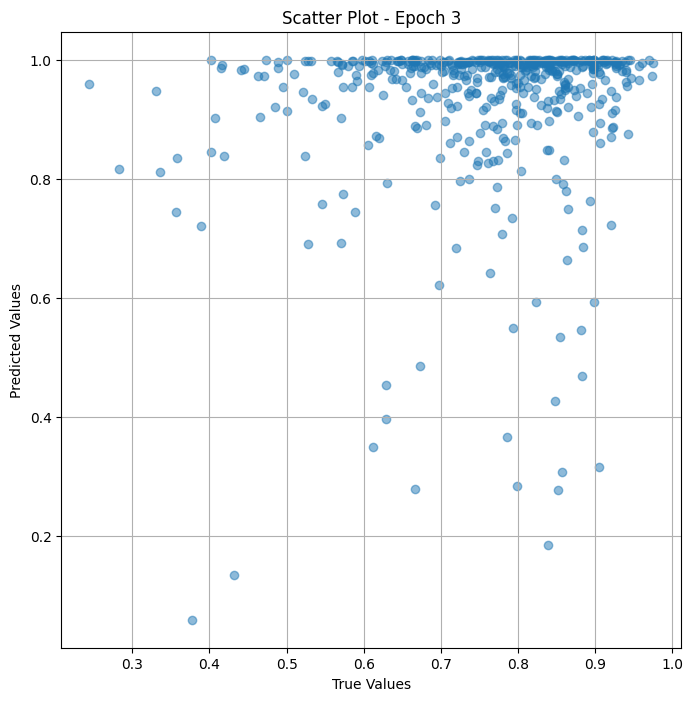


 Epoch: (4/50) Loss = 0.012396941892802715

 Epoch: (4/50) Loss_rmse = 0.11134155839681625

 Epoch: (4/50) R^2 = -3.9939827919006348

 Epoch: (4/50) MAE = 0.09940752387046814

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575757

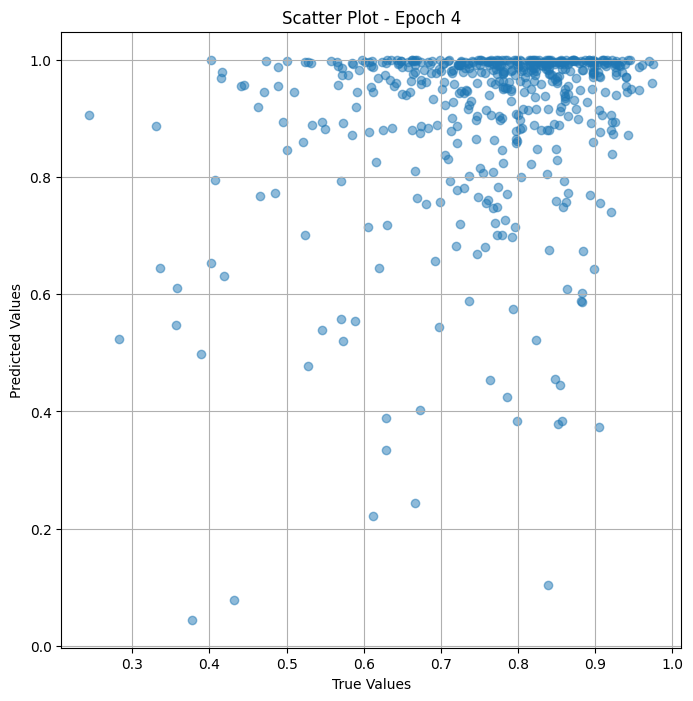


 Epoch: (5/50) Loss = 0.009581196121871471

 Epoch: (5/50) Loss_rmse = 0.09788358211517334

 Epoch: (5/50) R^2 = -2.8596880435943604

 Epoch: (5/50) MAE = 0.07506886124610901

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575757

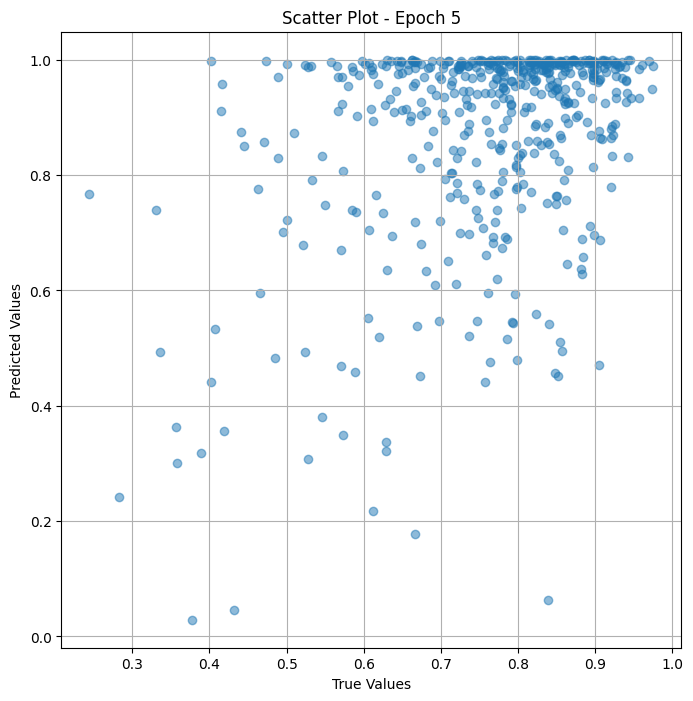


 Epoch: (6/50) Loss = 0.009155793115496635

 Epoch: (6/50) Loss_rmse = 0.09568590670824051

 Epoch: (6/50) R^2 = -2.6883187294006348

 Epoch: (6/50) MAE = 0.06956949830055237

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575757

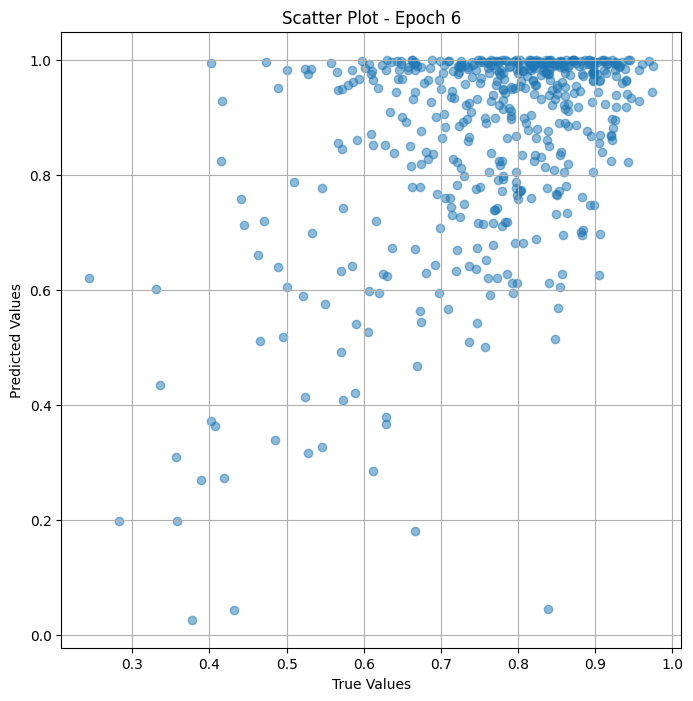


 Epoch: (7/50) Loss = 0.008911904878914356

 Epoch: (7/50) Loss_rmse = 0.09440288692712784

 Epoch: (7/50) R^2 = -2.5900707244873047

 Epoch: (7/50) MAE = 0.0656660944223404

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

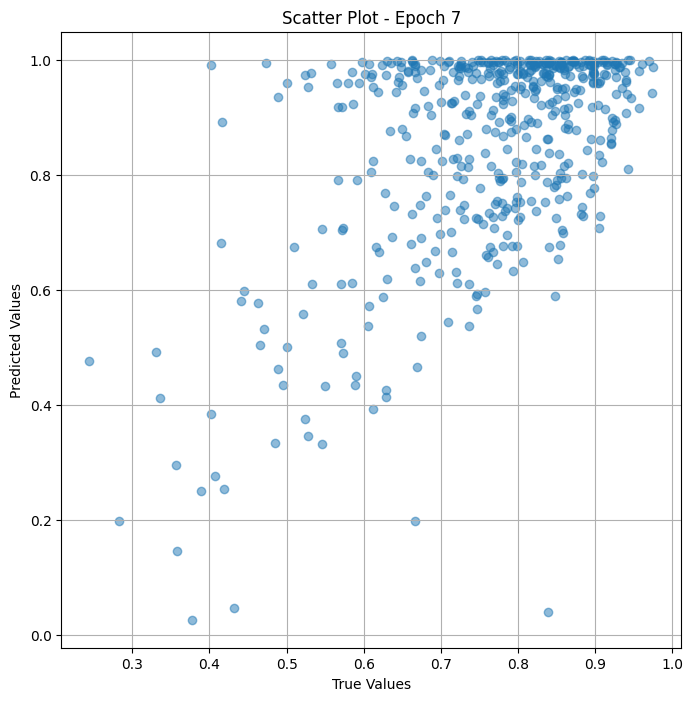


 Epoch: (8/50) Loss = 0.008585868403315544

 Epoch: (8/50) Loss_rmse = 0.09265995770692825

 Epoch: (8/50) R^2 = -2.4587302207946777

 Epoch: (8/50) MAE = 0.0582805871963501

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

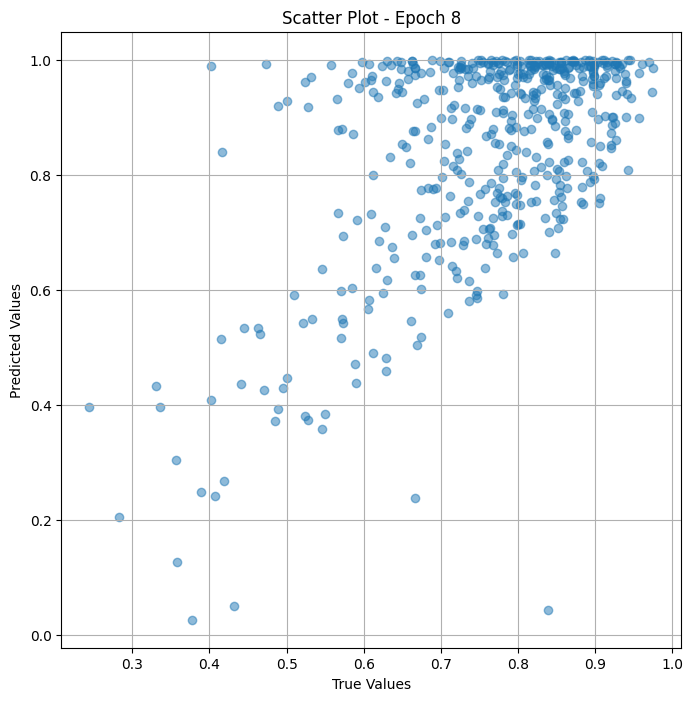


 Epoch: (9/50) Loss = 0.00839816965162754

 Epoch: (9/50) Loss_rmse = 0.09164153039455414

 Epoch: (9/50) R^2 = -2.38311767578125

 Epoch: (9/50) MAE = 0.054596513509750366

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575,

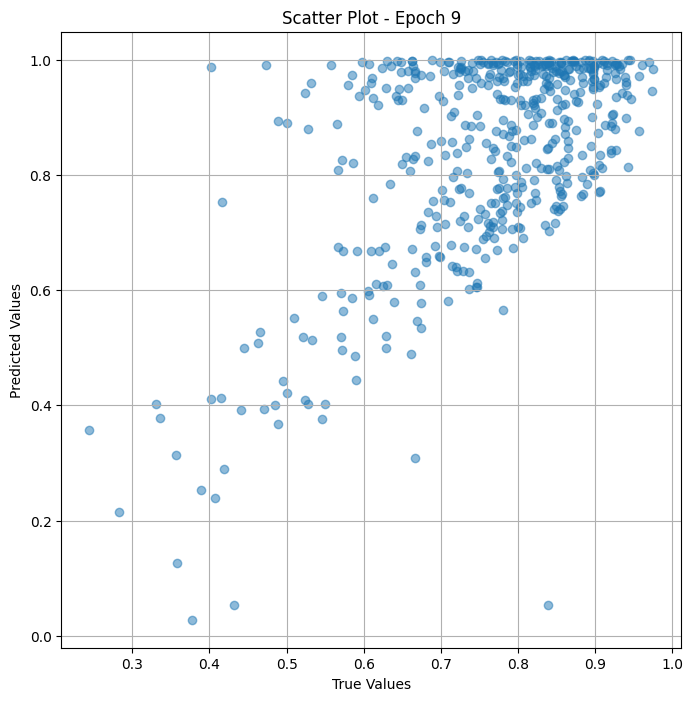


 Epoch: (10/50) Loss = 0.008214494213461876

 Epoch: (10/50) Loss_rmse = 0.09063384681940079

 Epoch: (10/50) R^2 = -2.3091259002685547

 Epoch: (10/50) MAE = 0.05429738759994507

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

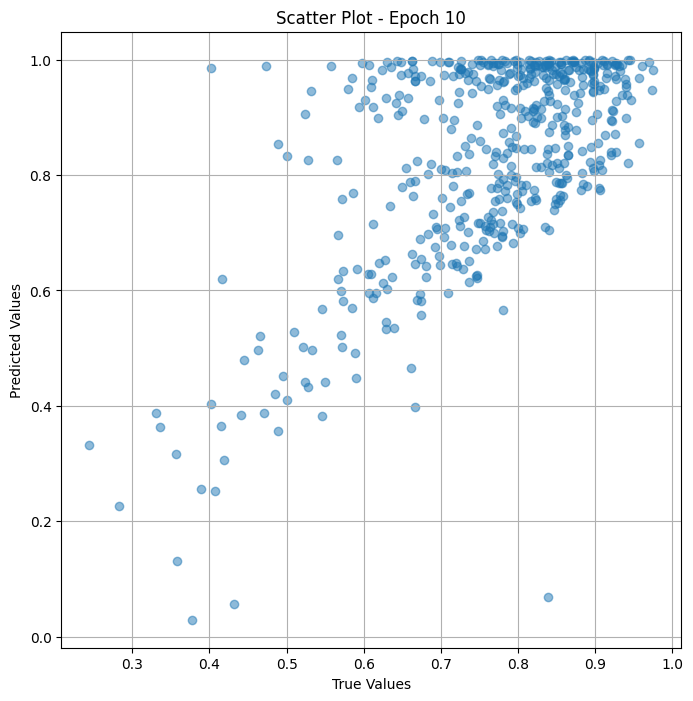


 Epoch: (11/50) Loss = 0.008007420226931572

 Epoch: (11/50) Loss_rmse = 0.08948419243097305

 Epoch: (11/50) R^2 = -2.225708246231079

 Epoch: (11/50) MAE = 0.05284823477268219

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

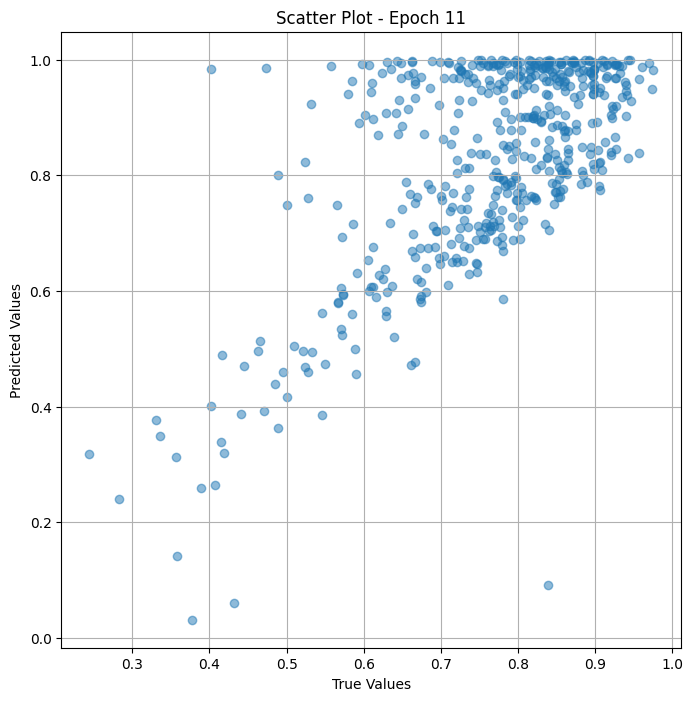


 Epoch: (12/50) Loss = 0.007809828035533428

 Epoch: (12/50) Loss_rmse = 0.08837322890758514

 Epoch: (12/50) R^2 = -2.1461102962493896

 Epoch: (12/50) MAE = 0.052911460399627686

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

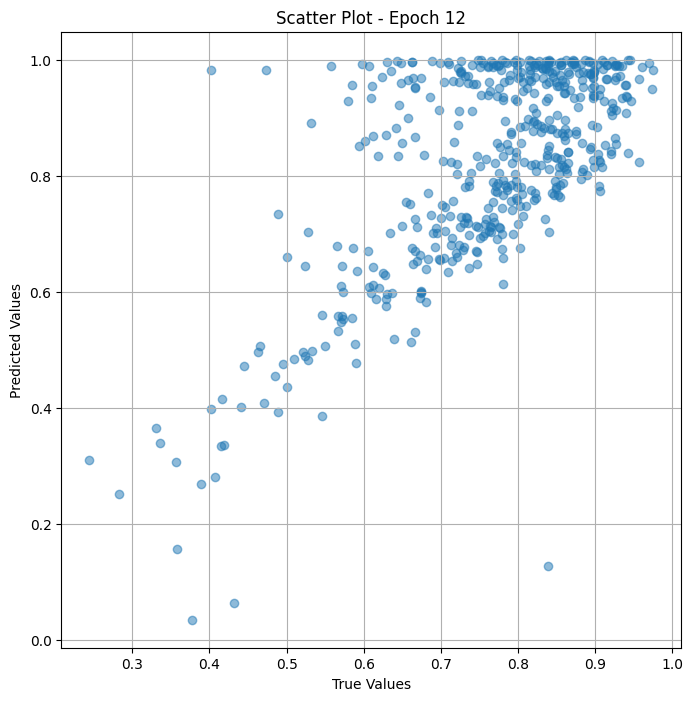


 Epoch: (13/50) Loss = 0.007594747003167868

 Epoch: (13/50) Loss_rmse = 0.08714784681797028

 Epoch: (13/50) R^2 = -2.059467077255249

 Epoch: (13/50) MAE = 0.05272425711154938

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

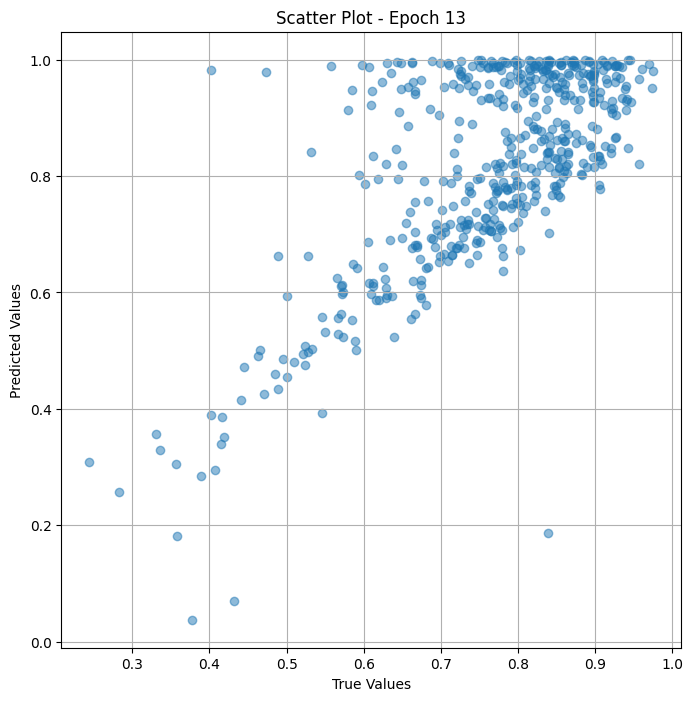


 Epoch: (14/50) Loss = 0.007359693758189678

 Epoch: (14/50) Loss_rmse = 0.08578865975141525

 Epoch: (14/50) R^2 = -1.964778184890747

 Epoch: (14/50) MAE = 0.053215086460113525

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

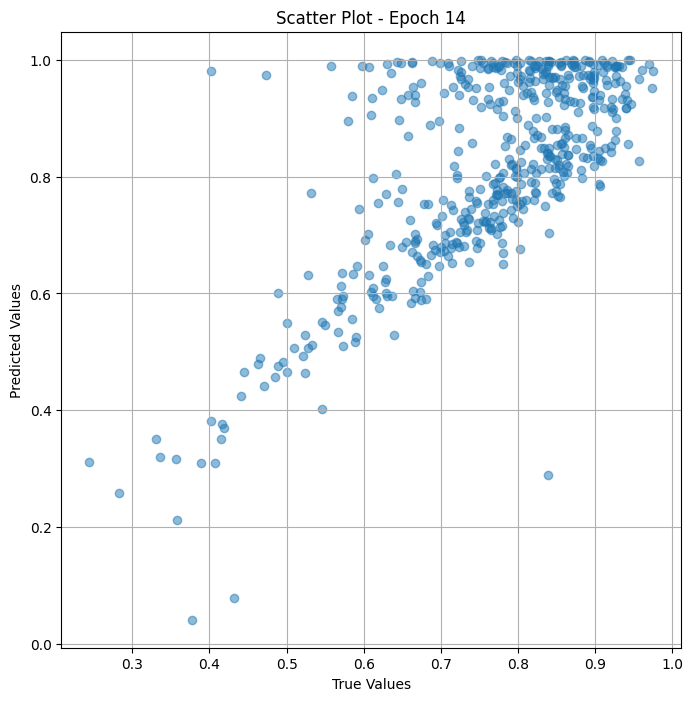


 Epoch: (15/50) Loss = 0.00707557238638401

 Epoch: (15/50) Loss_rmse = 0.08411642163991928

 Epoch: (15/50) R^2 = -1.8503227233886719

 Epoch: (15/50) MAE = 0.05384966731071472

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

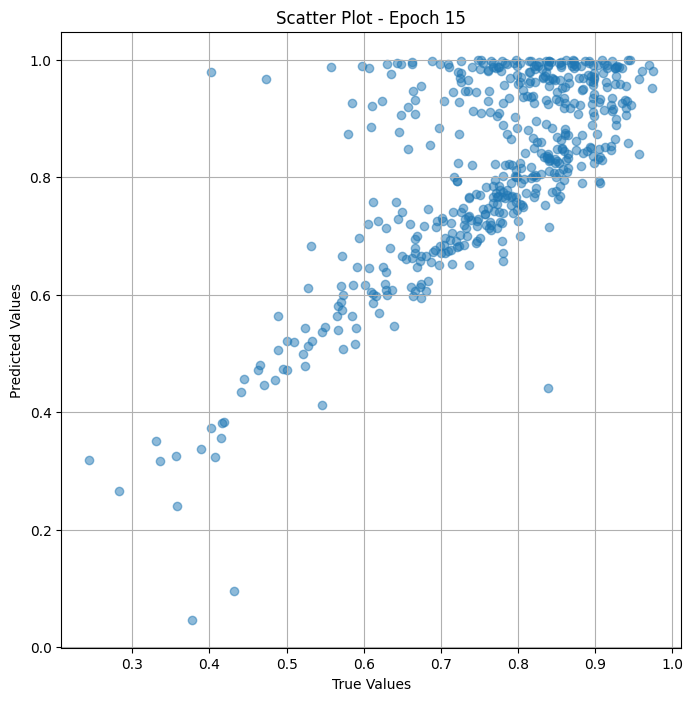


 Epoch: (16/50) Loss = 0.006671549752354622

 Epoch: (16/50) Loss_rmse = 0.08167955279350281

 Epoch: (16/50) R^2 = -1.6875662803649902

 Epoch: (16/50) MAE = 0.05299748480319977

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

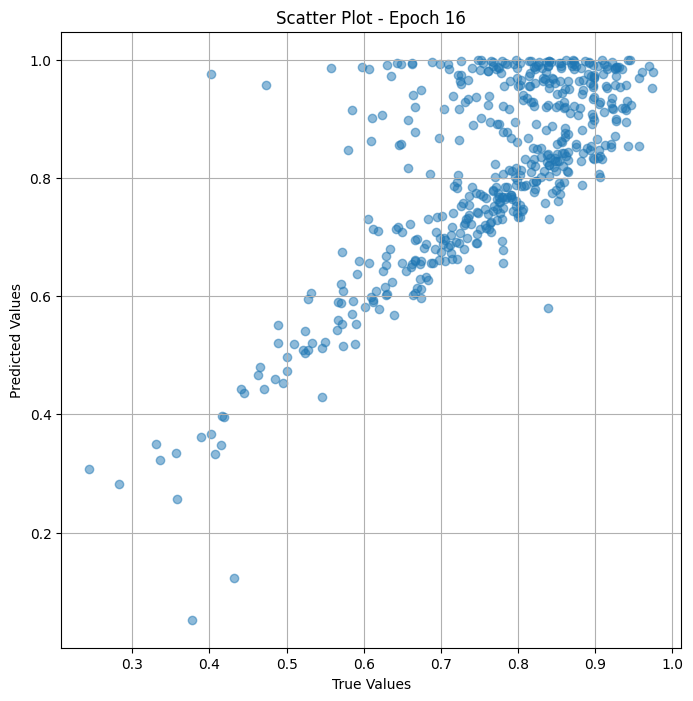


 Epoch: (17/50) Loss = 0.006049897521734238

 Epoch: (17/50) Loss_rmse = 0.07778108865022659

 Epoch: (17/50) R^2 = -1.4371399879455566

 Epoch: (17/50) MAE = 0.048505738377571106

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

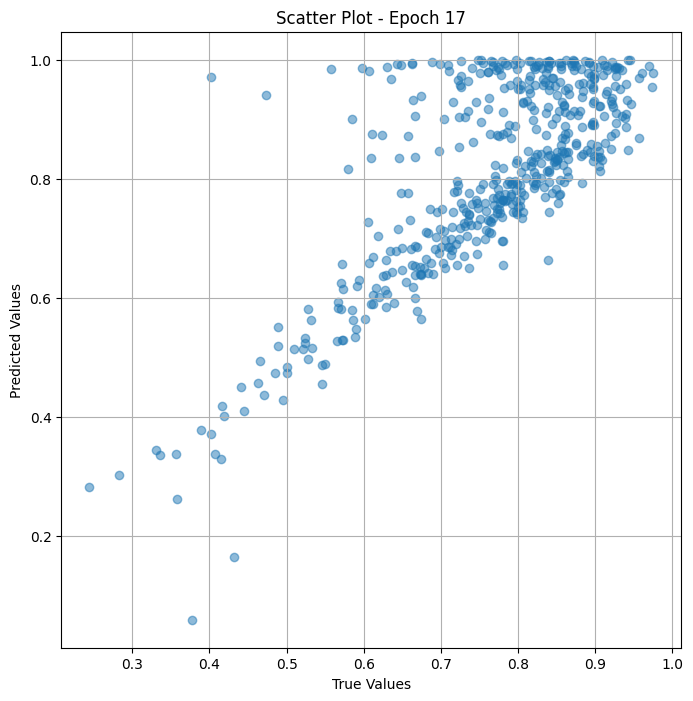


 Epoch: (18/50) Loss = 0.005284623708575964

 Epoch: (18/50) Loss_rmse = 0.07269541919231415

 Epoch: (18/50) R^2 = -1.128857135772705

 Epoch: (18/50) MAE = 0.04313585162162781

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

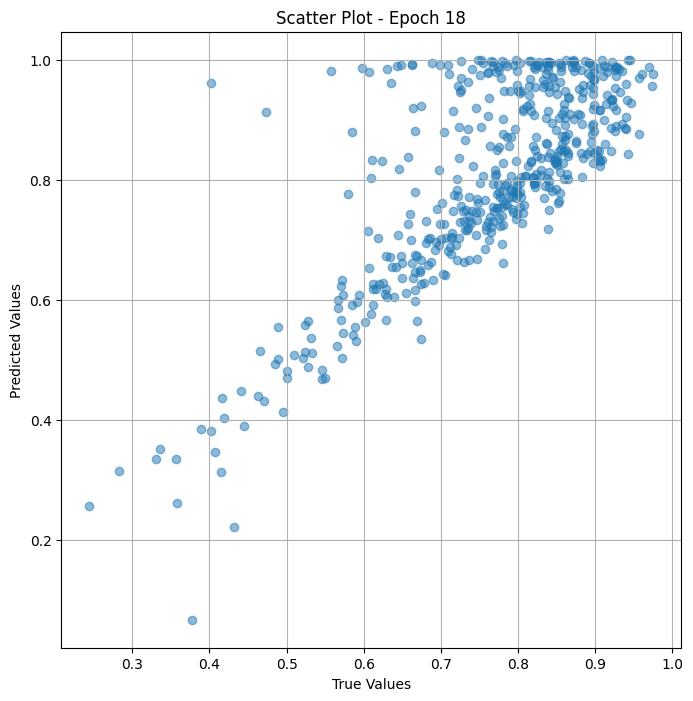


 Epoch: (19/50) Loss = 0.004454812500625849

 Epoch: (19/50) Loss_rmse = 0.0667443796992302

 Epoch: (19/50) R^2 = -0.7945761680603027

 Epoch: (19/50) MAE = 0.04277162253856659

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

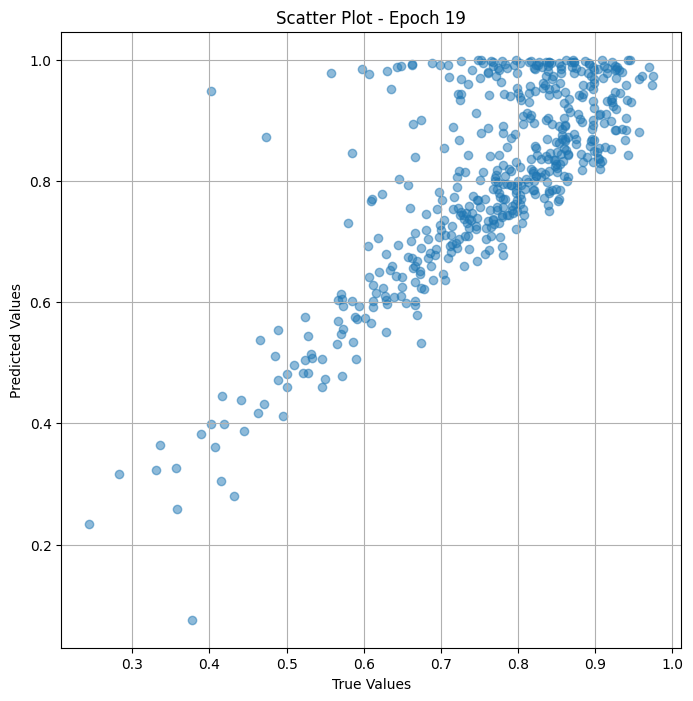


 Epoch: (20/50) Loss = 0.003526727668941021

 Epoch: (20/50) Loss_rmse = 0.05938625708222389

 Epoch: (20/50) R^2 = -0.4207066297531128

 Epoch: (20/50) MAE = 0.04026137292385101

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

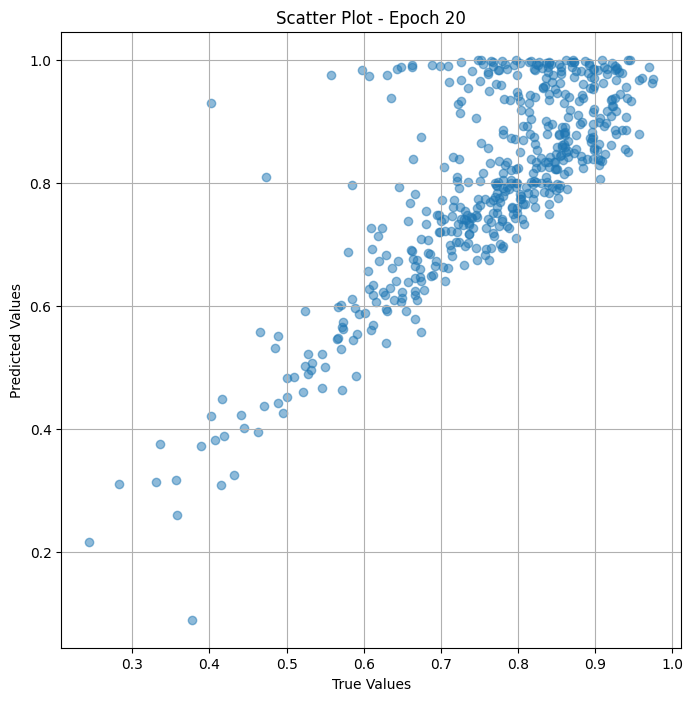


 Epoch: (21/50) Loss = 0.0024724705144762993

 Epoch: (21/50) Loss_rmse = 0.04972394183278084

 Epoch: (21/50) R^2 = 0.003990232944488525

 Epoch: (21/50) MAE = 0.034390777349472046

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.

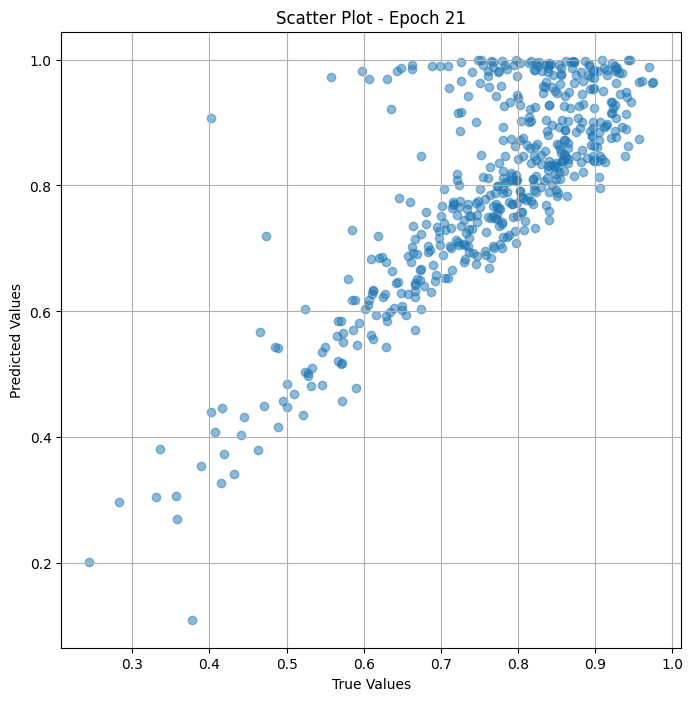


 Epoch: (22/50) Loss = 0.0014937941450625658

 Epoch: (22/50) Loss_rmse = 0.03864963352680206

 Epoch: (22/50) R^2 = 0.3982401490211487

 Epoch: (22/50) MAE = 0.03305651247501373

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

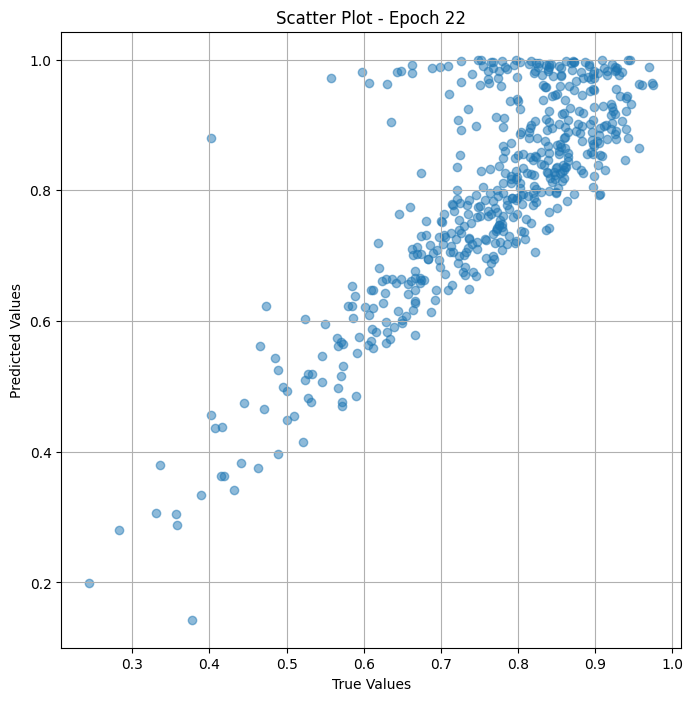


 Epoch: (23/50) Loss = 0.0009711999446153641

 Epoch: (23/50) Loss_rmse = 0.031164081767201424

 Epoch: (23/50) R^2 = 0.6087619066238403

 Epoch: (23/50) MAE = 0.029208004474639893

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

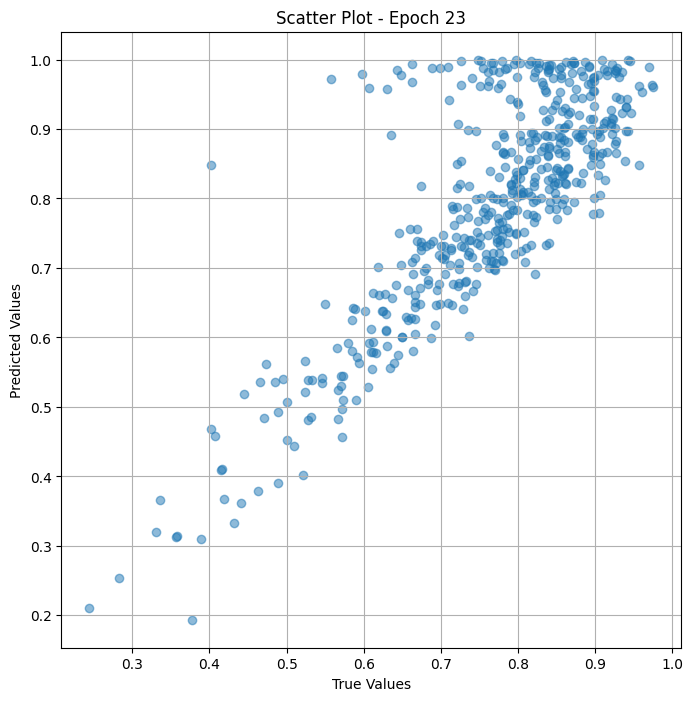


 Epoch: (24/50) Loss = 0.0009059738367795944

 Epoch: (24/50) Loss_rmse = 0.030099399387836456

 Epoch: (24/50) R^2 = 0.6350376009941101

 Epoch: (24/50) MAE = 0.02436569333076477

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

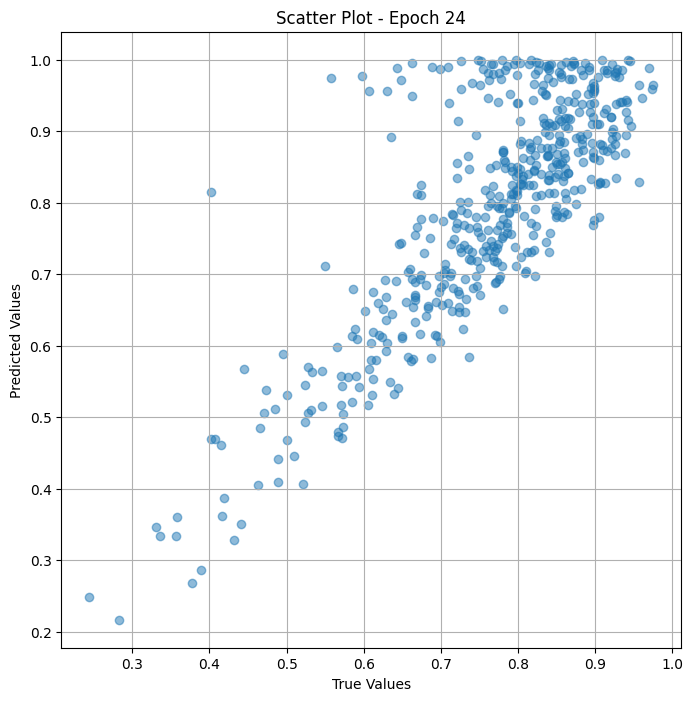


 Epoch: (25/50) Loss = 0.0008242155308835208

 Epoch: (25/50) Loss_rmse = 0.028709154576063156

 Epoch: (25/50) R^2 = 0.6679731011390686

 Epoch: (25/50) MAE = 0.01806853711605072

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

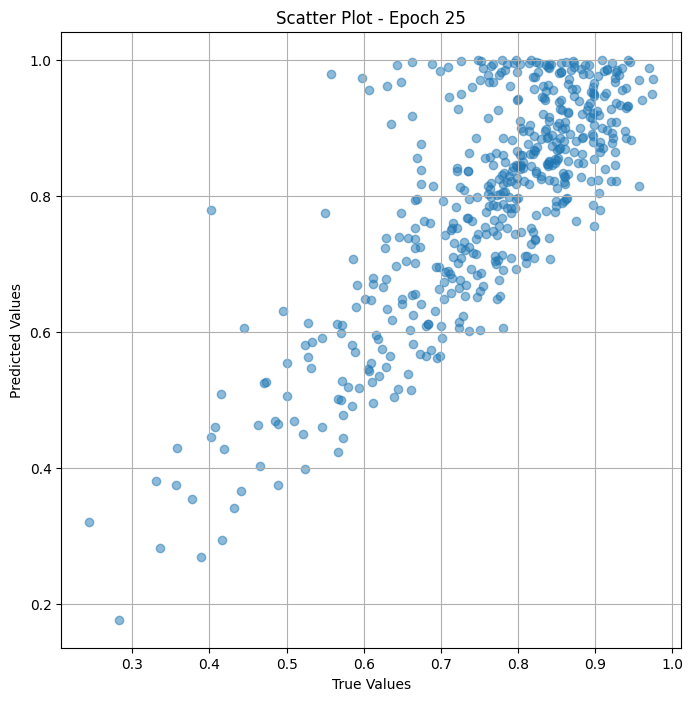


 Epoch: (26/50) Loss = 0.0004802297044079751

 Epoch: (26/50) Loss_rmse = 0.02191414311528206

 Epoch: (26/50) R^2 = 0.806544303894043

 Epoch: (26/50) MAE = 0.01682153344154358

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

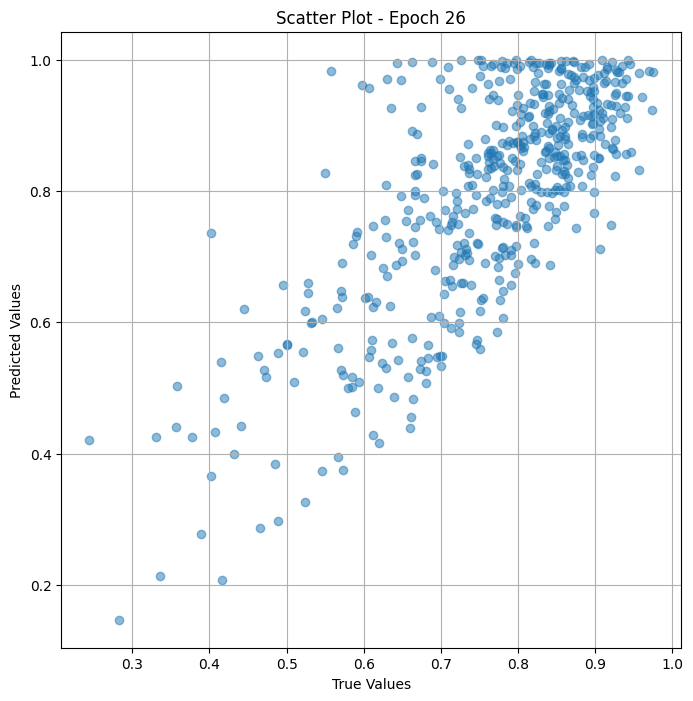


 Epoch: (27/50) Loss = 0.0021769441664218903

 Epoch: (27/50) Loss_rmse = 0.046657733619213104

 Epoch: (27/50) R^2 = 0.1230400800704956

 Epoch: (27/50) MAE = 0.041594430804252625

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

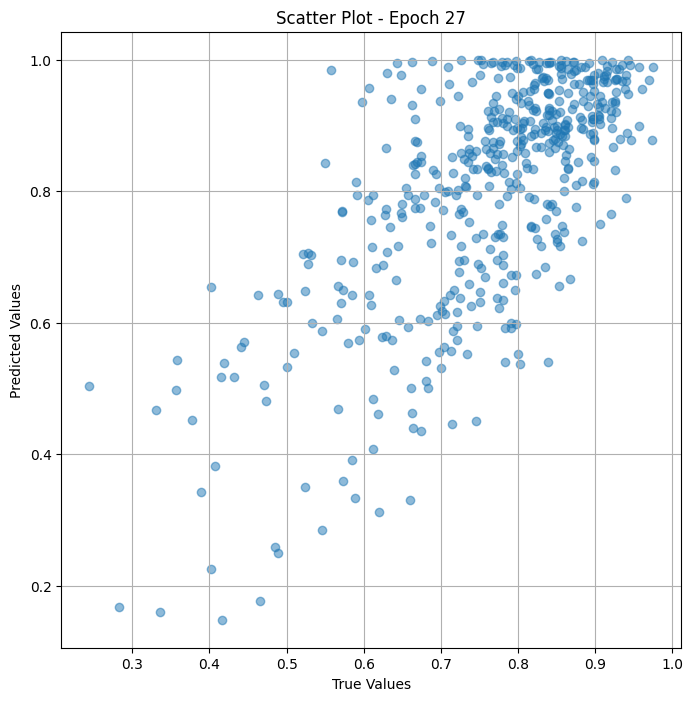


 Epoch: (28/50) Loss = 0.009057112969458103

 Epoch: (28/50) Loss_rmse = 0.09516886621713638

 Epoch: (28/50) R^2 = -2.648566484451294

 Epoch: (28/50) MAE = 0.08548577129840851

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

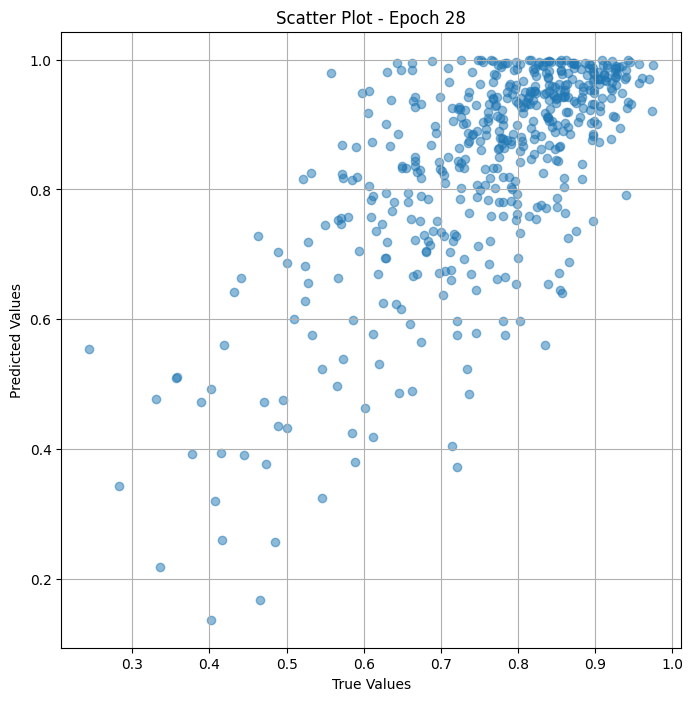


 Epoch: (29/50) Loss = 0.010253489948809147

 Epoch: (29/50) Loss_rmse = 0.1012595146894455

 Epoch: (29/50) R^2 = -3.130514621734619

 Epoch: (29/50) MAE = 0.09896217286586761

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757

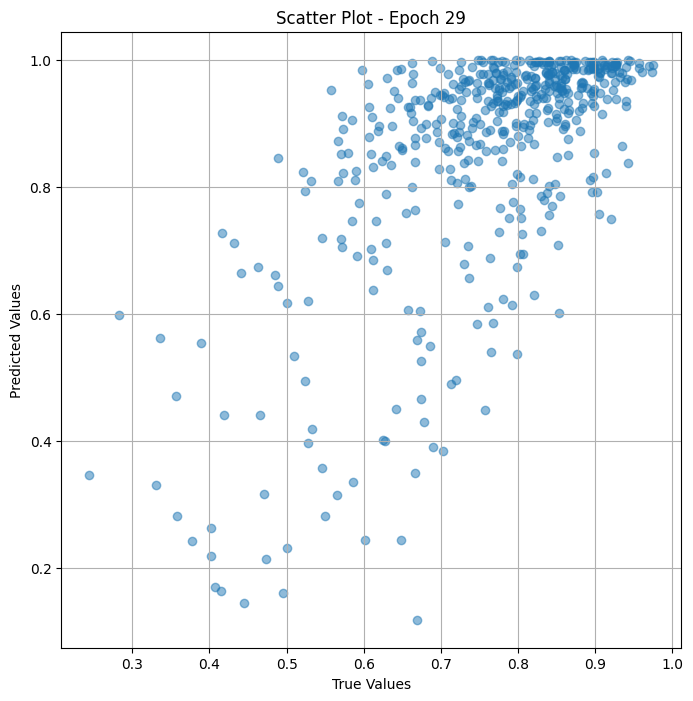


 Epoch: (30/50) Loss = 0.007331948261708021

 Epoch: (30/50) Loss_rmse = 0.08562679588794708

 Epoch: (30/50) R^2 = -1.9536011219024658

 Epoch: (30/50) MAE = 0.07729463279247284

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

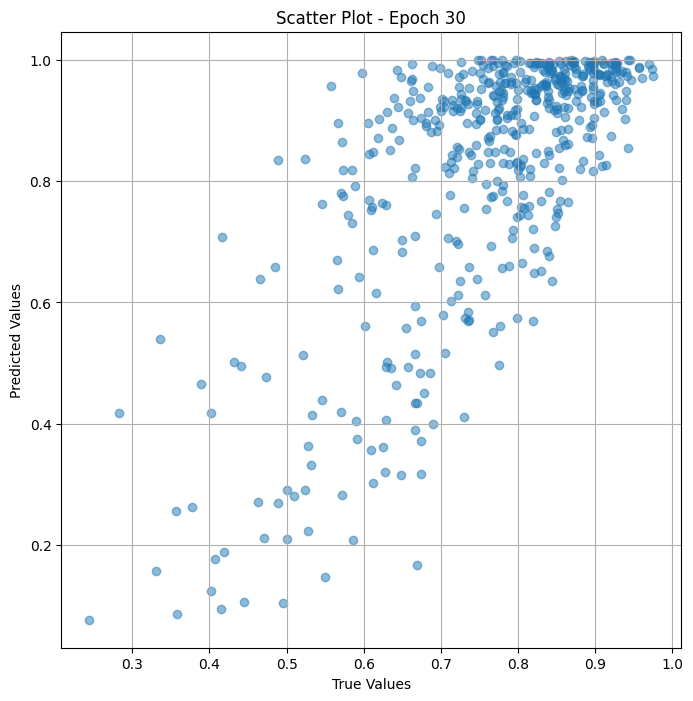


 Epoch: (31/50) Loss = 0.002396352356299758

 Epoch: (31/50) Loss_rmse = 0.048952553421258926

 Epoch: (31/50) R^2 = 0.034653663635253906

 Epoch: (31/50) MAE = 0.04624485969543457

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

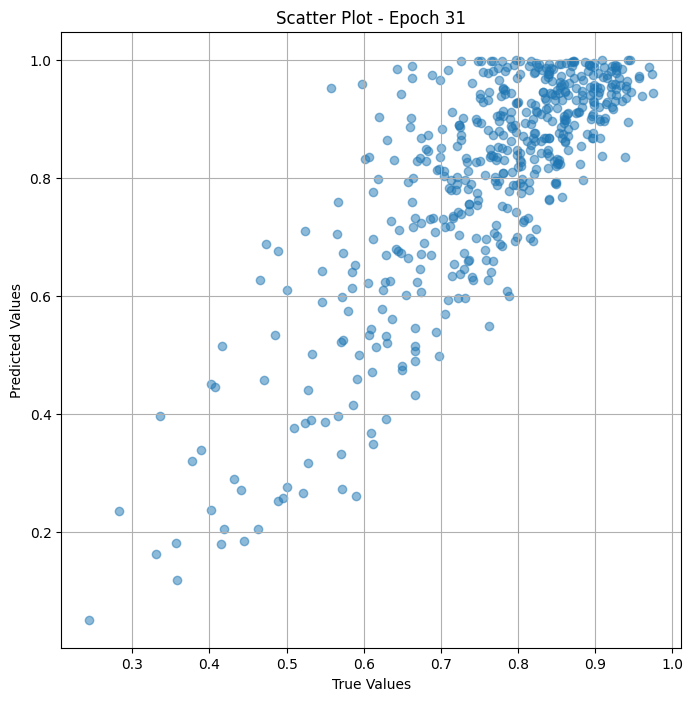


 Epoch: (32/50) Loss = 0.0011253012344241142

 Epoch: (32/50) Loss_rmse = 0.03354550898075104

 Epoch: (32/50) R^2 = 0.5466837882995605

 Epoch: (32/50) MAE = 0.028134256601333618

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

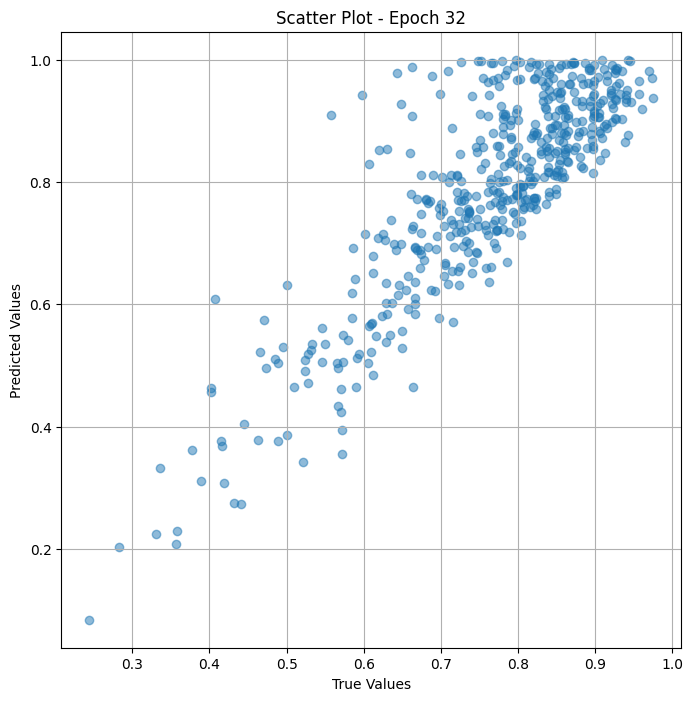


 Epoch: (33/50) Loss = 0.0005243702908046544

 Epoch: (33/50) Loss_rmse = 0.02289913222193718

 Epoch: (33/50) R^2 = 0.7887627482414246

 Epoch: (33/50) MAE = 0.018431812524795532

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

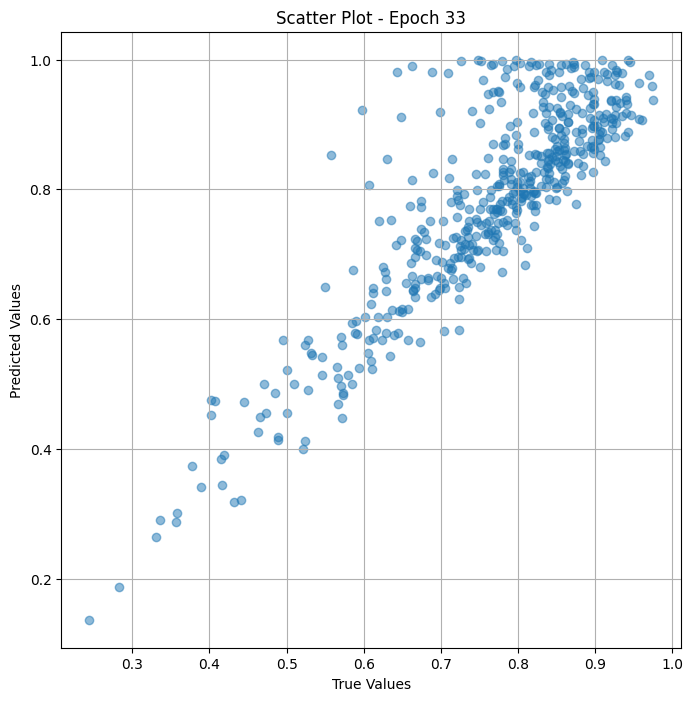


 Epoch: (34/50) Loss = 0.0002502448623999953

 Epoch: (34/50) Loss_rmse = 0.015819130465388298

 Epoch: (34/50) R^2 = 0.8991913795471191

 Epoch: (34/50) MAE = 0.014755651354789734

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

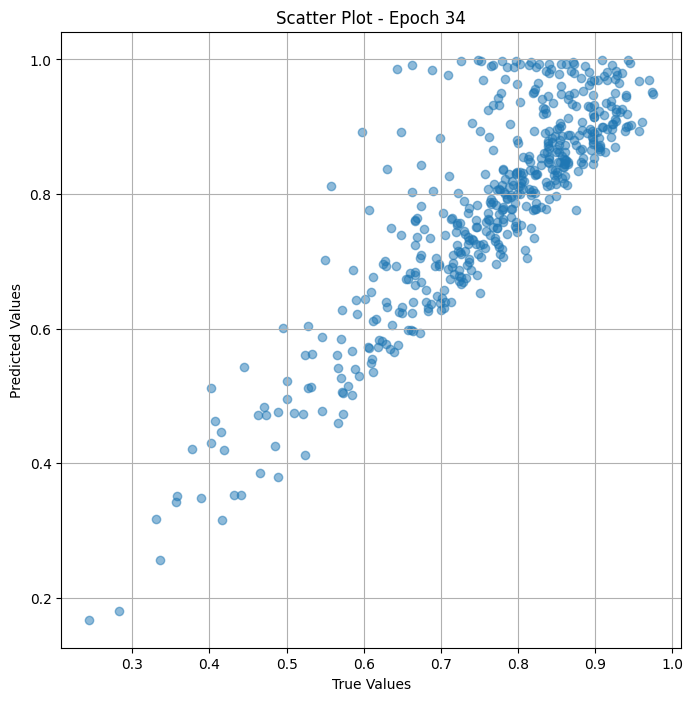


 Epoch: (35/50) Loss = 0.00015793921193107963

 Epoch: (35/50) Loss_rmse = 0.012567386962473392

 Epoch: (35/50) R^2 = 0.9363757967948914

 Epoch: (35/50) MAE = 0.010118871927261353

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.

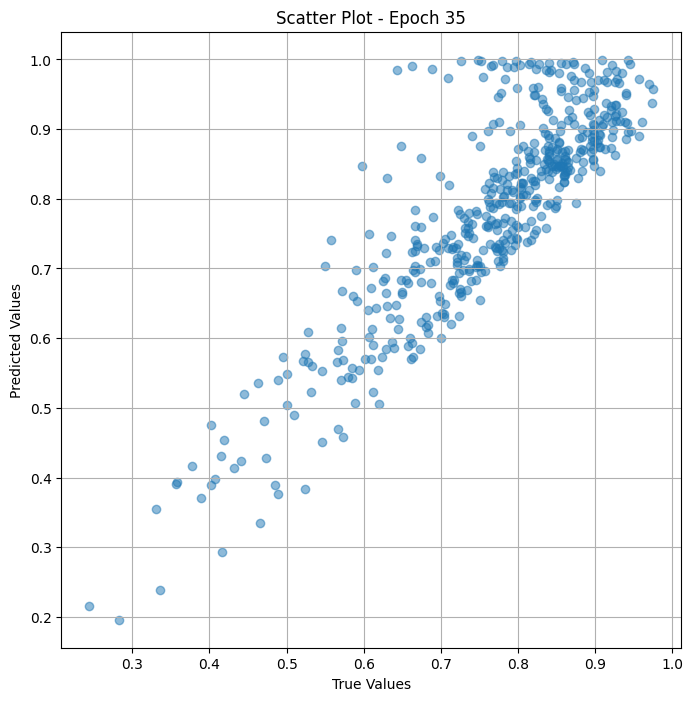


 Epoch: (36/50) Loss = 0.0005337567999958992

 Epoch: (36/50) Loss_rmse = 0.023103177547454834

 Epoch: (36/50) R^2 = 0.7849814891815186

 Epoch: (36/50) MAE = 0.018858447670936584

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

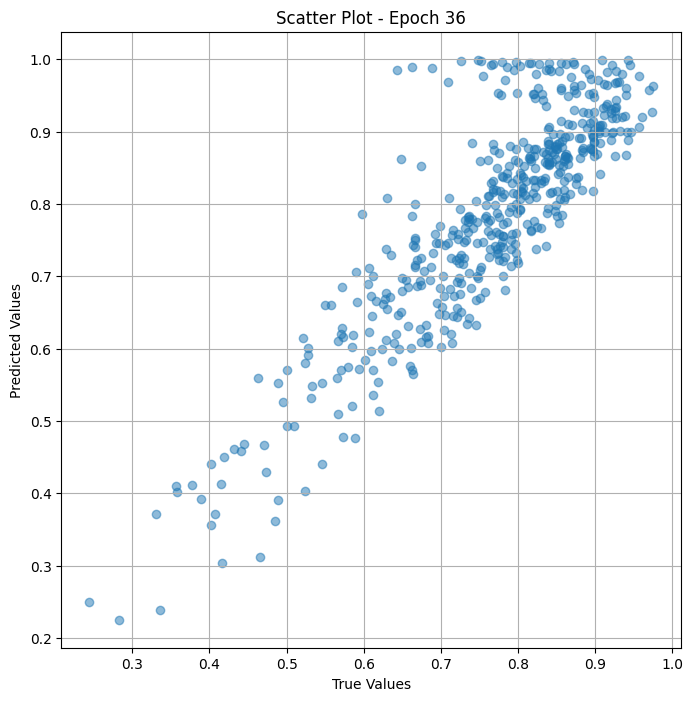


 Epoch: (37/50) Loss = 0.0009098261944018304

 Epoch: (37/50) Loss_rmse = 0.030163325369358063

 Epoch: (37/50) R^2 = 0.6334856748580933

 Epoch: (37/50) MAE = 0.026117831468582153

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

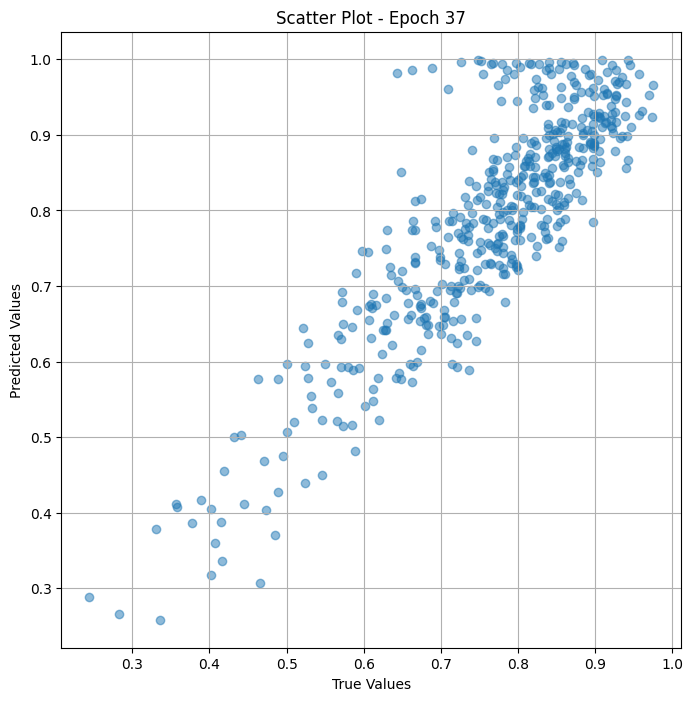


 Epoch: (38/50) Loss = 0.0010166680440306664

 Epoch: (38/50) Loss_rmse = 0.03188523277640343

 Epoch: (38/50) R^2 = 0.5904455184936523

 Epoch: (38/50) MAE = 0.026836857199668884

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

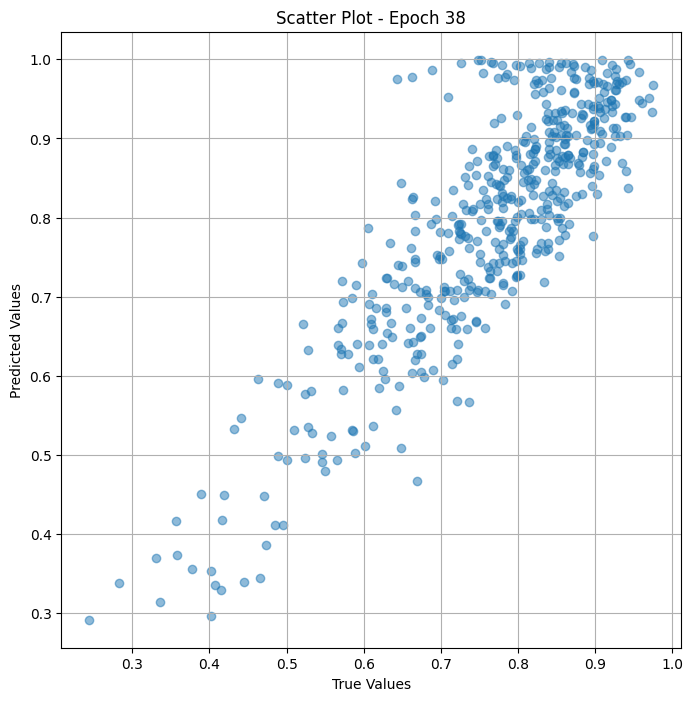


 Epoch: (39/50) Loss = 0.00034799869172275066

 Epoch: (39/50) Loss_rmse = 0.018654722720384598

 Epoch: (39/50) R^2 = 0.8598122596740723

 Epoch: (39/50) MAE = 0.013109862804412842

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.

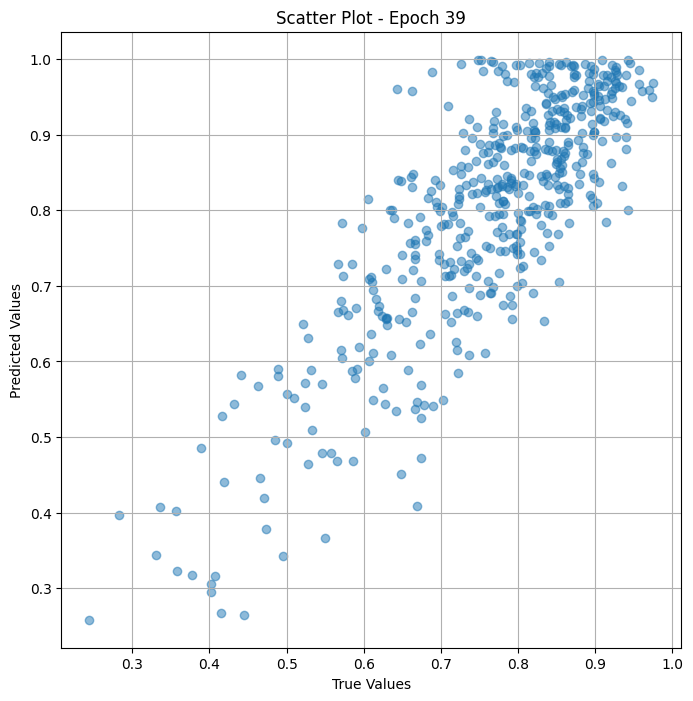


 Epoch: (40/50) Loss = 0.001005516154691577

 Epoch: (40/50) Loss_rmse = 0.03170987591147423

 Epoch: (40/50) R^2 = 0.5949379801750183

 Epoch: (40/50) MAE = 0.030502617359161377

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

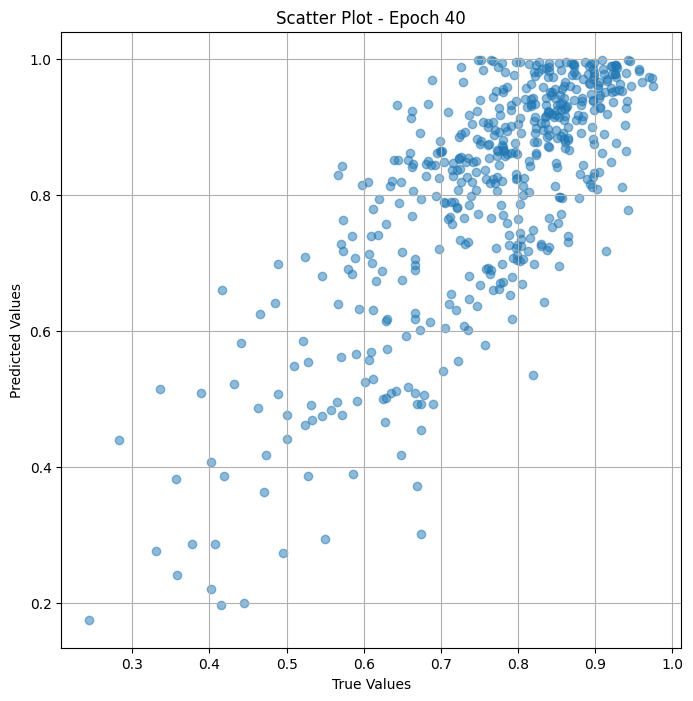


 Epoch: (41/50) Loss = 0.006289376411587

 Epoch: (41/50) Loss_rmse = 0.07930558919906616

 Epoch: (41/50) R^2 = -1.53361177444458

 Epoch: (41/50) MAE = 0.07588283717632294

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

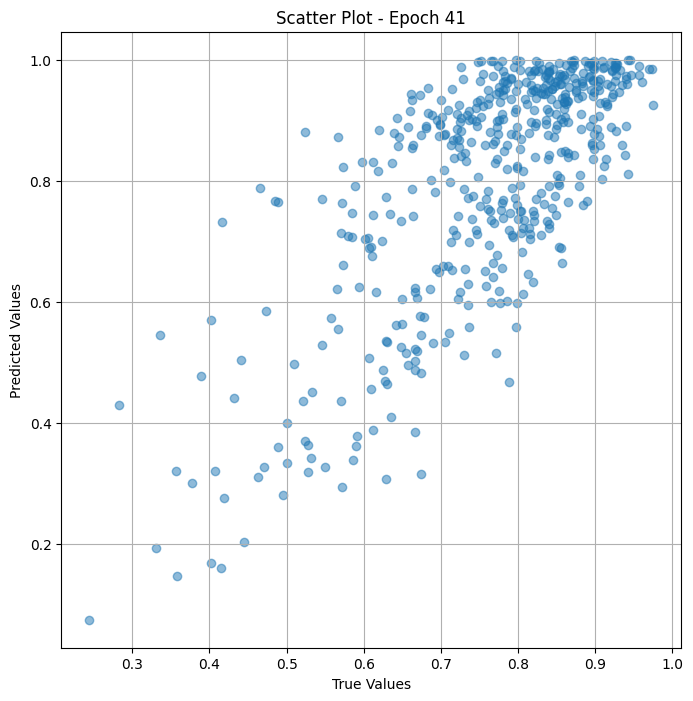


 Epoch: (42/50) Loss = 0.00804085936397314

 Epoch: (42/50) Loss_rmse = 0.08967083692550659

 Epoch: (42/50) R^2 = -2.2391788959503174

 Epoch: (42/50) MAE = 0.07924282550811768

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

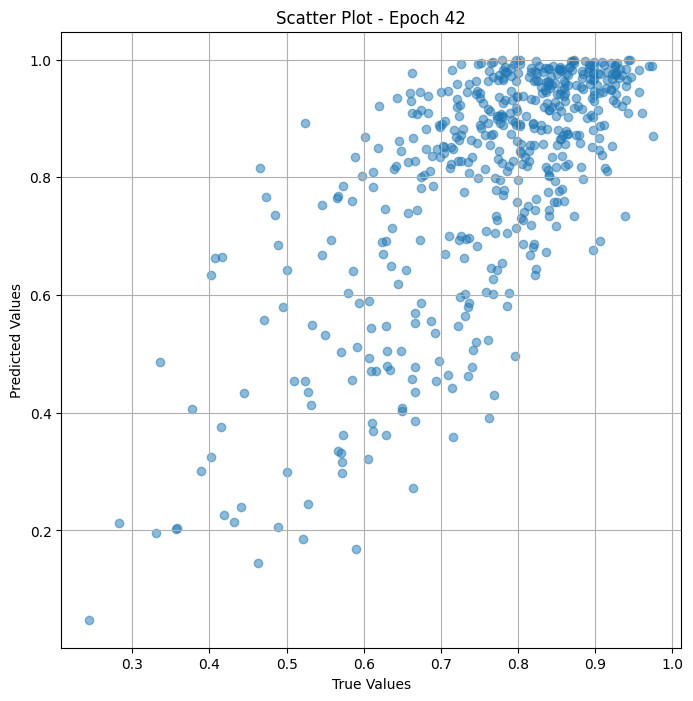


 Epoch: (43/50) Loss = 0.004092471208423376

 Epoch: (43/50) Loss_rmse = 0.06397242844104767

 Epoch: (43/50) R^2 = -0.6486105918884277

 Epoch: (43/50) MAE = 0.05636778473854065

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

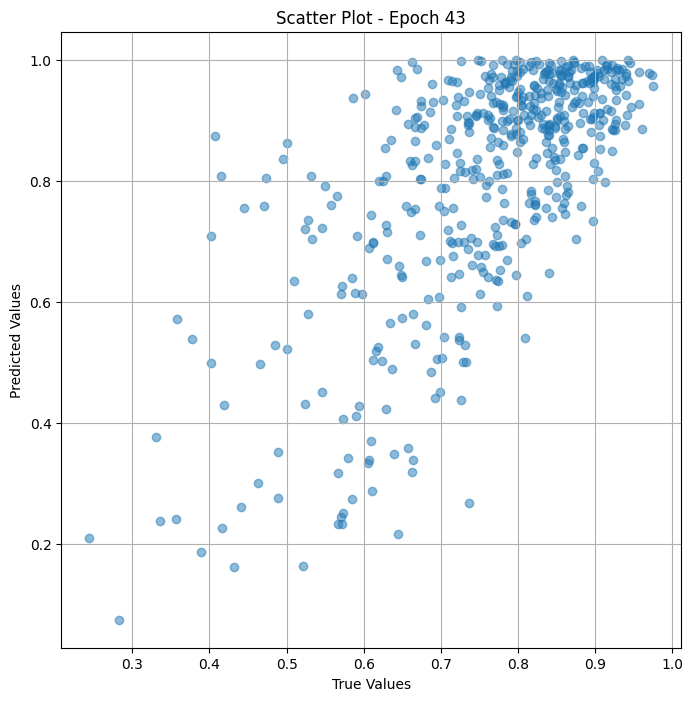


 Epoch: (44/50) Loss = 0.004514479078352451

 Epoch: (44/50) Loss_rmse = 0.06718987226486206

 Epoch: (44/50) R^2 = -0.8186122179031372

 Epoch: (44/50) MAE = 0.05876648426055908

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

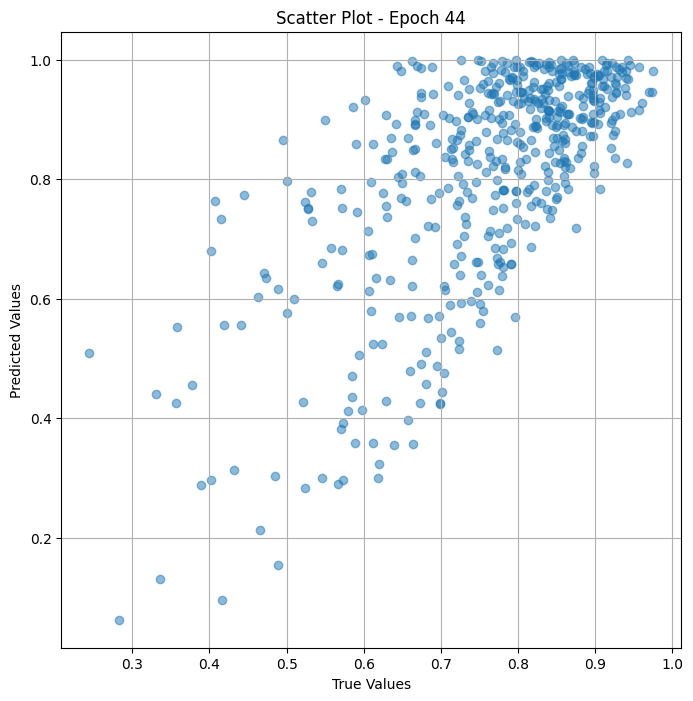


 Epoch: (45/50) Loss = 0.0016367656644433737

 Epoch: (45/50) Loss_rmse = 0.04045696184039116

 Epoch: (45/50) R^2 = 0.3406454920768738

 Epoch: (45/50) MAE = 0.030299603939056396

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

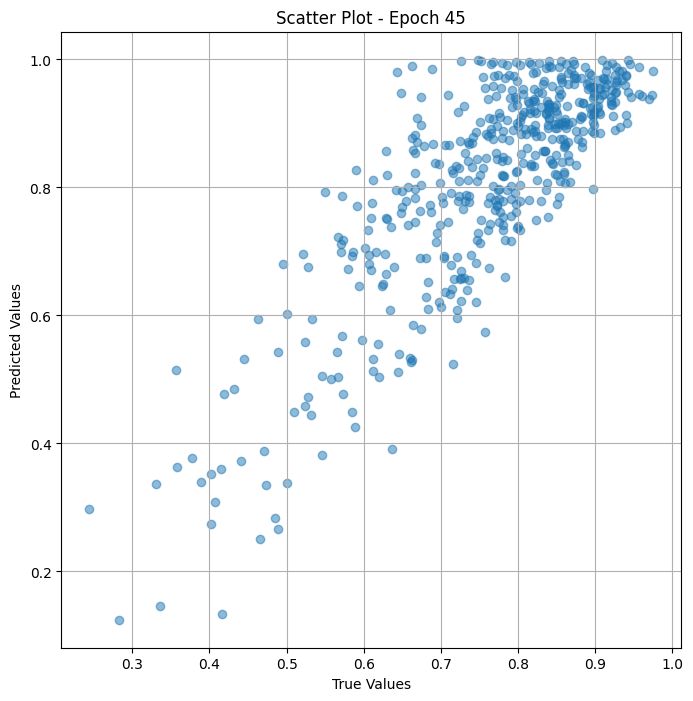


 Epoch: (46/50) Loss = 0.0019295220263302326

 Epoch: (46/50) Loss_rmse = 0.04392632469534874

 Epoch: (46/50) R^2 = 0.22271156311035156

 Epoch: (46/50) MAE = 0.03899560868740082

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

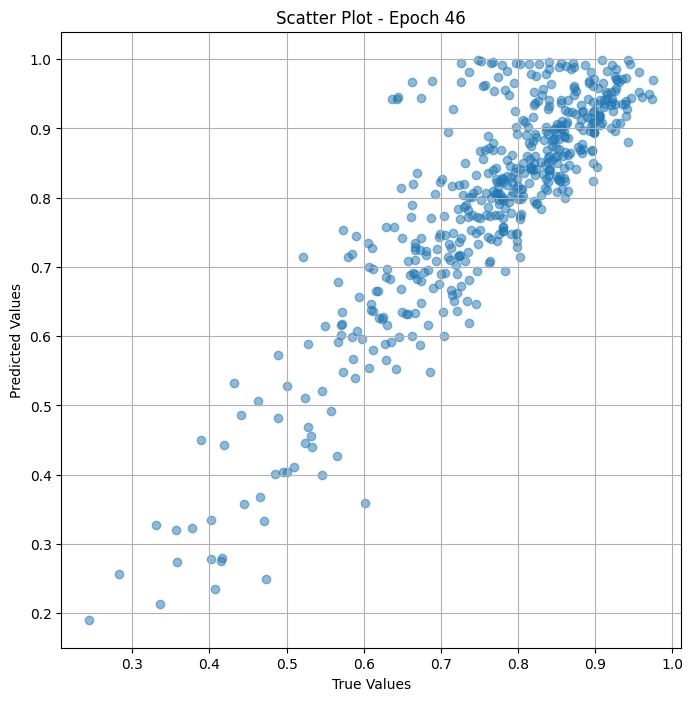


 Epoch: (47/50) Loss = 0.00048254200373776257

 Epoch: (47/50) Loss_rmse = 0.02196683920919895

 Epoch: (47/50) R^2 = 0.8056128025054932

 Epoch: (47/50) MAE = 0.020153194665908813

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

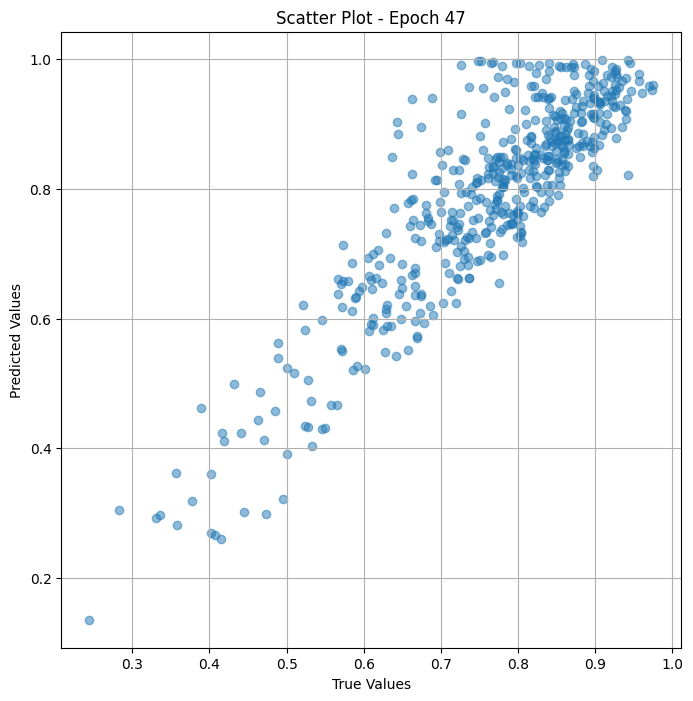


 Epoch: (48/50) Loss = 0.0006231424631550908

 Epoch: (48/50) Loss_rmse = 0.02496282197535038

 Epoch: (48/50) R^2 = 0.7489733695983887

 Epoch: (48/50) MAE = 0.022305622696876526

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

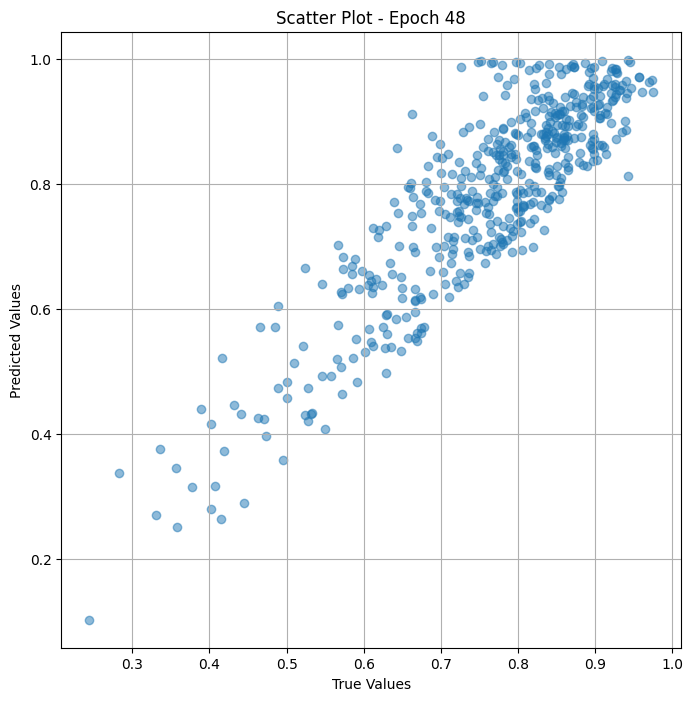


 Epoch: (49/50) Loss = 0.0011251657269895077

 Epoch: (49/50) Loss_rmse = 0.03354348987340927

 Epoch: (49/50) R^2 = 0.5467383861541748

 Epoch: (49/50) MAE = 0.02969096601009369

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

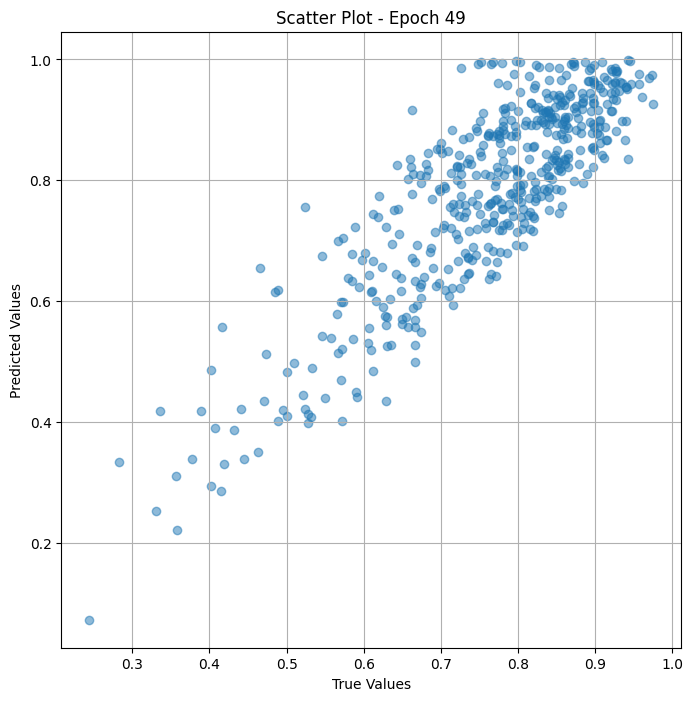


 Epoch: (50/50) Loss = 0.002794981002807617

 Epoch: (50/50) Loss_rmse = 0.0528675802052021

 Epoch: (50/50) R^2 = -0.1259298324584961

 Epoch: (50/50) MAE = 0.047057315707206726

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

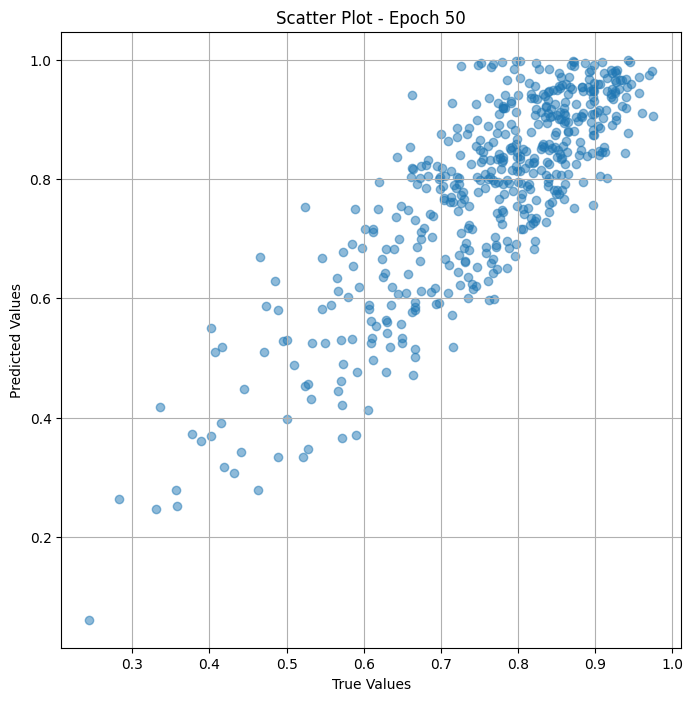

In [ ]:
# Training the model and save weights
fit(50, model_test, train_dl_test)
torch.save(model.state_dict(), "model_weights_vr_test")

In [ ]:
 true_values_list = [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157]

 predicted_values_list= [0.7786098, 0.87708163, 0.98849666, 0.5786784, 0.75259435, 0.87792826, 0.5395818, 0.83080703]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.9761904761904763 3.3143960262001043e-05


# Finetune


## Train

In [ ]:
# Load the pre-trained ResNet model
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
for param in model_Res.parameters():
    param.requires_grad = True

# Add your custom layers for fine-tuning
#num_features = model_Res[0][-1].in_features  # Get the number of features in the last layer of ResNet

custom_layers = [
    nn.Flatten(),
    nn.Linear(2048, 512),  # Example: add a fully connected layer with 512 units
    nn.ReLU(),
    nn.Dropout(0.5),  # Example: add dropout for regularization
    nn.Linear(512, 1)  # Example: add the output layer with your desired number of classes
]

# Create a new model by combining ResNet and custom layers
fine_tuned_model = nn.Sequential(
    model_Res,
    *custom_layers
)

# Optionally, you can print the fine-tuned model architecture
print(fine_tuned_model)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [ ]:
# Load the pre-trained ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')

# Freeze some of the layers
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = True

# Extract the feature extractor
feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k')

# Remove the classification head (top layers) from the model
model_trans_top = nn.Sequential(*list(model_trans.children())[:-2])

# Access the last linear layer and adjust its bias
last_linear_layer = list(model_trans.children())[-1]
# Assuming the last layer is a Linear layer
if isinstance(last_linear_layer, nn.Linear):
    # Adjust the bias as needed
    new_bias = torch.tensor([2.0])
    last_linear_layer.bias.data = new_bias

# Add Sigmoid activation
mymodel = nn.Sequential(last_linear_layer, nn.Sigmoid())

# Optionally, you can print the modified model architecture
print(mymodel)


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

Sequential(
  (0): ViTPooler(
    (dense): Linear(in_features=768, out_features=768, bias=True)
    (activation): Tanh()
  )
  (1): Sigmoid()
)


In [ ]:
# Merge the two models
class model_merge_fine(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_fine(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

# Fit function doing grad steps
def fit(epochs, model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()

    for epoch in range(epochs):
        model.train()
        batch_num = 16
        true_values_list = []
        predicted_values_list = []
        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())

            loss.backward()
            opt.step()
            opt.zero_grad()

            total_loss += loss.item()
            total_loss_rmse += loss_rmse.item()
            total_r2 += r2.item()
            total_mae += mae.item()
            #total_spearman += spearman_corr

            # Increment batch number
            #print('\r', f'batch #{batch_num}: {loss}', end='')
            batch_num += 5

        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        #print('\n', f'Epoch: ({epoch+1}/{epochs}) Spearman = {mean_spearman}')
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        # Plot scatter plot after each epoch
        plot_scatter(true_values_list, predicted_values_list, epoch)


 Epoch: (1/50) Loss = 0.015043877065181732

 Epoch: (1/50) Loss_rmse = 0.12265348434448242

 Epoch: (1/50) R^2 = -2.6371915340423584

 Epoch: (1/50) MAE = 0.09593822062015533

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.4479

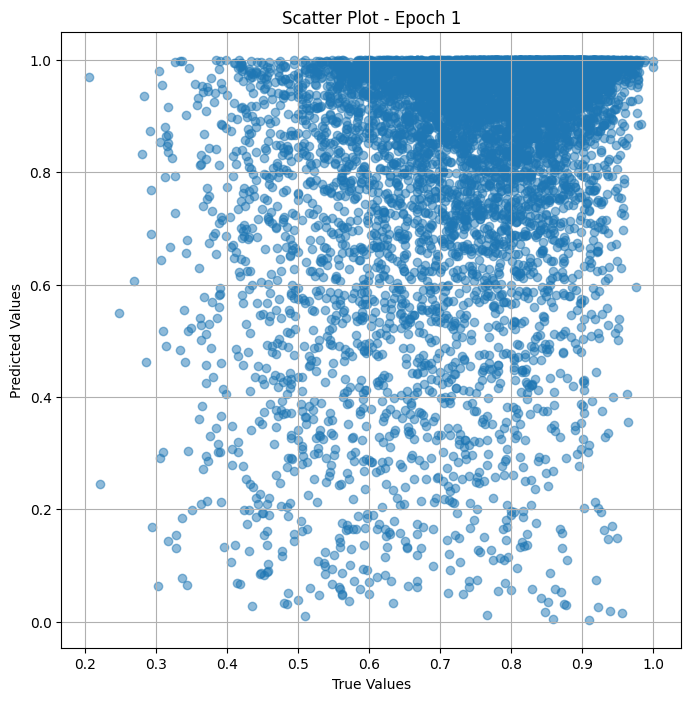


 Epoch: (2/50) Loss = 0.009758951142430305

 Epoch: (2/50) Loss_rmse = 0.09878740459680557

 Epoch: (2/50) R^2 = -1.359443187713623

 Epoch: (2/50) MAE = 0.08000893890857697

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.44791

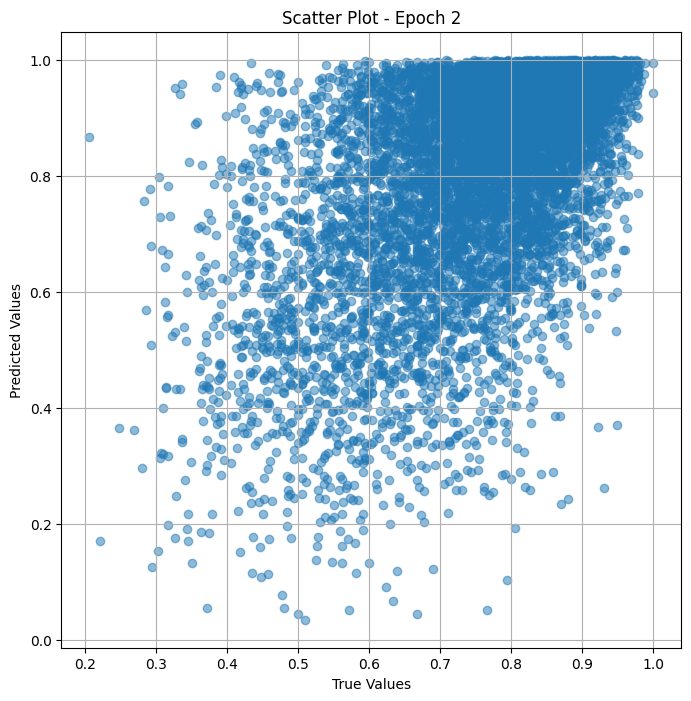


 Epoch: (3/50) Loss = 0.0036135606933385134

 Epoch: (3/50) Loss_rmse = 0.06011290103197098

 Epoch: (3/50) R^2 = 0.12634146213531494

 Epoch: (3/50) MAE = 0.0446305125951767

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.4479

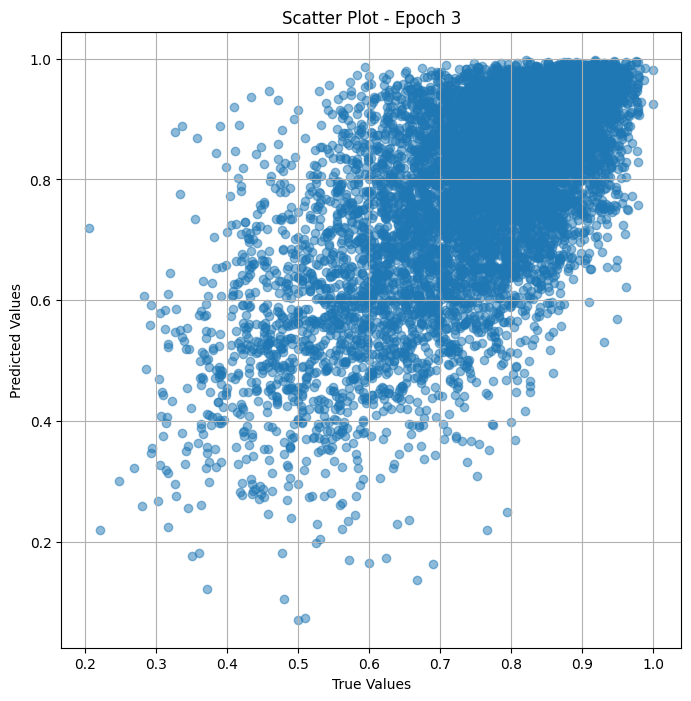


 Epoch: (4/50) Loss = 0.003906928468495607

 Epoch: (4/50) Loss_rmse = 0.06250542402267456

 Epoch: (4/50) R^2 = 0.055413246154785156

 Epoch: (4/50) MAE = 0.05202743411064148

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.447

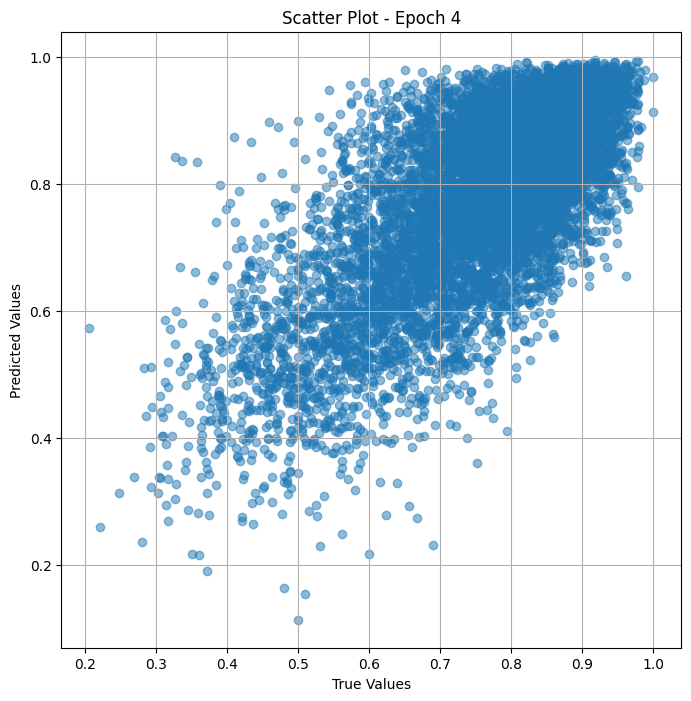


 Epoch: (5/50) Loss = 0.0038975069765001535

 Epoch: (5/50) Loss_rmse = 0.062430016696453094

 Epoch: (5/50) R^2 = 0.057691097259521484

 Epoch: (5/50) MAE = 0.052921853959560394

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.

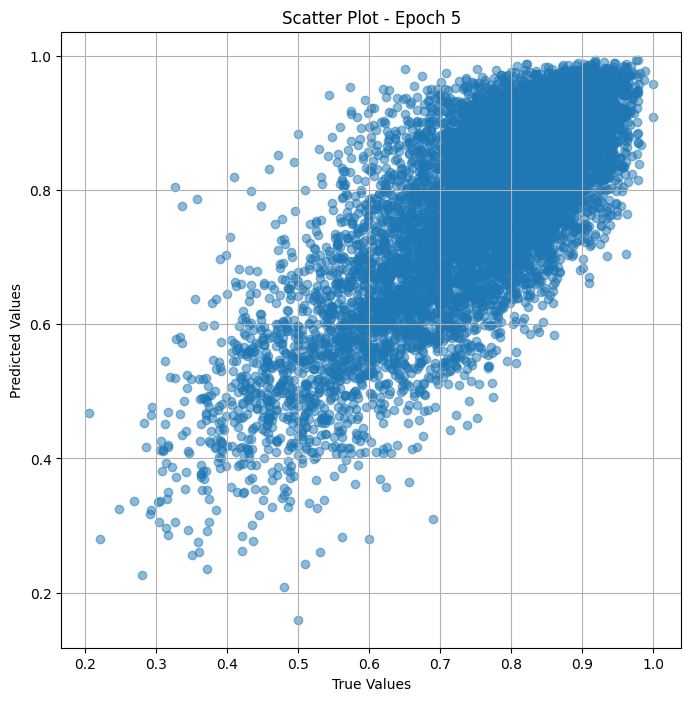


 Epoch: (6/50) Loss = 0.0033992875833064318

 Epoch: (6/50) Loss_rmse = 0.058303408324718475

 Epoch: (6/50) R^2 = 0.17814671993255615

 Epoch: (6/50) MAE = 0.04991867393255234

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.44

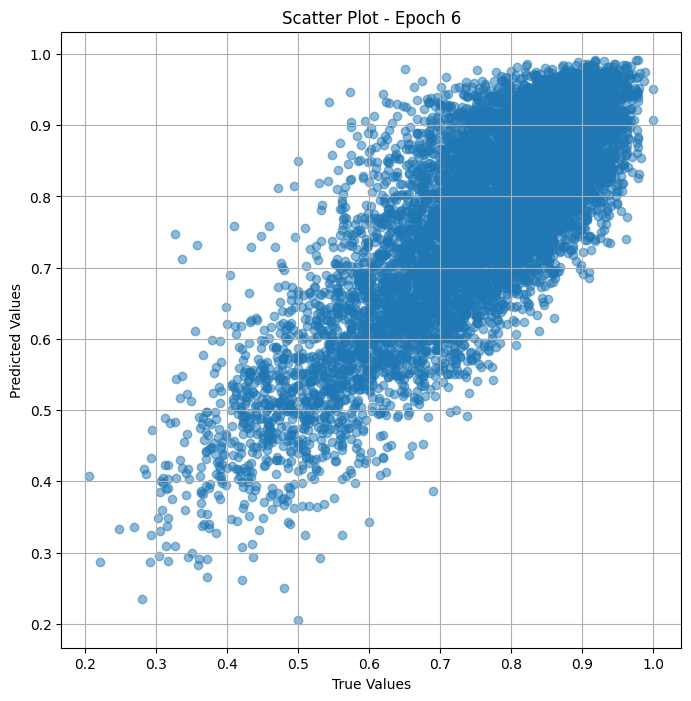


 Epoch: (7/50) Loss = 0.0027754006441682577

 Epoch: (7/50) Loss_rmse = 0.052682071924209595

 Epoch: (7/50) R^2 = 0.3289852738380432

 Epoch: (7/50) MAE = 0.045191965997219086

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.44

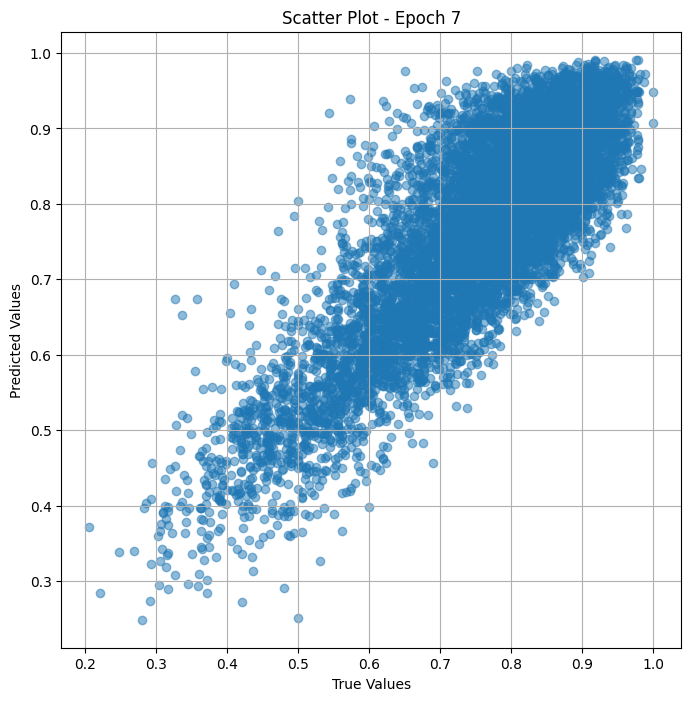


 Epoch: (8/50) Loss = 0.0021607154048979282

 Epoch: (8/50) Loss_rmse = 0.046483494341373444

 Epoch: (8/50) R^2 = 0.4775990843772888

 Epoch: (8/50) MAE = 0.03963254392147064

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.447

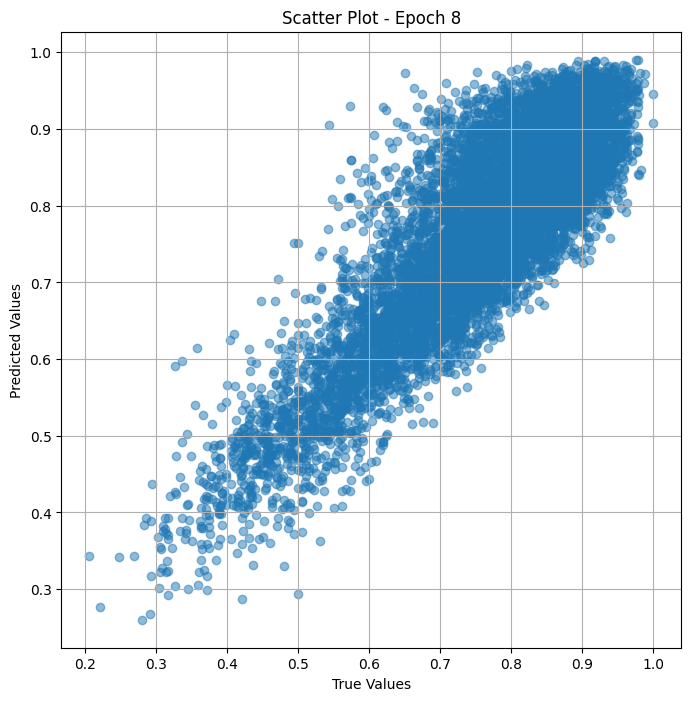


 Epoch: (9/50) Loss = 0.0016552222659811378

 Epoch: (9/50) Loss_rmse = 0.040684424340724945

 Epoch: (9/50) R^2 = 0.5998132228851318

 Epoch: (9/50) MAE = 0.034004583954811096

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.44

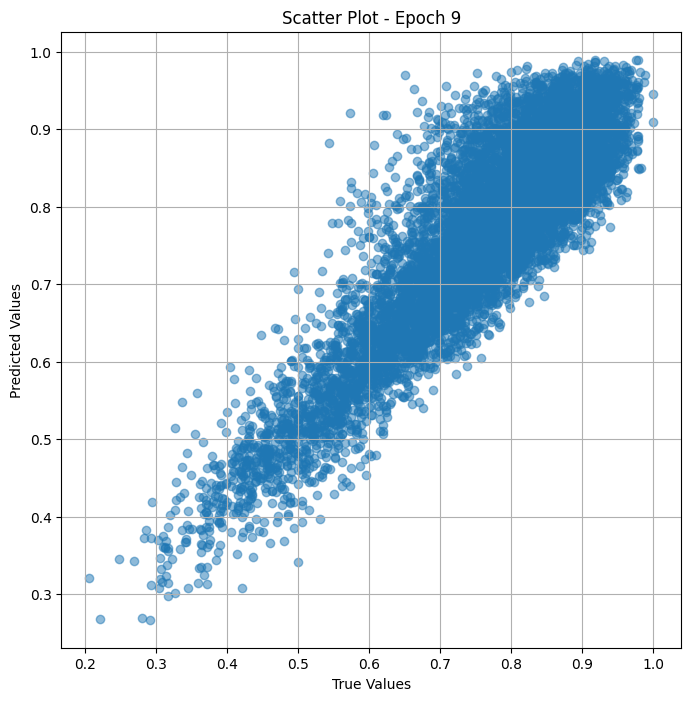


 Epoch: (10/50) Loss = 0.001199956750497222

 Epoch: (10/50) Loss_rmse = 0.034640390425920486

 Epoch: (10/50) R^2 = 0.7098838090896606

 Epoch: (10/50) MAE = 0.028321757912635803

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

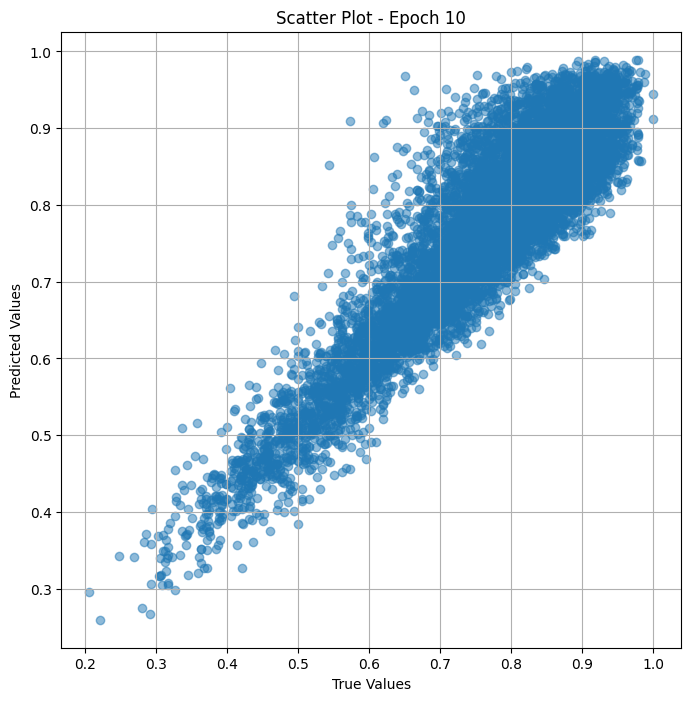


 Epoch: (11/50) Loss = 0.0008633223478682339

 Epoch: (11/50) Loss_rmse = 0.02938234806060791

 Epoch: (11/50) R^2 = 0.7912726402282715

 Epoch: (11/50) MAE = 0.023298881947994232

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

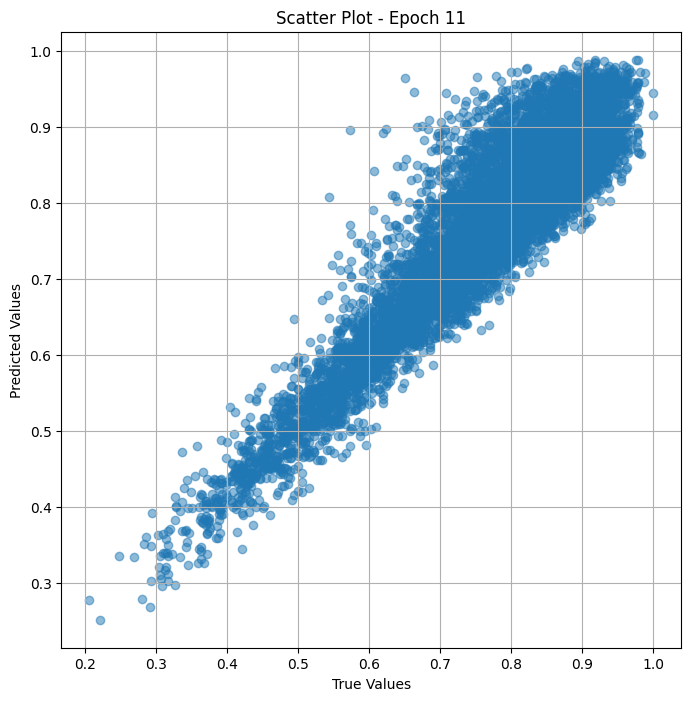


 Epoch: (12/50) Loss = 0.0005807559355162084

 Epoch: (12/50) Loss_rmse = 0.024098878726363182

 Epoch: (12/50) R^2 = 0.8595893383026123

 Epoch: (12/50) MAE = 0.017969101667404175

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

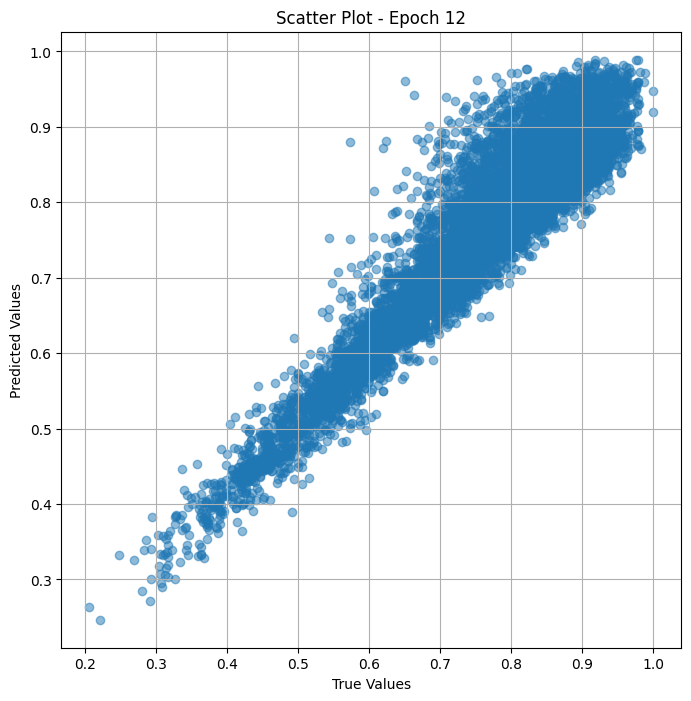


 Epoch: (13/50) Loss = 0.0004161922843195498

 Epoch: (13/50) Loss_rmse = 0.020400790497660637

 Epoch: (13/50) R^2 = 0.8993762731552124

 Epoch: (13/50) MAE = 0.015454232692718506

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

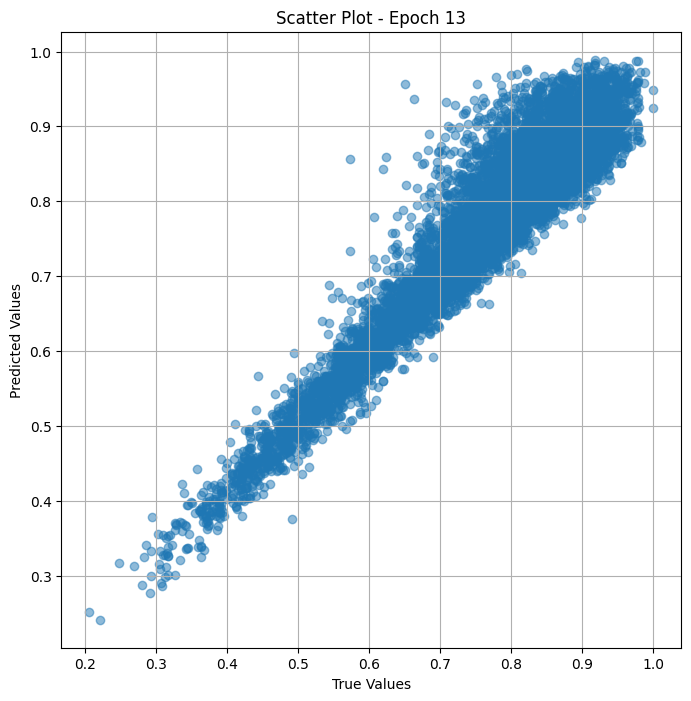


 Epoch: (14/50) Loss = 0.0003121144836768508

 Epoch: (14/50) Loss_rmse = 0.017666762694716454

 Epoch: (14/50) R^2 = 0.9245393872261047

 Epoch: (14/50) MAE = 0.014624573290348053

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

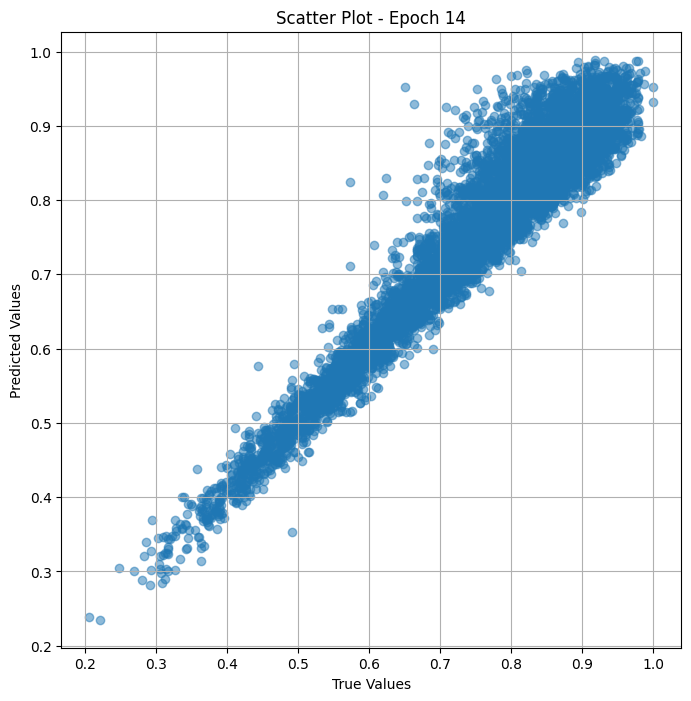


 Epoch: (15/50) Loss = 0.00023698291624896228

 Epoch: (15/50) Loss_rmse = 0.015394248999655247

 Epoch: (15/50) R^2 = 0.9427041411399841

 Epoch: (15/50) MAE = 0.012964673340320587

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

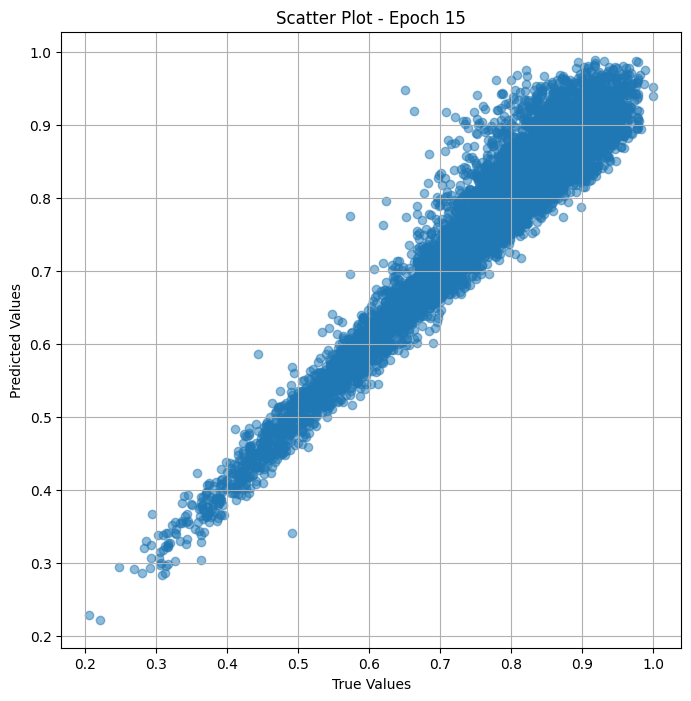


 Epoch: (16/50) Loss = 0.00023465094272978604

 Epoch: (16/50) Loss_rmse = 0.015318320132791996

 Epoch: (16/50) R^2 = 0.9432679414749146

 Epoch: (16/50) MAE = 0.013017863035202026

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

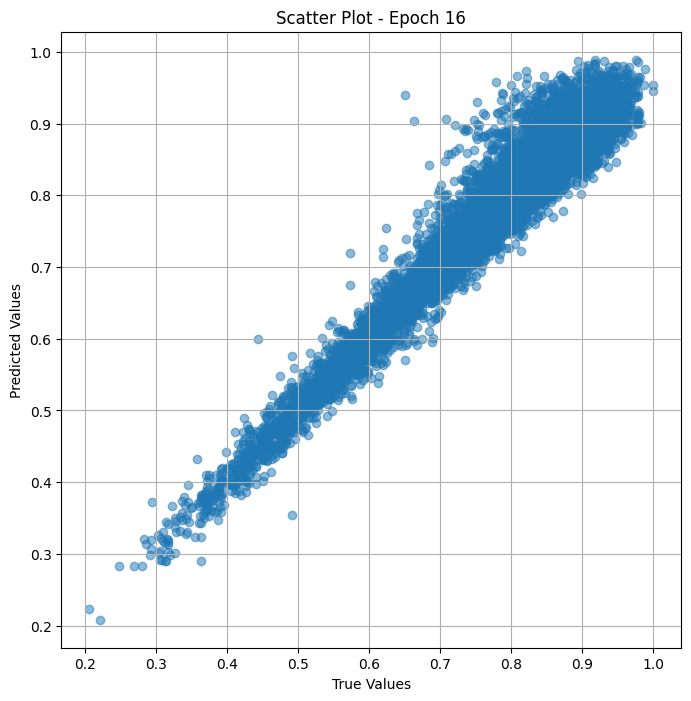


 Epoch: (17/50) Loss = 0.0005131736979819834

 Epoch: (17/50) Loss_rmse = 0.022653337568044662

 Epoch: (17/50) R^2 = 0.8759288787841797

 Epoch: (17/50) MAE = 0.016889020800590515

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

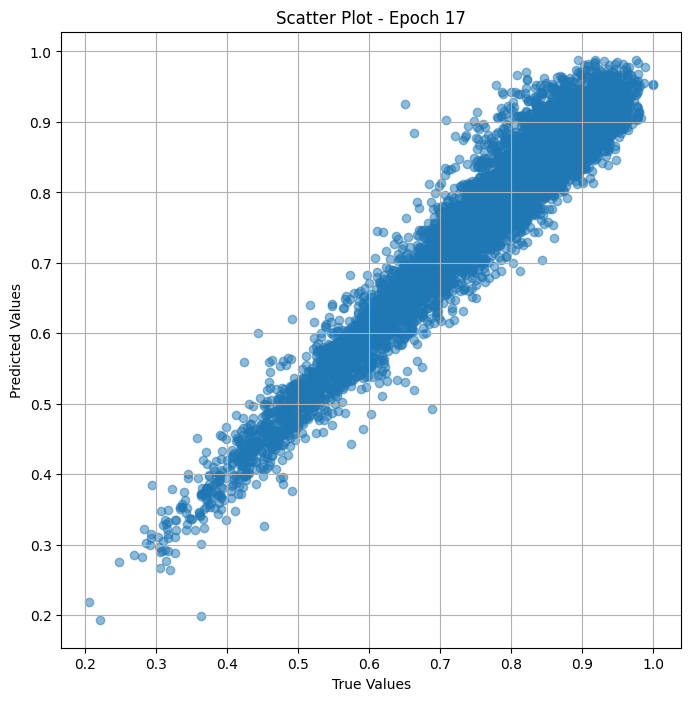


 Epoch: (18/50) Loss = 0.00990390870720148

 Epoch: (18/50) Loss_rmse = 0.09951838105916977

 Epoch: (18/50) R^2 = -1.3944900035858154

 Epoch: (18/50) MAE = 0.0939493253827095

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.44

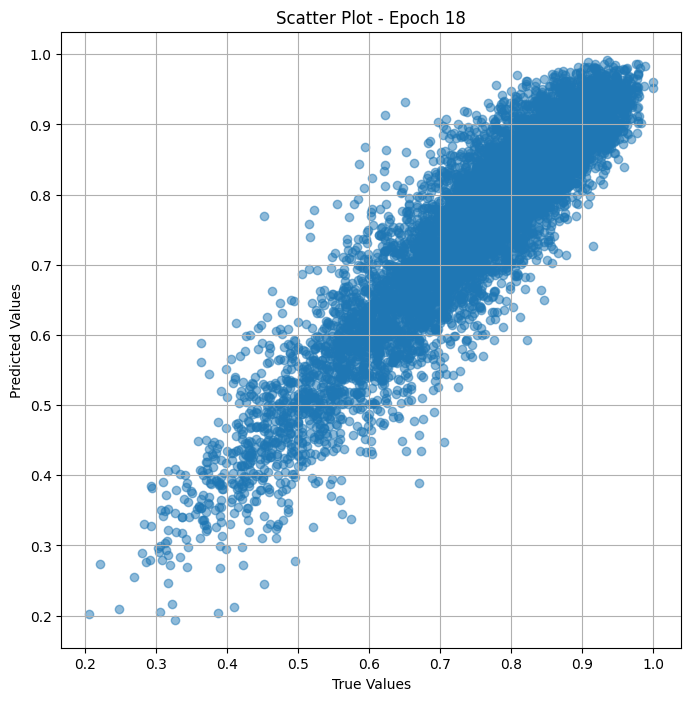


 Epoch: (19/50) Loss = 0.0008694322896189988

 Epoch: (19/50) Loss_rmse = 0.02948613651096821

 Epoch: (19/50) R^2 = 0.7897953987121582

 Epoch: (19/50) MAE = 0.023383520543575287

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

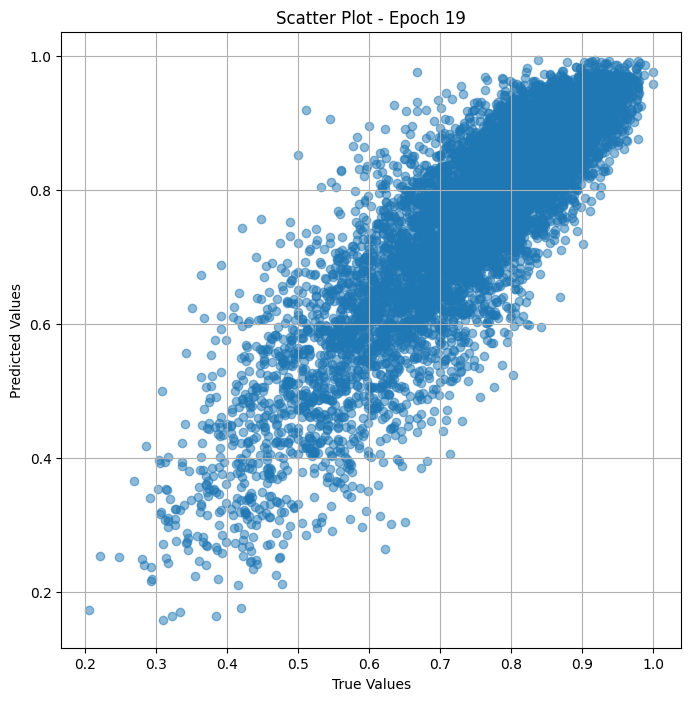


 Epoch: (20/50) Loss = 0.0014029352460056543

 Epoch: (20/50) Loss_rmse = 0.03745577856898308

 Epoch: (20/50) R^2 = 0.6608092784881592

 Epoch: (20/50) MAE = 0.03404771536588669

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.

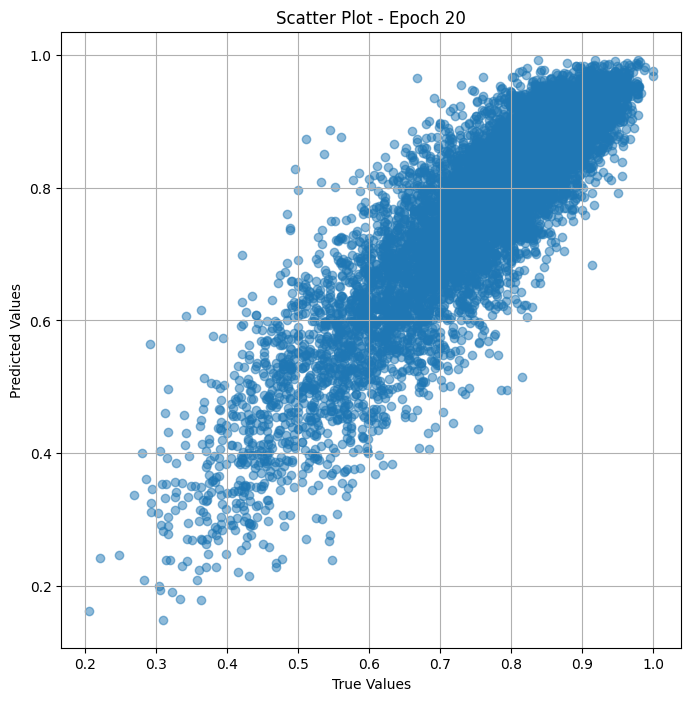


 Epoch: (21/50) Loss = 0.001244388404302299

 Epoch: (21/50) Loss_rmse = 0.0352758914232254

 Epoch: (21/50) R^2 = 0.6991415023803711

 Epoch: (21/50) MAE = 0.03246403485536575

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.44

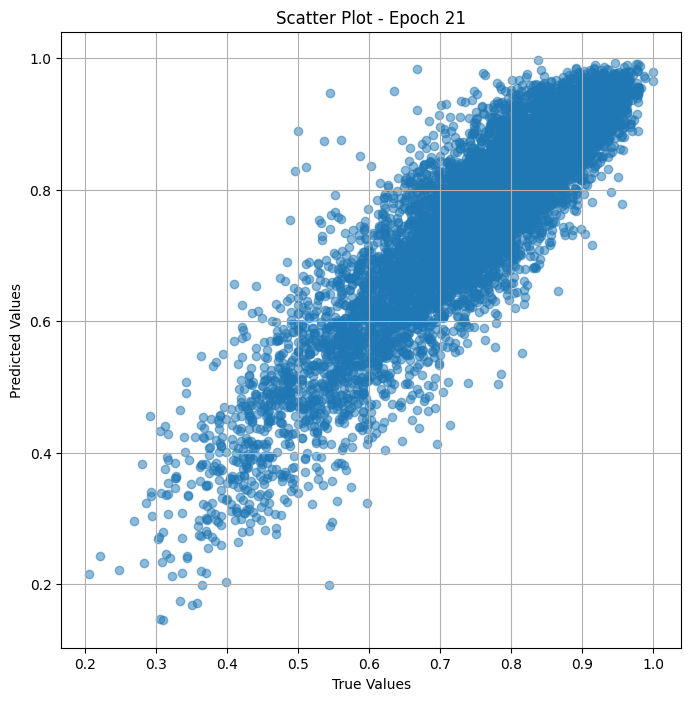


 Epoch: (22/50) Loss = 0.001026439480483532

 Epoch: (22/50) Loss_rmse = 0.032038092613220215

 Epoch: (22/50) R^2 = 0.7518354654312134

 Epoch: (22/50) MAE = 0.028879567980766296

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

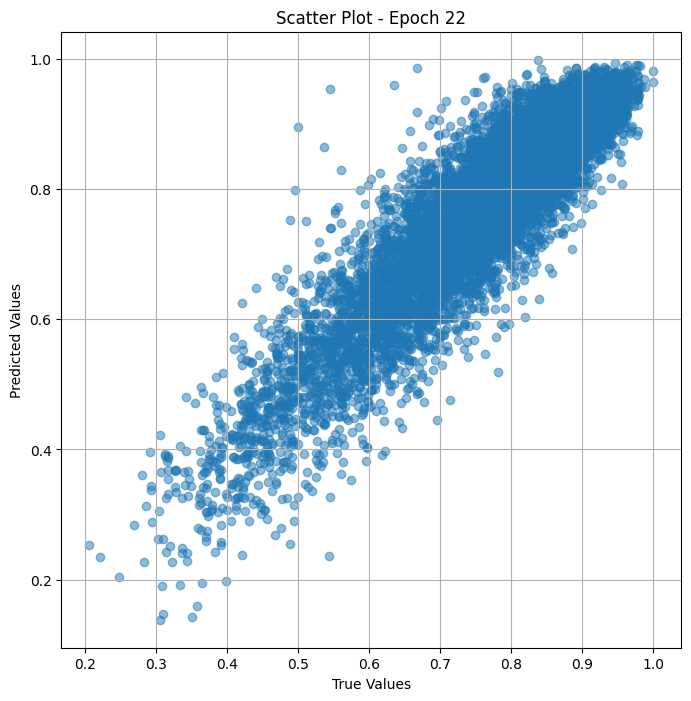


 Epoch: (23/50) Loss = 0.0008242878830060363

 Epoch: (23/50) Loss_rmse = 0.028710413724184036

 Epoch: (23/50) R^2 = 0.8007100820541382

 Epoch: (23/50) MAE = 0.024691656231880188

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

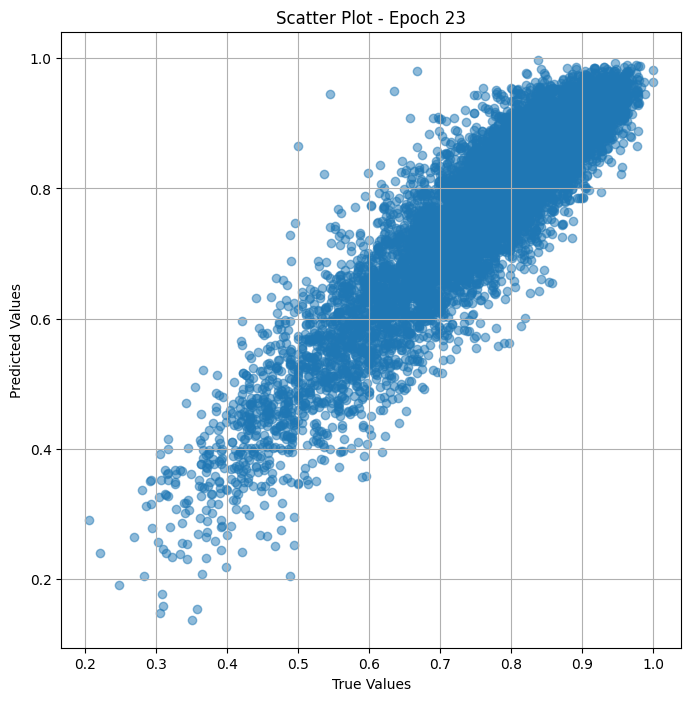


 Epoch: (24/50) Loss = 0.0007812716066837311

 Epoch: (24/50) Loss_rmse = 0.027951236814260483

 Epoch: (24/50) R^2 = 0.811110258102417

 Epoch: (24/50) MAE = 0.02343173325061798

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.

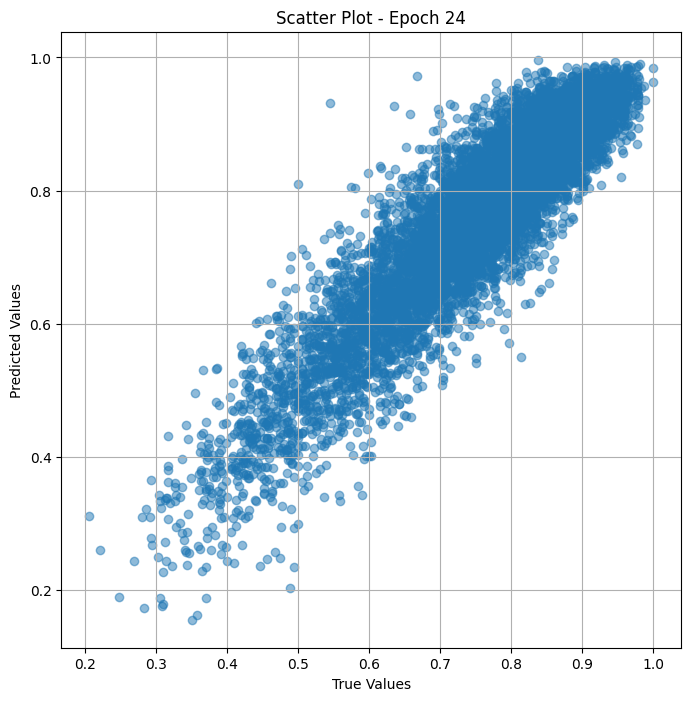


 Epoch: (25/50) Loss = 0.0008665178902447224

 Epoch: (25/50) Loss_rmse = 0.02943667583167553

 Epoch: (25/50) R^2 = 0.7905000448226929

 Epoch: (25/50) MAE = 0.024032019078731537

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

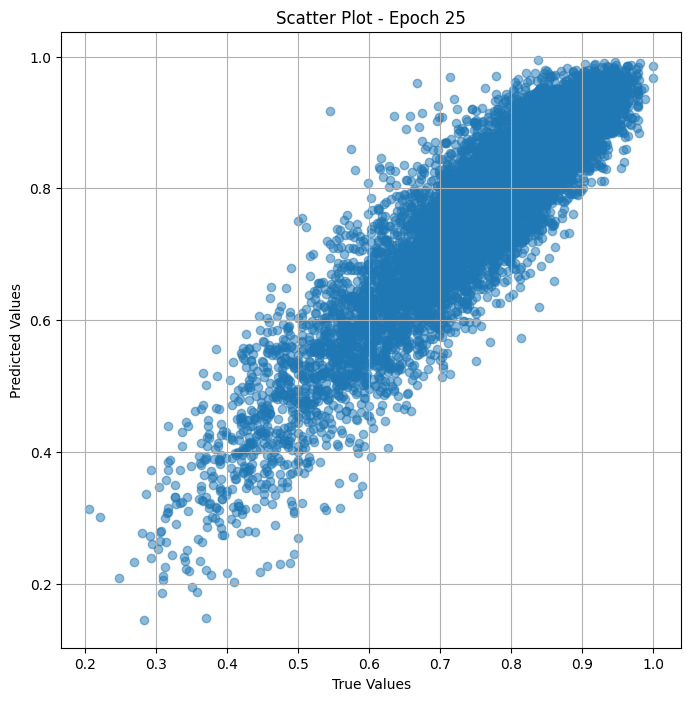


 Epoch: (26/50) Loss = 0.0007240623817779124

 Epoch: (26/50) Loss_rmse = 0.026908406987786293

 Epoch: (26/50) R^2 = 0.824941873550415

 Epoch: (26/50) MAE = 0.023381583392620087

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

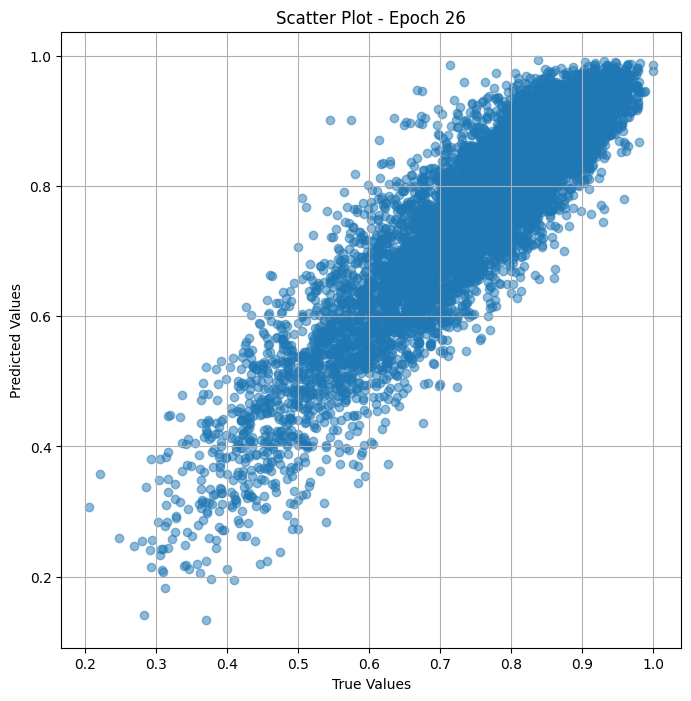


 Epoch: (27/50) Loss = 0.00046382637810893357

 Epoch: (27/50) Loss_rmse = 0.021536629647016525

 Epoch: (27/50) R^2 = 0.8878597021102905

 Epoch: (27/50) MAE = 0.018005169928073883

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

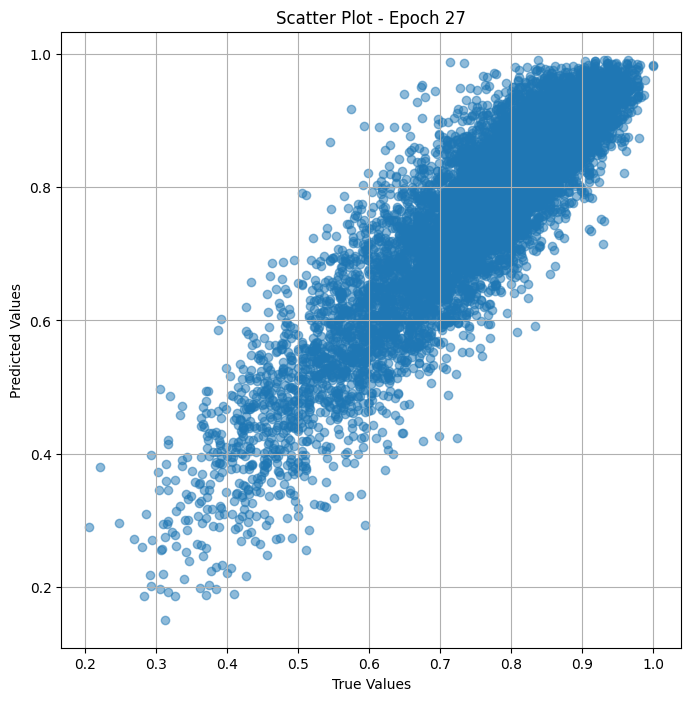


 Epoch: (28/50) Loss = 0.0009432569495402277

 Epoch: (28/50) Loss_rmse = 0.030712489038705826

 Epoch: (28/50) R^2 = 0.7719466686248779

 Epoch: (28/50) MAE = 0.02190222591161728

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

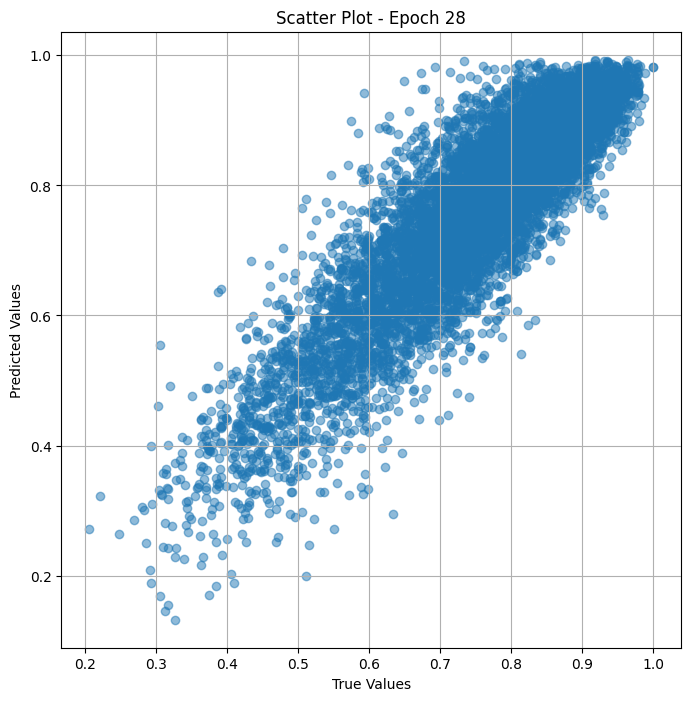


 Epoch: (29/50) Loss = 0.000613926793448627

 Epoch: (29/50) Loss_rmse = 0.024777546525001526

 Epoch: (29/50) R^2 = 0.8515695333480835

 Epoch: (29/50) MAE = 0.019119977951049805

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

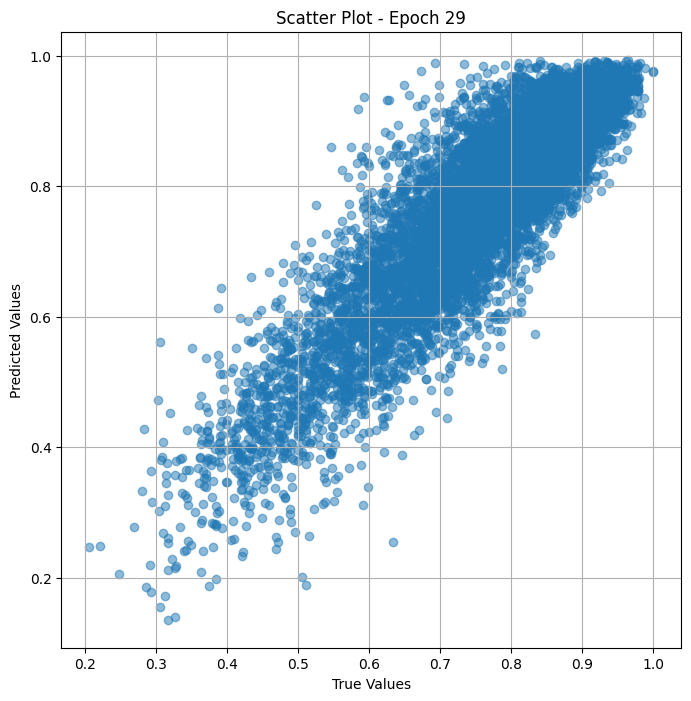


 Epoch: (30/50) Loss = 0.0005068136379122734

 Epoch: (30/50) Loss_rmse = 0.022512521594762802

 Epoch: (30/50) R^2 = 0.8774665594100952

 Epoch: (30/50) MAE = 0.016418330371379852

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

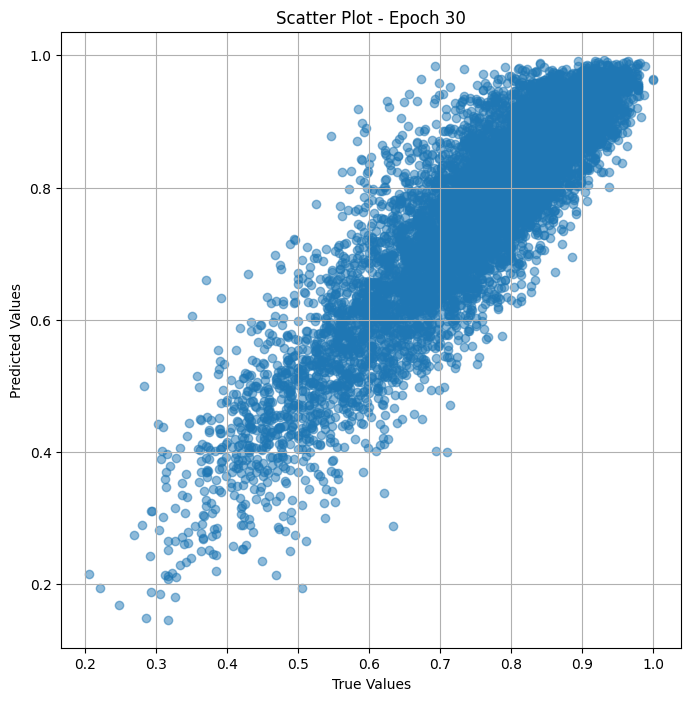


 Epoch: (31/50) Loss = 0.0003726190479937941

 Epoch: (31/50) Loss_rmse = 0.019303342327475548

 Epoch: (31/50) R^2 = 0.909911036491394

 Epoch: (31/50) MAE = 0.014435172080993652

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

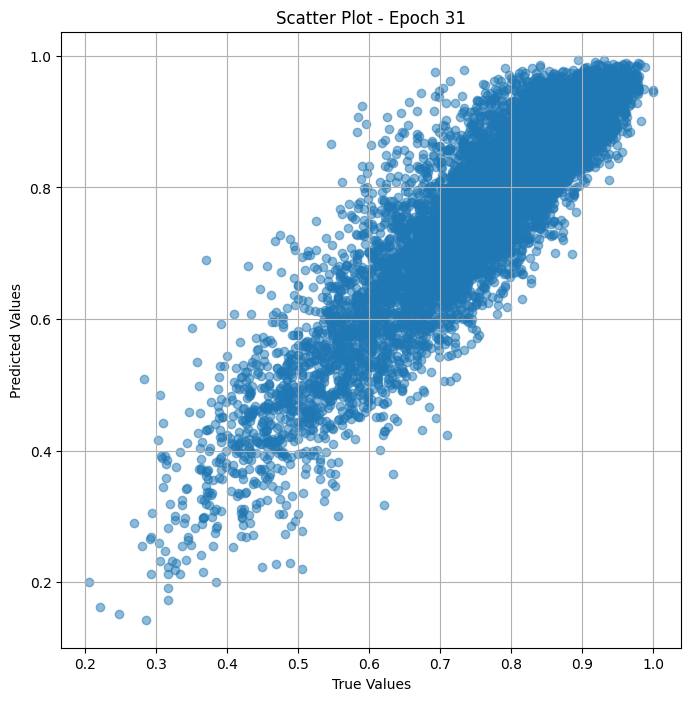


 Epoch: (32/50) Loss = 0.00037233976763673127

 Epoch: (32/50) Loss_rmse = 0.019296107813715935

 Epoch: (32/50) R^2 = 0.9099785685539246

 Epoch: (32/50) MAE = 0.015028506517410278

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

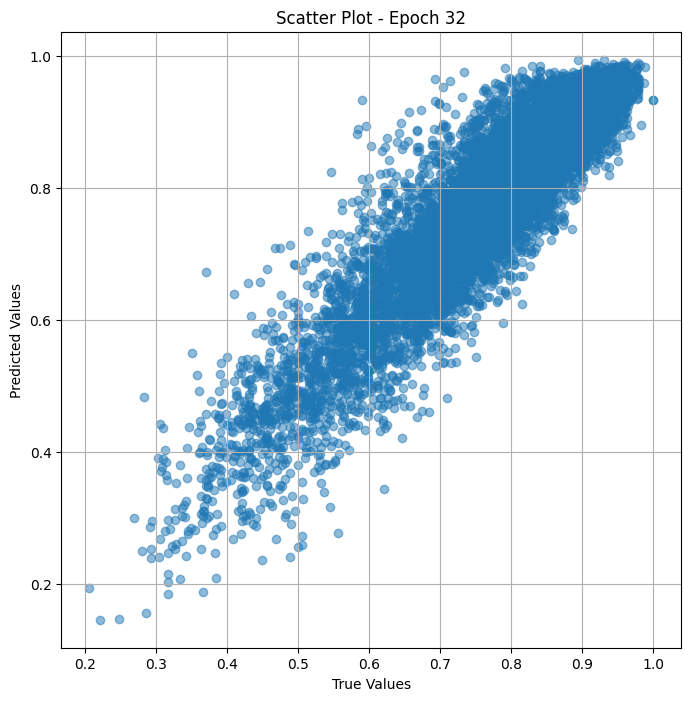


 Epoch: (33/50) Loss = 0.0004145782149862498

 Epoch: (33/50) Loss_rmse = 0.020361194387078285

 Epoch: (33/50) R^2 = 0.8997665047645569

 Epoch: (33/50) MAE = 0.015851378440856934

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

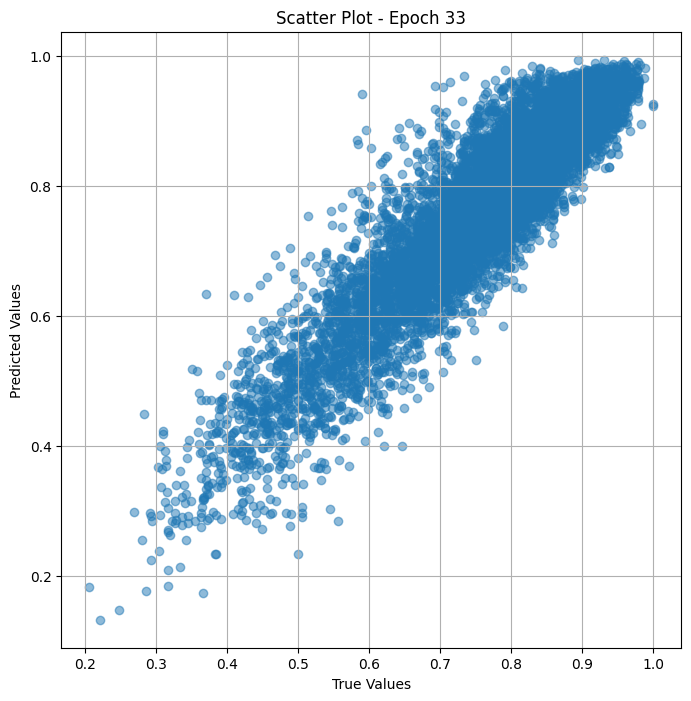


 Epoch: (34/50) Loss = 0.0005150882643647492

 Epoch: (34/50) Loss_rmse = 0.02269555628299713

 Epoch: (34/50) R^2 = 0.875465989112854

 Epoch: (34/50) MAE = 0.01946154236793518

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.4

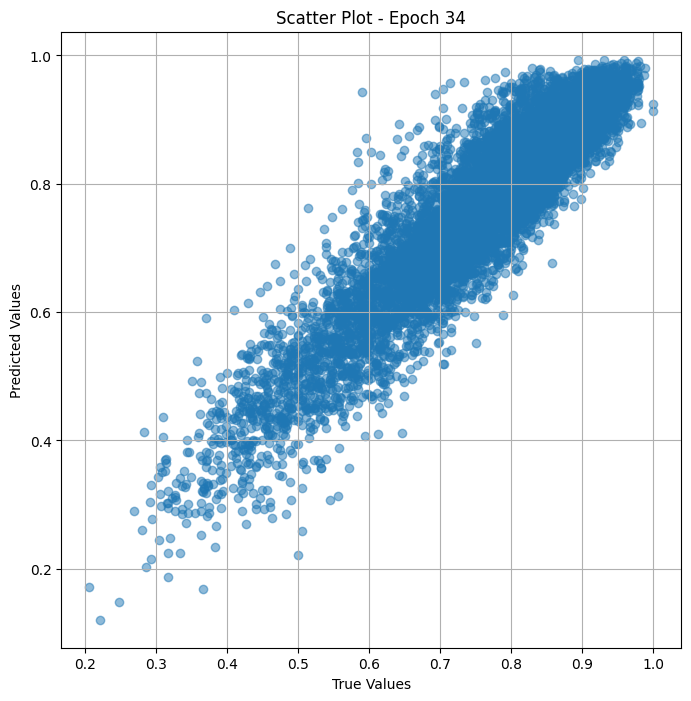


 Epoch: (35/50) Loss = 0.0006205803947523236

 Epoch: (35/50) Loss_rmse = 0.02491145022213459

 Epoch: (35/50) R^2 = 0.8499609231948853

 Epoch: (35/50) MAE = 0.021962672472000122

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

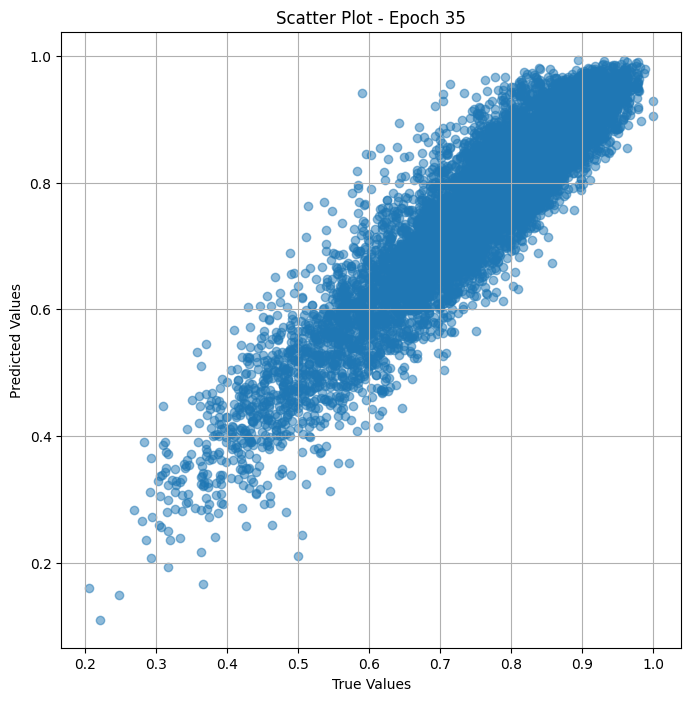


 Epoch: (36/50) Loss = 0.0007334906840696931

 Epoch: (36/50) Loss_rmse = 0.027083033695816994

 Epoch: (36/50) R^2 = 0.822662353515625

 Epoch: (36/50) MAE = 0.023389063775539398

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

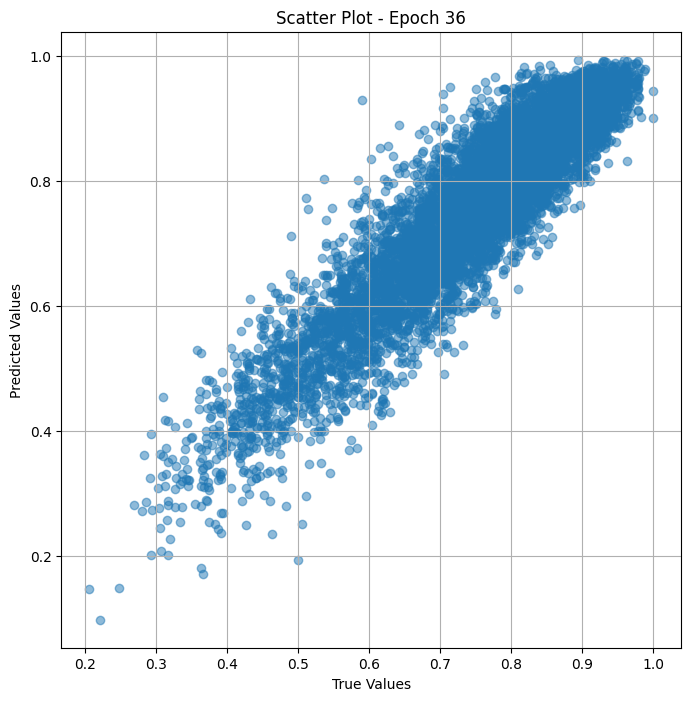


 Epoch: (37/50) Loss = 0.0007685094606131315

 Epoch: (37/50) Loss_rmse = 0.027722002938389778

 Epoch: (37/50) R^2 = 0.8141957521438599

 Epoch: (37/50) MAE = 0.022164009511470795

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

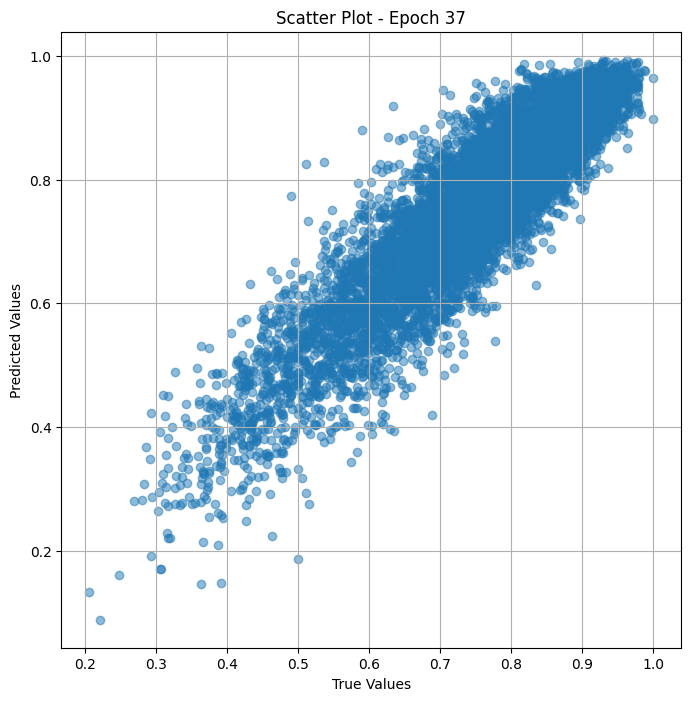


 Epoch: (38/50) Loss = 0.0014192620292305946

 Epoch: (38/50) Loss_rmse = 0.037673093378543854

 Epoch: (38/50) R^2 = 0.6568619012832642

 Epoch: (38/50) MAE = 0.02890181541442871

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

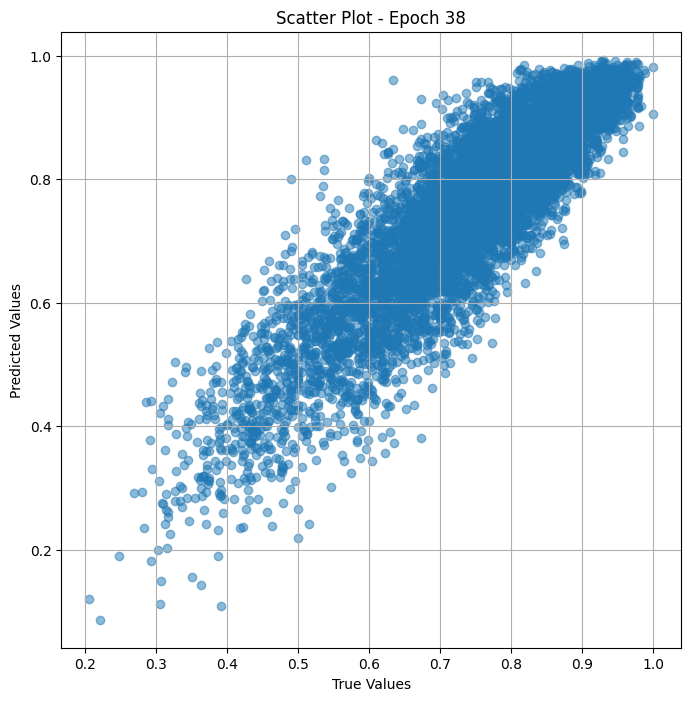


 Epoch: (39/50) Loss = 0.001055204076692462

 Epoch: (39/50) Loss_rmse = 0.03248390555381775

 Epoch: (39/50) R^2 = 0.7448809742927551

 Epoch: (39/50) MAE = 0.028121456503868103

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.

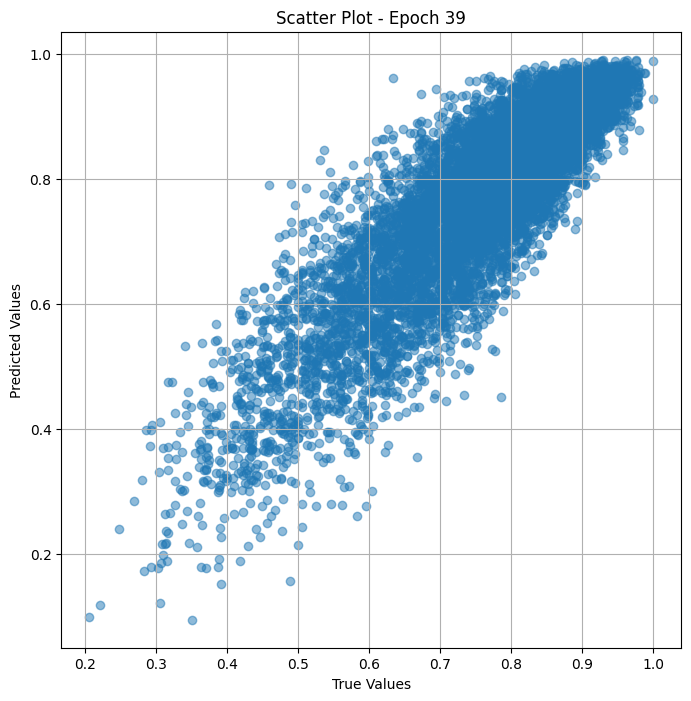


 Epoch: (40/50) Loss = 0.0006072846008464694

 Epoch: (40/50) Loss_rmse = 0.024643145501613617

 Epoch: (40/50) R^2 = 0.8531754612922668

 Epoch: (40/50) MAE = 0.018412739038467407

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

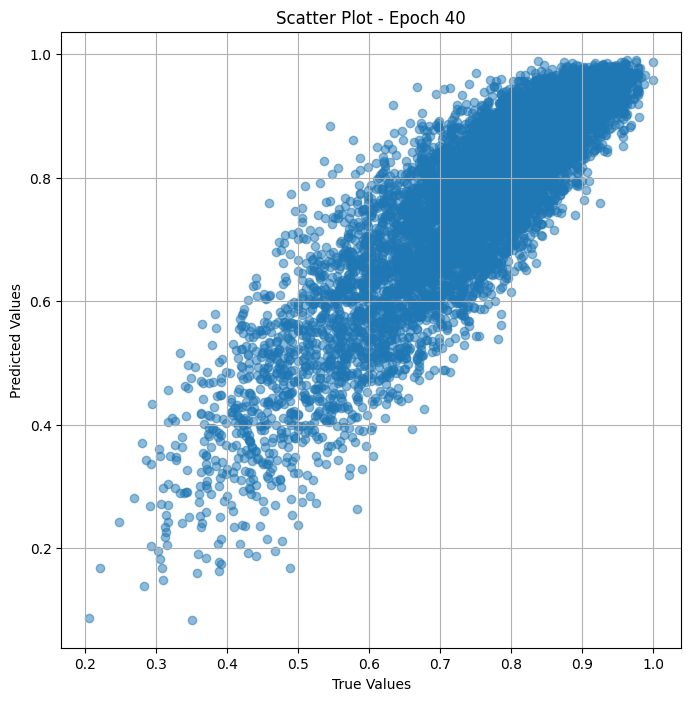


 Epoch: (41/50) Loss = 0.0006144071230664849

 Epoch: (41/50) Loss_rmse = 0.024787237867712975

 Epoch: (41/50) R^2 = 0.851453423500061

 Epoch: (41/50) MAE = 0.020251475274562836

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

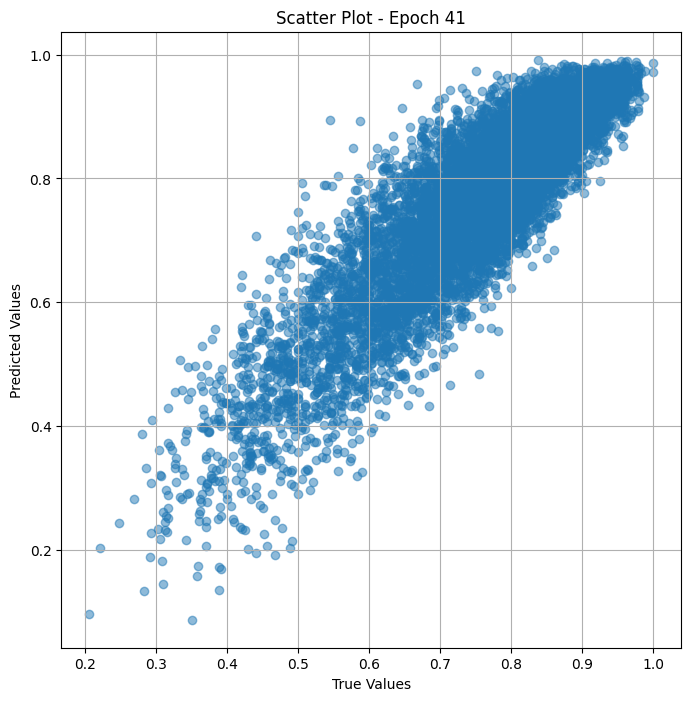


 Epoch: (42/50) Loss = 0.0006589227123185992

 Epoch: (42/50) Loss_rmse = 0.025669489055871964

 Epoch: (42/50) R^2 = 0.8406907916069031

 Epoch: (42/50) MAE = 0.021635502576828003

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

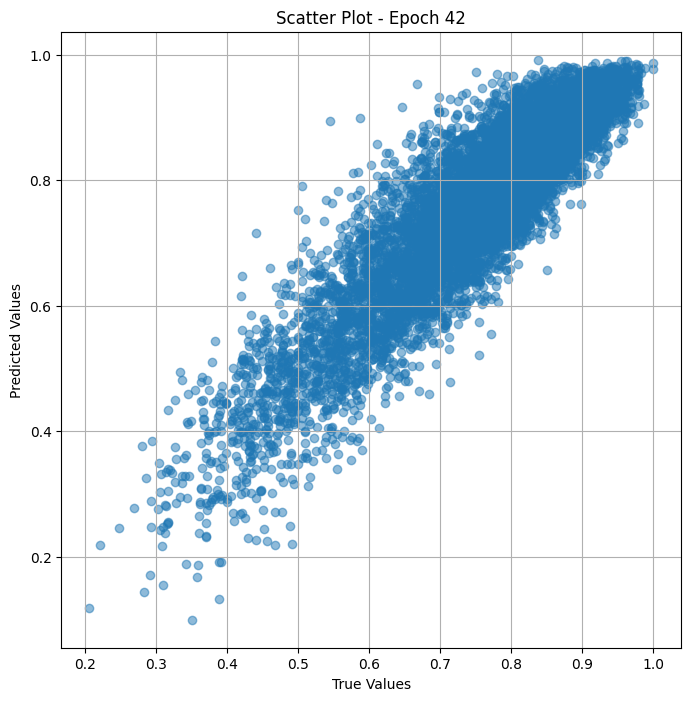


 Epoch: (43/50) Loss = 0.0005902950651943684

 Epoch: (43/50) Loss_rmse = 0.02429598942399025

 Epoch: (43/50) R^2 = 0.8572830557823181

 Epoch: (43/50) MAE = 0.02028053253889084

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0.

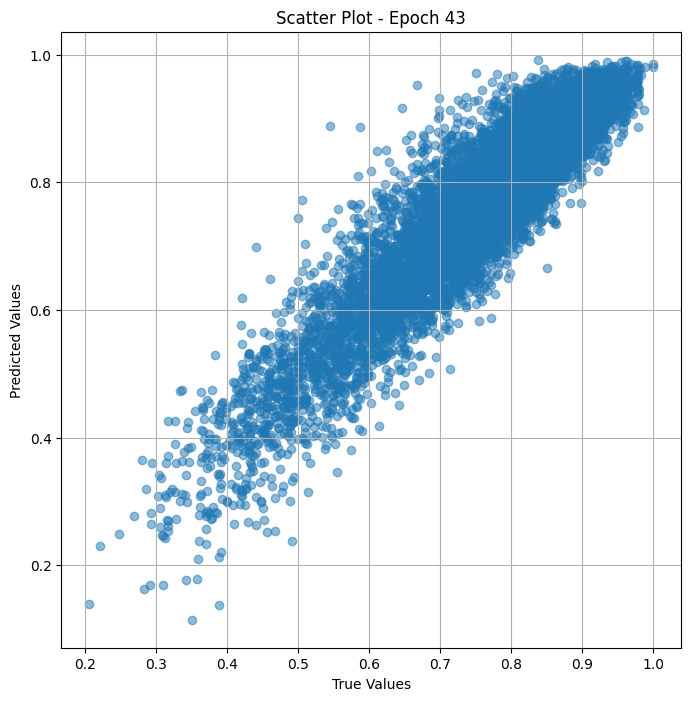


 Epoch: (44/50) Loss = 0.0004859488981310278

 Epoch: (44/50) Loss_rmse = 0.02204424887895584

 Epoch: (44/50) R^2 = 0.8825110793113708

 Epoch: (44/50) MAE = 0.018738262355327606

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 0

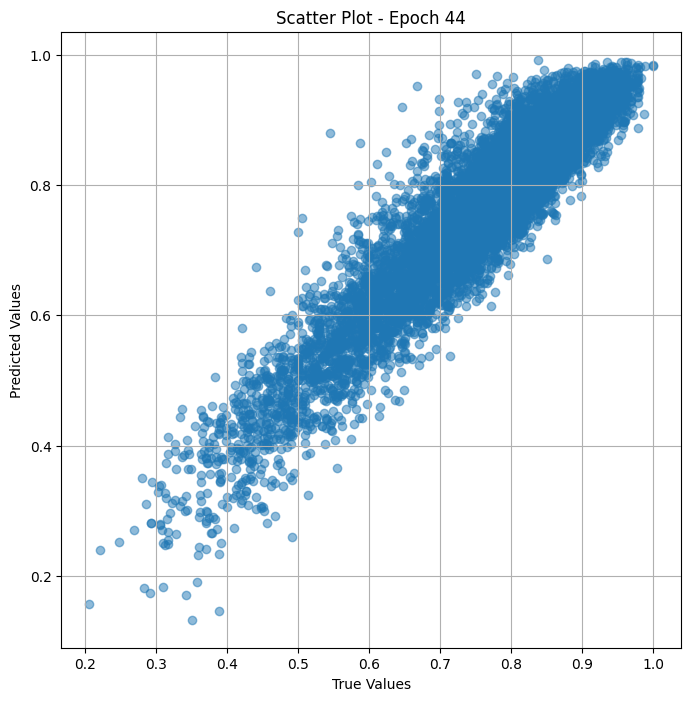


 Epoch: (45/50) Loss = 0.00041867088293656707

 Epoch: (45/50) Loss_rmse = 0.020461449399590492

 Epoch: (45/50) R^2 = 0.8987770080566406

 Epoch: (45/50) MAE = 0.016613714396953583

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

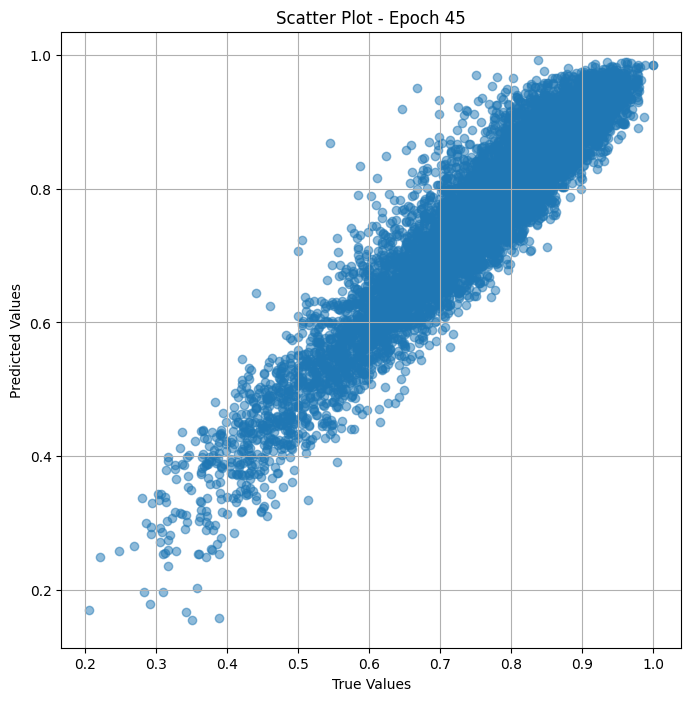


 Epoch: (46/50) Loss = 0.00036830821773037314

 Epoch: (46/50) Loss_rmse = 0.019191358238458633

 Epoch: (46/50) R^2 = 0.9109532833099365

 Epoch: (46/50) MAE = 0.014406800270080566

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

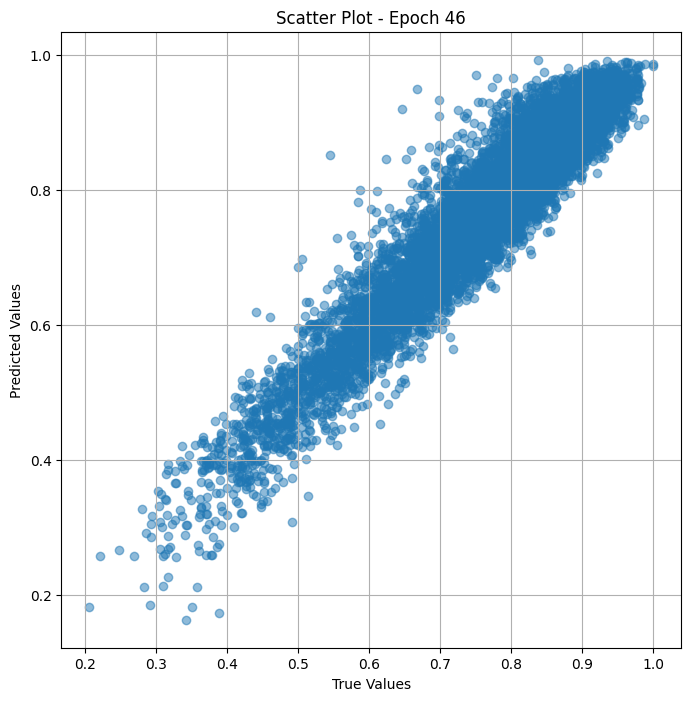


 Epoch: (47/50) Loss = 0.00031832142849452794

 Epoch: (47/50) Loss_rmse = 0.017841564491391182

 Epoch: (47/50) R^2 = 0.9230387210845947

 Epoch: (47/50) MAE = 0.013575680553913116

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

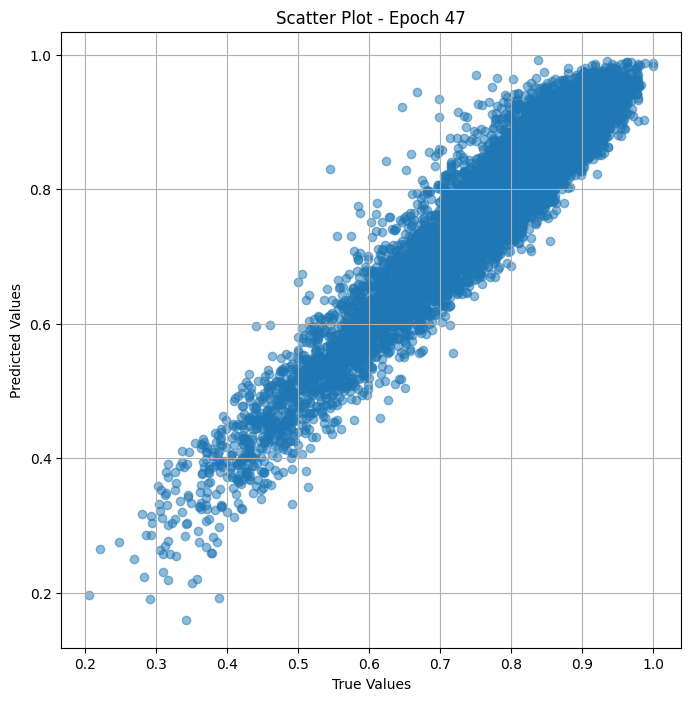


 Epoch: (48/50) Loss = 0.00027613373822532594

 Epoch: (48/50) Loss_rmse = 0.016617272049188614

 Epoch: (48/50) R^2 = 0.9332385063171387

 Epoch: (48/50) MAE = 0.014330044388771057

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043,

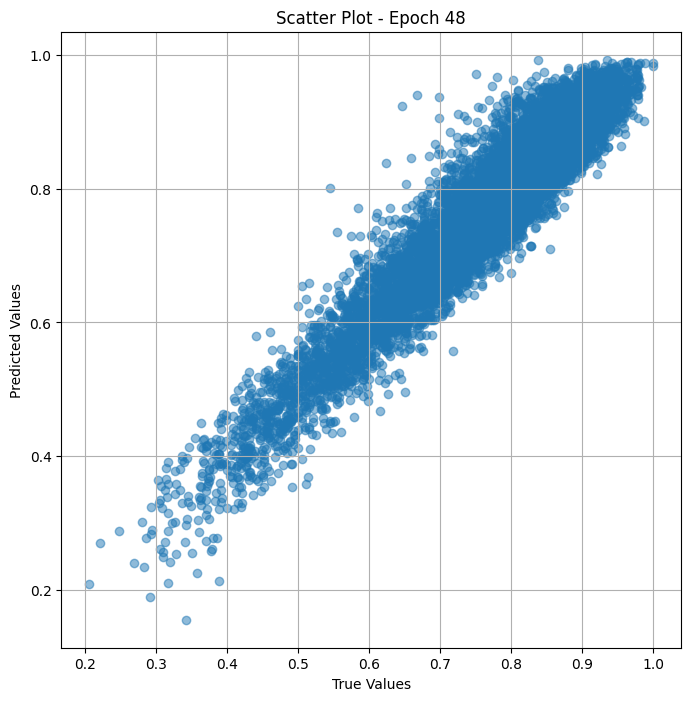


 Epoch: (49/50) Loss = 0.0004616255755536258

 Epoch: (49/50) Loss_rmse = 0.021485473960638046

 Epoch: (49/50) R^2 = 0.8883917331695557

 Epoch: (49/50) MAE = 0.019357800483703613

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

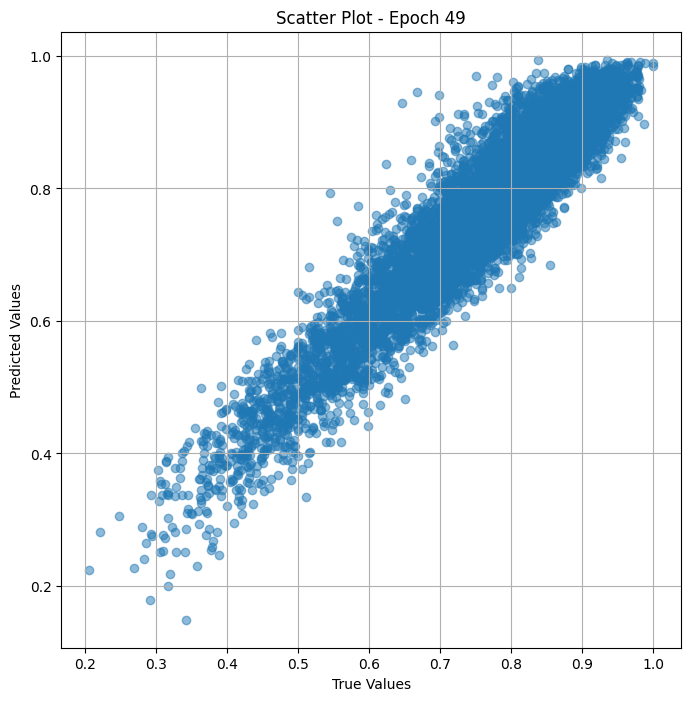


 Epoch: (50/50) Loss = 0.0024186258669942617

 Epoch: (50/50) Loss_rmse = 0.049179527908563614

 Epoch: (50/50) R^2 = 0.4152434468269348

 Epoch: (50/50) MAE = 0.040834955871105194

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.8898305, 0.79591835, 0.5726496, 0.7745098, 0.5904762, 0.81609195, 0.87096775, 0.7765958, 0.92783505, 0.79816514, 0.8333333, 0.83809525, 0.8811881, 0.8956522, 0.7281553, 0.84761906, 0.84158415, 0.47777778, 0.8712871, 0.8586956, 0.8712871, 0.5478261, 0.7154471, 0.8857143, 0.85227275, 0.82417583, 0.8224299, 0.8543689, 0.9, 0.76842105, 0.8545455, 0.875, 0.9207921, 0.7920792, 0.41904762, 0.5, 0.8425926, 0.78350514, 0.83516484, 0.83838385, 0.7522124, 0.7920792, 0.8095238, 0.7096774, 0.90909094, 0.95652175, 0.71428573, 0.8041237, 0.77884614, 0.8313253, 0.92913383, 0.7425743, 0.902439, 0.43396226, 0.9166667, 0.8761062, 0.625, 0.754717, 0.6938776, 0.6698113, 0.8181818, 0.8961039, 0.82954544, 0.7809524, 0.7553192, 0.8172043, 

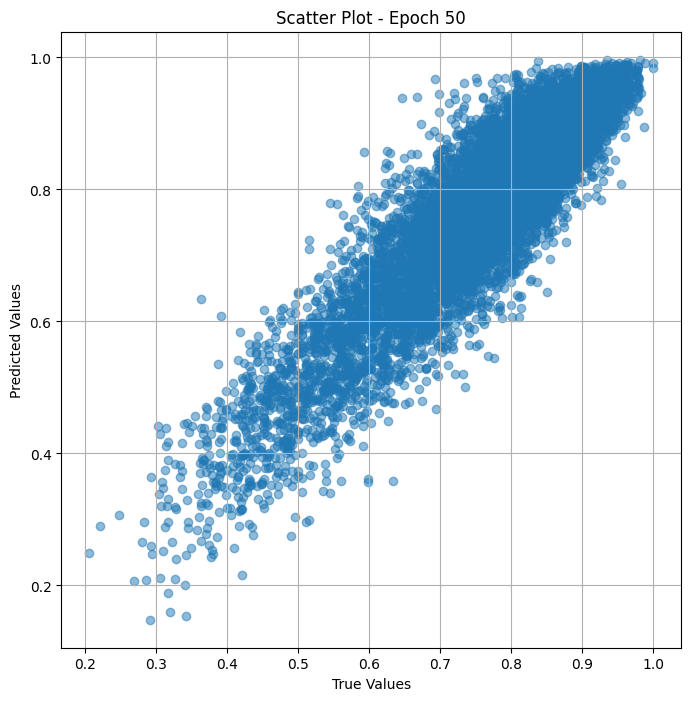

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S_")

## Valid

In [ ]:
# Merge the two models
class model_merge_fine_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


modelfine_val = model_merge_fine_val(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
modelfine_val = to_device(modelfine_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(modelfine_val.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

# Fit function doing grad steps
def fit(epochs, modelfine_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()

    for epoch in range(epochs):
        modelfine_val.train()
        batch_num = 16
        true_values_list = []
        predicted_values_list = []
        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = modelfine_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())

            loss.backward()
            opt.step()
            opt.zero_grad()

            total_loss += loss.item()
            total_loss_rmse += loss_rmse.item()
            total_r2 += r2.item()
            total_mae += mae.item()
            #total_spearman += spearman_corr

            # Increment batch number
            #print('\r', f'batch #{batch_num}: {loss}', end='')
            batch_num += 5

        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        #print('\n', f'Epoch: ({epoch+1}/{epochs}) Spearman = {mean_spearman}')
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        # Plot scatter plot after each epoch
        plot_scatter(true_values_list, predicted_values_list, epoch)


 Epoch: (1/50) Loss = 0.09814123809337616

 Epoch: (1/50) Loss_rmse = 0.313275009393692

 Epoch: (1/50) R^2 = -1.883786678314209

 Epoch: (1/50) MAE = 0.28986549377441406

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.67

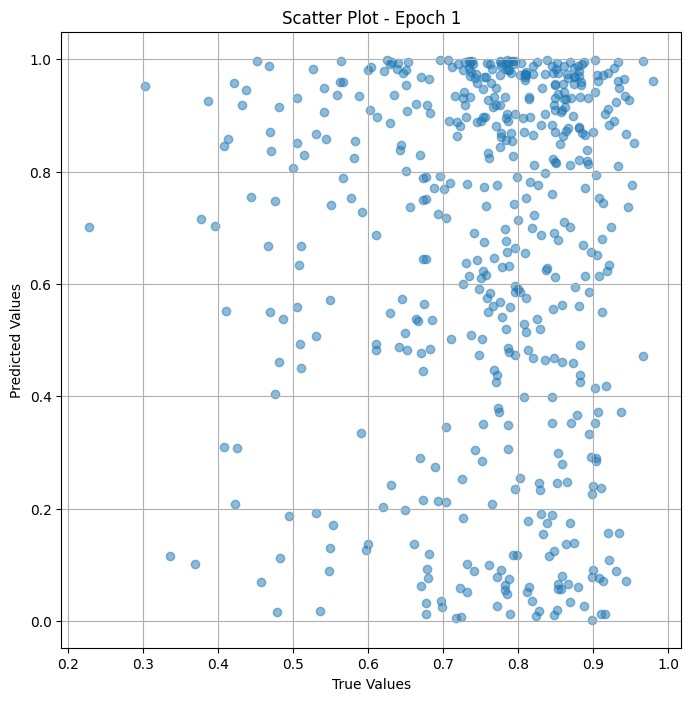


 Epoch: (2/50) Loss = 0.04435061290860176

 Epoch: (2/50) Loss_rmse = 0.21059584617614746

 Epoch: (2/50) R^2 = -0.30320048332214355

 Epoch: (2/50) MAE = 0.18772795796394348

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 

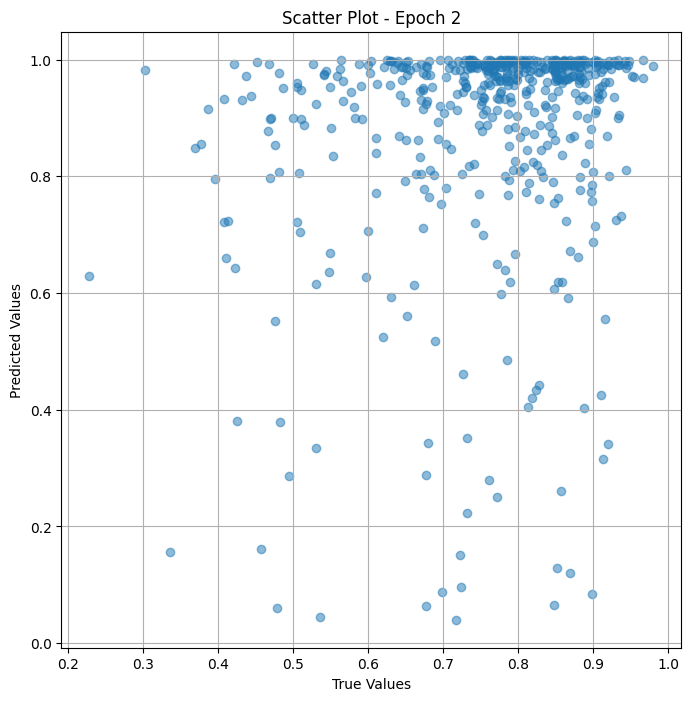


 Epoch: (3/50) Loss = 0.0201167743653059

 Epoch: (3/50) Loss_rmse = 0.1418336182832718

 Epoch: (3/50) R^2 = 0.40888774394989014

 Epoch: (3/50) MAE = 0.12317447364330292

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.6

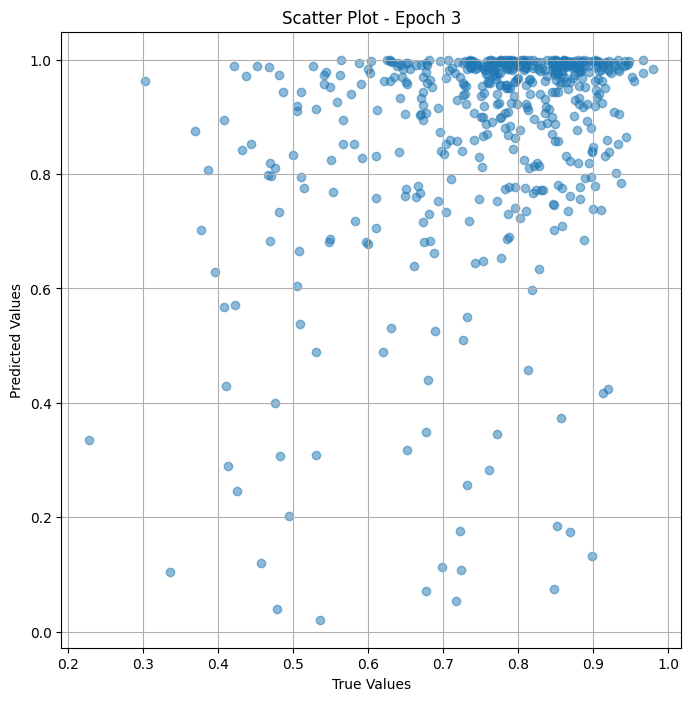


 Epoch: (4/50) Loss = 0.014841859228909016

 Epoch: (4/50) Loss_rmse = 0.12182717025279999

 Epoch: (4/50) R^2 = 0.5638861656188965

 Epoch: (4/50) MAE = 0.10313120484352112

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0

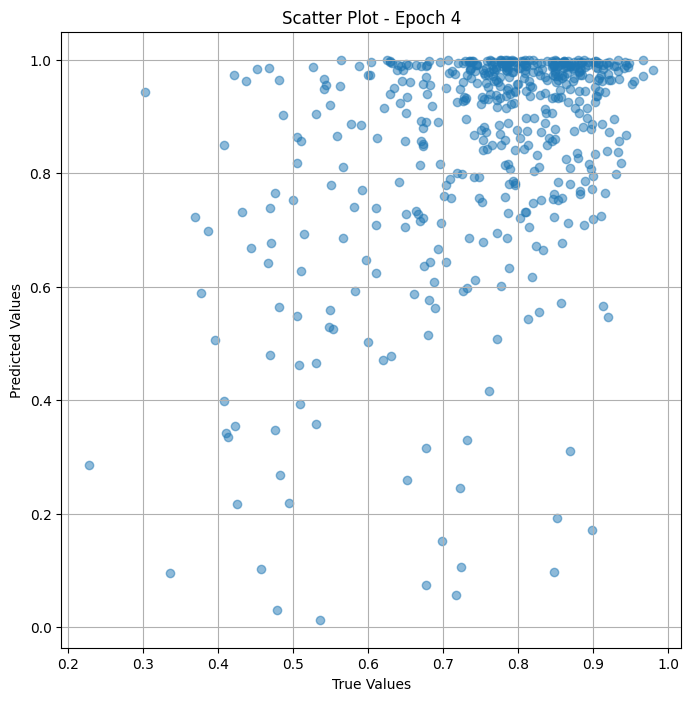


 Epoch: (5/50) Loss = 0.011260902509093285

 Epoch: (5/50) Loss_rmse = 0.10611739754676819

 Epoch: (5/50) R^2 = 0.6691091060638428

 Epoch: (5/50) MAE = 0.08033619076013565

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0

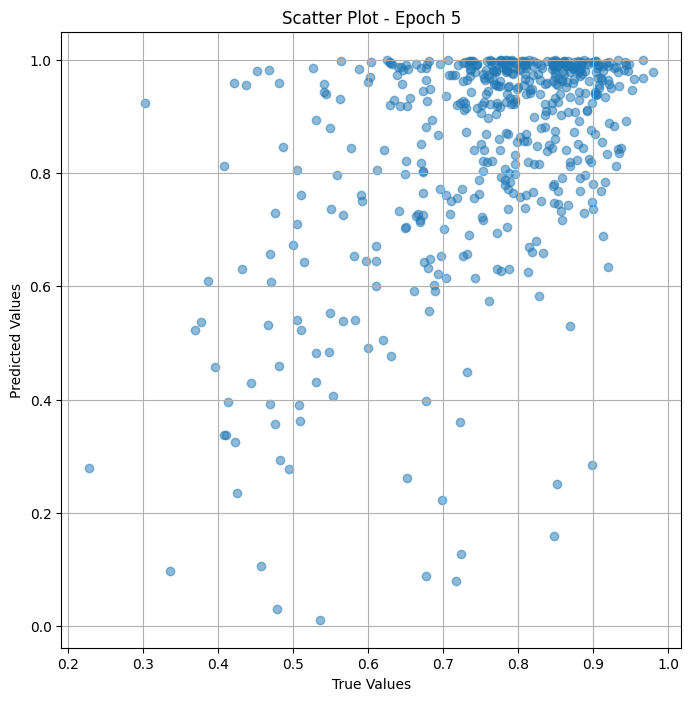


 Epoch: (6/50) Loss = 0.009773996658623219

 Epoch: (6/50) Loss_rmse = 0.09886352717876434

 Epoch: (6/50) R^2 = 0.7128004431724548

 Epoch: (6/50) MAE = 0.06778620928525925

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0

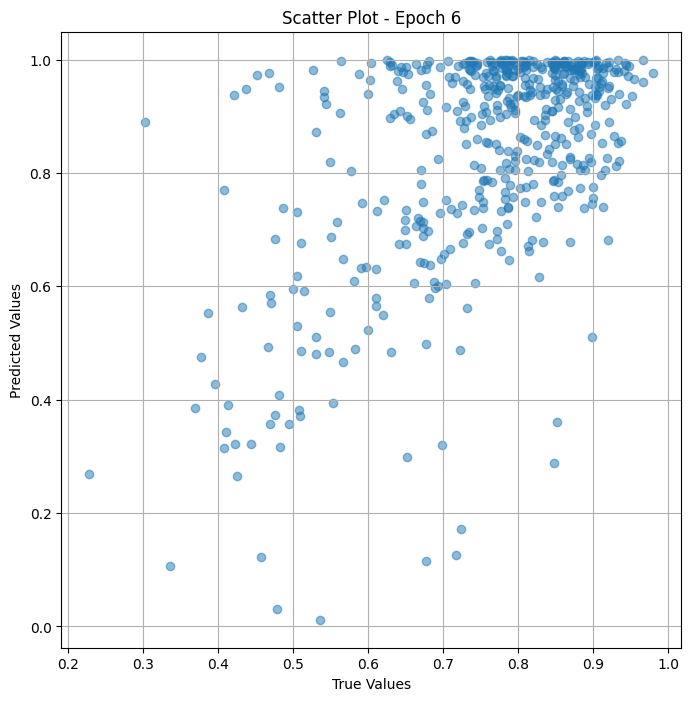


 Epoch: (7/50) Loss = 0.007771600969135761

 Epoch: (7/50) Loss_rmse = 0.08815668523311615

 Epoch: (7/50) R^2 = 0.7716389298439026

 Epoch: (7/50) MAE = 0.0629272609949112

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.

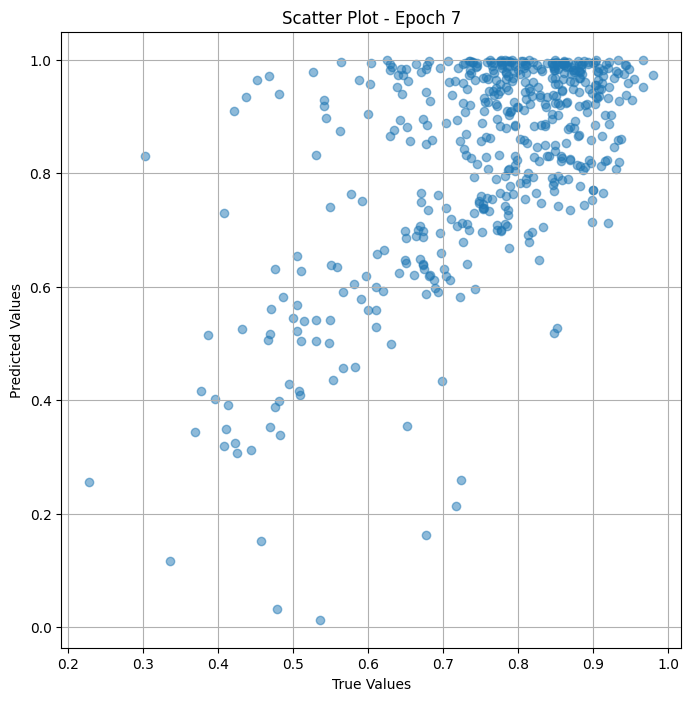


 Epoch: (8/50) Loss = 0.004524874966591597

 Epoch: (8/50) Loss_rmse = 0.06726719439029694

 Epoch: (8/50) R^2 = 0.8670408725738525

 Epoch: (8/50) MAE = 0.04859084635972977

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0

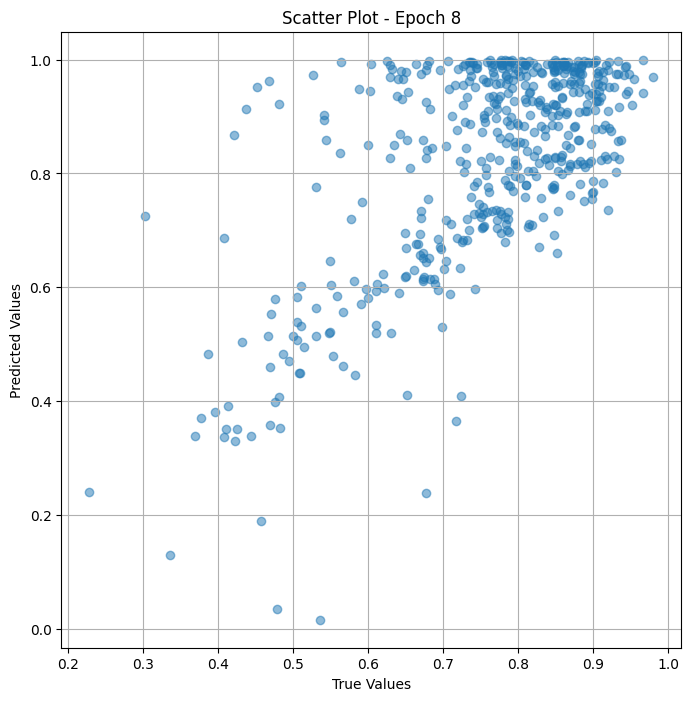


 Epoch: (9/50) Loss = 0.0007599645177833736

 Epoch: (9/50) Loss_rmse = 0.027567453682422638

 Epoch: (9/50) R^2 = 0.9776691794395447

 Epoch: (9/50) MAE = 0.02341289073228836

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275,

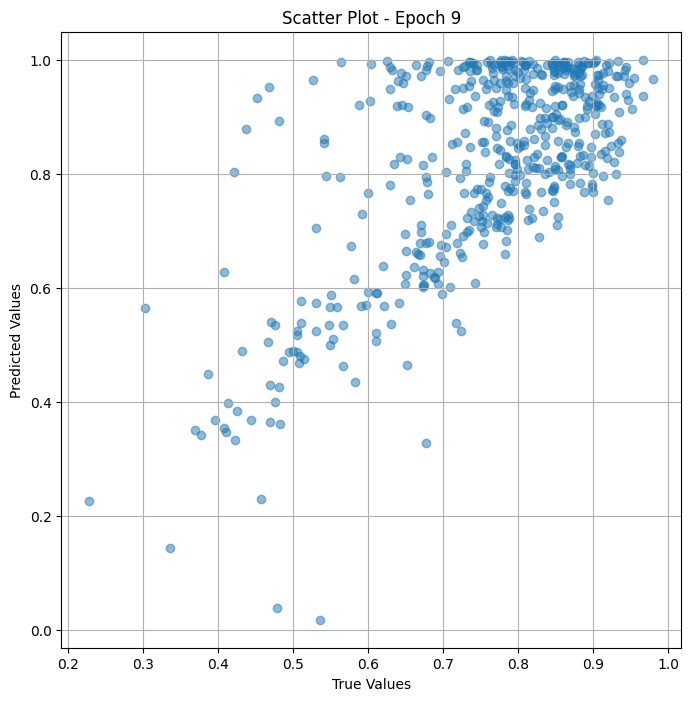


 Epoch: (10/50) Loss = 0.0004278364940546453

 Epoch: (10/50) Loss_rmse = 0.02068420872092247

 Epoch: (10/50) R^2 = 0.9874284267425537

 Epoch: (10/50) MAE = 0.01726604998111725

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

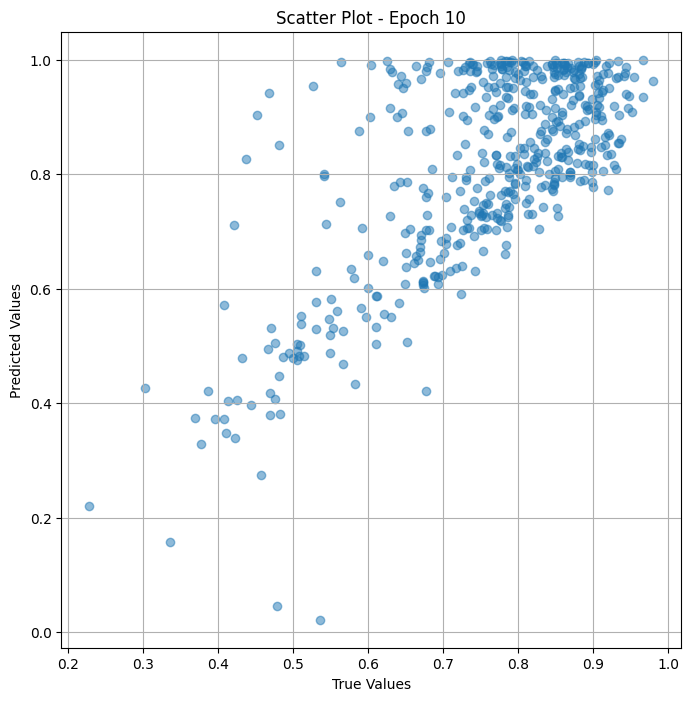


 Epoch: (11/50) Loss = 0.00010204905265709385

 Epoch: (11/50) Loss_rmse = 0.010101933032274246

 Epoch: (11/50) R^2 = 0.9970014095306396

 Epoch: (11/50) MAE = 0.009331956505775452

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670

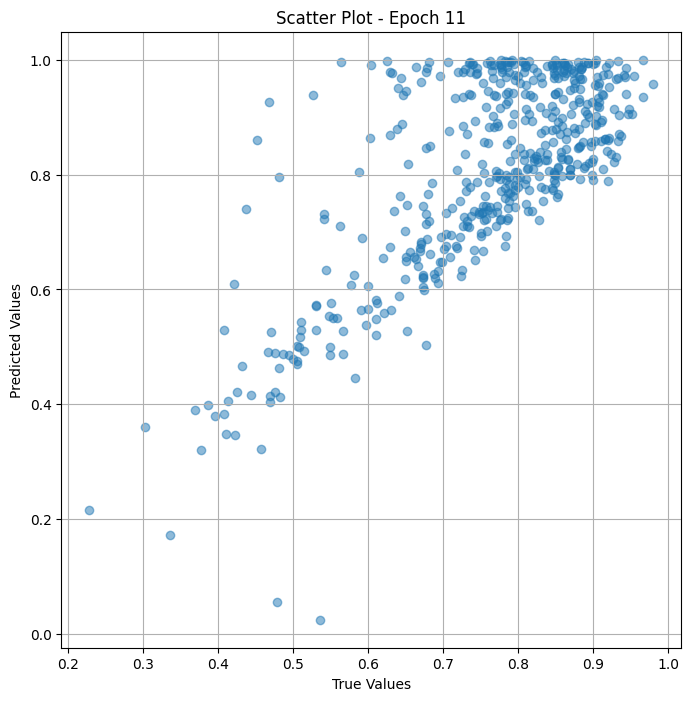


 Epoch: (12/50) Loss = 0.00029304256895557046

 Epoch: (12/50) Loss_rmse = 0.017118485644459724

 Epoch: (12/50) R^2 = 0.9913892149925232

 Epoch: (12/50) MAE = 0.013741649687290192

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670

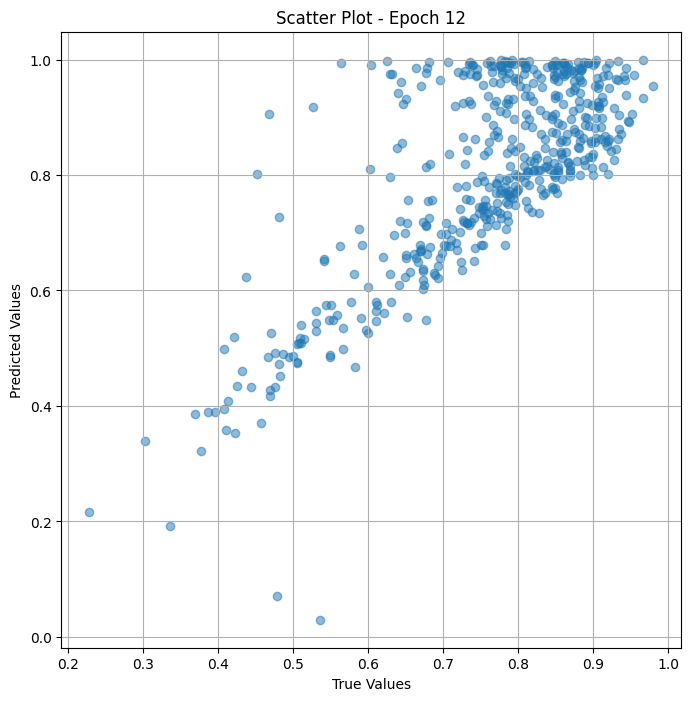


 Epoch: (13/50) Loss = 9.456130646867678e-05

 Epoch: (13/50) Loss_rmse = 0.009724264033138752

 Epoch: (13/50) R^2 = 0.9972214102745056

 Epoch: (13/50) MAE = 0.008604742586612701

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702

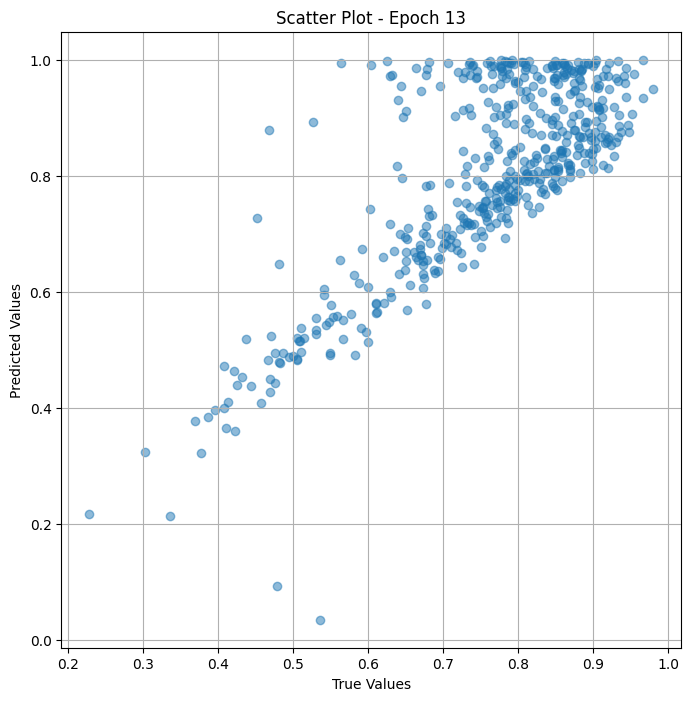


 Epoch: (14/50) Loss = 7.795639976393431e-05

 Epoch: (14/50) Loss_rmse = 0.00882929190993309

 Epoch: (14/50) R^2 = 0.997709333896637

 Epoch: (14/50) MAE = 0.006241321563720703

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

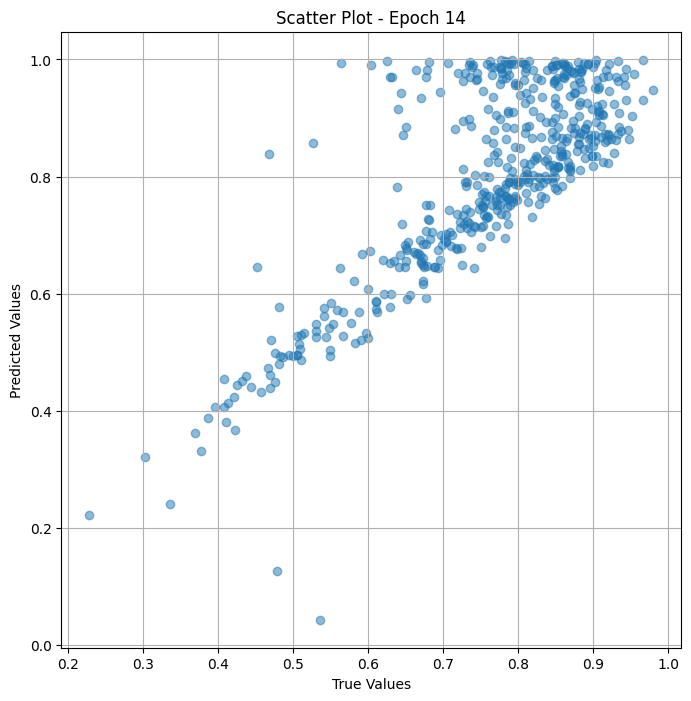


 Epoch: (15/50) Loss = 0.00012672904995270073

 Epoch: (15/50) Loss_rmse = 0.011257399804890156

 Epoch: (15/50) R^2 = 0.9962761998176575

 Epoch: (15/50) MAE = 0.007858999073505402

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670

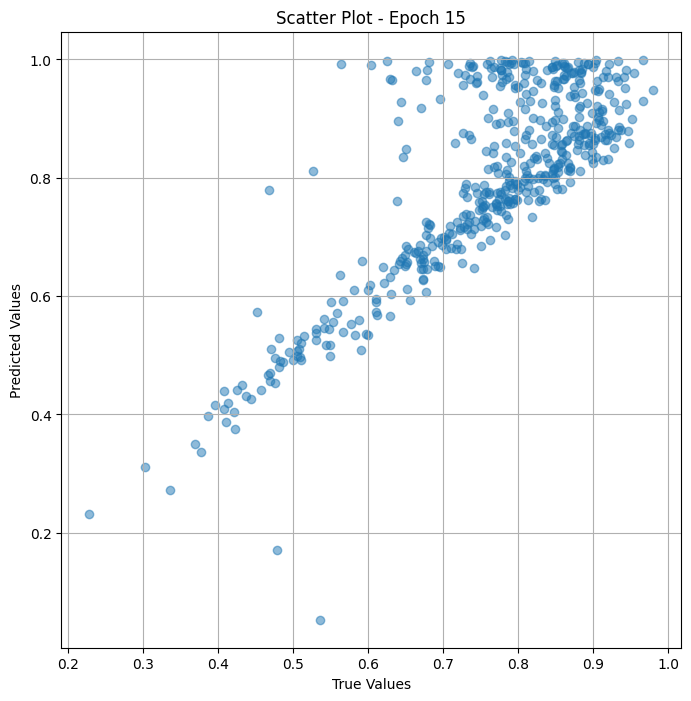


 Epoch: (16/50) Loss = 2.985401442856528e-05

 Epoch: (16/50) Loss_rmse = 0.005463882815092802

 Epoch: (16/50) R^2 = 0.9991227388381958

 Epoch: (16/50) MAE = 0.004559211432933807

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702

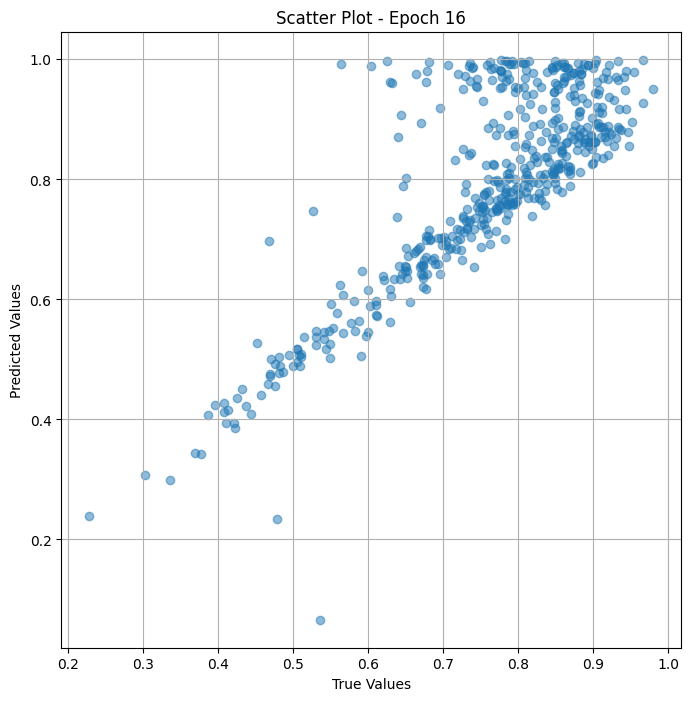


 Epoch: (17/50) Loss = 0.00016941881040111184

 Epoch: (17/50) Loss_rmse = 0.01301609817892313

 Epoch: (17/50) R^2 = 0.9950217604637146

 Epoch: (17/50) MAE = 0.010714046657085419

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702

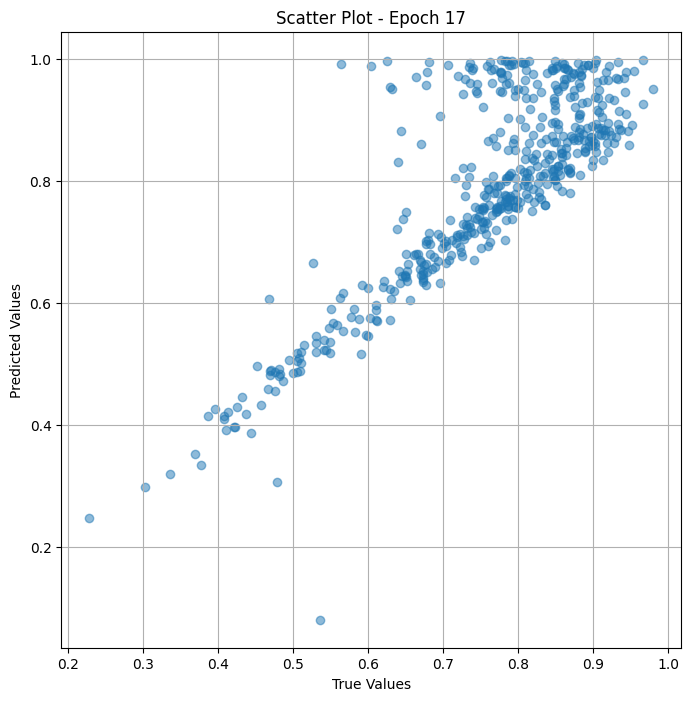


 Epoch: (18/50) Loss = 6.186864629853517e-05

 Epoch: (18/50) Loss_rmse = 0.007865662686526775

 Epoch: (18/50) R^2 = 0.9981820583343506

 Epoch: (18/50) MAE = 0.0058363378047943115

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670

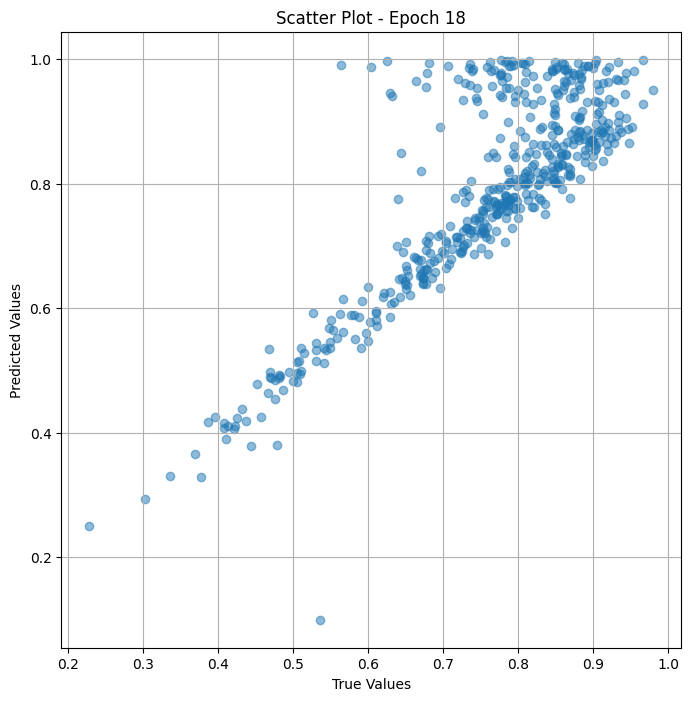


 Epoch: (19/50) Loss = 8.71965748956427e-05

 Epoch: (19/50) Loss_rmse = 0.009337910450994968

 Epoch: (19/50) R^2 = 0.9974378347396851

 Epoch: (19/50) MAE = 0.008314333856105804

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021

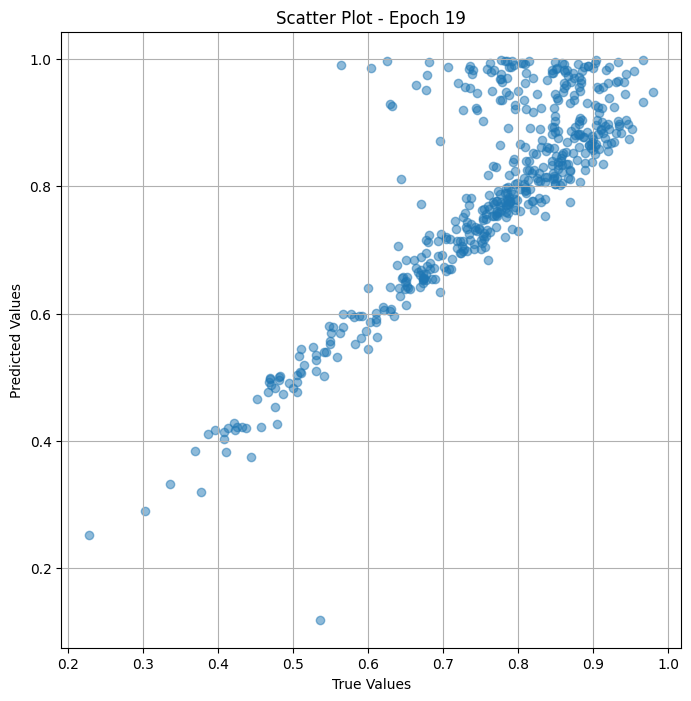


 Epoch: (20/50) Loss = 0.00015854484809096903

 Epoch: (20/50) Loss_rmse = 0.012591459788382053

 Epoch: (20/50) R^2 = 0.9953413009643555

 Epoch: (20/50) MAE = 0.011593654751777649

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670

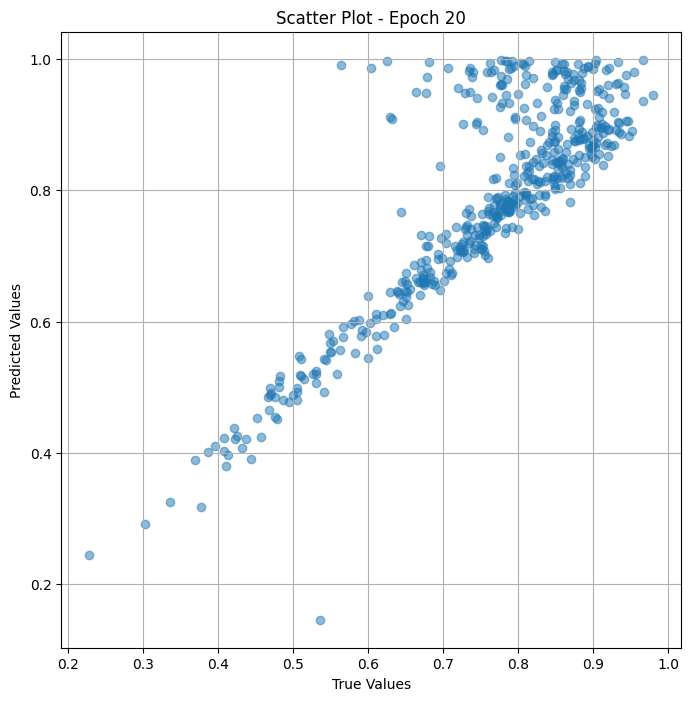


 Epoch: (21/50) Loss = 4.4462325604399666e-05

 Epoch: (21/50) Loss_rmse = 0.006668007466942072

 Epoch: (21/50) R^2 = 0.9986935257911682

 Epoch: (21/50) MAE = 0.0060991644859313965

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67

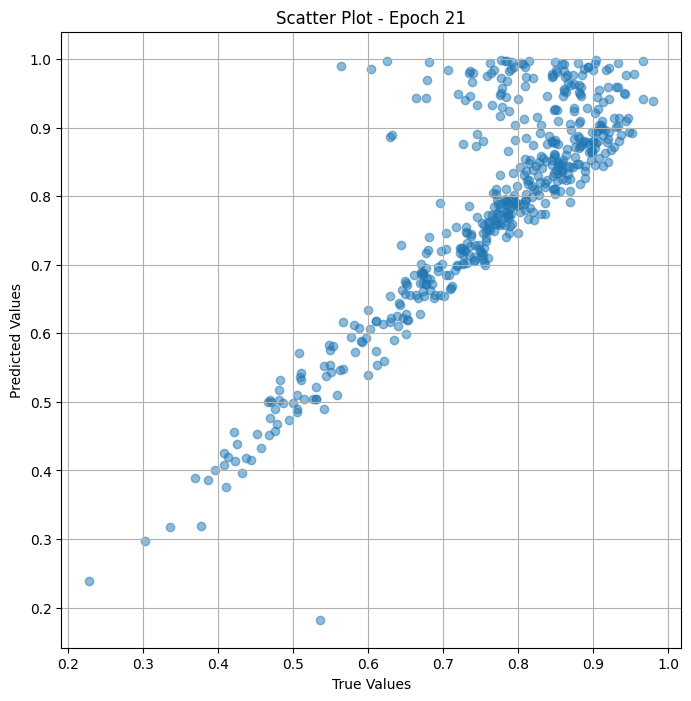


 Epoch: (22/50) Loss = 0.0007363560143858194

 Epoch: (22/50) Loss_rmse = 0.027135880663990974

 Epoch: (22/50) R^2 = 0.9783628582954407

 Epoch: (22/50) MAE = 0.023676961660385132

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702

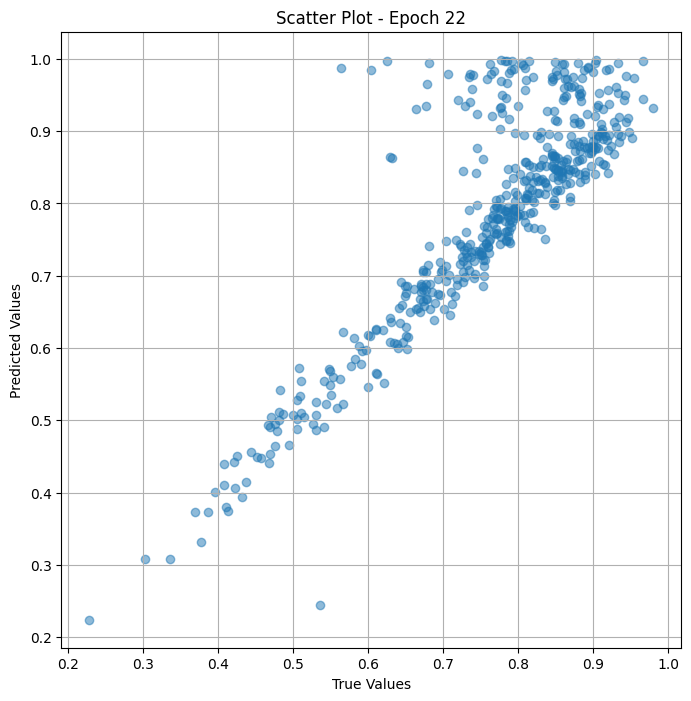


 Epoch: (23/50) Loss = 0.000389834021916613

 Epoch: (23/50) Loss_rmse = 0.01974421553313732

 Epoch: (23/50) R^2 = 0.9885451197624207

 Epoch: (23/50) MAE = 0.018450826406478882

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

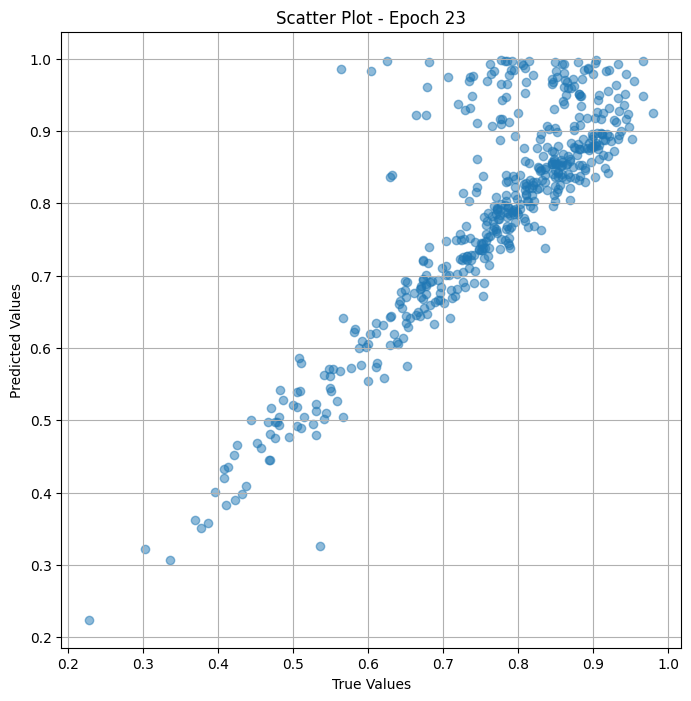


 Epoch: (24/50) Loss = 0.002845233306288719

 Epoch: (24/50) Loss_rmse = 0.05334072932600975

 Epoch: (24/50) R^2 = 0.9163955450057983

 Epoch: (24/50) MAE = 0.04417795687913895

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

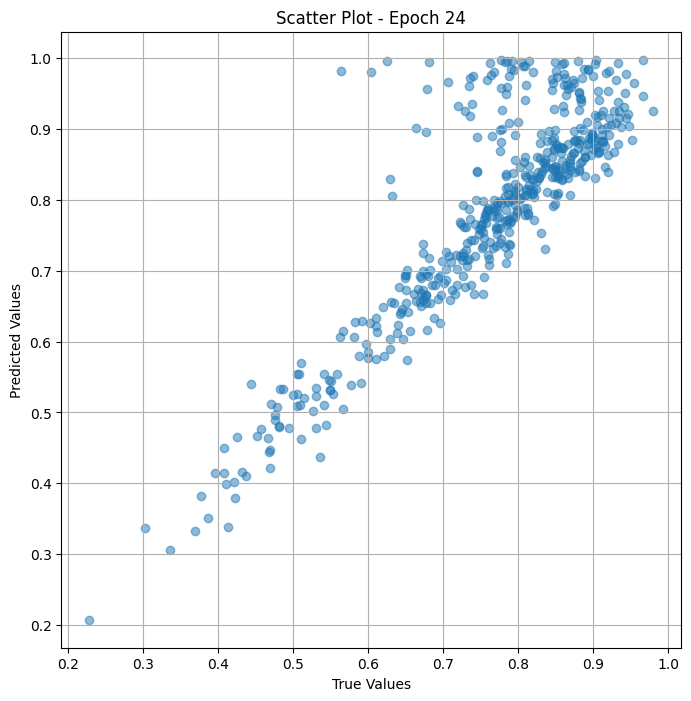


 Epoch: (25/50) Loss = 0.004176225513219833

 Epoch: (25/50) Loss_rmse = 0.06462372094392776

 Epoch: (25/50) R^2 = 0.8772855997085571

 Epoch: (25/50) MAE = 0.049707405269145966

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

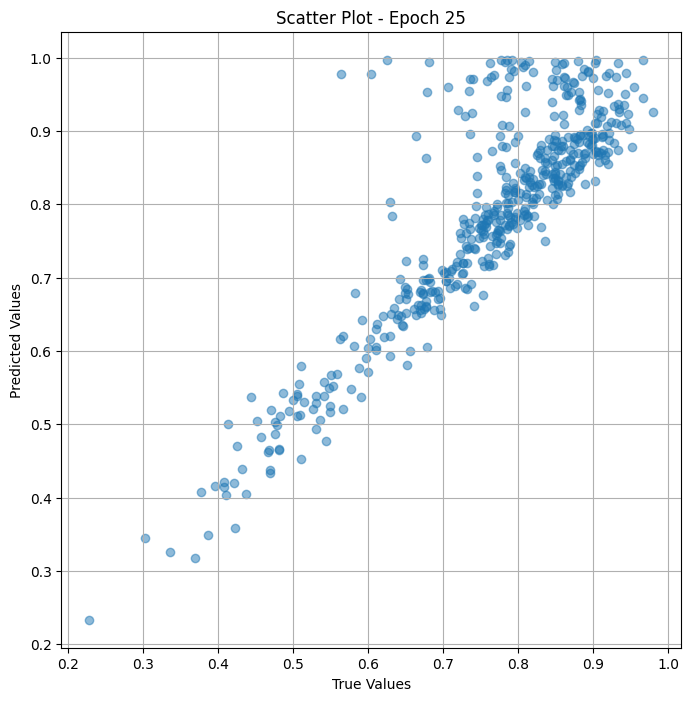


 Epoch: (26/50) Loss = 0.007386562880128622

 Epoch: (26/50) Loss_rmse = 0.08594511449337006

 Epoch: (26/50) R^2 = 0.7829529047012329

 Epoch: (26/50) MAE = 0.06321456283330917

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

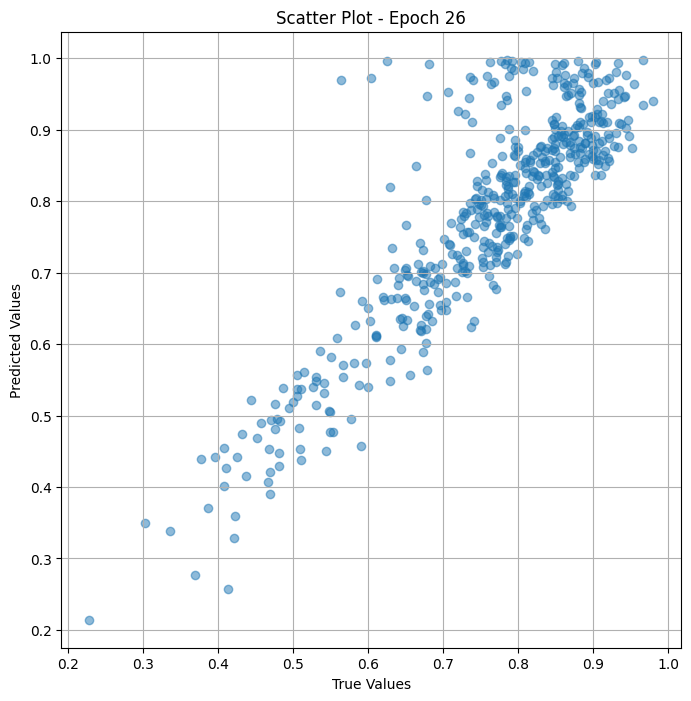


 Epoch: (27/50) Loss = 0.012153410352766514

 Epoch: (27/50) Loss_rmse = 0.11024250835180283

 Epoch: (27/50) R^2 = 0.6428836584091187

 Epoch: (27/50) MAE = 0.08450888842344284

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

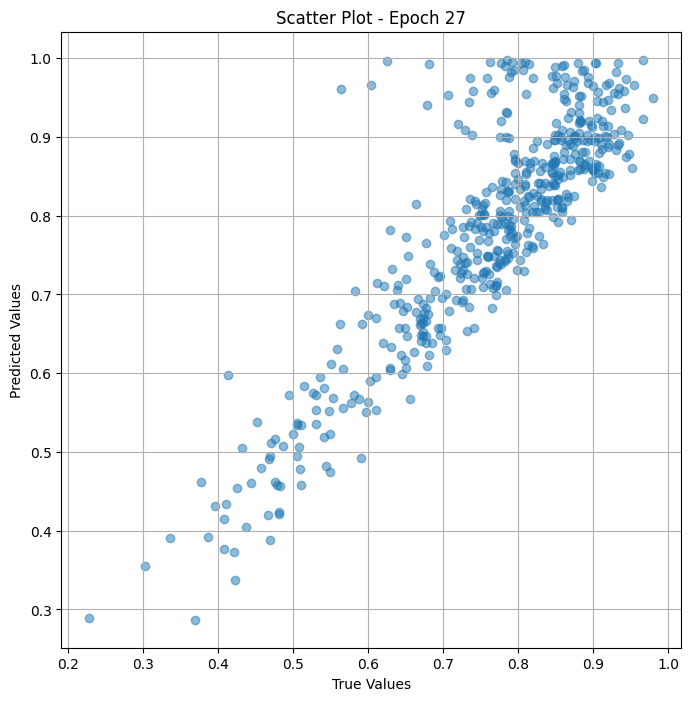


 Epoch: (28/50) Loss = 0.012035885825753212

 Epoch: (28/50) Loss_rmse = 0.10970818251371384

 Epoch: (28/50) R^2 = 0.6463369727134705

 Epoch: (28/50) MAE = 0.07232674211263657

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

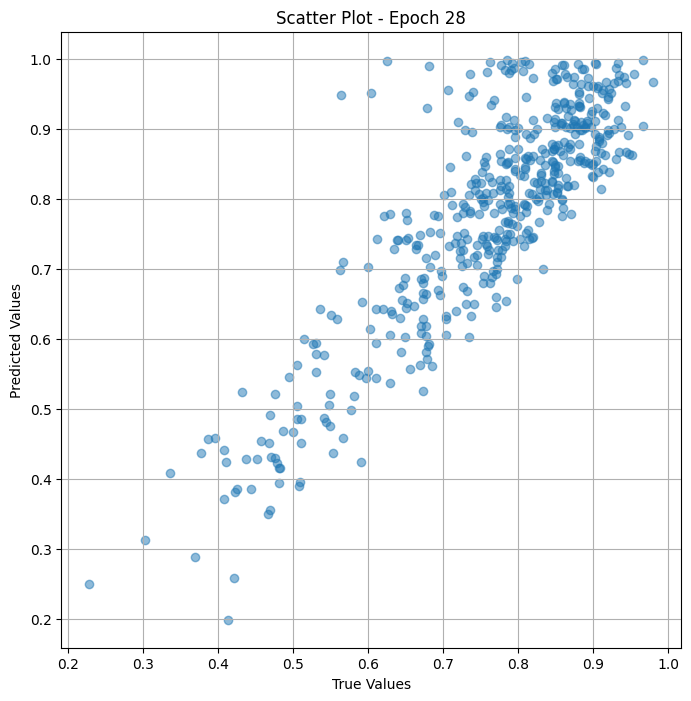


 Epoch: (29/50) Loss = 0.010362228378653526

 Epoch: (29/50) Loss_rmse = 0.10179503262042999

 Epoch: (29/50) R^2 = 0.6955158114433289

 Epoch: (29/50) MAE = 0.0880424752831459

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

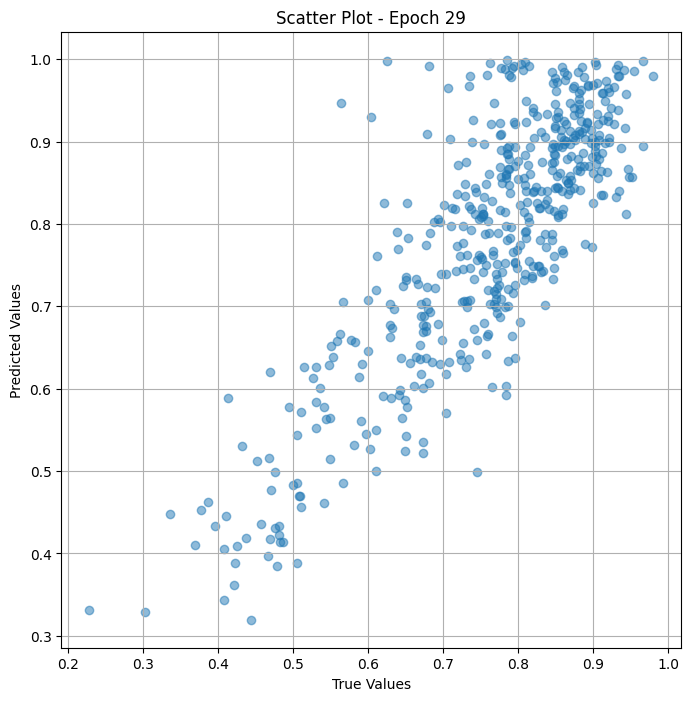


 Epoch: (30/50) Loss = 0.006734863854944706

 Epoch: (30/50) Loss_rmse = 0.08206621557474136

 Epoch: (30/50) R^2 = 0.8021024465560913

 Epoch: (30/50) MAE = 0.07357043772935867

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

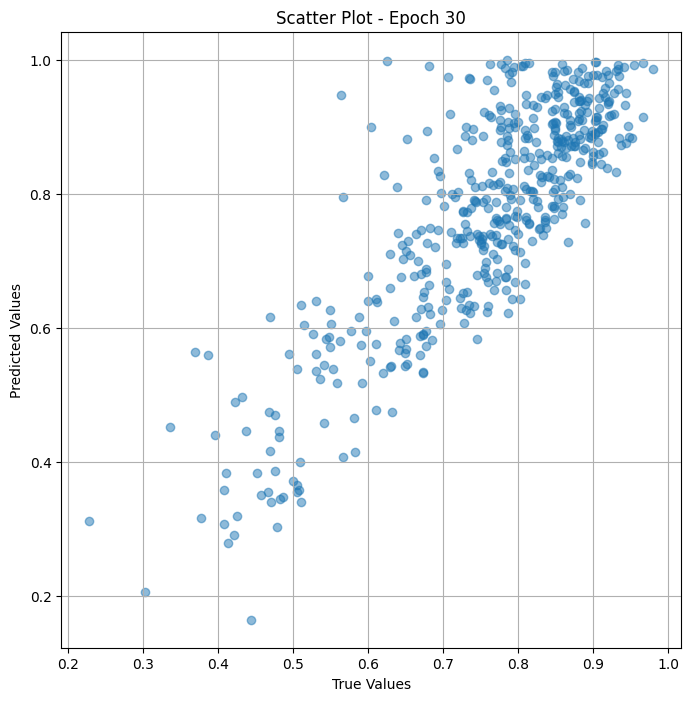


 Epoch: (31/50) Loss = 0.012417689897119999

 Epoch: (31/50) Loss_rmse = 0.1114346906542778

 Epoch: (31/50) R^2 = 0.6351180076599121

 Epoch: (31/50) MAE = 0.08279211074113846

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

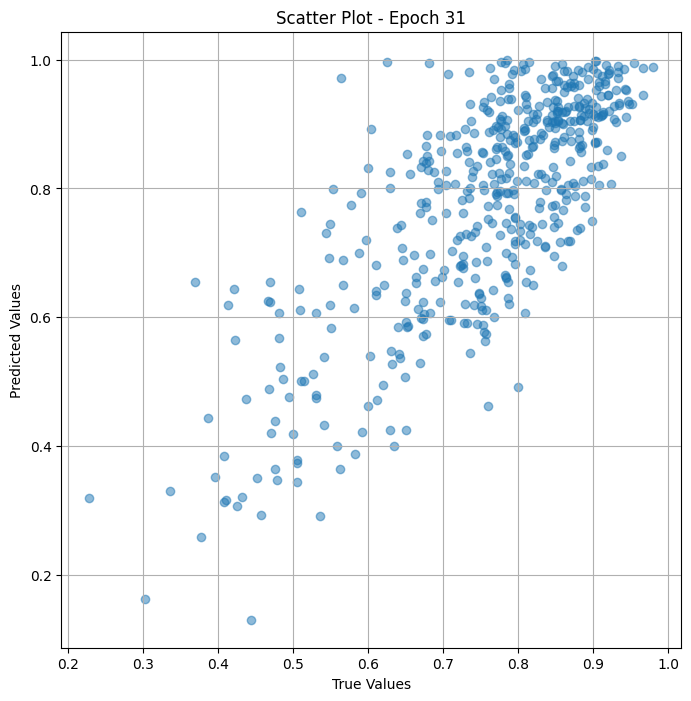


 Epoch: (32/50) Loss = 0.024476978927850723

 Epoch: (32/50) Loss_rmse = 0.15645121037960052

 Epoch: (32/50) R^2 = 0.2807673215866089

 Epoch: (32/50) MAE = 0.12588483095169067

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

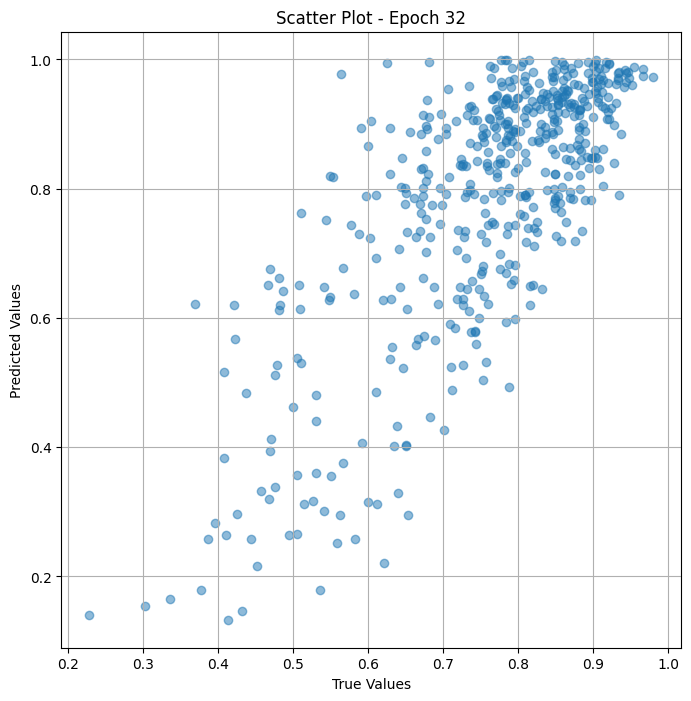


 Epoch: (33/50) Loss = 0.020709596574306488

 Epoch: (33/50) Loss_rmse = 0.14390829205513

 Epoch: (33/50) R^2 = 0.3914682865142822

 Epoch: (33/50) MAE = 0.12572555243968964

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 

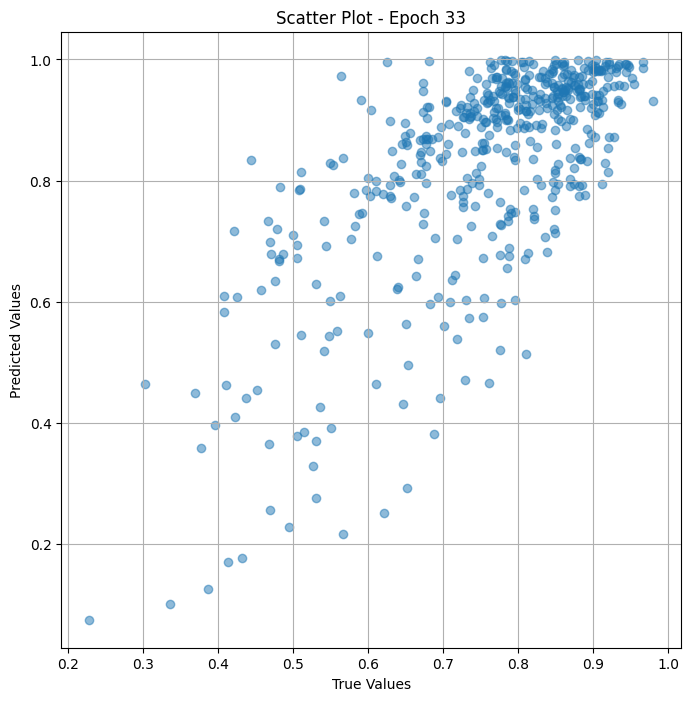


 Epoch: (34/50) Loss = 0.0058822594583034515

 Epoch: (34/50) Loss_rmse = 0.07669588923454285

 Epoch: (34/50) R^2 = 0.8271554112434387

 Epoch: (34/50) MAE = 0.060110658407211304

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021

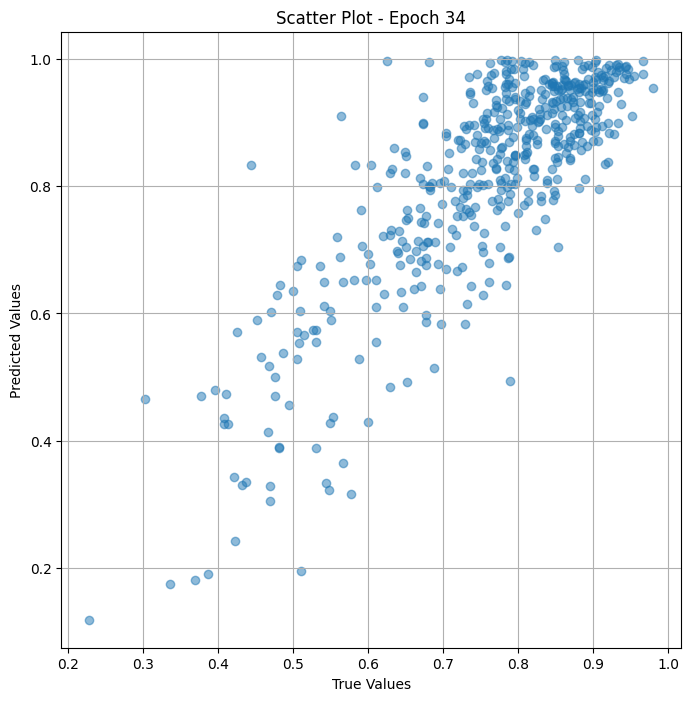


 Epoch: (35/50) Loss = 0.009065832011401653

 Epoch: (35/50) Loss_rmse = 0.09521466493606567

 Epoch: (35/50) R^2 = 0.7336091995239258

 Epoch: (35/50) MAE = 0.0706075131893158

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

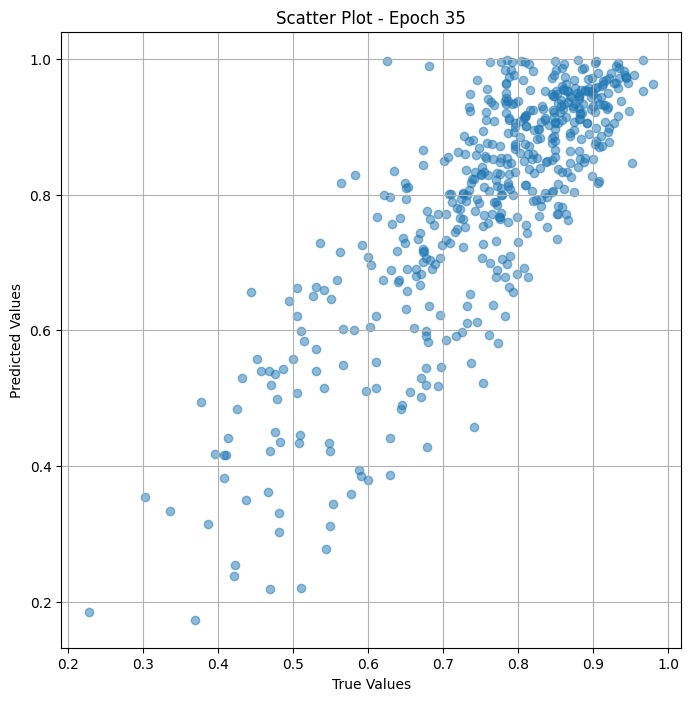


 Epoch: (36/50) Loss = 0.009470535442233086

 Epoch: (36/50) Loss_rmse = 0.097316674888134

 Epoch: (36/50) R^2 = 0.721717357635498

 Epoch: (36/50) MAE = 0.087670236825943

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275, 0.

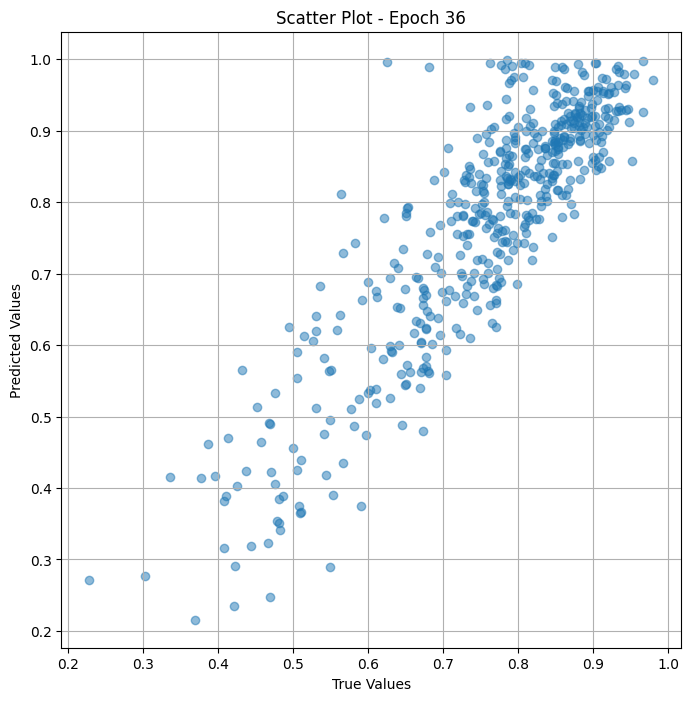


 Epoch: (37/50) Loss = 0.006332925520837307

 Epoch: (37/50) Loss_rmse = 0.0795796811580658

 Epoch: (37/50) R^2 = 0.8139129877090454

 Epoch: (37/50) MAE = 0.05886298418045044

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

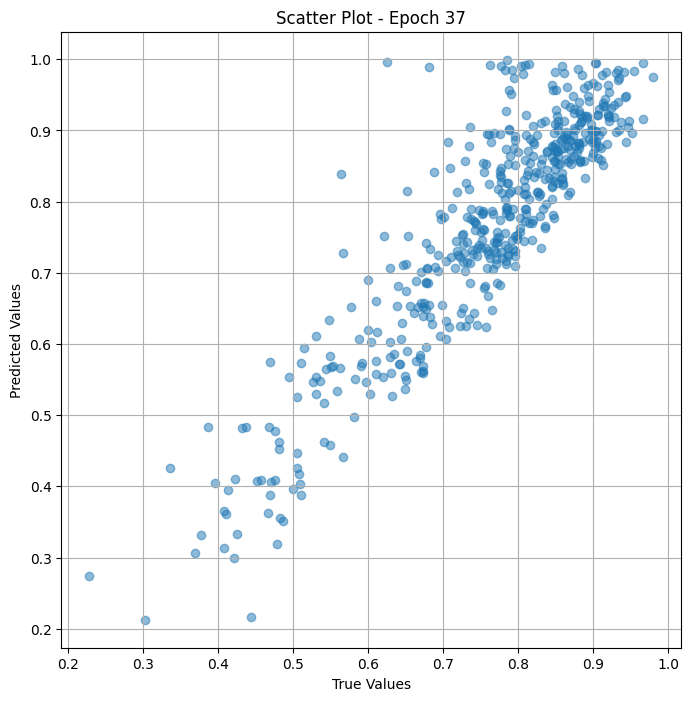


 Epoch: (38/50) Loss = 0.005157265812158585

 Epoch: (38/50) Loss_rmse = 0.07181410491466522

 Epoch: (38/50) R^2 = 0.8484586477279663

 Epoch: (38/50) MAE = 0.06736278533935547

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

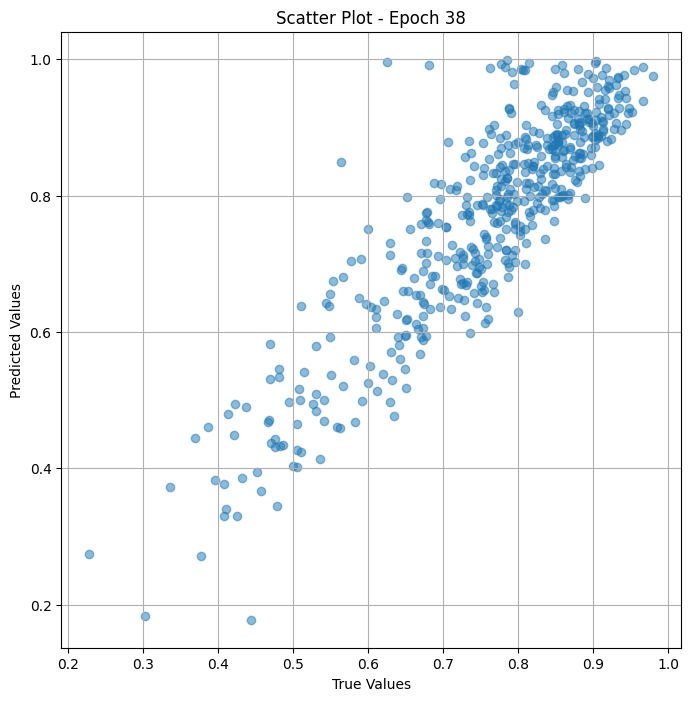


 Epoch: (39/50) Loss = 0.0029390936251729727

 Epoch: (39/50) Loss_rmse = 0.05421340838074684

 Epoch: (39/50) R^2 = 0.9136375188827515

 Epoch: (39/50) MAE = 0.038238391280174255

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021

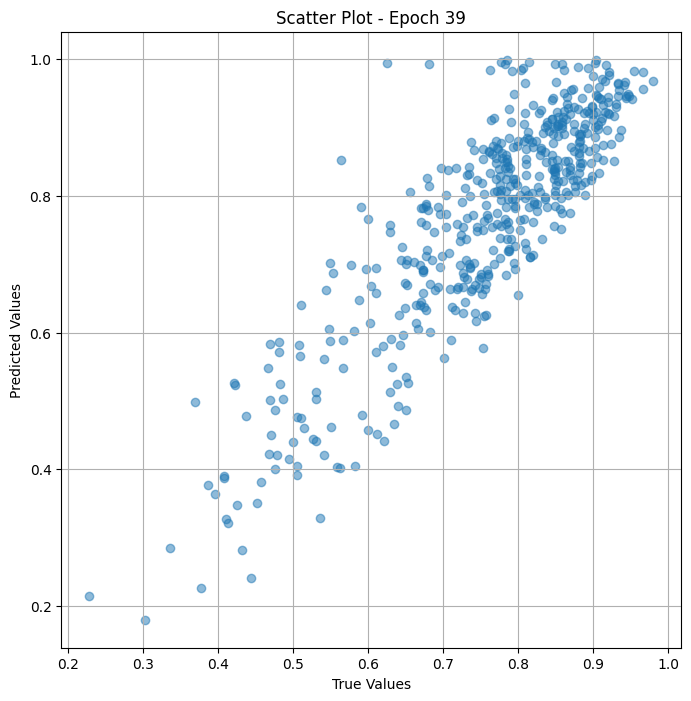


 Epoch: (40/50) Loss = 0.0021370751783251762

 Epoch: (40/50) Loss_rmse = 0.04622850939631462

 Epoch: (40/50) R^2 = 0.9372040629386902

 Epoch: (40/50) MAE = 0.039062827825546265

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021

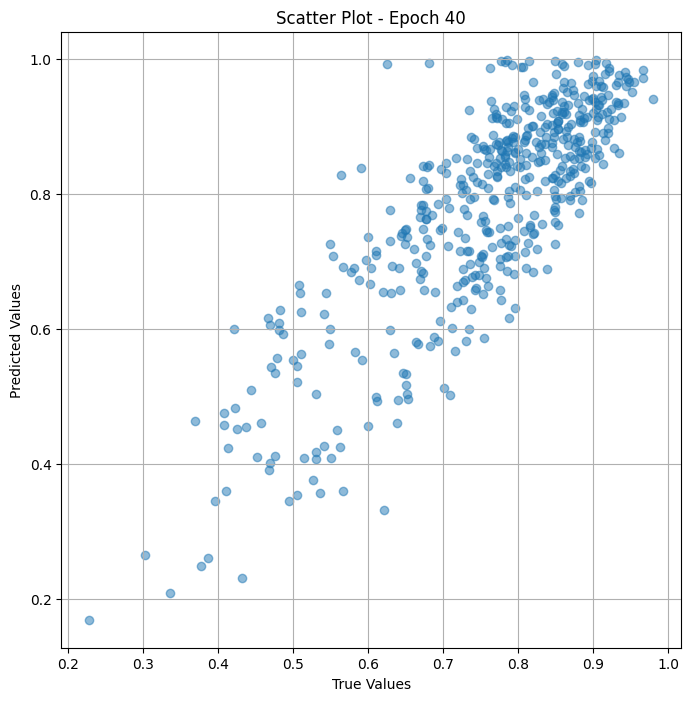


 Epoch: (41/50) Loss = 0.00818920973688364

 Epoch: (41/50) Loss_rmse = 0.09049425274133682

 Epoch: (41/50) R^2 = 0.7593678832054138

 Epoch: (41/50) MAE = 0.07288484275341034

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

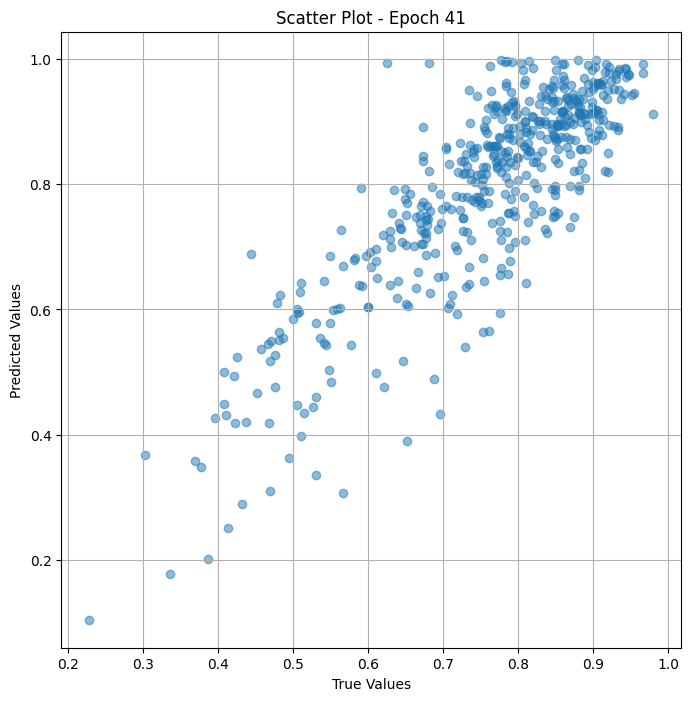


 Epoch: (42/50) Loss = 0.00356605788692832

 Epoch: (42/50) Loss_rmse = 0.05971647799015045

 Epoch: (42/50) R^2 = 0.8952147960662842

 Epoch: (42/50) MAE = 0.049731142818927765

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

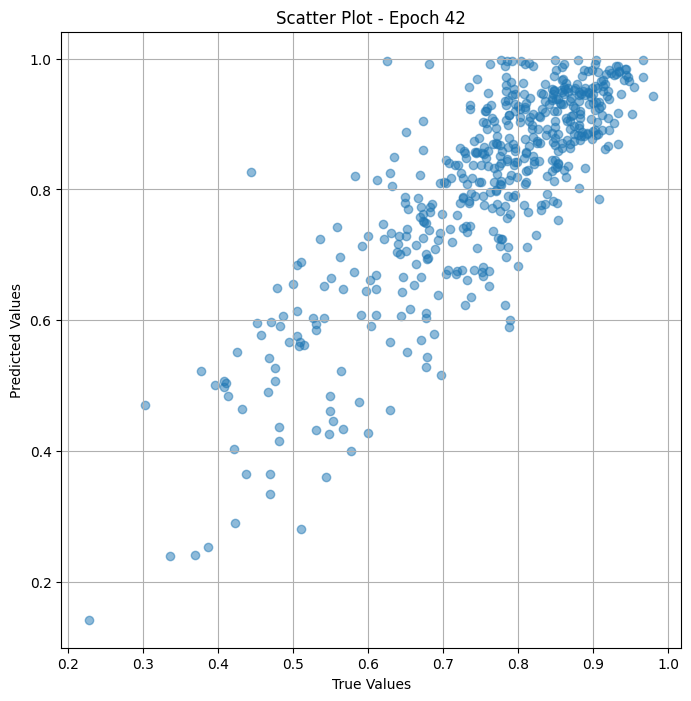


 Epoch: (43/50) Loss = 0.007431679405272007

 Epoch: (43/50) Loss_rmse = 0.08620718866586685

 Epoch: (43/50) R^2 = 0.7816271781921387

 Epoch: (43/50) MAE = 0.06829992681741714

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

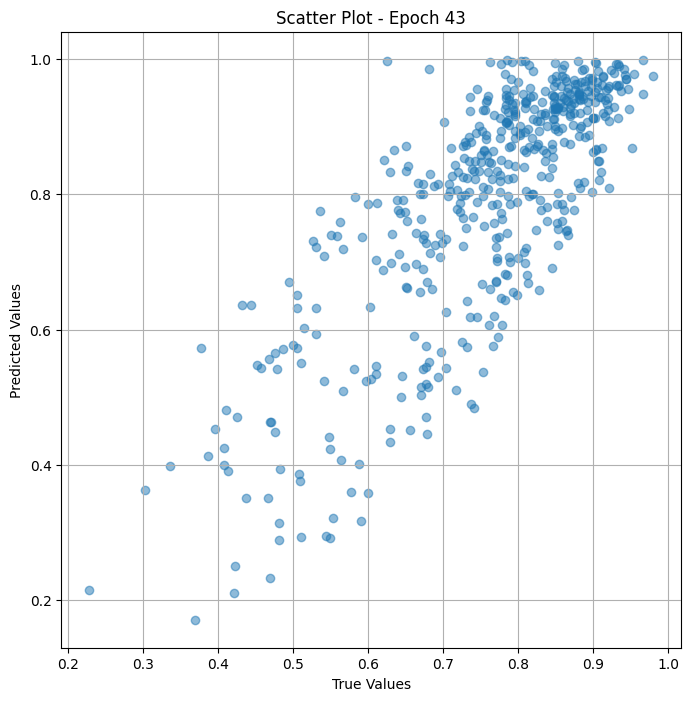


 Epoch: (44/50) Loss = 0.012987815774977207

 Epoch: (44/50) Loss_rmse = 0.11396409571170807

 Epoch: (44/50) R^2 = 0.6183654069900513

 Epoch: (44/50) MAE = 0.10261469334363937

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

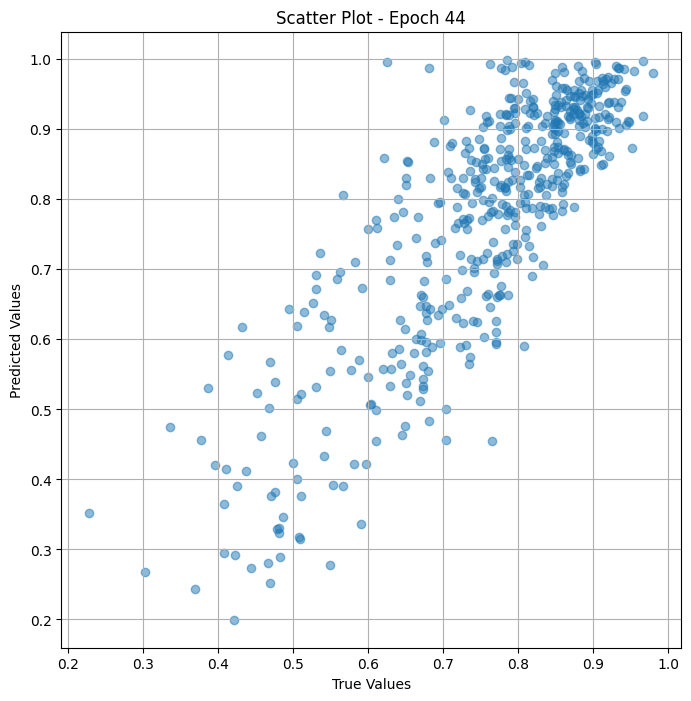


 Epoch: (45/50) Loss = 0.010007445700466633

 Epoch: (45/50) Loss_rmse = 0.10003722459077835

 Epoch: (45/50) R^2 = 0.7059407234191895

 Epoch: (45/50) MAE = 0.08359694480895996

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

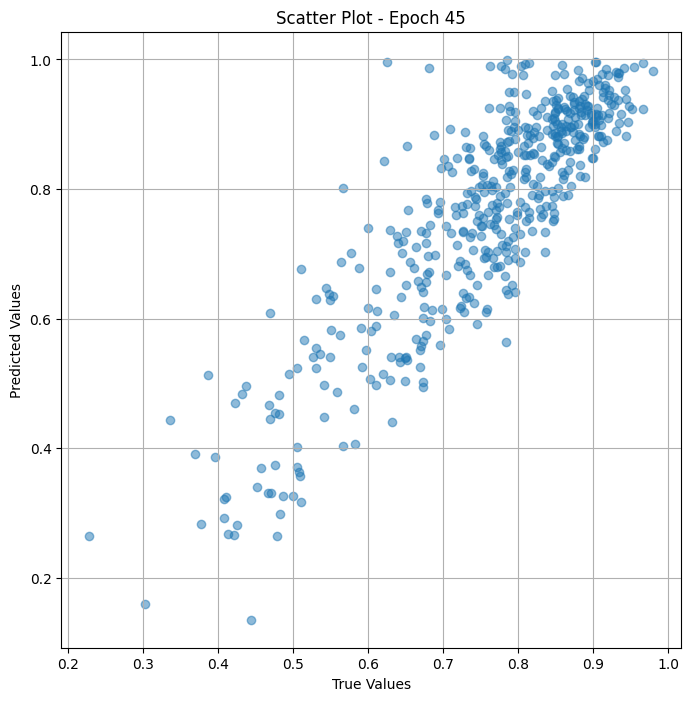


 Epoch: (46/50) Loss = 0.0063109188340604305

 Epoch: (46/50) Loss_rmse = 0.07944129407405853

 Epoch: (46/50) R^2 = 0.8145596981048584

 Epoch: (46/50) MAE = 0.0667799785733223

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

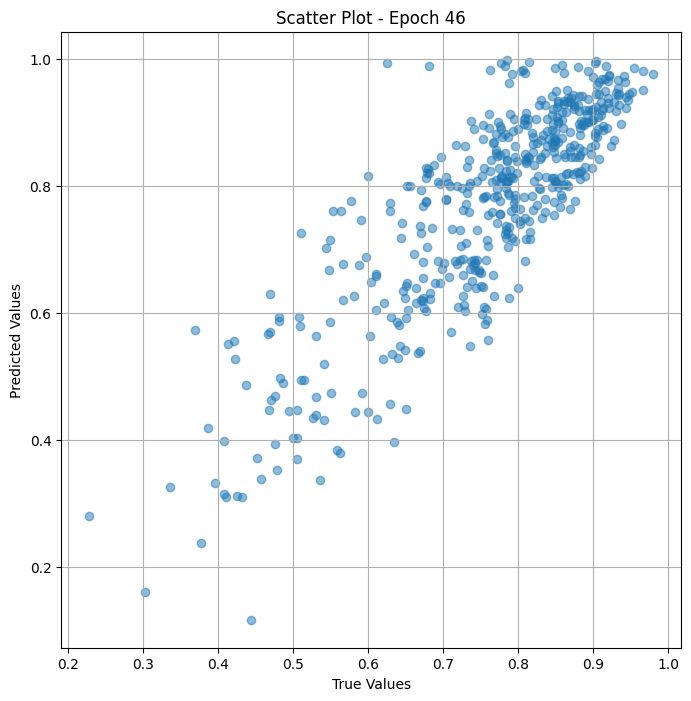


 Epoch: (47/50) Loss = 0.015210502780973911

 Epoch: (47/50) Loss_rmse = 0.12333086878061295

 Epoch: (47/50) R^2 = 0.5530538558959961

 Epoch: (47/50) MAE = 0.10322743654251099

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

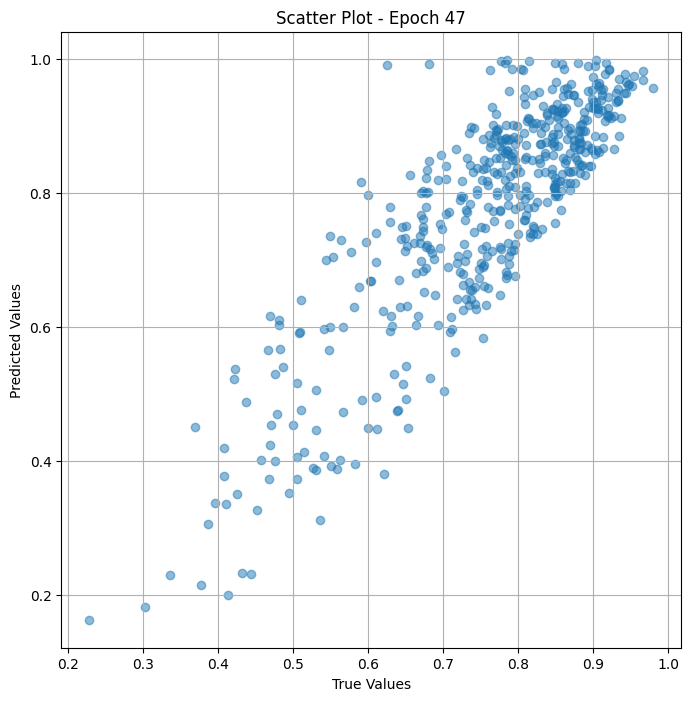


 Epoch: (48/50) Loss = 0.002752005122601986

 Epoch: (48/50) Loss_rmse = 0.052459556609392166

 Epoch: (48/50) R^2 = 0.9191349744796753

 Epoch: (48/50) MAE = 0.04761454463005066

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.670212

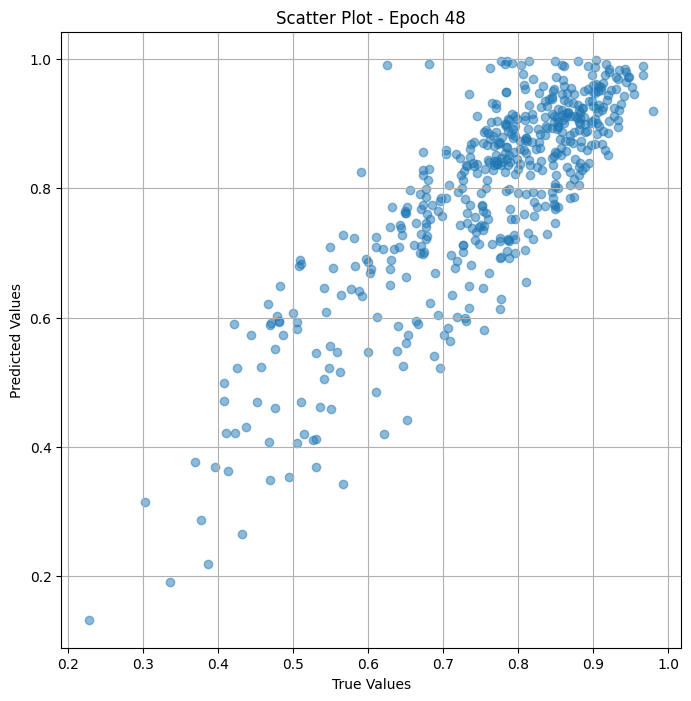


 Epoch: (49/50) Loss = 0.004478074610233307

 Epoch: (49/50) Loss_rmse = 0.06691841781139374

 Epoch: (49/50) R^2 = 0.8684160709381104

 Epoch: (49/50) MAE = 0.05610603839159012

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.6702127

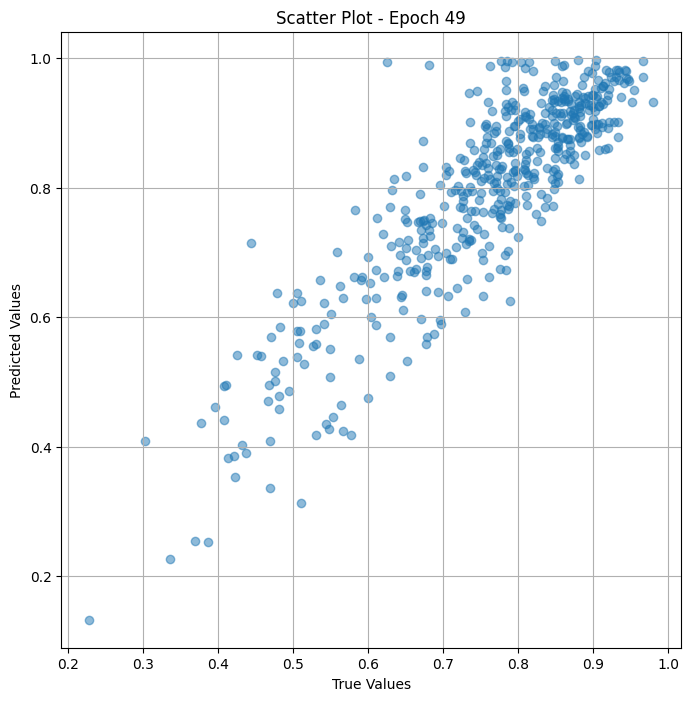


 Epoch: (50/50) Loss = 0.009539347141981125

 Epoch: (50/50) Loss_rmse = 0.0976695790886879

 Epoch: (50/50) R^2 = 0.7196953892707825

 Epoch: (50/50) MAE = 0.08454331755638123

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83809525, 0.8, 0.90434784, 0.90816325, 0.9174312, 0.4368932, 0.6972477, 0.8606557, 0.42307693, 0.75247526, 0.7878788, 0.83035713, 0.51086956, 0.78899086, 0.872549, 0.85294116, 0.814433, 0.90816325, 0.7818182, 0.8636364, 0.80851066, 0.7777778, 0.9, 0.62886596, 0.67676765, 0.87096775, 0.85227275, 0.8235294, 0.54761904, 0.3690476, 0.8080808, 0.8118812, 0.85294116, 0.86538464, 0.54444444, 0.88235295, 0.8521739, 0.8981481, 0.5877193, 0.85263157, 0.7614679, 0.56435645, 0.5777778, 0.91588783, 0.65625, 0.8061224, 0.5494506, 0.8584906, 0.9117647, 0.8448276, 0.8137255, 0.8111111, 0.67676765, 0.8586956, 0.8272727, 0.92156863, 0.78571427, 0.8791209, 0.59, 0.67045456, 0.7676768, 0.7659575, 0.6, 0.91, 0.86585367, 0.88785046, 0.67021275

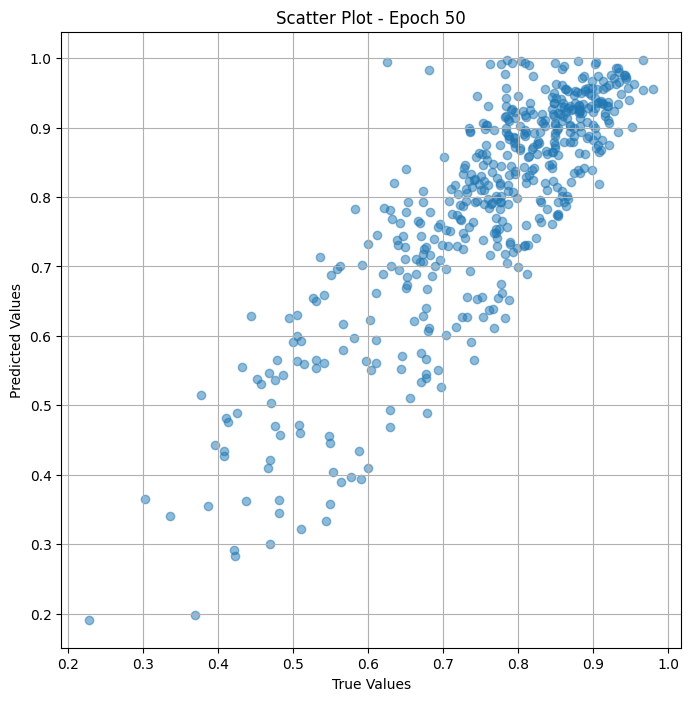

In [ ]:
# Training the model and save weights
fit(50, modelfine_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_valr_fine")

## Test

In [ ]:
# Merge the two models
class model_merge_fine_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_fine_test = model_merge_fine_test(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_fine_test = to_device(model_fine_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_fine_test.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

# Fit function doing grad steps
def fit(epochs, model_fine_test, train_dl_test):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()

    for epoch in range(epochs):
        model_fine_test.eval()
        batch_num = 16
        true_values_list = []
        predicted_values_list = []
        for x_trans, x_res, yb in train_dl_test:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_fine_test(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())

            loss.backward()
            opt.step()
            opt.zero_grad()

            total_loss += loss.item()
            total_loss_rmse += loss_rmse.item()
            total_r2 += r2.item()
            total_mae += mae.item()
            #total_spearman += spearman_corr

            # Increment batch number
            #print('\r', f'batch #{batch_num}: {loss}', end='')
            batch_num += 5

        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        #print('\n', f'Epoch: ({epoch+1}/{epochs}) Spearman = {mean_spearman}')
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        # Plot scatter plot after each epoch
        plot_scatter(true_values_list, predicted_values_list, epoch)


 Epoch: (1/50) Loss = 0.03206503018736839

 Epoch: (1/50) Loss_rmse = 0.17906710505485535

 Epoch: (1/50) R^2 = -11.917073249816895

 Epoch: (1/50) MAE = 0.17010213434696198

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

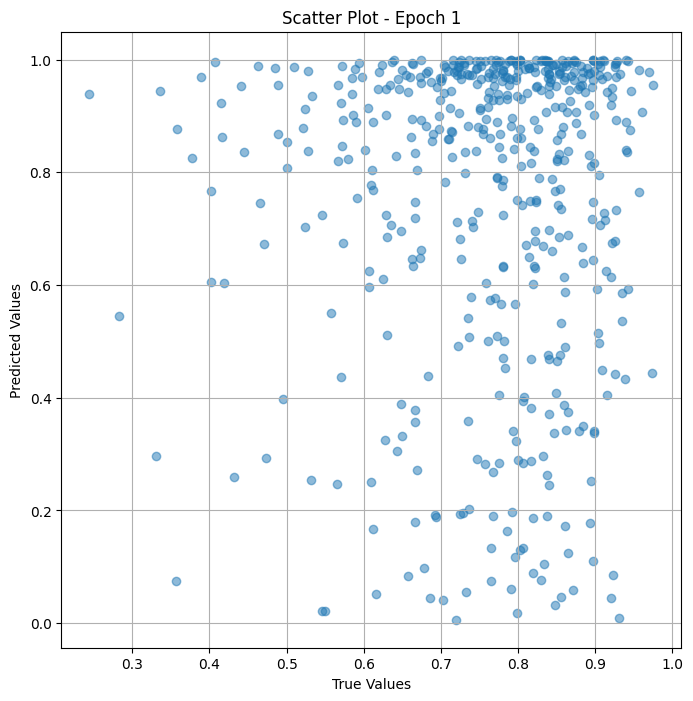


 Epoch: (2/50) Loss = 0.0328918993473053

 Epoch: (2/50) Loss_rmse = 0.18136124312877655

 Epoch: (2/50) R^2 = -12.250168800354004

 Epoch: (2/50) MAE = 0.17200200259685516

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575,

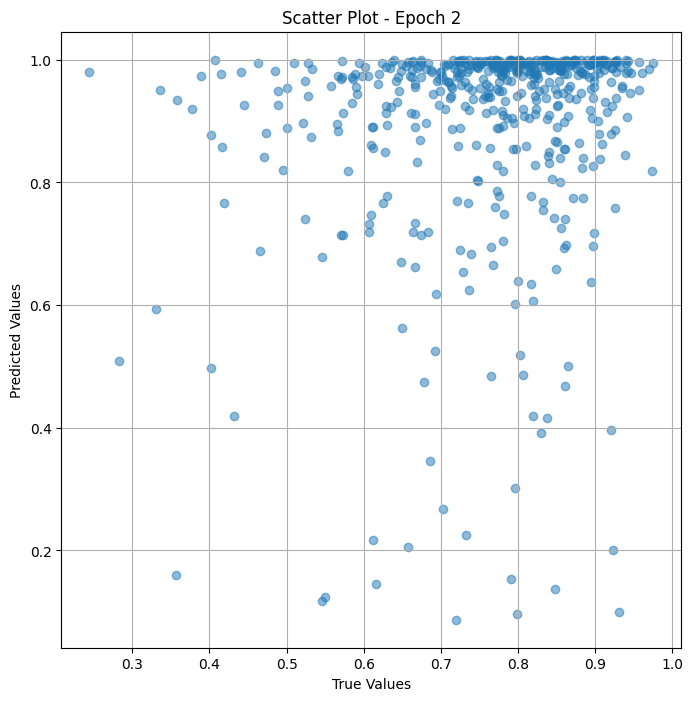


 Epoch: (3/50) Loss = 0.030240733176469803

 Epoch: (3/50) Loss_rmse = 0.1738986223936081

 Epoch: (3/50) R^2 = -11.182173728942871

 Epoch: (3/50) MAE = 0.15571177005767822

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

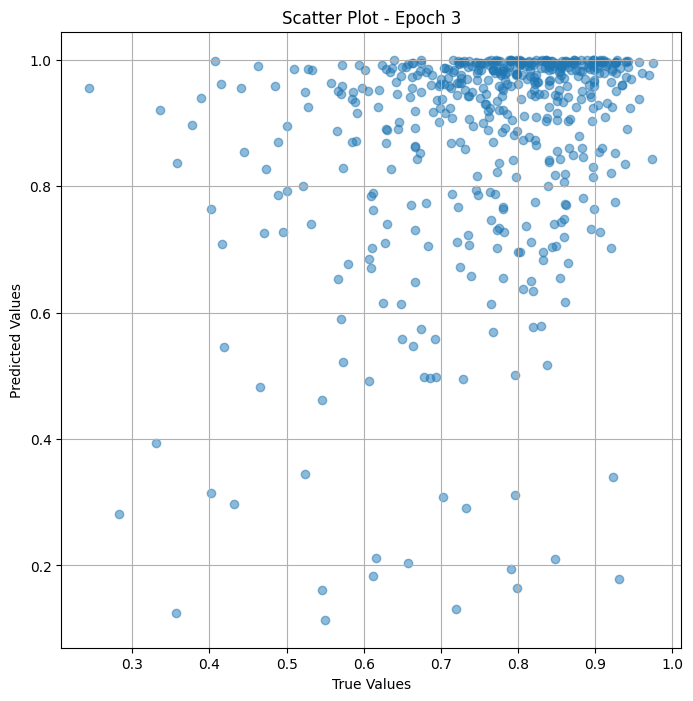


 Epoch: (4/50) Loss = 0.029809515923261642

 Epoch: (4/50) Loss_rmse = 0.17265433073043823

 Epoch: (4/50) R^2 = -11.008461952209473

 Epoch: (4/50) MAE = 0.14487504959106445

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575757

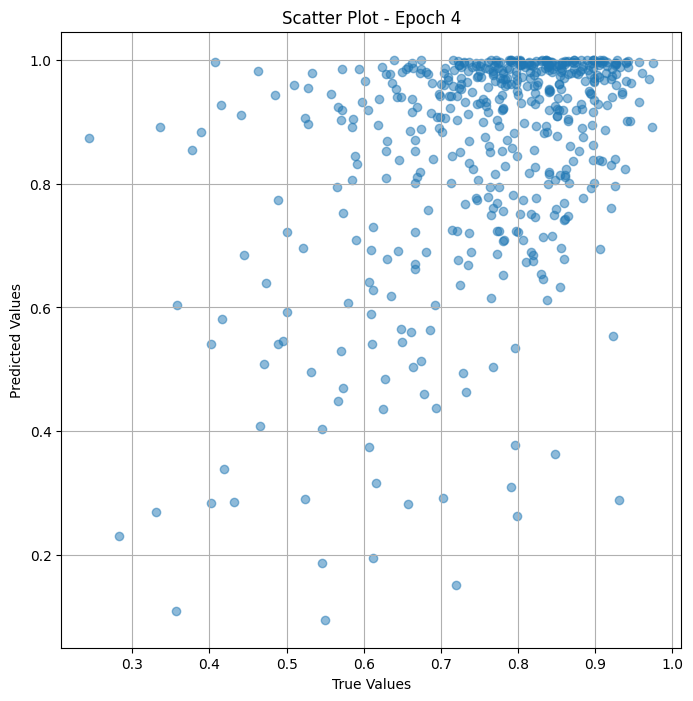


 Epoch: (5/50) Loss = 0.030092718079686165

 Epoch: (5/50) Loss_rmse = 0.17347252368927002

 Epoch: (5/50) R^2 = -11.122547149658203

 Epoch: (5/50) MAE = 0.15293818712234497

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575757

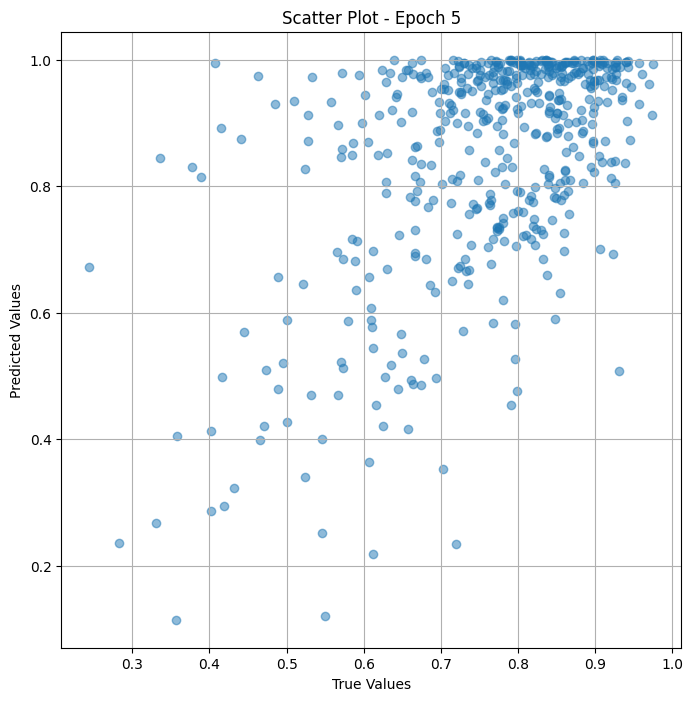


 Epoch: (6/50) Loss = 0.02974412776529789

 Epoch: (6/50) Loss_rmse = 0.17246486246585846

 Epoch: (6/50) R^2 = -10.982121467590332

 Epoch: (6/50) MAE = 0.15060079097747803

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

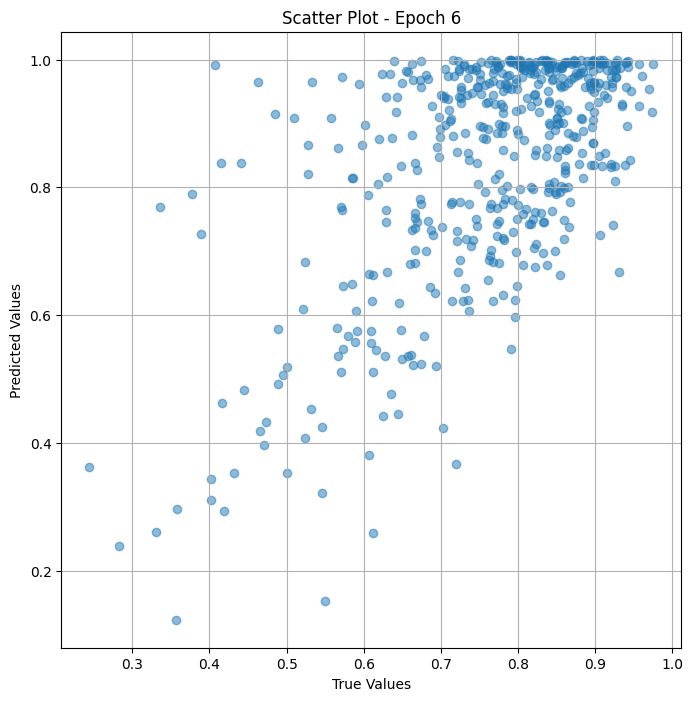


 Epoch: (7/50) Loss = 0.029455222189426422

 Epoch: (7/50) Loss_rmse = 0.17162524163722992

 Epoch: (7/50) R^2 = -10.865738868713379

 Epoch: (7/50) MAE = 0.15042316913604736

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575757

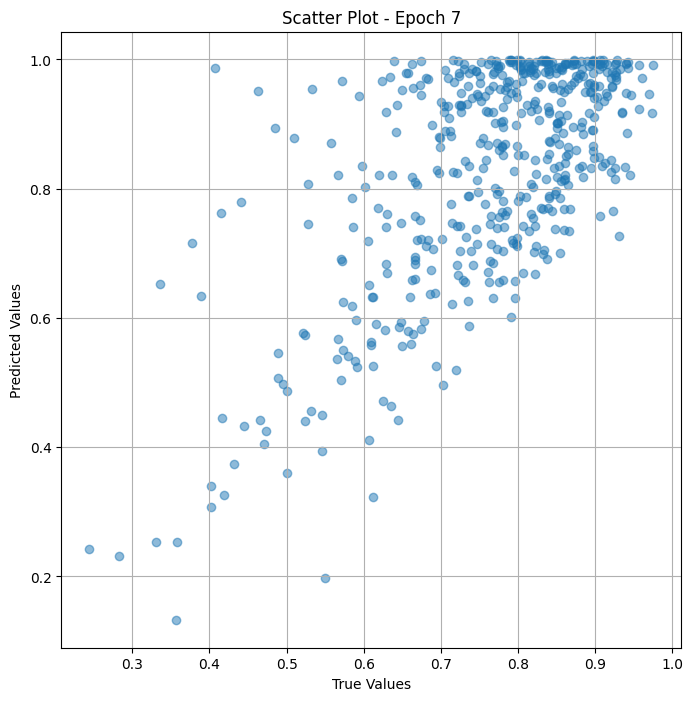


 Epoch: (8/50) Loss = 0.028957875445485115

 Epoch: (8/50) Loss_rmse = 0.1701701432466507

 Epoch: (8/50) R^2 = -10.665387153625488

 Epoch: (8/50) MAE = 0.14817379415035248

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

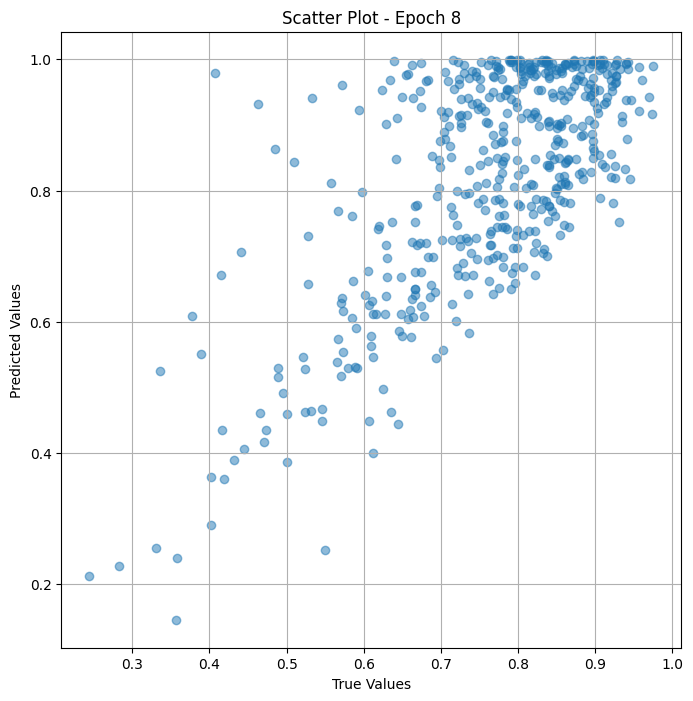


 Epoch: (9/50) Loss = 0.028338361531496048

 Epoch: (9/50) Loss_rmse = 0.16834001243114471

 Epoch: (9/50) R^2 = -10.41582202911377

 Epoch: (9/50) MAE = 0.14490363001823425

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757575

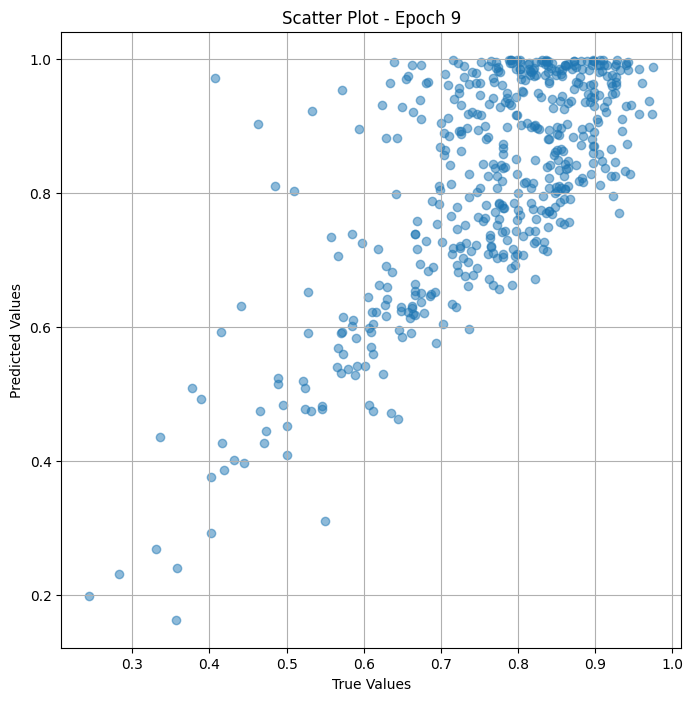


 Epoch: (10/50) Loss = 0.027602914720773697

 Epoch: (10/50) Loss_rmse = 0.16614125669002533

 Epoch: (10/50) R^2 = -10.119555473327637

 Epoch: (10/50) MAE = 0.14138202369213104

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

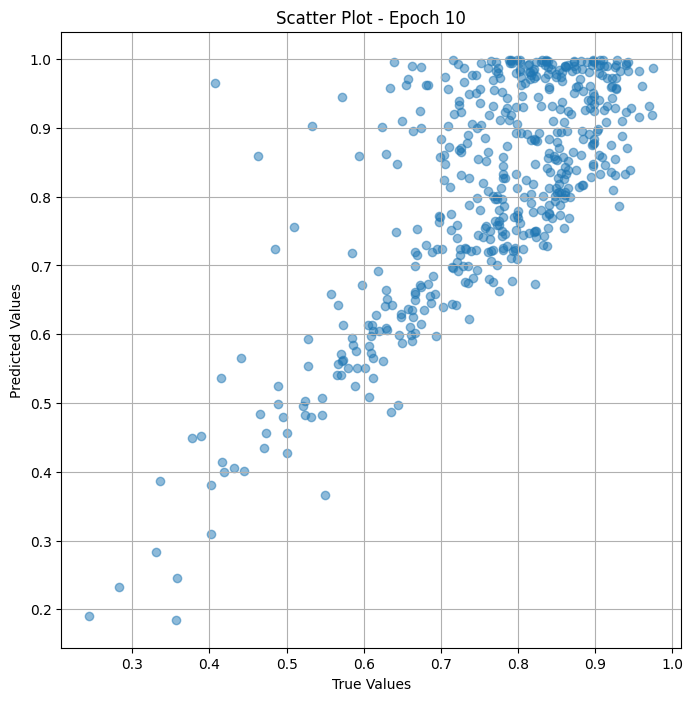


 Epoch: (11/50) Loss = 0.026707779616117477

 Epoch: (11/50) Loss_rmse = 0.16342514753341675

 Epoch: (11/50) R^2 = -9.75895881652832

 Epoch: (11/50) MAE = 0.13782282173633575

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757

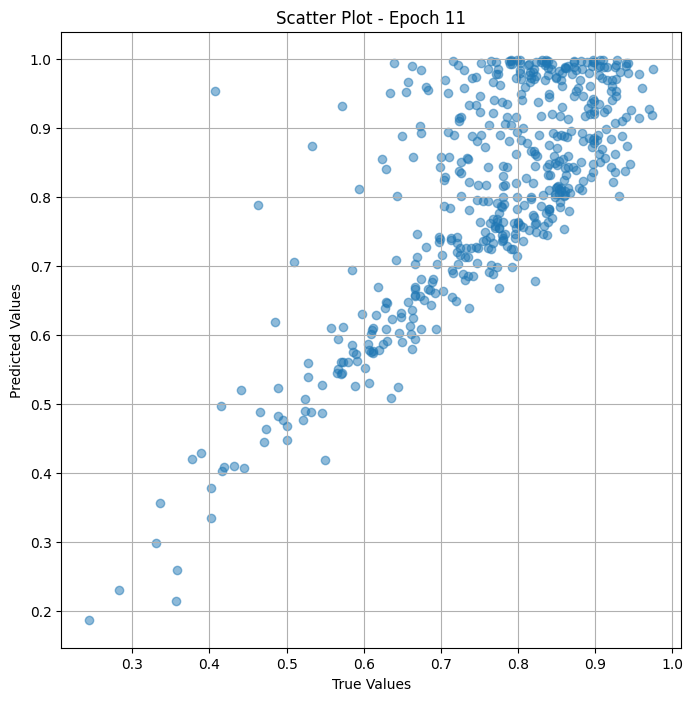


 Epoch: (12/50) Loss = 0.025625674054026604

 Epoch: (12/50) Loss_rmse = 0.1600802093744278

 Epoch: (12/50) R^2 = -9.323043823242188

 Epoch: (12/50) MAE = 0.13429972529411316

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757

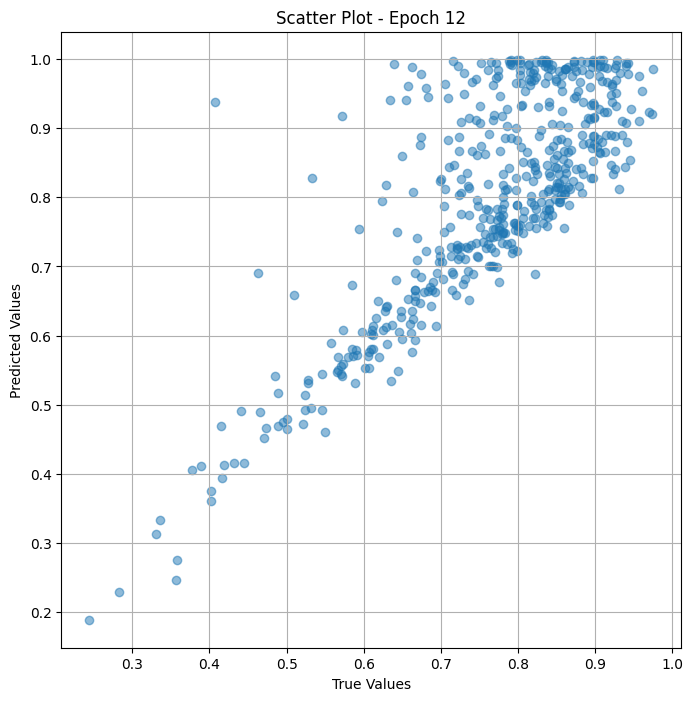


 Epoch: (13/50) Loss = 0.02431875839829445

 Epoch: (13/50) Loss_rmse = 0.15594473481178284

 Epoch: (13/50) R^2 = -8.796566009521484

 Epoch: (13/50) MAE = 0.13083958625793457

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757

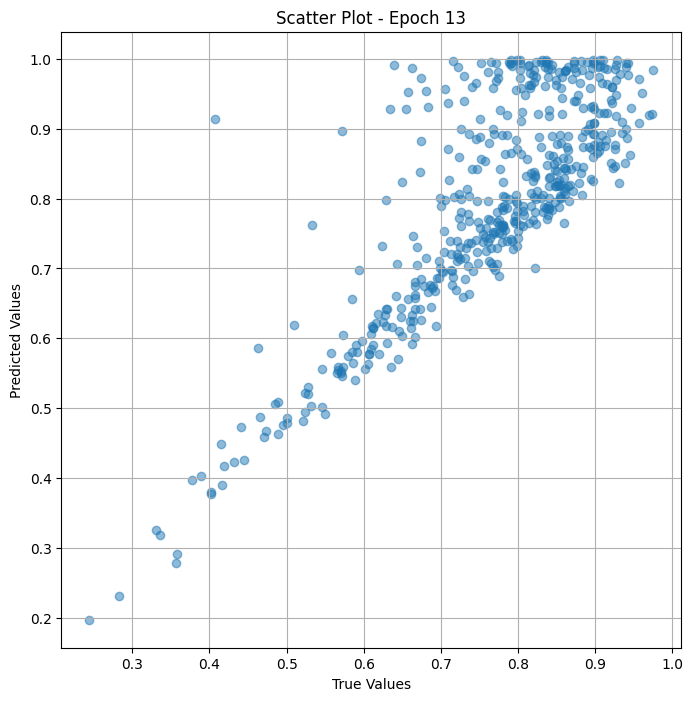


 Epoch: (14/50) Loss = 0.022642020136117935

 Epoch: (14/50) Loss_rmse = 0.15047265589237213

 Epoch: (14/50) R^2 = -8.121109008789062

 Epoch: (14/50) MAE = 0.12627345323562622

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

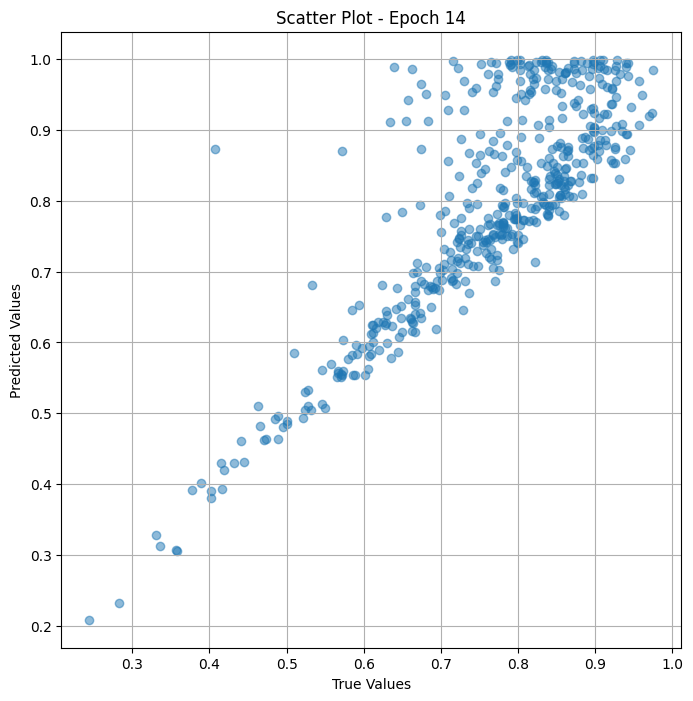


 Epoch: (15/50) Loss = 0.020302675664424896

 Epoch: (15/50) Loss_rmse = 0.14248745143413544

 Epoch: (15/50) R^2 = -7.178727149963379

 Epoch: (15/50) MAE = 0.1191529929637909

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757

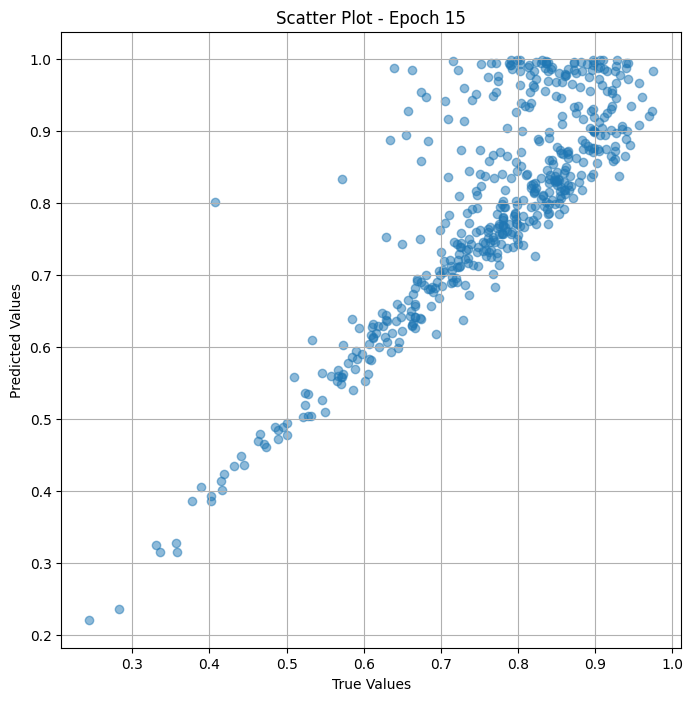


 Epoch: (16/50) Loss = 0.016860174015164375

 Epoch: (16/50) Loss_rmse = 0.1298467367887497

 Epoch: (16/50) R^2 = -5.791950702667236

 Epoch: (16/50) MAE = 0.10671879351139069

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757

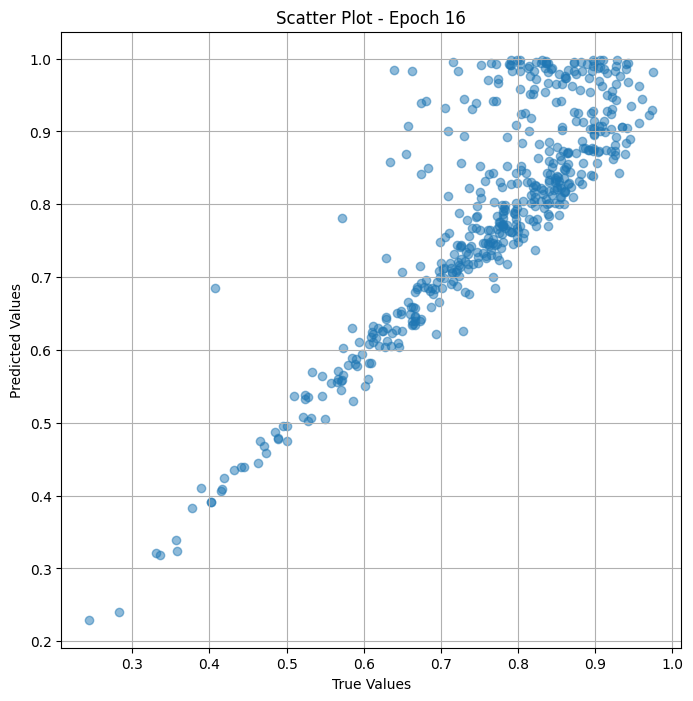


 Epoch: (17/50) Loss = 0.012672411277890205

 Epoch: (17/50) Loss_rmse = 0.11257180571556091

 Epoch: (17/50) R^2 = -4.104952812194824

 Epoch: (17/50) MAE = 0.08990897238254547

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

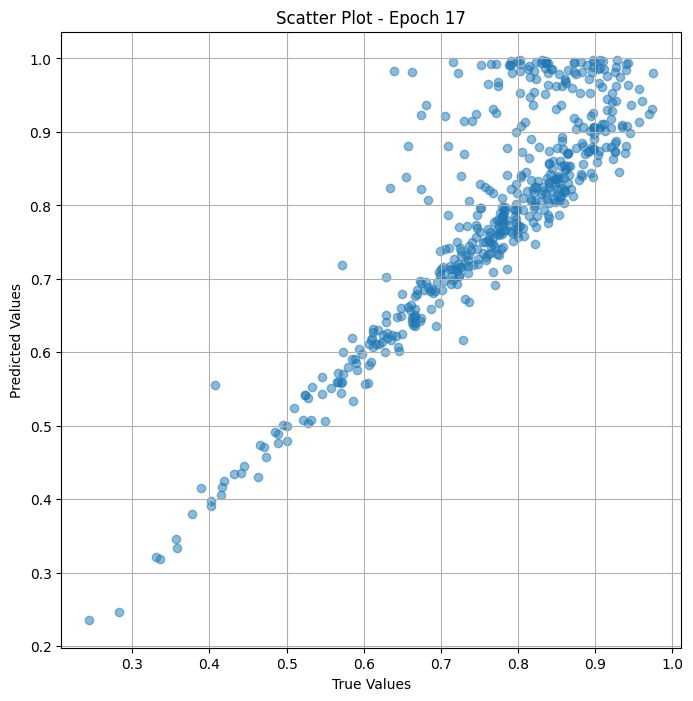


 Epoch: (18/50) Loss = 0.007554289419203997

 Epoch: (18/50) Loss_rmse = 0.08691541850566864

 Epoch: (18/50) R^2 = -2.0431690216064453

 Epoch: (18/50) MAE = 0.06694872677326202

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

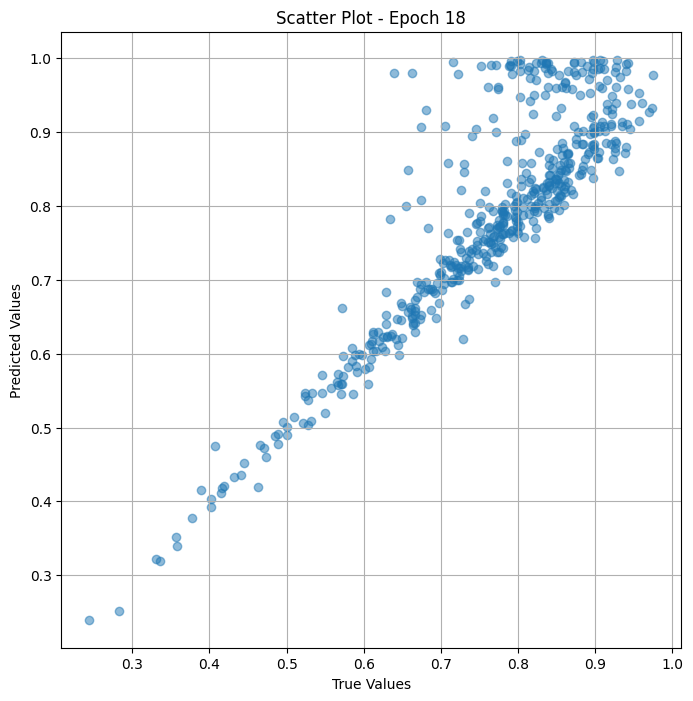


 Epoch: (19/50) Loss = 0.003617892973124981

 Epoch: (19/50) Loss_rmse = 0.060148924589157104

 Epoch: (19/50) R^2 = -0.4574315547943115

 Epoch: (19/50) MAE = 0.03906896710395813

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

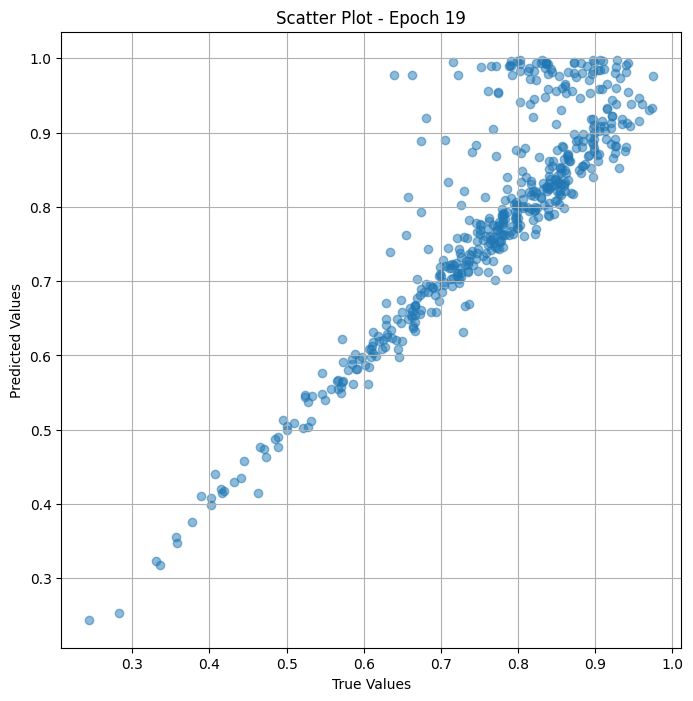


 Epoch: (20/50) Loss = 0.0033399818930774927

 Epoch: (20/50) Loss_rmse = 0.057792577892541885

 Epoch: (20/50) R^2 = -0.3454779386520386

 Epoch: (20/50) MAE = 0.03092081844806671

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

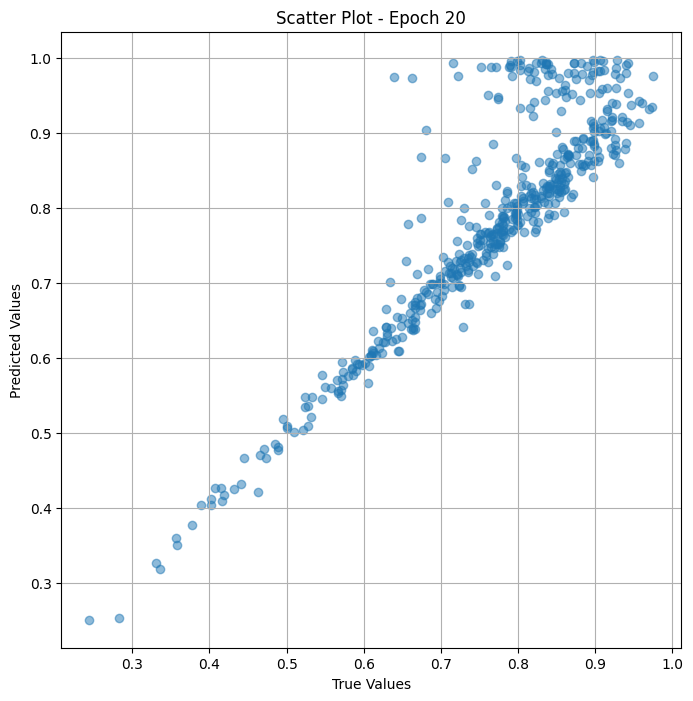


 Epoch: (21/50) Loss = 0.0033264646772295237

 Epoch: (21/50) Loss_rmse = 0.05767551064491272

 Epoch: (21/50) R^2 = -0.340032696723938

 Epoch: (21/50) MAE = 0.03335489332675934

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

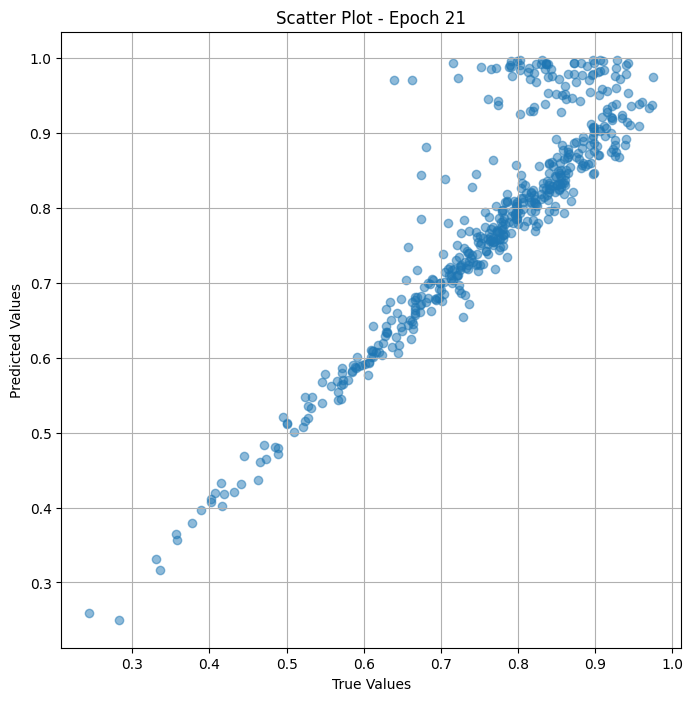


 Epoch: (22/50) Loss = 0.003143268870189786

 Epoch: (22/50) Loss_rmse = 0.05606486275792122

 Epoch: (22/50) R^2 = -0.26623404026031494

 Epoch: (22/50) MAE = 0.030004993081092834

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

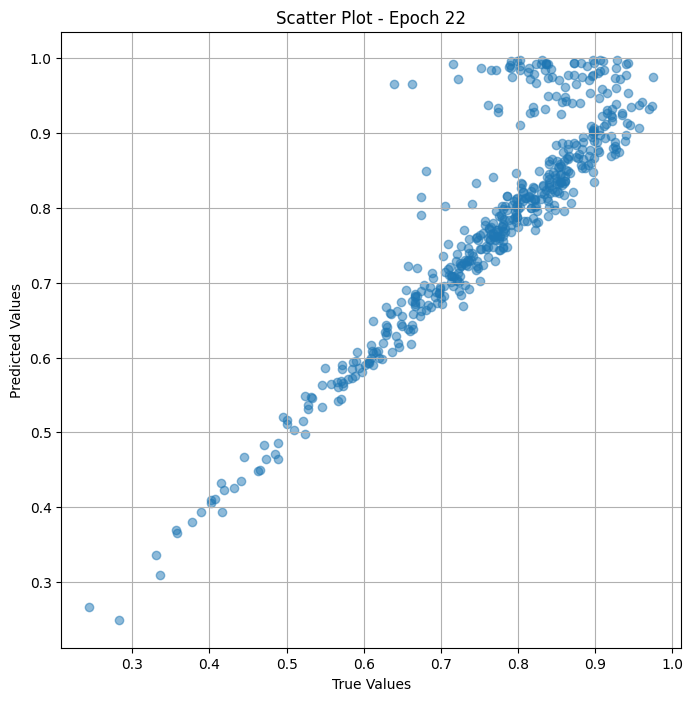


 Epoch: (23/50) Loss = 0.0029880311340093613

 Epoch: (23/50) Loss_rmse = 0.05466288700699806

 Epoch: (23/50) R^2 = -0.20369815826416016

 Epoch: (23/50) MAE = 0.03218397498130798

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

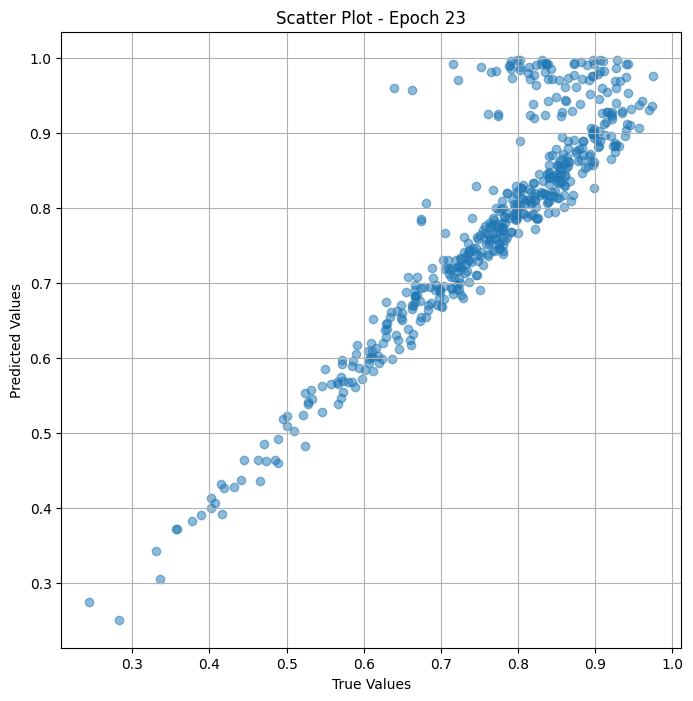


 Epoch: (24/50) Loss = 0.0026913832407444715

 Epoch: (24/50) Loss_rmse = 0.051878541707992554

 Epoch: (24/50) R^2 = -0.08419656753540039

 Epoch: (24/50) MAE = 0.030743584036827087

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0

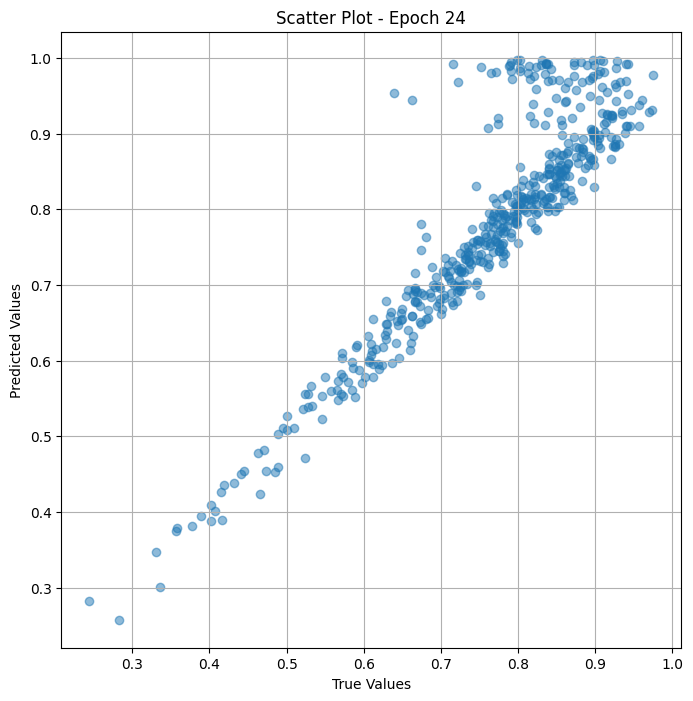


 Epoch: (25/50) Loss = 0.0022590579465031624

 Epoch: (25/50) Loss_rmse = 0.04752954840660095

 Epoch: (25/50) R^2 = 0.08996134996414185

 Epoch: (25/50) MAE = 0.030349522829055786

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

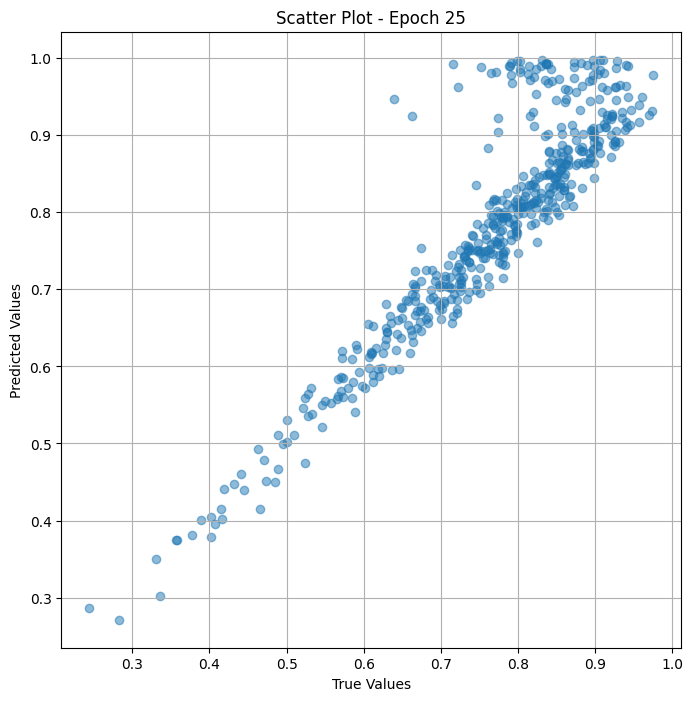


 Epoch: (26/50) Loss = 0.0017416821792721748

 Epoch: (26/50) Loss_rmse = 0.04173346608877182

 Epoch: (26/50) R^2 = 0.298380970954895

 Epoch: (26/50) MAE = 0.029354870319366455

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

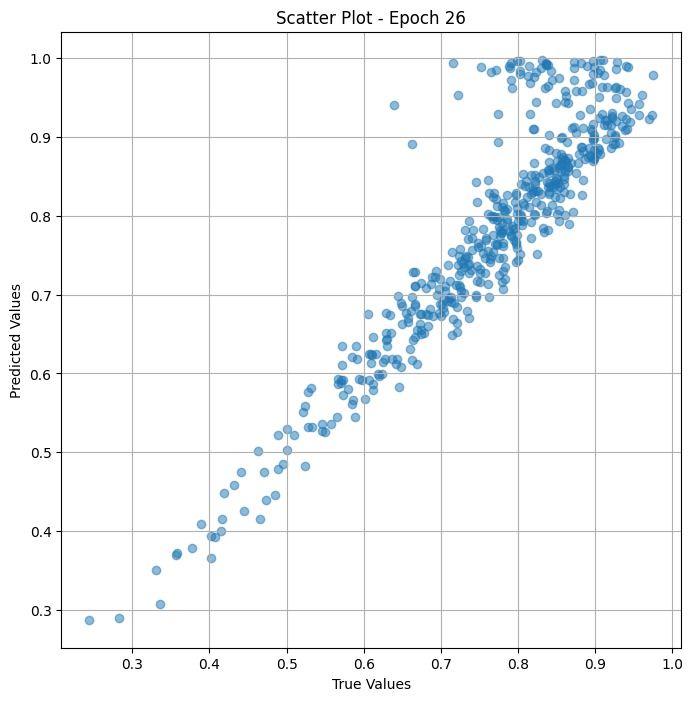


 Epoch: (27/50) Loss = 0.001090069068595767

 Epoch: (27/50) Loss_rmse = 0.03301619365811348

 Epoch: (27/50) R^2 = 0.560876727104187

 Epoch: (27/50) MAE = 0.026880547404289246

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

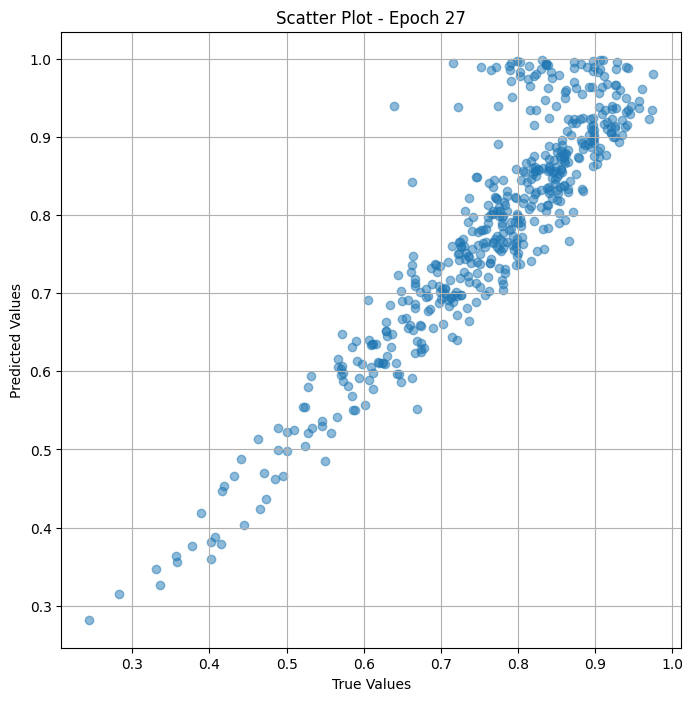


 Epoch: (28/50) Loss = 0.0009834821103140712

 Epoch: (28/50) Loss_rmse = 0.03136051818728447

 Epoch: (28/50) R^2 = 0.6038141846656799

 Epoch: (28/50) MAE = 0.023312315344810486

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

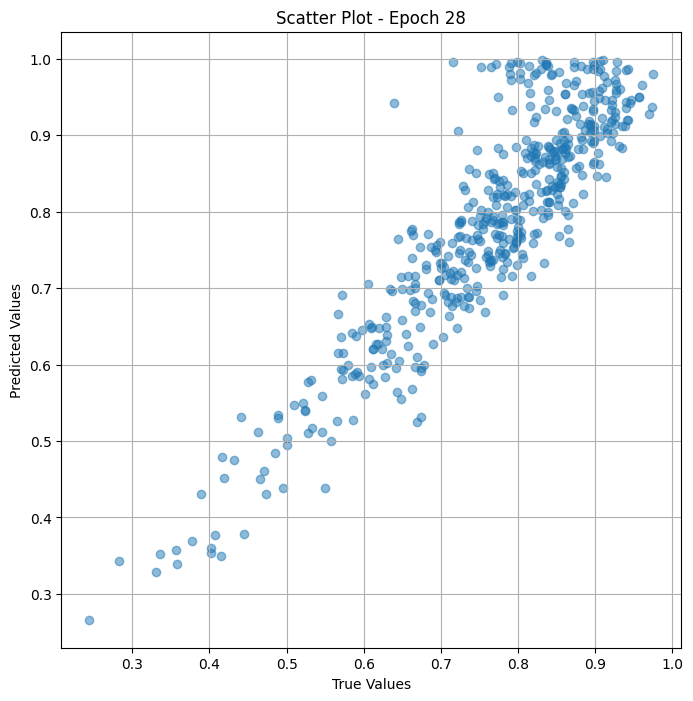


 Epoch: (29/50) Loss = 0.0022312591318041086

 Epoch: (29/50) Loss_rmse = 0.04723620414733887

 Epoch: (29/50) R^2 = 0.10115981101989746

 Epoch: (29/50) MAE = 0.030519545078277588

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

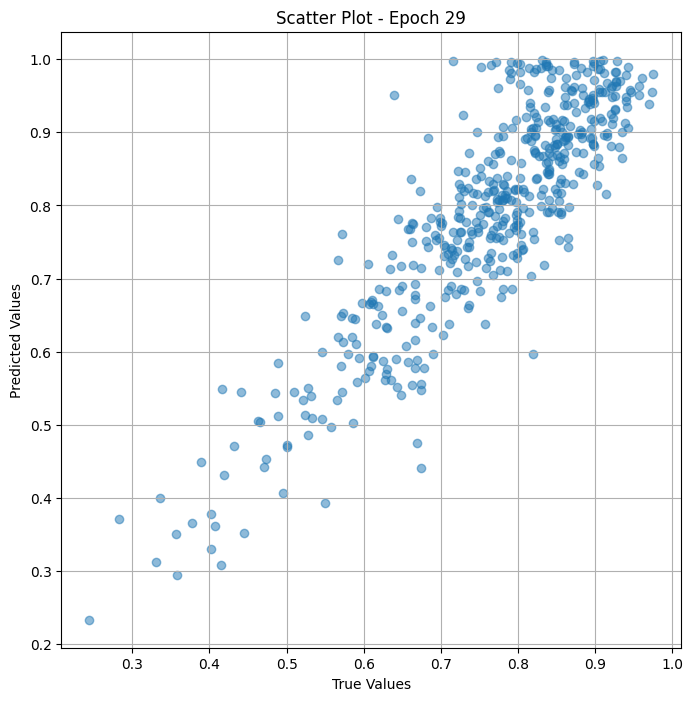


 Epoch: (30/50) Loss = 0.002141048666089773

 Epoch: (30/50) Loss_rmse = 0.046271465718746185

 Epoch: (30/50) R^2 = 0.13750016689300537

 Epoch: (30/50) MAE = 0.04338794946670532

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

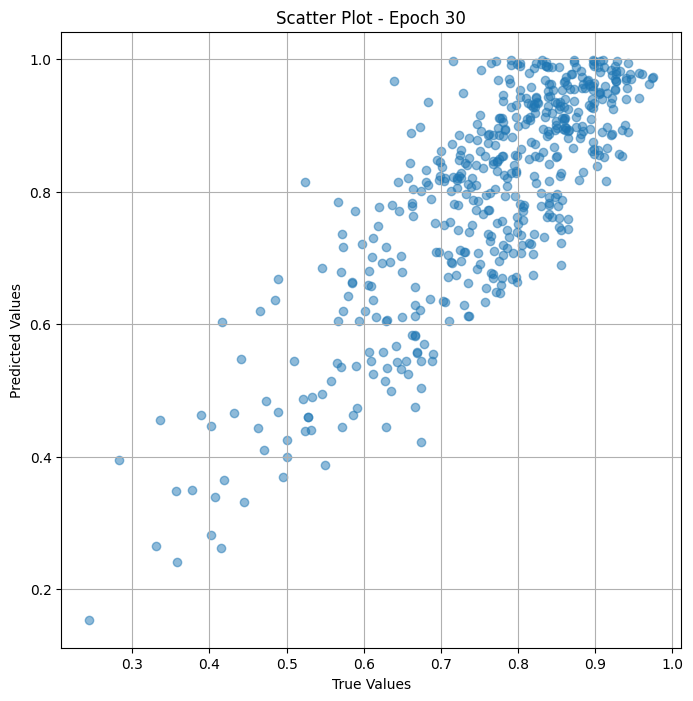


 Epoch: (31/50) Loss = 0.011731396429240704

 Epoch: (31/50) Loss_rmse = 0.10831157118082047

 Epoch: (31/50) R^2 = -3.725874423980713

 Epoch: (31/50) MAE = 0.10335946083068848

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

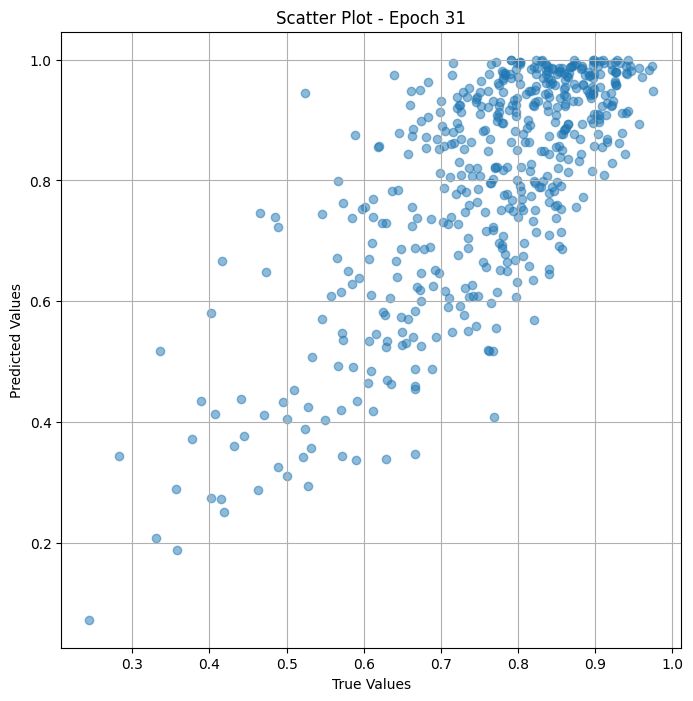


 Epoch: (32/50) Loss = 0.005557178054004908

 Epoch: (32/50) Loss_rmse = 0.07454648613929749

 Epoch: (32/50) R^2 = -1.2386529445648193

 Epoch: (32/50) MAE = 0.06251654028892517

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

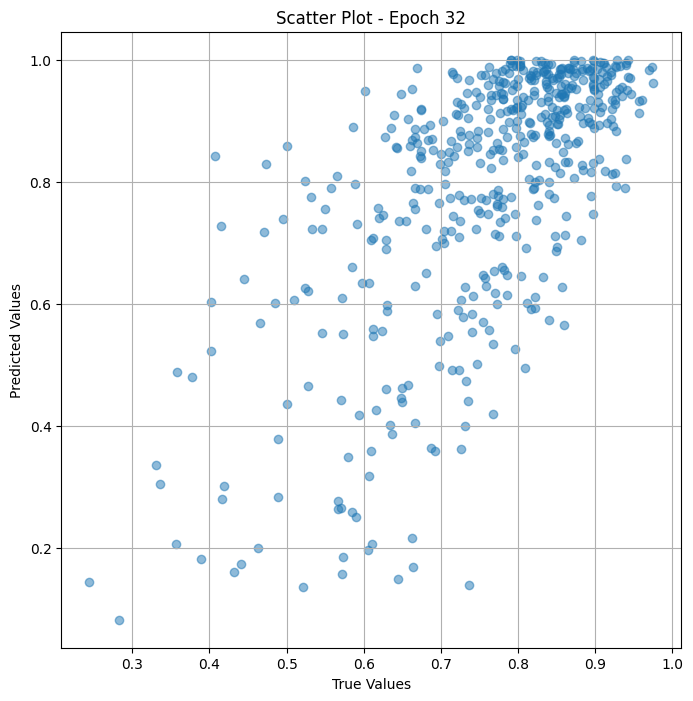


 Epoch: (33/50) Loss = 0.022295216098427773

 Epoch: (33/50) Loss_rmse = 0.14931583404541016

 Epoch: (33/50) R^2 = -7.981402397155762

 Epoch: (33/50) MAE = 0.1356012374162674

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75757

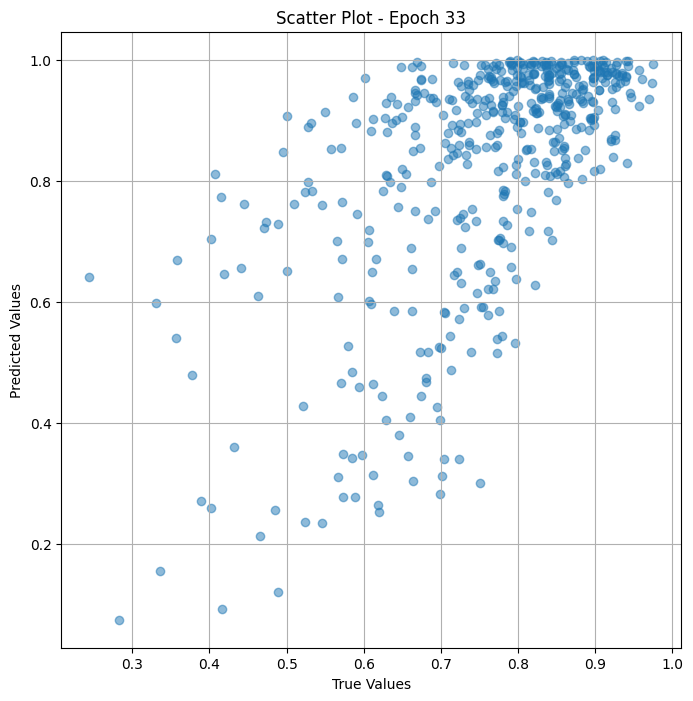


 Epoch: (34/50) Loss = 0.012114614248275757

 Epoch: (34/50) Loss_rmse = 0.11006640642881393

 Epoch: (34/50) R^2 = -3.8802499771118164

 Epoch: (34/50) MAE = 0.09498393535614014

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

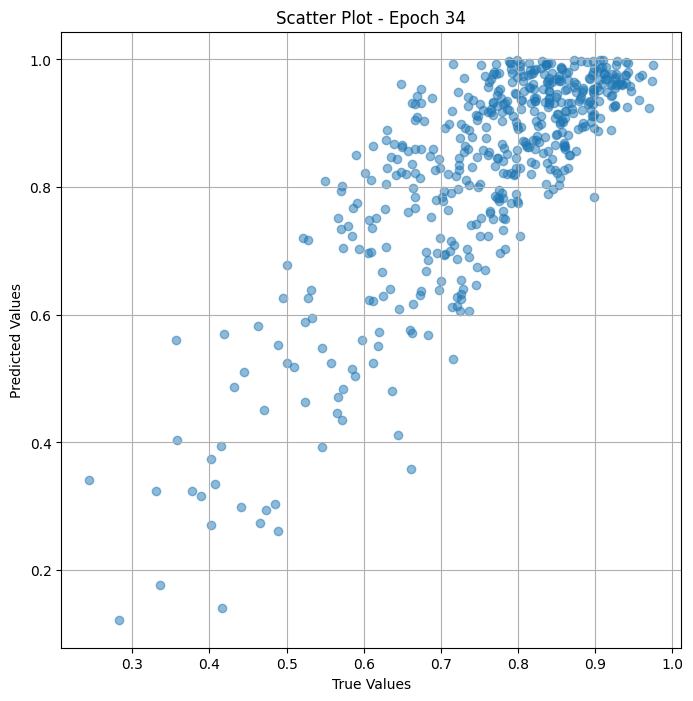


 Epoch: (35/50) Loss = 0.004199361428618431

 Epoch: (35/50) Loss_rmse = 0.06480248272418976

 Epoch: (35/50) R^2 = -0.691670298576355

 Epoch: (35/50) MAE = 0.041313886642456055

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

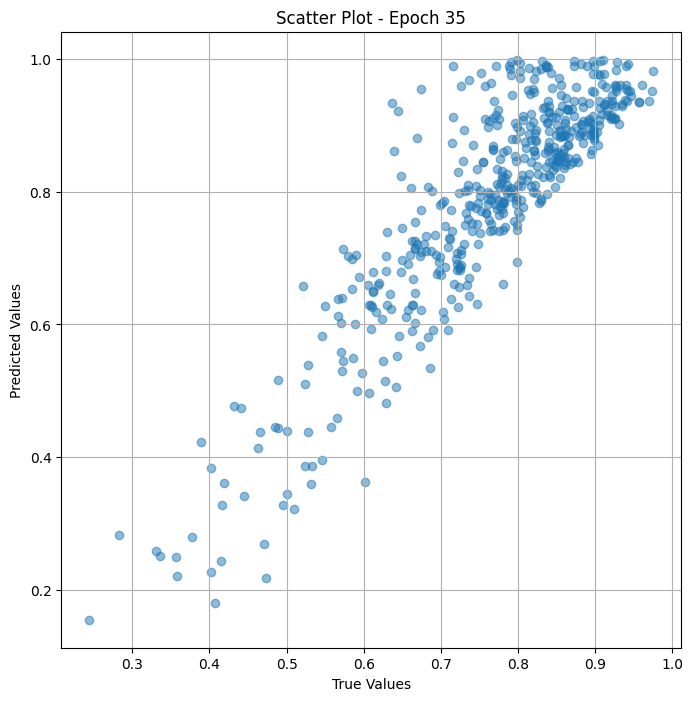


 Epoch: (36/50) Loss = 0.001309650600887835

 Epoch: (36/50) Loss_rmse = 0.03618909418582916

 Epoch: (36/50) R^2 = 0.47242051362991333

 Epoch: (36/50) MAE = 0.02625669538974762

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

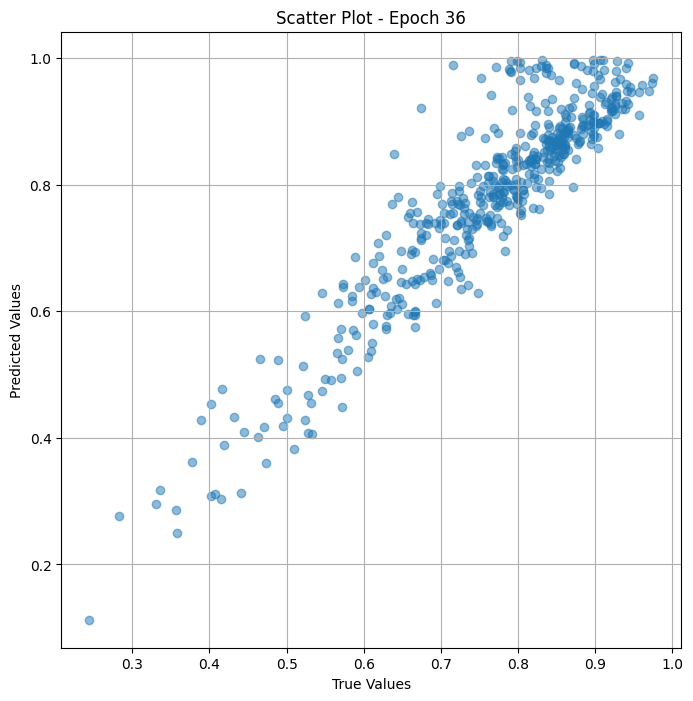


 Epoch: (37/50) Loss = 0.0006519905291497707

 Epoch: (37/50) Loss_rmse = 0.02553410455584526

 Epoch: (37/50) R^2 = 0.7373522520065308

 Epoch: (37/50) MAE = 0.02131231129169464

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

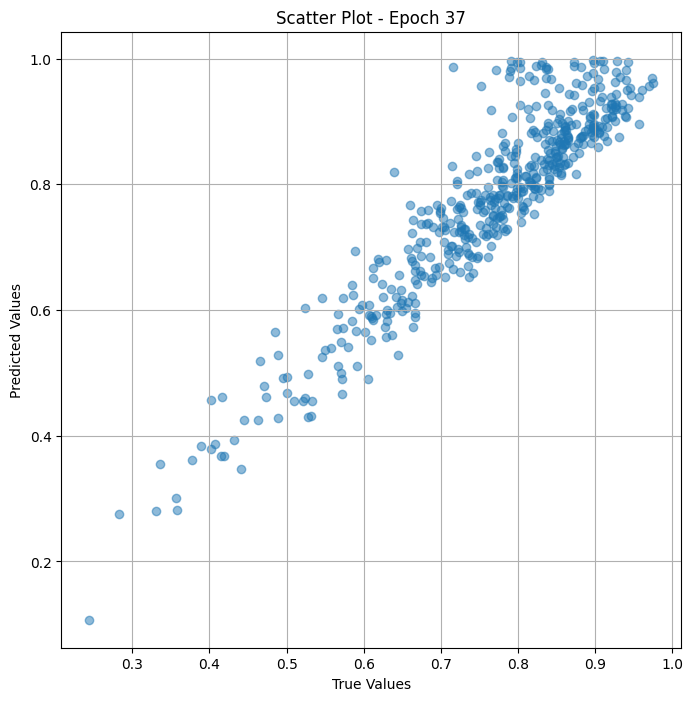


 Epoch: (38/50) Loss = 0.0007152220932766795

 Epoch: (38/50) Loss_rmse = 0.026743637397885323

 Epoch: (38/50) R^2 = 0.7118799686431885

 Epoch: (38/50) MAE = 0.024216443300247192

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

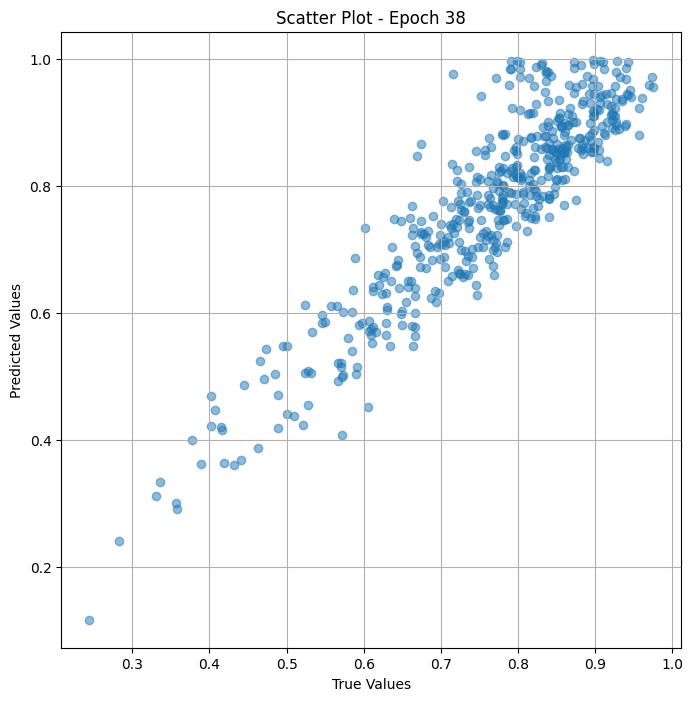


 Epoch: (39/50) Loss = 0.0005423101247288287

 Epoch: (39/50) Loss_rmse = 0.02328755334019661

 Epoch: (39/50) R^2 = 0.7815358638763428

 Epoch: (39/50) MAE = 0.017487913370132446

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

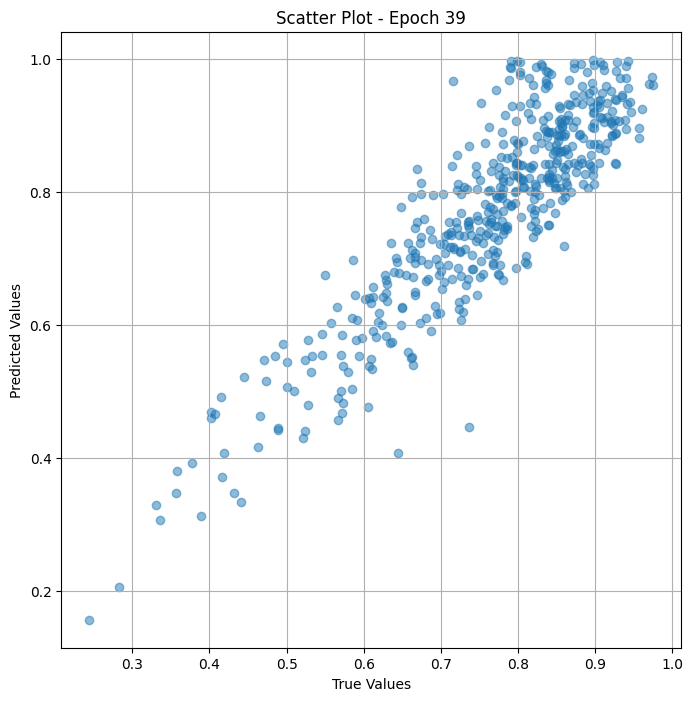


 Epoch: (40/50) Loss = 0.0001789423986338079

 Epoch: (40/50) Loss_rmse = 0.013376935385167599

 Epoch: (40/50) R^2 = 0.9279148578643799

 Epoch: (40/50) MAE = 0.010495409369468689

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

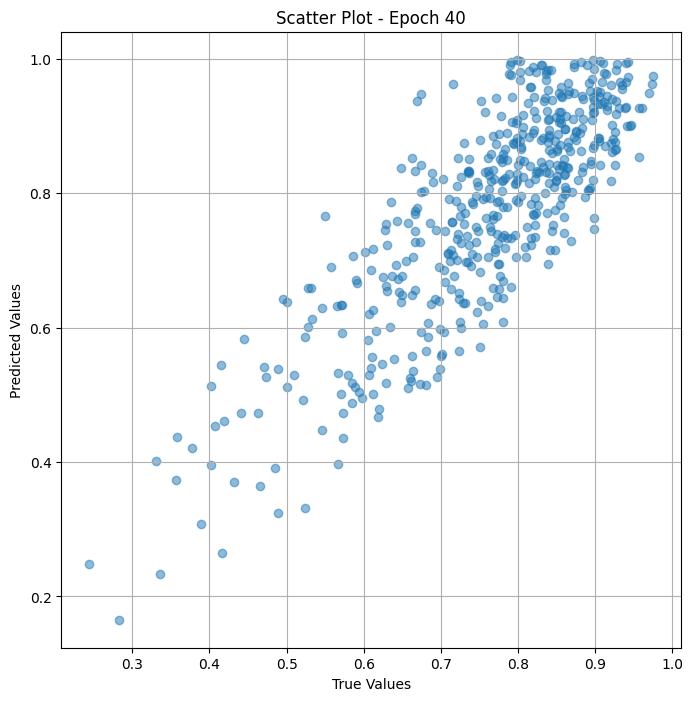


 Epoch: (41/50) Loss = 0.004823756404221058

 Epoch: (41/50) Loss_rmse = 0.06945326924324036

 Epoch: (41/50) R^2 = -0.9432015419006348

 Epoch: (41/50) MAE = 0.06606559455394745

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

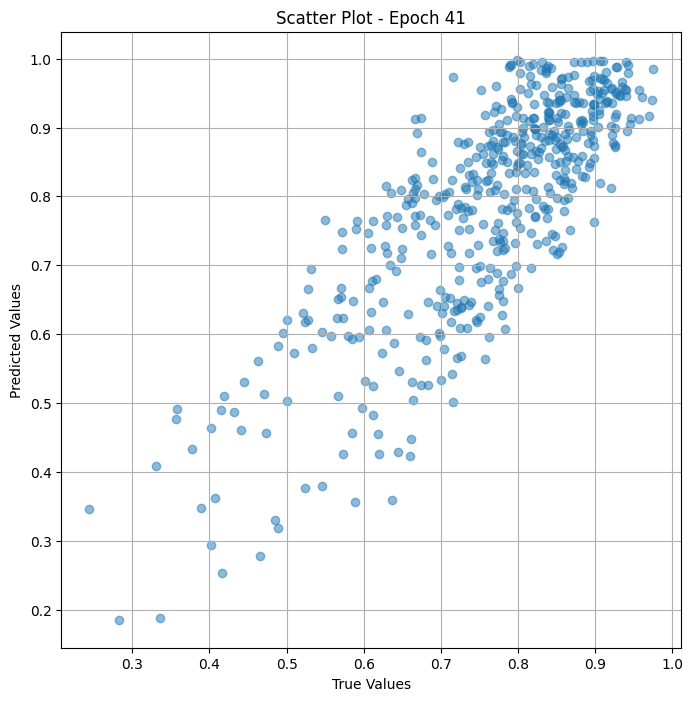


 Epoch: (42/50) Loss = 0.003086772281676531

 Epoch: (42/50) Loss_rmse = 0.05555872991681099

 Epoch: (42/50) R^2 = -0.24347496032714844

 Epoch: (42/50) MAE = 0.04395070672035217

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.75

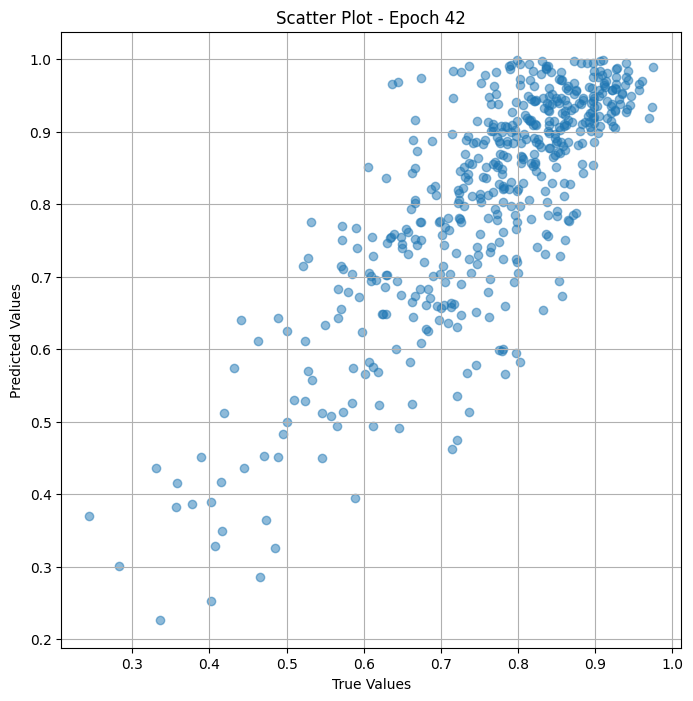


 Epoch: (43/50) Loss = 0.0013880364131182432

 Epoch: (43/50) Loss_rmse = 0.03725636005401611

 Epoch: (43/50) R^2 = 0.4408435821533203

 Epoch: (43/50) MAE = 0.03000122308731079

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

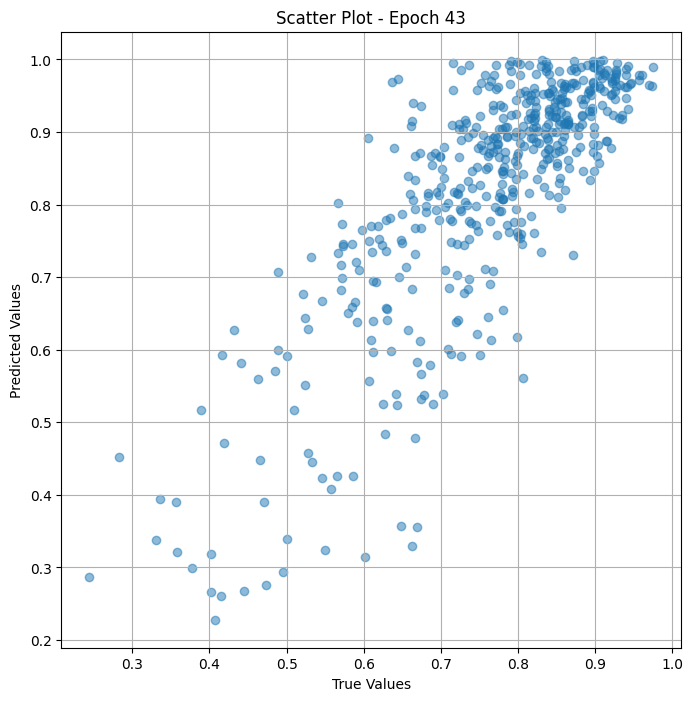


 Epoch: (44/50) Loss = 0.010494240559637547

 Epoch: (44/50) Loss_rmse = 0.10244140028953552

 Epoch: (44/50) R^2 = -3.2274985313415527

 Epoch: (44/50) MAE = 0.10082937777042389

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

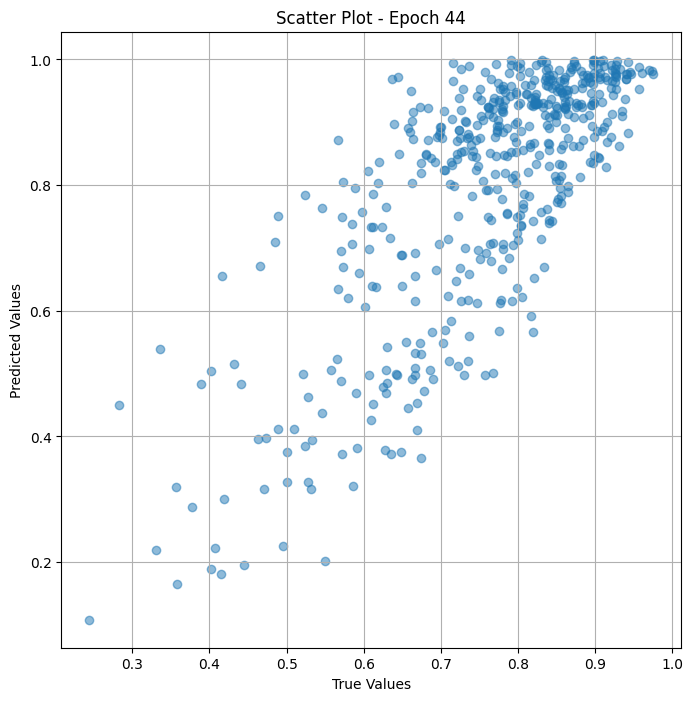


 Epoch: (45/50) Loss = 0.0027563986368477345

 Epoch: (45/50) Loss_rmse = 0.052501413971185684

 Epoch: (45/50) R^2 = -0.11038732528686523

 Epoch: (45/50) MAE = 0.03985604643821716

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.

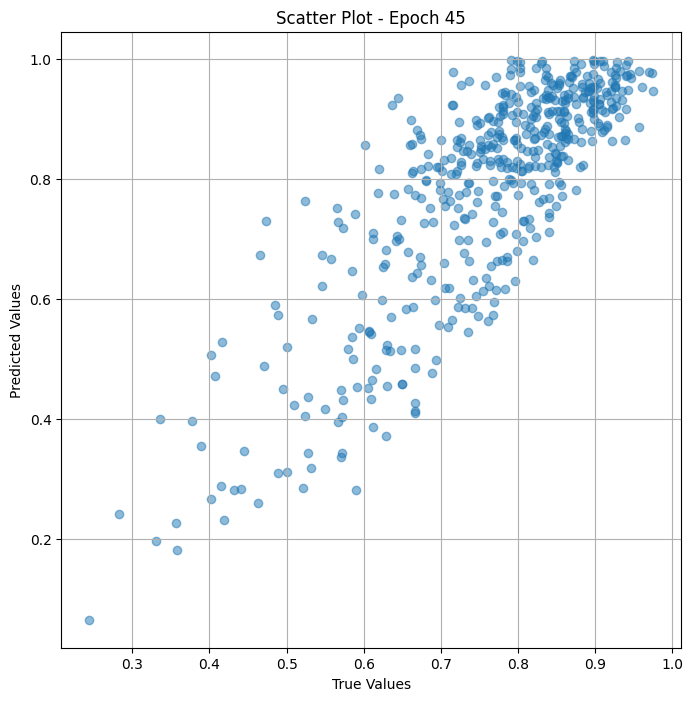


 Epoch: (46/50) Loss = 0.001092457678169012

 Epoch: (46/50) Loss_rmse = 0.03305234760046005

 Epoch: (46/50) R^2 = 0.5599144697189331

 Epoch: (46/50) MAE = 0.02818341553211212

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

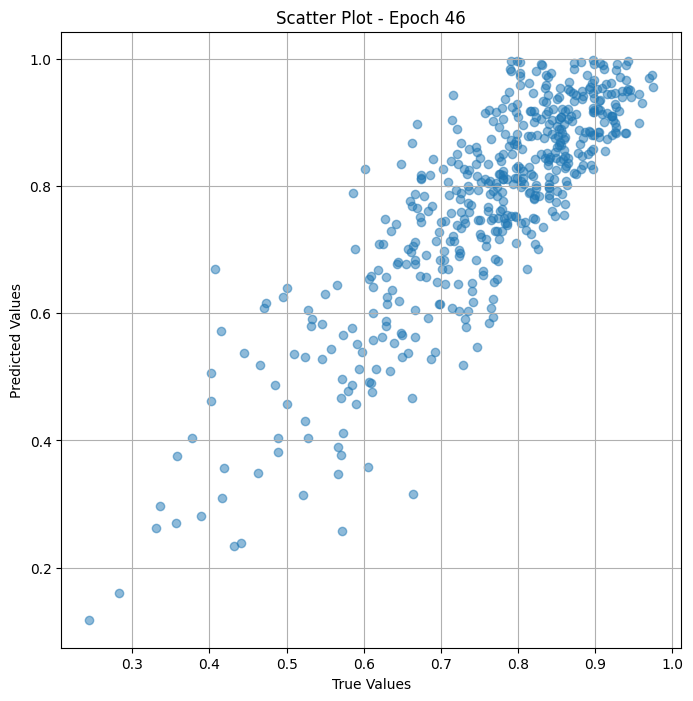


 Epoch: (47/50) Loss = 0.0005307093961164355

 Epoch: (47/50) Loss_rmse = 0.023037130013108253

 Epoch: (47/50) R^2 = 0.7862091064453125

 Epoch: (47/50) MAE = 0.0200251042842865

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757

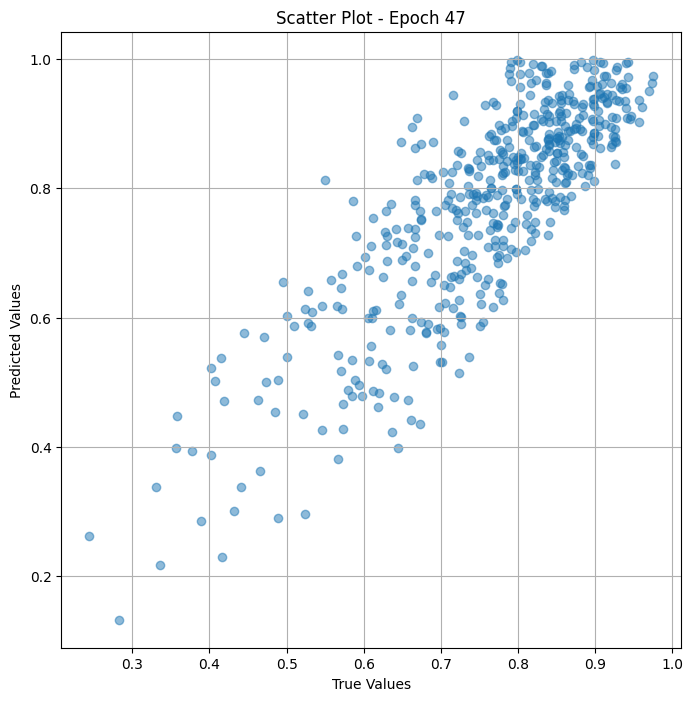


 Epoch: (48/50) Loss = 0.00432562967762351

 Epoch: (48/50) Loss_rmse = 0.06576951593160629

 Epoch: (48/50) R^2 = -0.742536187171936

 Epoch: (48/50) MAE = 0.058944910764694214

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7575

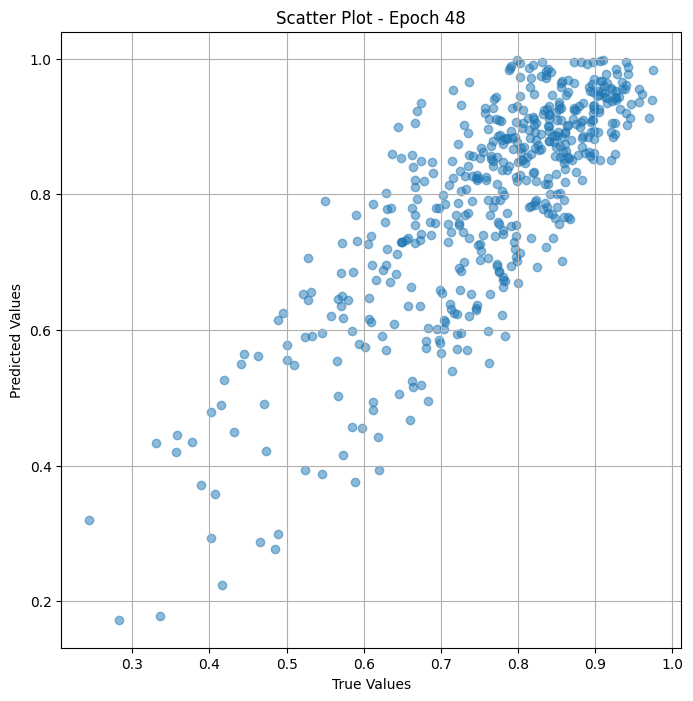


 Epoch: (49/50) Loss = 6.901389133417979e-05

 Epoch: (49/50) Loss_rmse = 0.008307459764182568

 Epoch: (49/50) R^2 = 0.9721984267234802

 Epoch: (49/50) MAE = 0.006298959255218506

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.7

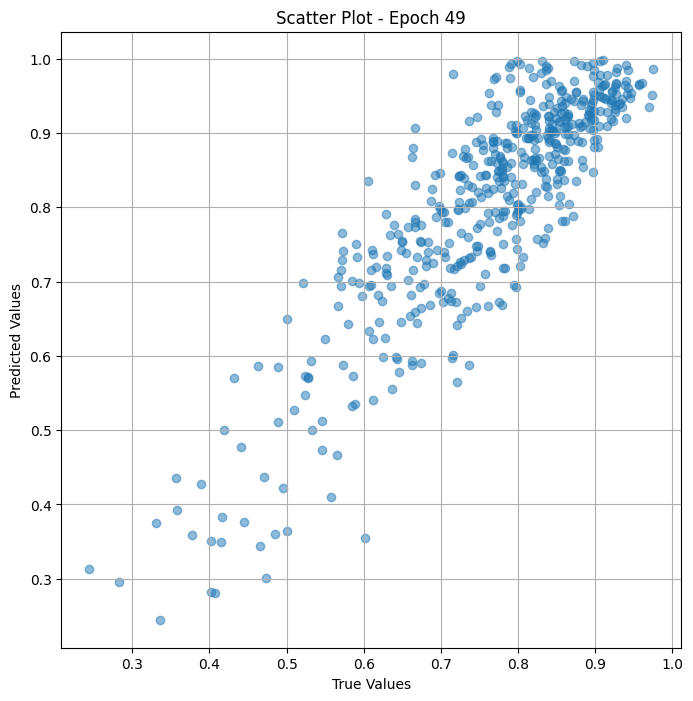


 Epoch: (50/50) Loss = 0.0013106430415064096

 Epoch: (50/50) Loss_rmse = 0.0362028032541275

 Epoch: (50/50) R^2 = 0.47202068567276

 Epoch: (50/50) MAE = 0.03378152847290039

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157, 0.9351852, 0.93406594, 0.78571427, 0.80582523, 0.8712871, 0.8952381, 0.76363635, 0.92, 0.6630435, 0.9139785, 0.7979798, 0.6666667, 0.90384614, 0.7605634, 0.8645833, 0.8989899, 0.9150943, 0.8020833, 0.79012346, 0.85148513, 0.7029703, 0.71900827, 0.89320385, 0.47368422, 0.8333333, 0.7473684, 0.7263158, 0.6744186, 0.3773585, 0.93939394, 0.8019802, 0.6020408, 0.7090909, 0.75, 0.8396226, 0.82978725, 0.9263158, 0.90434784, 0.94186044, 0.8913044, 0.79816514, 0.8034188, 0.8172043, 0.6486486, 0.8039216, 0.8783784, 0.89772725, 0.64356434, 0.6744186, 0.7920792, 0.7777778, 0.54545456, 0.6781609, 0.8818182, 0.44444445, 0.6695652, 0.4950495, 0.757575

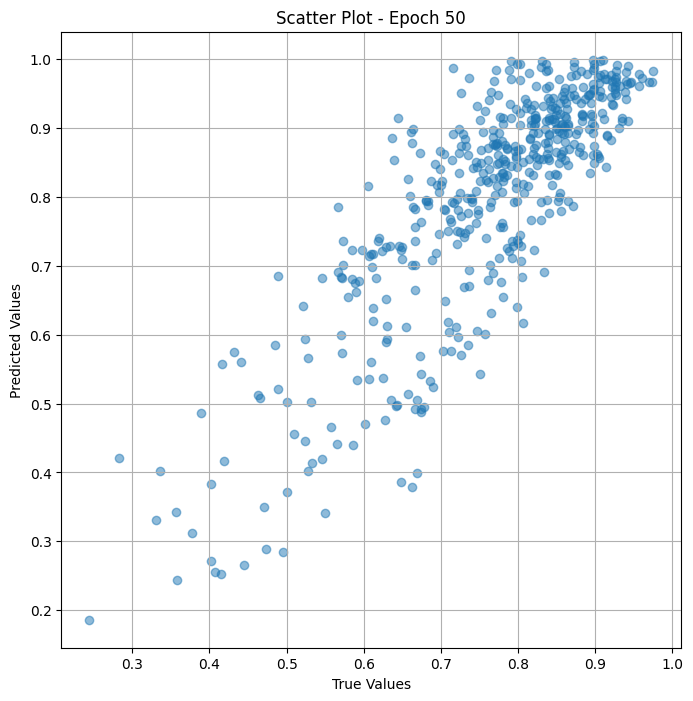

In [ ]:
# Training the model and save weights
fit(50, model_fine_test, train_dl_test)
torch.save(model_fine_test.state_dict(), "model_weights_vr_fine")

In [ ]:
true_values_list = [0.7920792, 0.8556701, 0.8730159, 0.5648148, 0.7802198, 0.9026549, 0.55789477, 0.85263157]

predicted_values_list= [0.7758623, 0.8487319, 0.89785635, 0.4664484, 0.750819, 0.8918511, 0.40966034, 0.84951216]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.9523809523809524 0.00026040002438725105


# //. evaluate. เทียบtest ของแต่ละ cate ของแต่ละ model

In [ ]:
model_list = ["Vision Transformer","Resnet50","Resnet50+Vision Transformer"]
train_acc_list = [round(training_Acc_trans[-1],2), round(training_Acc_res[-1],2), round(training_Acc_res_trans[-1],2)]
train_loss_list = [round(training_loss_trans[-1],4), round(training_loss_res[-1],4), round(training_loss_res_trans[-1],4)]
valid_acc_list = [valid_acc_vit,valid_acc_res,valid_acc_res_trans]
time_compute = [time_trans, res_time, time_rt]
df_eval = {'model':model_list, 'train_accuracy':train_acc_list, "train_loss": train_loss_list, "valid_accuracy" : valid_acc_list, "time_computing(sec)" : time_compute}
df_eval = pd.DataFrame(df_eval)